#0 - INITIALIZE

Articles:

Technical analysis strategy optimization using a machine learning approach in stock market indices[Formula presented]
https://www-sciencedirect-com.universidadviu.idm.oclc.org/science/article/abs/pii/S0950705121003828?via%3Dihub

Artificial intelligence techniques for enabling Big Data services in distribution networks: A review
https://www.sciencedirect.com/science/article/pii/S1364032121007413?pes=vor&utm_source=scopus&getft_integrator=scopus

Time Series Forecasting Using Artificial Neural Networks: A Model for the IBEX 35 Index



In [ ]:
%%capture
!pip install yfinance
!pip install yahoo_fin --upgrade
!pip install requests beautifulsoup4
#!pip install mplfinance
#!pip install  investpy
#!pip install eodhd
#!pip install yahoo_fin
!pip install requests_html
!pip install lxml_html_clean
!pip install mplfinance
!pip install plotly
!pip install fredapi requests
!pip install pandasdmx
!pip install pandasdmx requests_cache
!pip install scikit-optimize
!pip install category_encoders

In [ ]:
# Basics
import datetime
#import feedparser
import ftplib
import io
import json
import pandas as pd
import requests
import requests_html
import pandasdmx as sdmx
import time
import numpy as np
from copy import deepcopy
import random
from dateutil.relativedelta import relativedelta
import os
from datetime import datetime


# APIs & finance
#from eodhd import APIClient
import yfinance as yf
from yahoo_fin import stock_info as si
from bs4 import BeautifulSoup
from fredapi import Fred

# Plots
import matplotlib.pyplot as plt
import mplfinance as mpf
import plotly.graph_objects as go
import seaborn as sns

# ML
from sklearn.model_selection import train_test_split
from sklearn.model_selection import TimeSeriesSplit
import xgboost as xgb
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, fbeta_score, confusion_matrix, classification_report
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn.experimental import enable_halving_search_cv  # noqa
from skopt import BayesSearchCV
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from skopt.space import Real, Integer
from scipy.stats import uniform, randint
from sklearn.metrics import make_scorer, fbeta_score
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import classification_report
from sklearn.svm import SVC
from xgboost import plot_importance
from sklearn.metrics import precision_recall_curve, auc, roc_curve
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import roc_auc_score
from scipy.stats import chi2_contingency


#NN
import tensorflow as tf
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import Input, LSTM, Dense, Dropout, Embedding, Concatenate, RepeatVector, Reshape, Flatten, BatchNormalization, GRU
from tensorflow.keras.optimizers import Adam, AdamW
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping
from tensorflow.keras import regularizers
from sklearn.preprocessing import LabelEncoder, StandardScaler
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator


In [ ]:
seed = 34

# Establecer semillas para reproducibilidad
random.seed(seed)
np.random.seed(seed)
tf.random.set_seed(seed)

#1. - INTRO - DATA COLLECTION & PREPROCESS

## IBEX35 DATA

## DATA COLLECTION

In [ ]:
'''
start_time = time.time()

# Change IP to avoid Yahoo restrictions
proxy = "http://185.191.236.162:3128"
session = requests.Session()
session.proxies = {"http": proxy, "https": proxy}
response = session.get("https://httpbin.org/ip")  # Check the IP
print(responsem.json())

time.sleep(65) # Example: Simulate a long-running task
if time.time() - start_time > 60:
  print("Code took longer than 1 minute. Proceeding to the next line.")
'''

'\nstart_time = time.time()\n\n# Change IP to avoid Yahoo restrictions\nproxy = "http://185.191.236.162:3128"\nsession = requests.Session()\nsession.proxies = {"http": proxy, "https": proxy}\nresponse = session.get("https://httpbin.org/ip")  # Check the IP\nprint(responsem.json())\n\ntime.sleep(65) # Example: Simulate a long-running task\nif time.time() - start_time > 60:\n  print("Code took longer than 1 minute. Proceeding to the next line.")\n'

In [ ]:
tickers = []

In [ ]:
# Yahoo Finance IBEX35 components URL
url = "https://finance.yahoo.com/quote/%5EIBEX/components"

# Header
headers = {
    "User-Agent": "Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/91.0.4472.124 Safari/537.36"
}

# Send GET request
response = requests.get(url, headers=headers)

# Check request
if response.status_code == 200:
    soup = BeautifulSoup(response.text, "html.parser")

    # Find all links in the table containing stock tickers
    ticker_elements = soup.select("td a")

    # Extract tickers
    tickers = [ticker.text for ticker in ticker_elements if ".MC" in ticker.text]  # Only include Spanish stocks

    print("IBEX35 Tickers:", tickers)
else:
    print(f"Failed to retrieve data. Status code: {response.status_code}")

tickers = [ticker.strip() for ticker in tickers]
print(len(tickers))

IBEX35 Tickers: ['MAP.MC  ', 'BBVA.MC  ', 'CLNX.MC  ', 'ITX.MC  ', 'TEF.MC  ', 'ANA.MC  ', 'NTGY.MC  ', 'LOG.MC  ', 'MRL.MC  ', 'ELE.MC  ', 'IBE.MC  ', 'COL.MC  ', 'UNI.MC  ', 'AMS.MC  ', 'SAB.MC  ', 'SAN.MC  ', 'CABK.MC  ', 'FER.MC  ', 'GRF.MC  ', 'AENA.MC  ', 'ENG.MC  ', 'BKT.MC  ', 'FDR.MC  ', 'ACS.MC  ', 'ACX.MC  ', 'ANE.MC  ', 'PUIG.MC  ', 'MTS.MC  ', 'RED.MC  ', 'IAG.MC  ']
30


In [ ]:
# Your existing tickers list
tickers = tickers + ['IDR.MC', 'REP.MC', 'ROVI.MC', 'SCYR.MC', 'SLR.MC']
print("Updated IBEX35 Tickers:", tickers)
print(len(tickers))

Updated IBEX35 Tickers: ['MAP.MC', 'BBVA.MC', 'CLNX.MC', 'ITX.MC', 'TEF.MC', 'ANA.MC', 'NTGY.MC', 'LOG.MC', 'MRL.MC', 'ELE.MC', 'IBE.MC', 'COL.MC', 'UNI.MC', 'AMS.MC', 'SAB.MC', 'SAN.MC', 'CABK.MC', 'FER.MC', 'GRF.MC', 'AENA.MC', 'ENG.MC', 'BKT.MC', 'FDR.MC', 'ACS.MC', 'ACX.MC', 'ANE.MC', 'PUIG.MC', 'MTS.MC', 'RED.MC', 'IAG.MC', 'IDR.MC', 'REP.MC', 'ROVI.MC', 'SCYR.MC', 'SLR.MC']
35


In [ ]:
# Store historical data
historical_data = {}

start_date = '1990-01-01'
end_date = '2025-04-29'

session = requests.Session()
for ticker in tickers:
    print(f"Extracting data for {ticker}...")
    stock = yf.Ticker(ticker)

    # Get max historical data with XXX granularity
    data = stock.history(start=start_date, end=end_date, interval="1d", auto_adjust=False)

    if not data.empty:
        data["Ticker"] = ticker
        historical_data[ticker] = data
    else:
        print(f"Warning: No data found for {ticker}")

# Convert into a single DataFrame
historical_df = pd.concat(historical_data.values(), axis=0)

Extracting data for MAP.MC...
Extracting data for BBVA.MC...
Extracting data for CLNX.MC...
Extracting data for ITX.MC...
Extracting data for TEF.MC...
Extracting data for ANA.MC...
Extracting data for NTGY.MC...
Extracting data for LOG.MC...
Extracting data for MRL.MC...
Extracting data for ELE.MC...
Extracting data for IBE.MC...
Extracting data for COL.MC...
Extracting data for UNI.MC...
Extracting data for AMS.MC...
Extracting data for SAB.MC...
Extracting data for SAN.MC...
Extracting data for CABK.MC...
Extracting data for FER.MC...
Extracting data for GRF.MC...
Extracting data for AENA.MC...
Extracting data for ENG.MC...
Extracting data for BKT.MC...
Extracting data for FDR.MC...
Extracting data for ACS.MC...
Extracting data for ACX.MC...
Extracting data for ANE.MC...
Extracting data for PUIG.MC...
Extracting data for MTS.MC...
Extracting data for RED.MC...
Extracting data for IAG.MC...
Extracting data for IDR.MC...
Extracting data for REP.MC...
Extracting data for ROVI.MC...
Ext

In [ ]:
# Extraer datos del IBEX35
print("Extracting data for IBEX35...")
ibex = yf.Ticker("^IBEX")
ibex_data = ibex.history(period="max", end=end_date, interval="1d", auto_adjust=False)

if not ibex_data.empty:
    ibex_data["Ticker"] = "IBEX35"
    historical_data["IBEX35"] = ibex_data
else:
    print("Warning: No data found for IBEX35")

# Convertir en DataFrame único
historical_df = pd.concat(historical_data.values(), axis=0).reset_index()

# Ordenar por fecha
historical_df = historical_df.sort_values(by=["Date", "Ticker"]).reset_index(drop=True)


Extracting data for IBEX35...


In [ ]:
# Nuevo df
index_df_final = historical_df.copy()
index_df_final['Date'] = pd.to_datetime(index_df_final['Date']).dt.tz_localize(None)
index_df_final.sample(10)

,Date,Open,High,Low,Close,Adj Close,Volume,Dividends,Stock Splits,Ticker
20606,2003-12-26,1.875225,1.875225,1.875225,1.875225,0.503417,0,0.0,0.0,BKT.MC
124776,2018-08-14,5.484000,5.568000,5.385000,5.453000,3.665160,33658509,0.0,0.0,BBVA.MC
77480,2012-10-15,1.323312,1.337898,1.296130,1.301434,1.065669,2083366,0.0,0.0,IAG.MC
27259,2005-03-15,18.837812,19.016651,18.727102,18.854843,6.225076,1201552,0.0,0.0,NTGY.MC
104917,2016-04-21,28.641954,28.913794,28.345402,28.538160,16.852640,1025041,0.0,0.0,ACS.MC
156196,2022-03-16,19.594999,19.680000,18.895000,19.209999,19.209999,1504845,0.0,0.0,SLR.MC
130500,2019-04-11,7.930000,7.936000,7.836000,7.848000,6.100351,26579030,0.0,0.0,IBE.MC
176706,2024-06-28,16.270000,16.340000,16.150000,16.320000,16.124901,1483594,0.0,0.0,RED.MC
96761,2015-05-05,15.140000,15.630000,14.940000,15.170000,13.503960,39863,0.0,0.0,ROVI.MC
165526,2023-03-29,11.280000,11.325000,11.230000,11.320000,10.337618,8819996,0.0,0.0,IBE.MC


In [ ]:
'''
from google.colab import files

# Download the DataFrame to a CSV file
index_df_final.to_csv('index_df_final.csv', index=False)
files.download('index_df_final.csv')

# Code to upload the file (assuming it's named 'uploaded_index_df.csv')
uploaded = files.upload()
for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))

# Load the uploaded CSV file into a DataFrame
import pandas as pd
import io
uploaded_index_df = pd.read_csv('index_df_final.csv') # Replace 'index_df_final.csv' with the actual filename if it differs.

# Now you have the uploaded data in the 'uploaded_index_df' DataFrame
print(uploaded_index_df.head())
'''

'\nfrom google.colab import files\n\n# Download the DataFrame to a CSV file\nindex_df_final.to_csv(\'index_df_final.csv\', index=False)\nfiles.download(\'index_df_final.csv\')\n\n# Code to upload the file (assuming it\'s named \'uploaded_index_df.csv\')\nuploaded = files.upload()\nfor fn in uploaded.keys():\n  print(\'User uploaded file "{name}" with length {length} bytes\'.format(\n      name=fn, length=len(uploaded[fn])))\n\n# Load the uploaded CSV file into a DataFrame\nimport pandas as pd\nimport io\nuploaded_index_df = pd.read_csv(\'index_df_final.csv\') # Replace \'index_df_final.csv\' with the actual filename if it differs.\n\n# Now you have the uploaded data in the \'uploaded_index_df\' DataFrame\nprint(uploaded_index_df.head())\n'

In [ ]:
# Convertir fecha al formato datetime
index_df_final["Date"] = pd.to_datetime(index_df_final["Date"])

In [ ]:
index_df_final.describe()

,Date,Open,High,Low,Close,Adj Close,Volume,Dividends,Stock Splits
count,184310,184310.000000,184310.000000,184310.000000,184310.000000,184310.000000,1.843100e+05,184310.000000,184310.000000
mean,2014-01-12 10:54:11.504530176,410.836644,414.019618,407.259759,410.774569,404.779396,1.357691e+07,0.003639,0.000273
min,1993-07-12 00:00:00,0.252000,0.262000,0.250000,0.254600,-5.336127,0.000000e+00,0.000000,0.000000
25%,2008-05-26 00:00:00,5.106454,5.171410,5.037500,5.105152,2.948831,5.270798e+05,0.000000,0.000000
50%,2014-10-03 00:00:00,12.060000,12.200000,11.914259,12.060476,6.422692,1.725794e+06,0.000000,0.000000
75%,2020-03-02 00:00:00,22.764999,23.030001,22.500000,22.760000,15.984022,8.122685e+06,0.000000,0.000000
max,2025-04-28 00:00:00,15999.200195,16040.400391,15868.599609,15945.700195,15945.683594,9.752120e+08,62.000000,5.000000
std,NaN,1897.115077,1910.994604,1881.509005,1896.881115,1897.618679,3.957324e+07,0.253544,0.029575


## US DATA

In [ ]:
FRED_API_KEY = '6e6de66402eff3c339c0541bc5efebb7 '
fred = Fred(api_key=FRED_API_KEY)

# Get the earliest date from historical_df
#start_date = historical_df['Date'].min().strftime('%Y-%m-%d')
#print(f"Earliest stock date: {start_date}")
start_date_real = historical_df['Date'].min()
start_date_extended = (start_date_real - relativedelta(years=1)).strftime('%Y-%m-%d')

print(f"Earliest stock date: {start_date_real.strftime('%Y-%m-%d')}")
print(f"Extended macro start date: {start_date_extended}")

# GDP, Unemployment Rate, Inflation (CPI)
us_indicators = {
    'GDP': fred.get_series('GDP', start_date_extended),
    'Unemployment Rate': fred.get_series('UNRATE', start_date_extended),
    'Inflation (CPI)': fred.get_series('CPIAUCSL', start_date_extended)
}

# Crear DataFrame macro
us_macro_df = pd.DataFrame(us_indicators)
us_macro_df.index = pd.to_datetime(us_macro_df.index).tz_localize('Europe/Madrid')


Earliest stock date: 1993-07-12
Extended macro start date: 1992-07-12


In [ ]:
# Resetear índice solo si hace falta
if 'Date' not in us_macro_df.columns:
    us_macro_df = us_macro_df.reset_index().rename(columns={'index': 'Date'})

if 'level_0' in us_macro_df.columns:
    us_macro_df = us_macro_df.drop(columns=['level_0'])

# Quitar zona horaria
index_df_final['Date'] = pd.to_datetime(index_df_final['Date']).dt.tz_localize(None)
us_macro_df['Date'] = pd.to_datetime(us_macro_df['Date']).dt.tz_localize(None)

In [ ]:
# Rellenar por fechas diarias
start_date_extended_dt = pd.to_datetime(start_date_extended).tz_localize(None)
end_date_dt = index_df_final['Date'].max()

# Crear rango de fechas diarias
full_date_range = pd.date_range(start=start_date_extended_dt, end=end_date_dt, freq='D')

# Asegurar que Date esté en formato datetime sin zona horaria
us_macro_df['Date'] = pd.to_datetime(us_macro_df['Date']).dt.tz_localize(None)

# Reindexar con fechas diarias
us_macro_df = us_macro_df.set_index('Date')
us_macro_df = us_macro_df.reindex(full_date_range)

# Interpolación lineal para variables numéricas
us_macro_df = us_macro_df.interpolate(method='linear')

# Resetear índice y renombrar columna
us_macro_df = us_macro_df.reset_index().rename(columns={'index': 'Date'})

In [ ]:
'''
# Rellenar por fechas diarias
start_date_extended_dt = pd.to_datetime(start_date_extended).tz_localize(None)
end_date_dt = index_df_final['Date'].max()


full_date_range = pd.date_range(
    start=start_date_extended_dt,
    end=end_date_dt,
    freq='D'
)

us_macro_df = us_macro_df.set_index('Date')
us_macro_df = us_macro_df.reindex(full_date_range).ffill().reset_index()
us_macro_df.rename(columns={'index': 'Date'}, inplace=True)
'''

"\n# Rellenar por fechas diarias\nstart_date_extended_dt = pd.to_datetime(start_date_extended).tz_localize(None)\nend_date_dt = index_df_final['Date'].max()\n\n\nfull_date_range = pd.date_range(\n    start=start_date_extended_dt,\n    end=end_date_dt,\n    freq='D'\n)\n\nus_macro_df = us_macro_df.set_index('Date')\nus_macro_df = us_macro_df.reindex(full_date_range).ffill().reset_index()\nus_macro_df.rename(columns={'index': 'Date'}, inplace=True)\n"

In [ ]:
# 🧹 Eliminar filas anteriores al inicio real de datos de cotizaciones
us_macro_df = us_macro_df[us_macro_df['Date'] >= start_date_real.replace(tzinfo=None)]

# Fusionar con datos diarios
merged_df = pd.merge(index_df_final, us_macro_df, on='Date', how='left')

In [ ]:
# Eliminar Adj Close ya que solo hay NaN para el Ibex
if 'Adj Close' in merged_df.columns:
  merged_df = merged_df.drop(columns=['Adj Close'])

In [ ]:
start_date_real_naive = start_date_real.tz_localize(None)

merged_df = merged_df[merged_df["Date"] >= start_date_real_naive]

In [ ]:
tickers_problematic = ['BKT.MC', 'FER.MC', 'SAB.MC']
cutoff_date = '2005-06-06'

for ticker in tickers_problematic:
    merged_df = merged_df[~((merged_df['Ticker'] == ticker) & (merged_df['Date'] < cutoff_date))]

# PREPROCESS AND ANALYSIS

In [ ]:
merged_df.describe()

,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits,GDP,Unemployment Rate,Inflation (CPI)
count,180065,180065.000000,180065.000000,180065.000000,180065.000000,1.800650e+05,180065.000000,180065.000000,180065.000000,180065.000000,180065.000000
mean,2014-04-19 22:09:34.552522496,420.267770,423.522599,416.609797,420.204237,1.381028e+07,0.003722,0.000280,18753.363765,5.648120,239.650979
min,1993-07-12 00:00:00,0.252000,0.262000,0.250000,0.254600,0.000000e+00,0.000000,0.000000,6897.837565,3.403226,144.606452
25%,2008-11-06 00:00:00,5.260546,5.328843,5.188000,5.260000,5.431070e+05,0.000000,0.000000,14684.517989,4.070968,214.490600
50%,2015-01-12 00:00:00,12.114981,12.250000,11.970000,12.115000,1.752034e+06,0.000000,0.000000,18089.960167,5.000000,237.297258
75%,2020-04-17 00:00:00,22.870001,23.136658,22.600000,22.860001,8.304301e+06,0.000000,0.000000,21815.800696,6.641935,258.554900
max,2025-04-28 00:00:00,15999.200195,16040.400391,15868.599609,15945.700195,9.752120e+08,62.000000,5.000000,29977.632000,14.800000,319.763571
std,NaN,1918.340050,1932.374244,1902.560131,1918.103533,3.998586e+07,0.256522,0.029921,5434.138206,1.996991,38.781374


In [ ]:
merged_df.sample(5).round(2)

,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits,Ticker,GDP,Unemployment Rate,Inflation (CPI)
22747,2004-05-18,4.20,4.22,4.16,4.18,15276860,0.0,0.0,IBE.MC,12212.23,5.60,188.58
155535,2022-02-18,11.51,11.68,11.43,11.51,871402,0.0,0.0,ACX.MC,25530.32,3.74,286.31
172099,2023-12-21,6.51,6.57,6.51,6.53,553143,0.0,0.0,COL.MC,28584.96,3.74,309.42
70923,2011-11-28,13.25,13.55,13.24,13.50,804632,0.0,0.0,ENG.MC,15985.08,8.51,227.22
34826,2006-08-02,10.06,10.08,9.97,10.03,1277038,0.0,0.0,FER.MC,13929.10,4.69,203.77


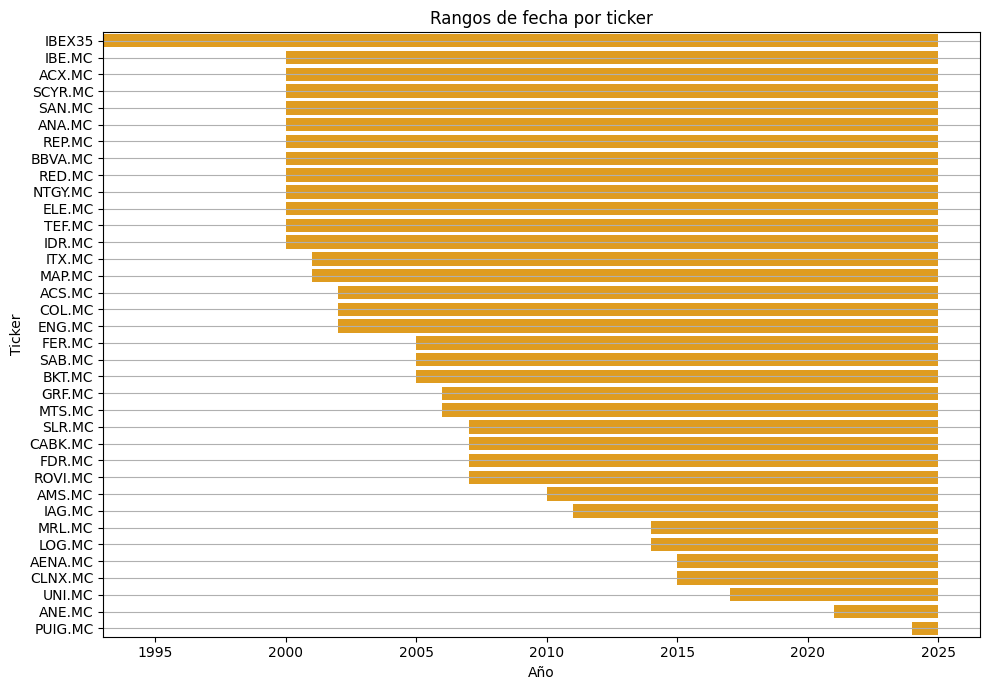

In [ ]:
date_ranges = merged_df.groupby('Ticker')['Date'].agg(['min', 'max'])

# Convert 'min' and 'max' columns to datetime objects if they aren't already
date_ranges['min'] = pd.to_datetime(date_ranges['min'])
date_ranges['max'] = pd.to_datetime(date_ranges['max'])

# Sort by the minimum date
date_ranges = date_ranges.sort_values('min', ascending=True)
date_ranges['min_year'] = date_ranges['min'].dt.year
date_ranges['max_year'] = date_ranges['max'].dt.year

# Create the horizontal bar plot using seaborn
plt.figure(figsize=(10, len(tickers) * 0.2))  # Adjust figure size
sns.barplot(x=date_ranges['max_year'] - date_ranges['min_year'],
            y=date_ranges.index,
            orient='h',
            color='orange', # Set the bar color to orange
            left=date_ranges['min_year'])

plt.xlabel("Año")
plt.ylabel("Ticker")
plt.title("Rangos de fecha por ticker")
plt.grid(axis='y')
plt.tight_layout()
plt.show()


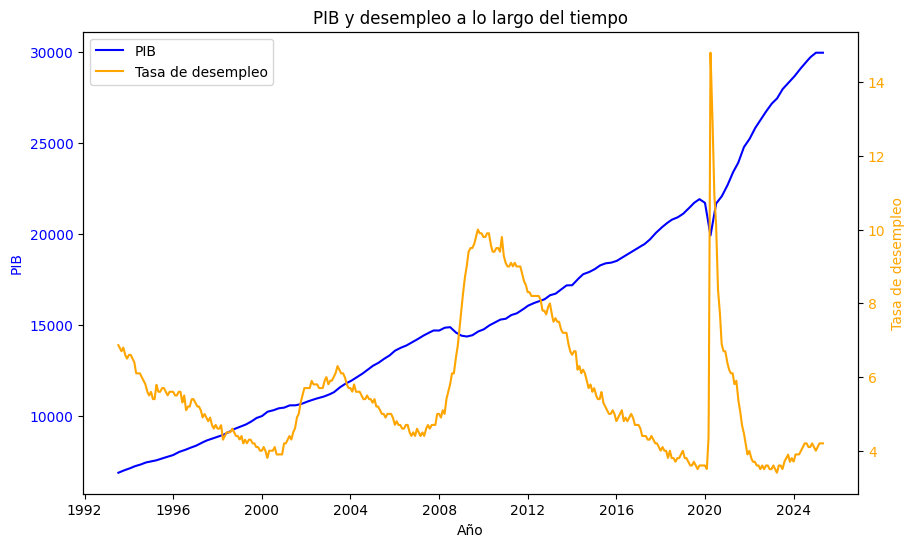

In [ ]:
gdp_data = merged_df[merged_df['Ticker'] == 'IBEX35'][['Date', 'GDP']] # Example: plotting IBEX35
unemployment_data = merged_df[merged_df['Ticker'] == 'IBEX35'][['Date', 'Unemployment Rate']] # Example: plotting IBEX35

# Create the plot
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plot GDP on the primary y-axis
ax1.plot(gdp_data['Date'], gdp_data['GDP'], color='blue', label='PIB')
ax1.set_xlabel('Año')
ax1.set_ylabel('PIB', color='blue')
ax1.tick_params(axis='y', labelcolor='blue')

# Create a secondary y-axis for unemployment rate
ax2 = ax1.twinx()
ax2.plot(unemployment_data['Date'], unemployment_data['Unemployment Rate'], color='orange', label='Tasa de desempleo')
ax2.set_ylabel('Tasa de desempleo', color='orange')
ax2.tick_params(axis='y', labelcolor='orange')

# Add title and legend
plt.title('PIB y desempleo a lo largo del tiempo')
fig.legend(loc="upper left", bbox_to_anchor=(0,1), bbox_transform=ax1.transAxes)

# Show the plot
plt.show()


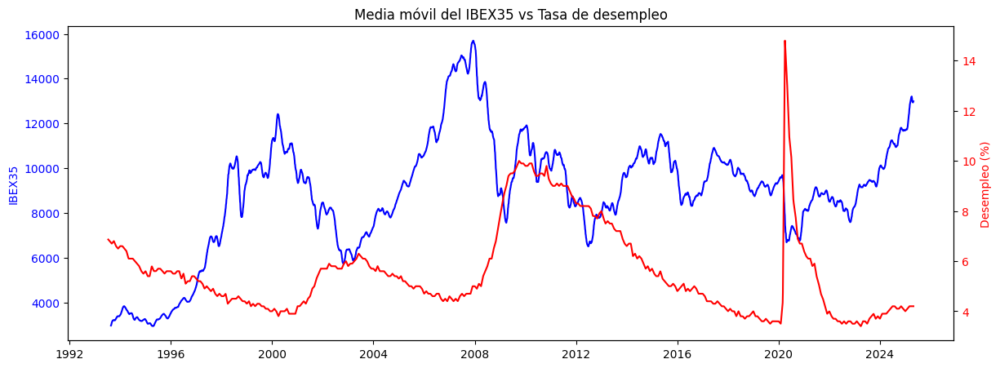

In [ ]:
ibex_df = pd.DataFrame()
ibex_df = merged_df[merged_df['Ticker']== 'IBEX35'].copy()
ibex_df['MA_30'] = ibex_df['Close'].rolling(30).mean()


fig, ax1 = plt.subplots(figsize=(14, 5))

ax1.plot(ibex_df['Date'], ibex_df['MA_30'], color='blue', label='Media Móvil IBEX35 (30d)')
ax1.set_ylabel('IBEX35', color='blue')
ax1.tick_params(axis='y', labelcolor='blue')

ax2 = ax1.twinx()
ax2.plot(ibex_df['Date'], ibex_df['Unemployment Rate'], color='red', label='Tasa de Desempleo')
ax2.set_ylabel('Desempleo (%)', color='red')
ax2.tick_params(axis='y', labelcolor='red')

plt.title('Media móvil del IBEX35 vs Tasa de desempleo')
plt.show()

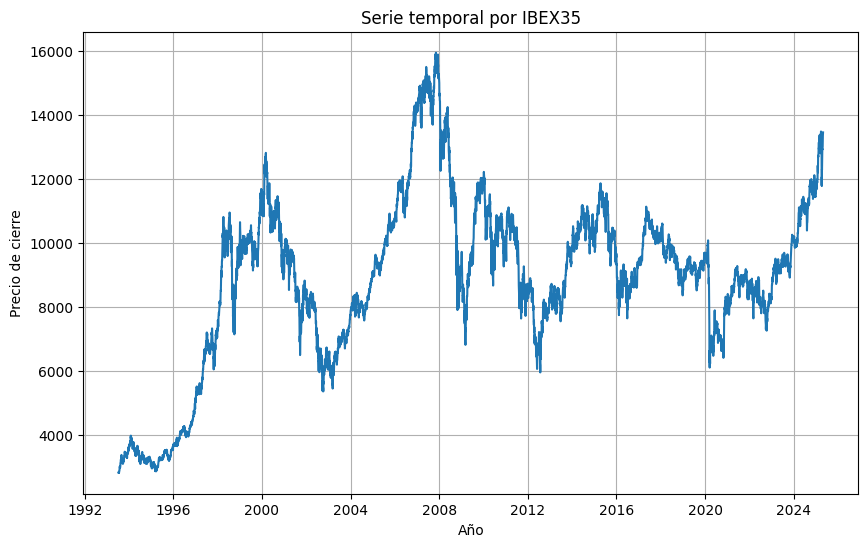

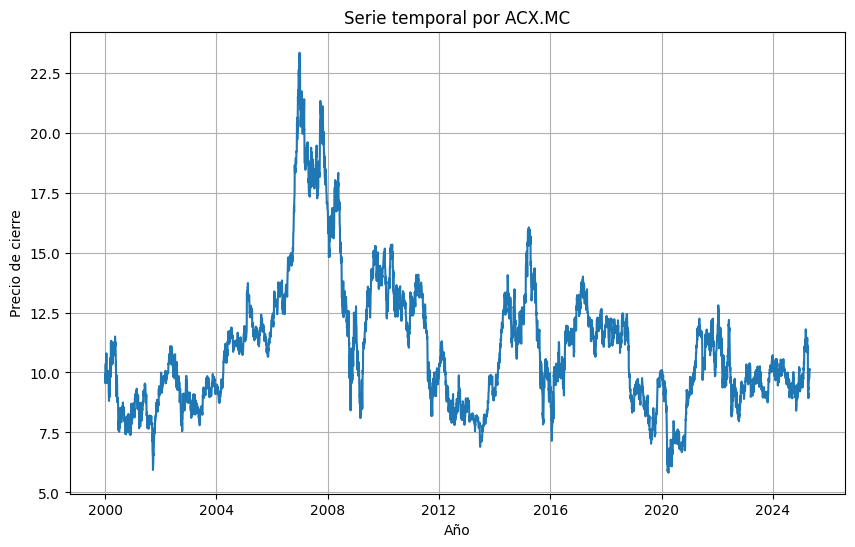

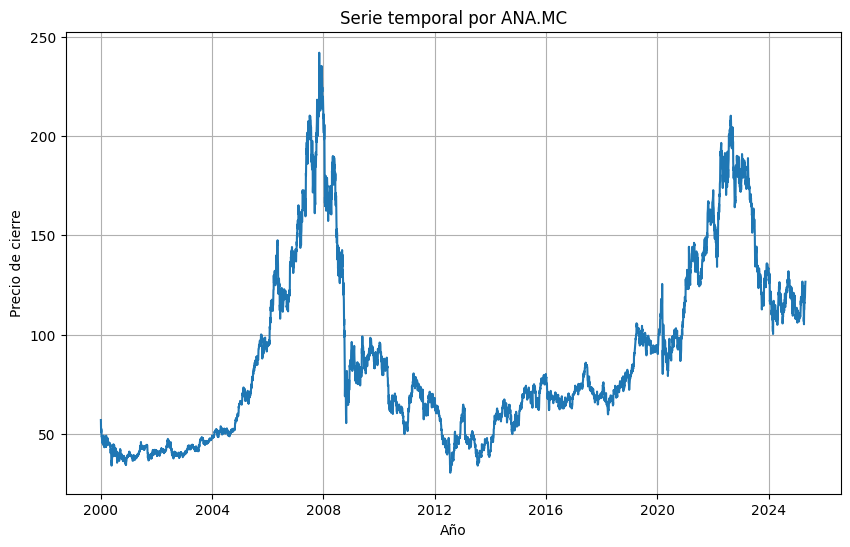

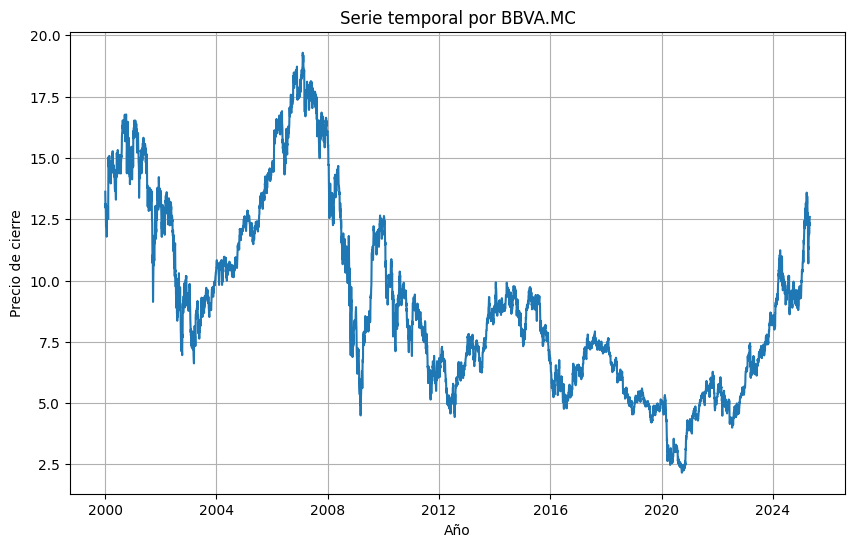

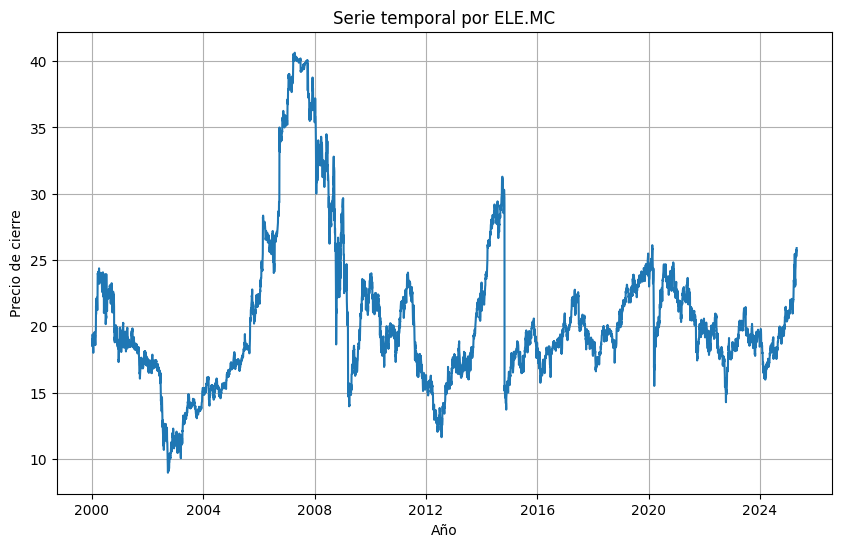

...

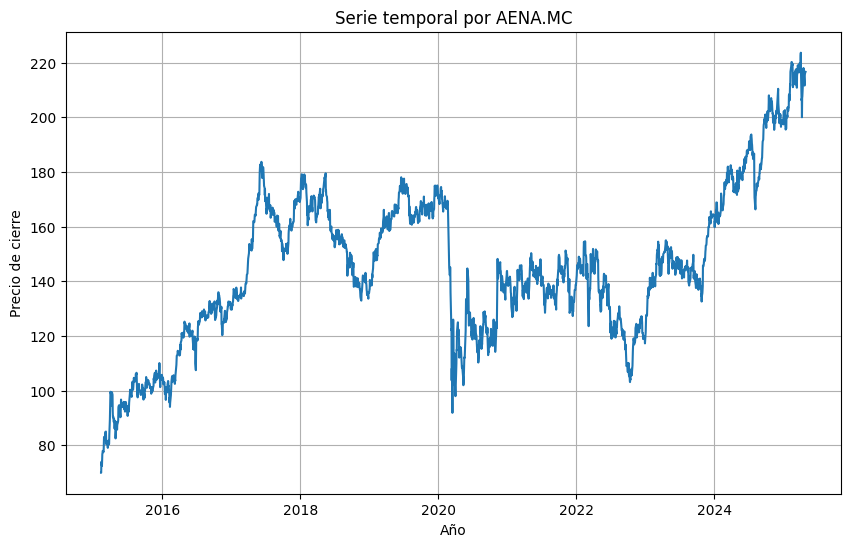

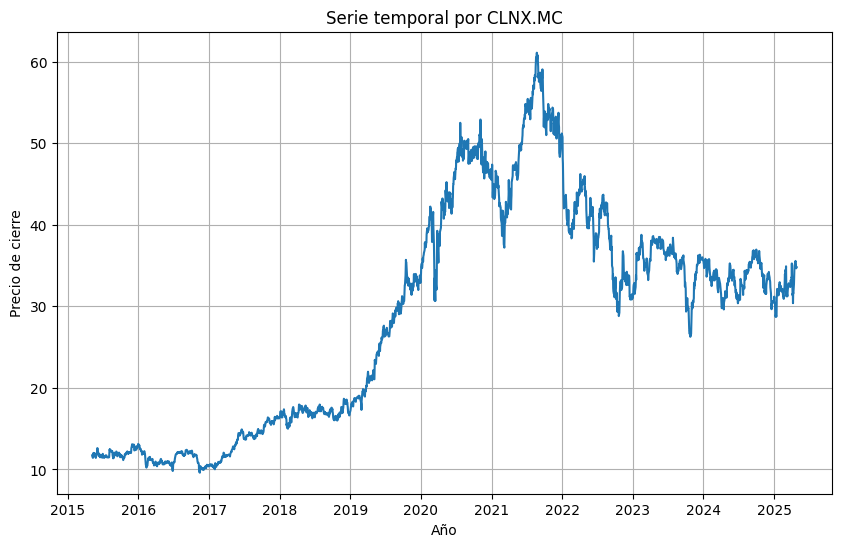

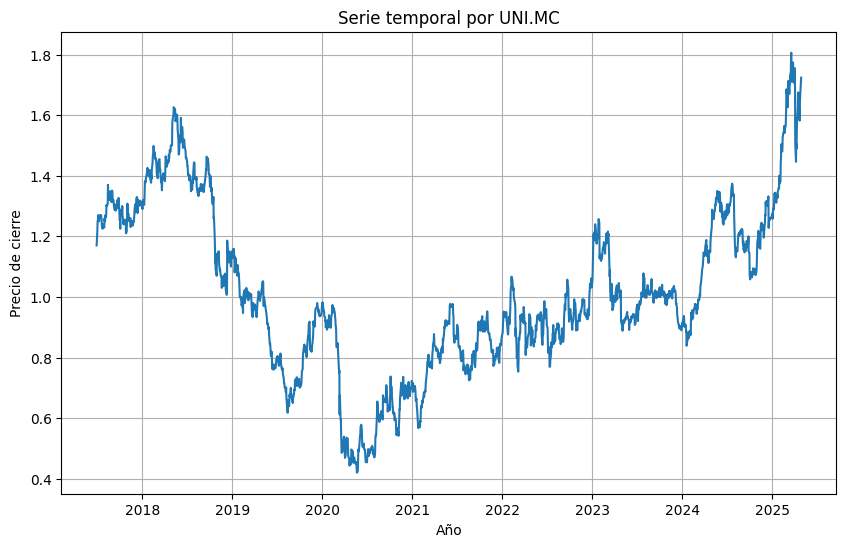

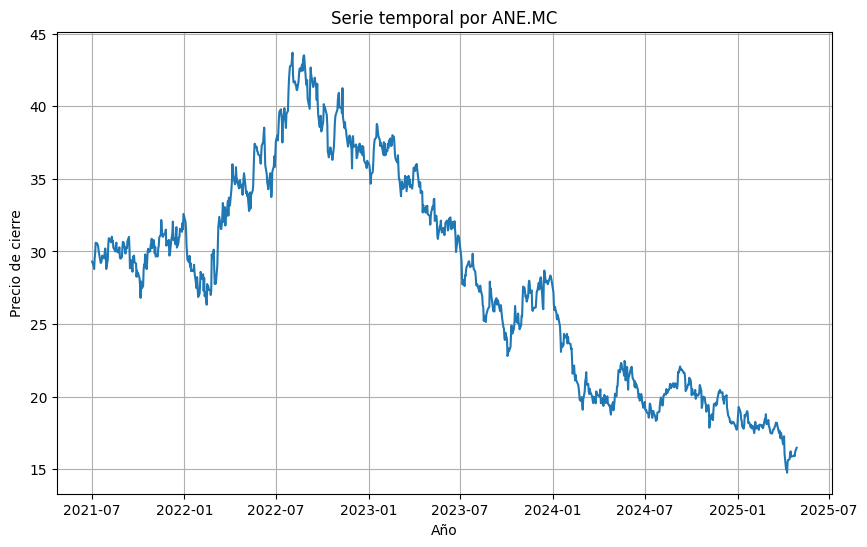

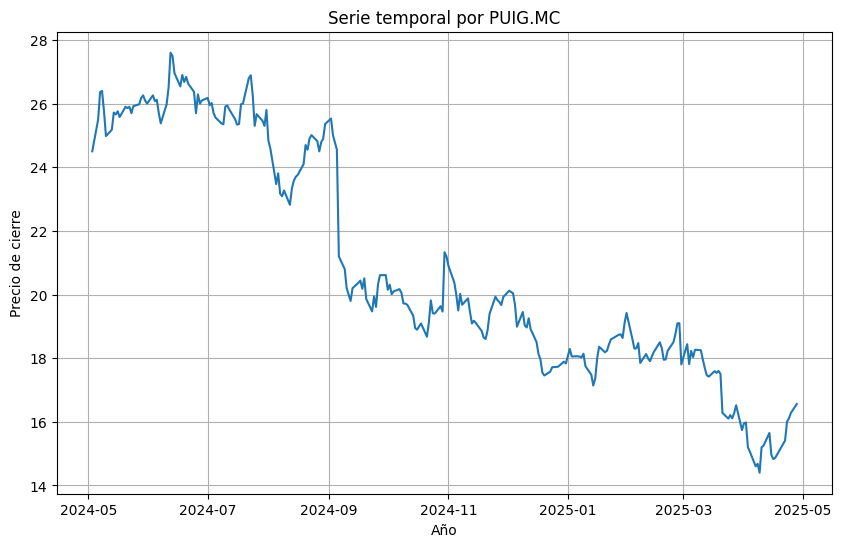

In [ ]:
for ticker in merged_df['Ticker'].unique():
    ticker_df = merged_df[merged_df['Ticker'] == ticker]
    plt.figure(figsize=(10, 6))
    plt.plot(ticker_df['Date'], ticker_df['Close'])
    plt.title(f'Serie temporal por {ticker}')
    plt.xlabel('Año')
    plt.ylabel('Precio de cierre')
    plt.grid(True)
    plt.show()


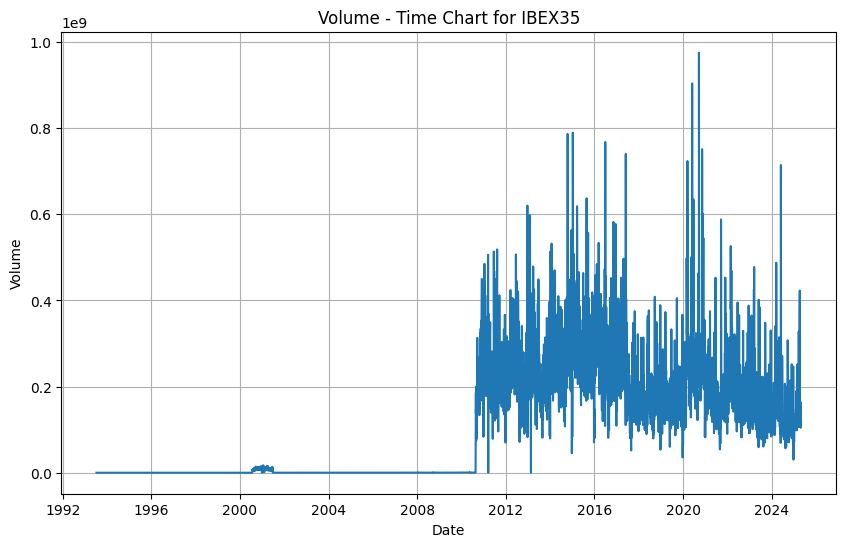

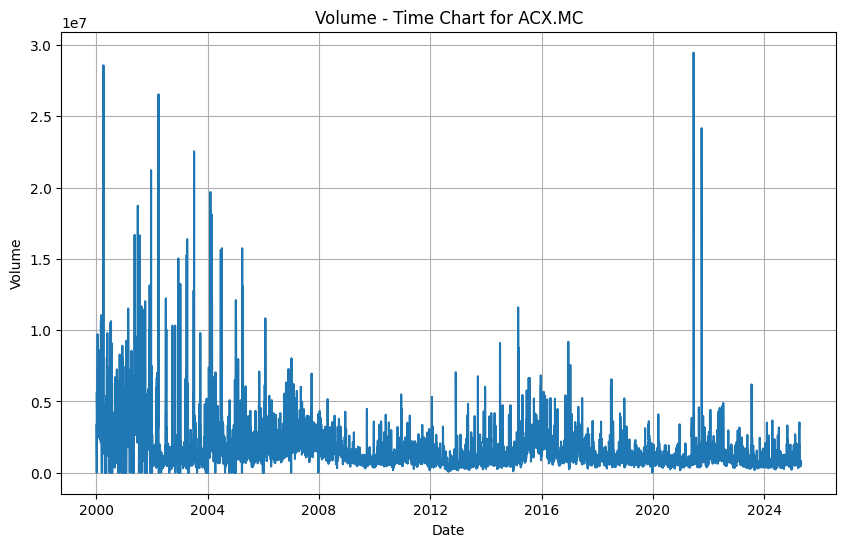

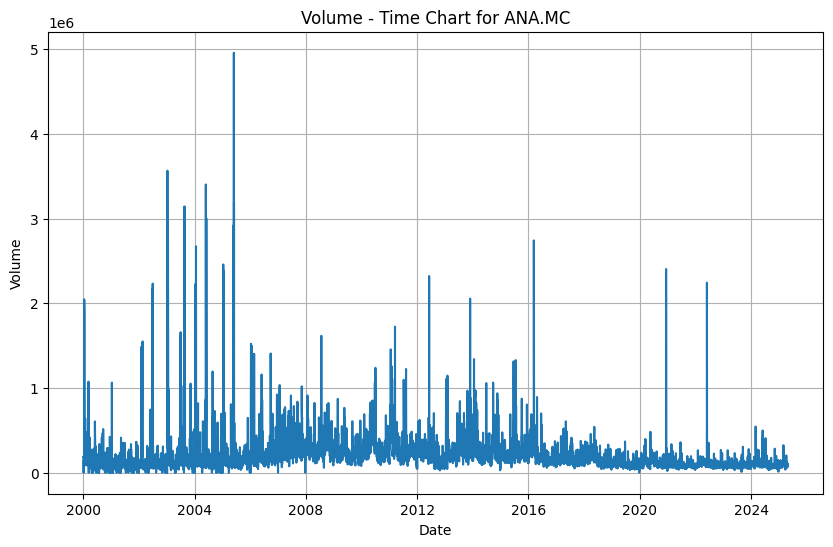

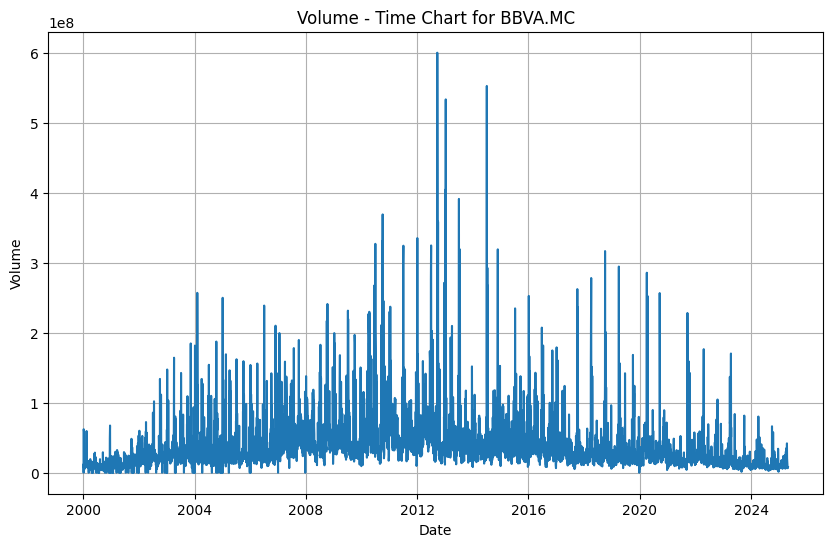

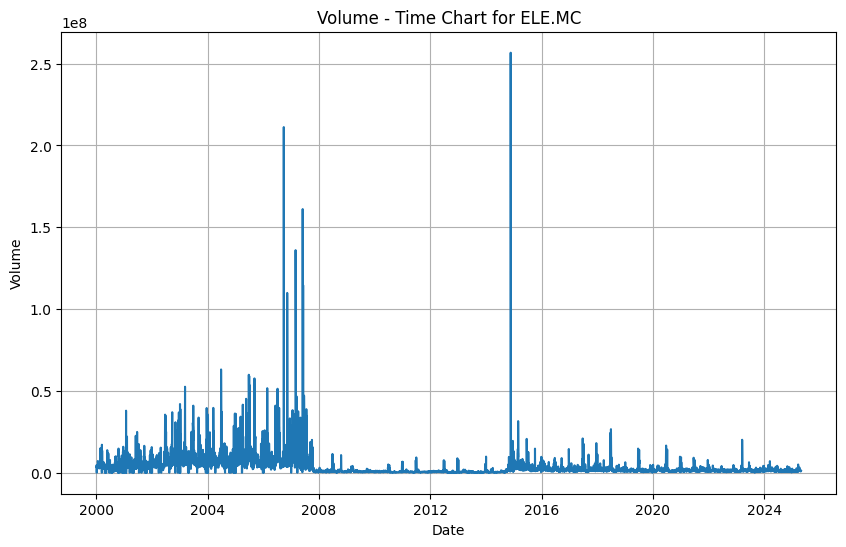

...

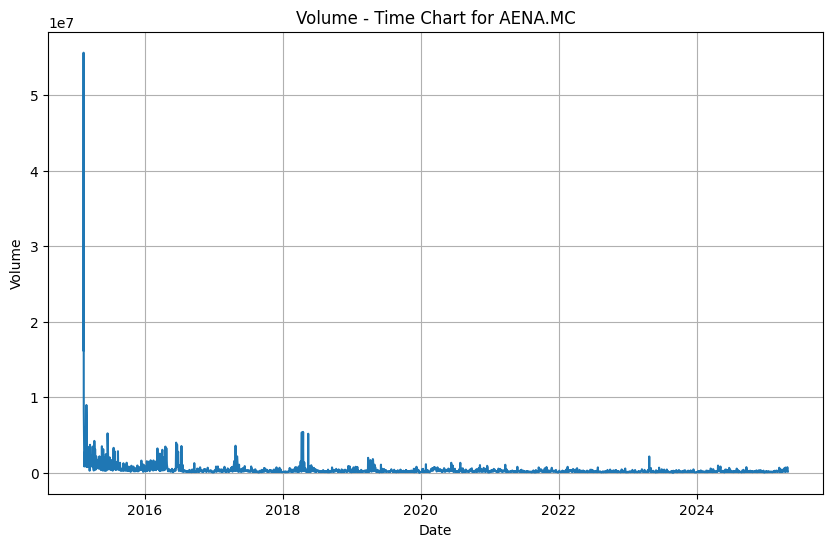

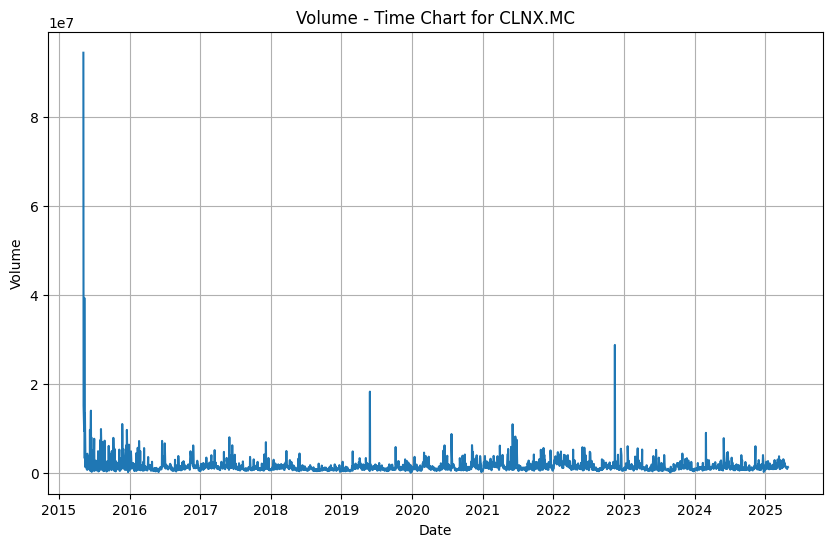

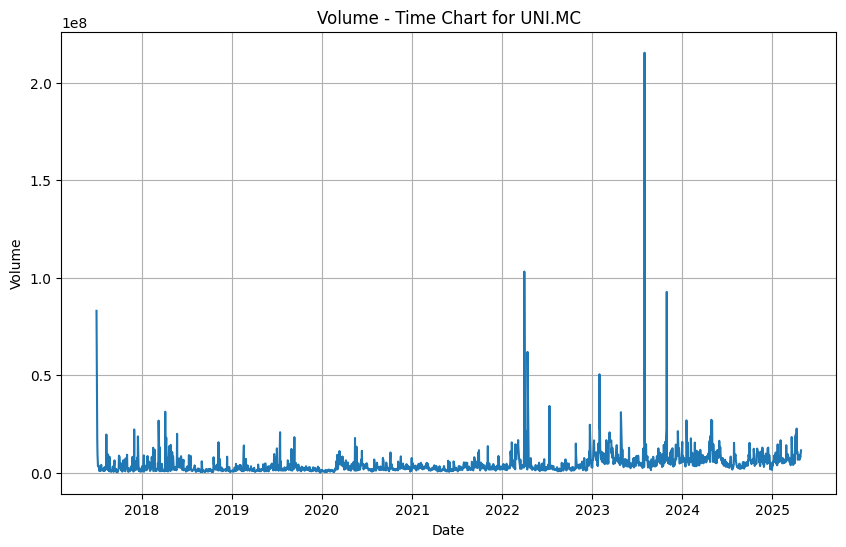

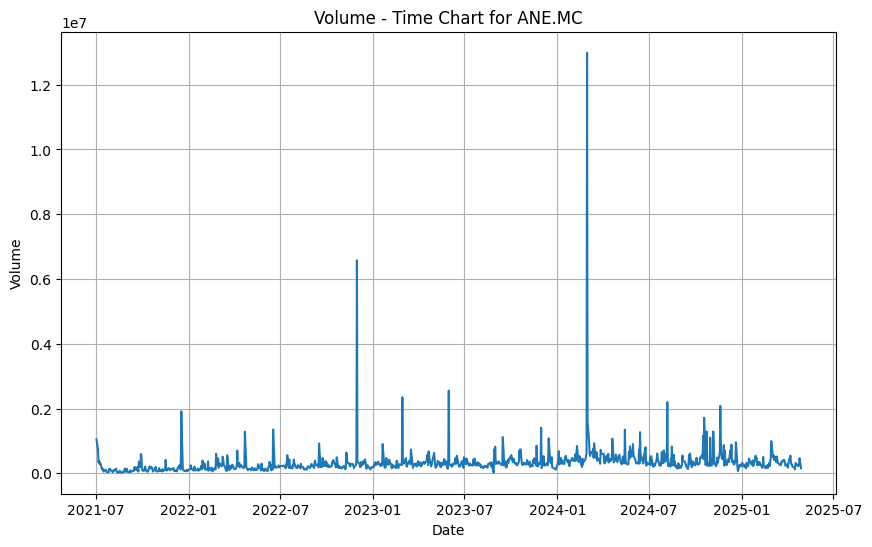

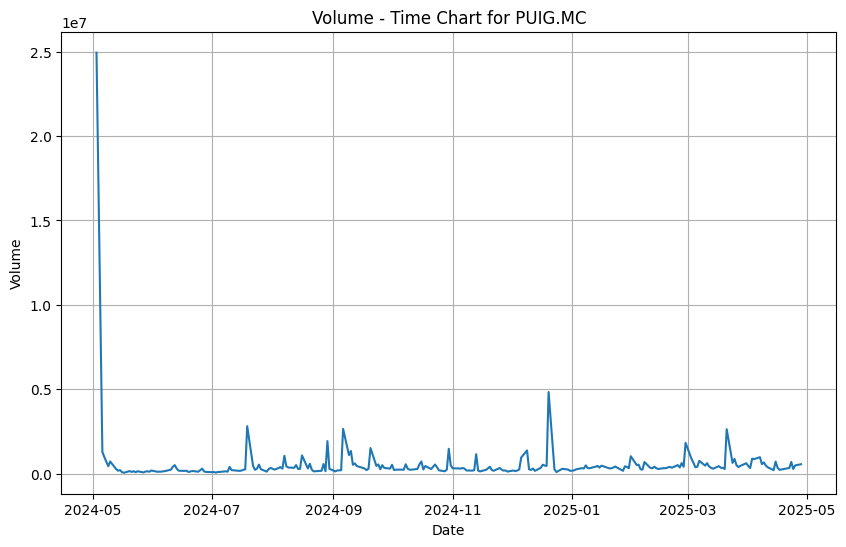

In [ ]:
# prompt: Plot one ticker volume - time chart per ticker

import matplotlib.pyplot as plt

for ticker in merged_df['Ticker'].unique():
    ticker_df = merged_df[merged_df['Ticker'] == ticker]
    plt.figure(figsize=(10, 6))
    plt.plot(ticker_df['Date'], ticker_df['Volume'])
    plt.title(f'Volume - Time Chart for {ticker}')
    plt.xlabel('Date')
    plt.ylabel('Volume')
    plt.grid(True)
    plt.show()


In [ ]:
# Group the DataFrame by 'Ticker' and get the number of rows for each ticker
rows_per_ticker = merged_df.groupby('Ticker').size().reset_index(name='Rows')

rows_per_ticker

,Ticker,Rows
0,ACS.MC,5980
1,ACX.MC,6502
2,AENA.MC,2612
3,AMS.MC,3838
4,ANA.MC,6502
5,ANE.MC,978
6,BBVA.MC,6502
7,BKT.MC,5087
8,CABK.MC,4483
9,CLNX.MC,2554


# RETURNS - STOCK DATA + MACRO US

---



In [ ]:
# Fixed
k_values = [1, 5, 10, 15, 20, 30, 60, 90, 180, 250, 360]
print("Valores de k fijos:", k_values)

# Definir los umbrales de decisión
thresholds_d = [0.01/100, 0.1/100, 0.2/100, 0.3/100, 0.5/100, 1/100, 2/100, 5/100, 10/100, 20/100,]
future_days = [30]
print("Umbrales de beneficio:", thresholds_d)
print("Días futuros a considerar:", future_days)

Valores de k fijos: [1, 5, 10, 15, 20, 30, 60, 90, 180, 250, 360]
Umbrales de beneficio: [0.0001, 0.001, 0.002, 0.003, 0.005, 0.01, 0.02, 0.05, 0.1, 0.2]
Días futuros a considerar: [30]


In [ ]:
# Filtrar datos de IBEX35
ibex_data = merged_df[index_df_final["Ticker"] == "IBEX35"].copy()
ibex_data = ibex_data.sort_values("Date").drop_duplicates()

# Calcular retornos pasados del IBEX35
for k in k_values:
    ibex_data[f"Past_Return_IBEX_{k}"] = ibex_data["Close"].pct_change(periods=k).shift(1)

# Calcular cambios relativos de las variables macroeconómicas
macro_vars = ["GDP", "Unemployment Rate", "Inflation (CPI)"]
for var in macro_vars:
    for k in k_values:
        ibex_data[f"Past_Change_{var.replace(' ', '_')}_{k}"] = ibex_data[var].shift(1).pct_change(periods=k)

# Lista para almacenar los resultados
stock_returns_list = []
relative_returns_list = []

# Filtrar todos los tickers excepto IBEX35
tickers = merged_df["Ticker"].unique()
tickers = [t for t in tickers if t != "IBEX35"]

# Procesar cada ticker
for ticker in tickers:
    df_ticker = merged_df[merged_df["Ticker"] == ticker].copy()
    df_ticker = df_ticker.sort_values("Date").drop_duplicates()

    # Calcular retornos pasados individuales
    for k in k_values:
        df_ticker[f"Past_Return_{k}"] = df_ticker["Close"].shift(1).pct_change(periods=k)

    stock_returns_list.append(df_ticker)

    # Unir datos del ticker con el IBEX35
    df_merged = df_ticker.merge(
        ibex_data[["Date"] + [f"Past_Return_IBEX_{k}" for k in k_values] + ["Close"] +
                  [f"Past_Change_{var.replace(' ', '_')}_{k}" for var in macro_vars for k in k_values]],
        on="Date", how="left", suffixes=("", "_IBEX")
    )

    # Calcular retornos relativos pasados
    for k in k_values:
        df_merged[f"Past_Rel_Return_{k}"] = df_merged[f"Past_Return_{k}"] - df_merged[f"Past_Return_IBEX_{k}"]

    # Añadir cambios relativos de las variables macro
    # (ya están disponibles en las columnas Past_Change_XXX, no necesitan más operaciones aquí)

    relative_returns_list.append(df_merged)

# Concatenar todos los datos
stock_returns_df = pd.concat(stock_returns_list, ignore_index=True).drop_duplicates()
relative_returns_df = pd.concat(relative_returns_list, ignore_index=True).drop_duplicates()

<ipython-input-92-27a5e3deef82>:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  ibex_data = merged_df[index_df_final["Ticker"] == "IBEX35"].copy()


In [ ]:
# Listado de columnas de retornos relativos
past_returns_cols = [col for col in relative_returns_df.columns if 'Past_Rel_Return' in col]

In [ ]:
ibex_data.columns

Index(['Date', 'Open', 'High', 'Low', 'Close', 'Volume', 'Dividends',
       'Stock Splits', 'Ticker', 'GDP', 'Unemployment Rate', 'Inflation (CPI)',
       'Past_Return_IBEX_1', 'Past_Return_IBEX_5', 'Past_Return_IBEX_10',
       'Past_Return_IBEX_15', 'Past_Return_IBEX_20', 'Past_Return_IBEX_30',
       'Past_Return_IBEX_60', 'Past_Return_IBEX_90', 'Past_Return_IBEX_180',
       'Past_Return_IBEX_250', 'Past_Return_IBEX_360', 'Past_Change_GDP_1',
       'Past_Change_GDP_5', 'Past_Change_GDP_10', 'Past_Change_GDP_15',
       'Past_Change_GDP_20', 'Past_Change_GDP_30', 'Past_Change_GDP_60',
       'Past_Change_GDP_90', 'Past_Change_GDP_180', 'Past_Change_GDP_250',
       'Past_Change_GDP_360', 'Past_Change_Unemployment_Rate_1',
       'Past_Change_Unemployment_Rate_5', 'Past_Change_Unemployment_Rate_10',
       'Past_Change_Unemployment_Rate_15', 'Past_Change_Unemployment_Rate_20',
       'Past_Change_Unemployment_Rate_30', 'Past_Change_Unemployment_Rate_60',
       'Past_Change_Unempl

In [ ]:
ibex_data[(ibex_data['Date'].isin(['2025-04-01', '2025-03-31',
                  '2025-03-26', '2025-03-25',
                  '2025-03-24', '2025-03-21']))][['Date', 'Close', 'Past_Return_IBEX_90']]

<ipython-input-95-c69e3c095651>:1: FutureWarning: The behavior of 'isin' with dtype=datetime64[ns] and castable values (e.g. strings) is deprecated. In a future version, these will not be considered matching by isin. Explicitly cast to the appropriate dtype before calling isin instead.
  ibex_data[(ibex_data['Date'].isin(['2025-04-01', '2025-03-31',


,Date,Close,Past_Return_IBEX_90
183428,2025-03-21,13350.200195,0.147362
183464,2025-03-24,13323.299805,0.172860
183500,2025-03-25,13484.299805,0.171063
183536,2025-03-26,13432.200195,0.170075
183644,2025-03-31,13135.400391,0.148502
183680,2025-04-01,13297.000000,0.133388


In [ ]:
 relative_returns_df[(relative_returns_df['Ticker'] == 'ITX.MC') &
                                (relative_returns_df['Date']
                                 .isin(['2025-04-01', '2025-03-31',
                                        '2025-03-26', '2025-03-25',
                                        '2025-03-24', '2025-03-21']))][['Date', 'Close', 'Past_Return_90', 'Past_Rel_Return_90']]

<ipython-input-96-f8a21fa3816d>:3: FutureWarning: The behavior of 'isin' with dtype=datetime64[ns] and castable values (e.g. strings) is deprecated. In a future version, these will not be considered matching by isin. Explicitly cast to the appropriate dtype before calling isin instead.
  .isin(['2025-04-01', '2025-03-31',


,Date,Close,Past_Return_90,Past_Rel_Return_90
83942,2025-03-21,46.730000,-0.081373,-0.228734
83943,2025-03-24,47.000000,-0.070605,-0.243465
83944,2025-03-25,46.430000,-0.074074,-0.245137
83945,2025-03-26,46.810001,-0.089965,-0.260040
83948,2025-03-31,45.849998,-0.094949,-0.243451
83949,2025-04-01,46.189999,-0.105889,-0.239277


In [ ]:
 relative_returns_df[(relative_returns_df['Ticker'] == 'REP.MC') &
                                (relative_returns_df['Date']
                                 .isin(['2025-03-03', '2025-02-28',
                                        '2025-02-27', '2025-02-21',
                                        '2025-02-20']))][['Date', 'Inflation (CPI)', 'Past_Change_Inflation_(CPI)_90']]

<ipython-input-97-2947aae91745>:3: FutureWarning: The behavior of 'isin' with dtype=datetime64[ns] and castable values (e.g. strings) is deprecated. In a future version, these will not be considered matching by isin. Explicitly cast to the appropriate dtype before calling isin instead.
  .isin(['2025-03-03', '2025-02-28',


,Date,Inflation (CPI),Past_Change_Inflation_(CPI)_90
51970,2025-02-20,319.666429,0.012103
51971,2025-02-21,319.660714,0.011810
51975,2025-02-27,319.626429,0.011336
51976,2025-02-28,319.620714,0.011044
51977,2025-03-03,319.615000,0.010935


In [ ]:
%%capture
df_labeled = relative_returns_df.copy()

for d in thresholds_d:
    for k in future_days:
        col_label = f"Label_d_{d*100:.1f}_k_{k}"

        # Retorno futuro relativo verdadero
        df_labeled[col_label] = (
            df_labeled.groupby("Ticker").apply(
                lambda g: (g["Close"].shift(-k) / g["Close"] - 1) -
                          (g["Close_IBEX"].shift(-k) / g["Close_IBEX"] - 1)
            ).reset_index(level=0, drop=True) > d
        ).astype(int)

In [ ]:
p1_table = pd.DataFrame(index=df_labeled["Ticker"].unique())

for d in thresholds_d:
    col_values = []

    for ticker in df_labeled["Ticker"].unique():
        subset = df_labeled[df_labeled["Ticker"] == ticker]
        label_cols = [f"Label_d_{d*100:.1f}_k_{k}" for k in future_days]
        p1_value = subset[label_cols].mean().mean()
        col_values.append(p1_value)

    p1_table[f"p1 d={d*100:.1f}%"] = col_values

p1_table.loc["Average"] = p1_table.mean()

p1_table

,p1 d=0.0%,p1 d=0.1%,p1 d=0.2%,p1 d=0.3%,p1 d=0.5%,p1 d=1.0%,p1 d=2.0%,p1 d=5.0%,p1 d=10.0%,p1 d=20.0%
ACX.MC,0.465088,0.460166,0.456167,0.450323,0.440326,0.412488,0.364811,0.243464,0.104429,0.011689
ANA.MC,0.502153,0.497078,0.491233,0.485235,0.475700,0.450938,0.404645,0.278068,0.127499,0.019532
BBVA.MC,0.467241,0.457244,0.449862,0.443710,0.427099,0.387419,0.319748,0.171947,0.057367,0.009382
ELE.MC,0.518456,0.512612,0.504460,0.497232,0.483082,0.449093,0.379576,0.211781,0.063058,0.004614
IBE.MC,0.535528,0.529068,0.521378,0.514149,0.498001,0.461089,0.389111,0.197939,0.062596,0.003999
NTGY.MC,0.503230,0.497847,0.489234,0.481544,0.469240,0.435712,0.375115,0.221163,0.076746,0.008151
RED.MC,0.552445,0.547216,0.541372,0.534759,0.521532,0.484159,0.424023,0.244233,0.074285,0.009997
REP.MC,0.470317,0.464780,0.459397,0.454322,0.442787,0.410950,0.350046,0.200861,0.069209,0.013073
SAN.MC,0.460474,0.451553,0.441864,0.433251,0.414795,0.369271,0.296832,0.157644,0.051061,0.006767
SCYR.MC,0.473085,0.470009,0.465549,0.461704,0.453553,0.431867,0.393571,0.291141,0.168717,0.057367


In [ ]:
df_labeled = df_labeled.sort_values(by=['Ticker', 'Date']).reset_index(drop=True)

# PREANALYSIS

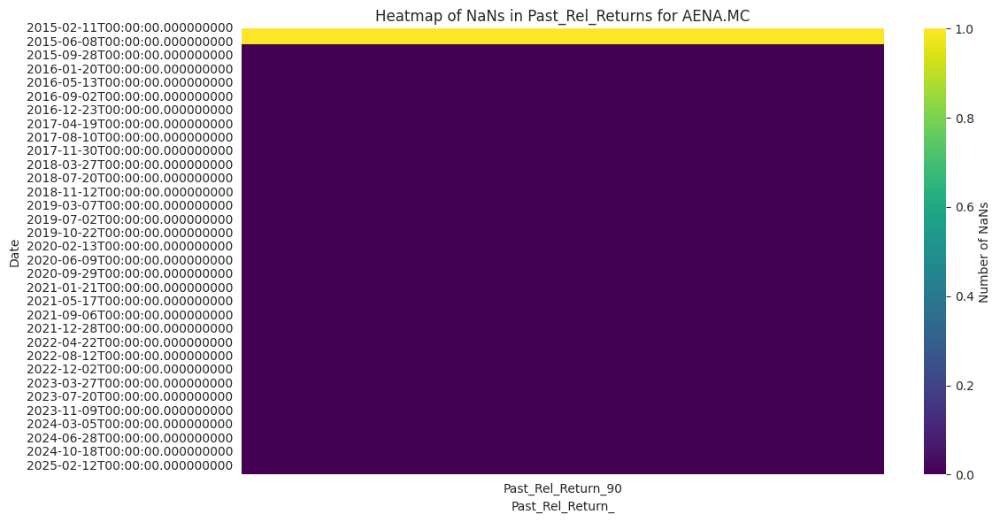

In [ ]:
# prompt: Show a heatmap per date of df_signal about NaNs in past_rel_returns for 1 example ticker

import matplotlib.pyplot as plt
import seaborn as sns

# Select a sample ticker
sample_ticker = df_labeled['Ticker'].unique()[2]  # Replace with the desired ticker

# Filter the DataFrame for the sample ticker
df_ticker = df_labeled[df_labeled['Ticker'] == sample_ticker].copy()

# Create a pivot table to show NaN counts per date
nan_counts = df_ticker.pivot_table(index='Date', values='Past_Rel_Return_90', aggfunc=lambda x: x.isna().sum())

# Create the heatmap
plt.figure(figsize=(12, 6))
sns.heatmap(nan_counts, cmap='viridis', cbar_kws={'label': 'Number of NaNs'})
plt.title(f'Heatmap of NaNs in Past_Rel_Returns for {sample_ticker}')
plt.xlabel('Past_Rel_Return_')  # Replace with the actual column name if different
plt.ylabel('Date')
plt.tight_layout()
plt.show()


<ipython-input-200-6d8fcfed27ba>:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Ticker', y='Past_Rel_Return_90', data=df_labeled, palette='pastel')


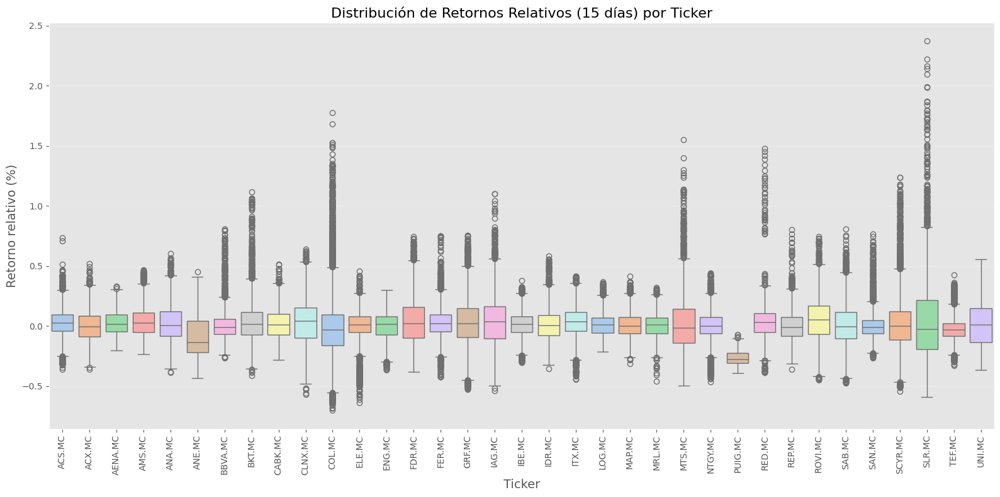

In [ ]:
plt.figure(figsize=(16,8))
sns.boxplot(x='Ticker', y='Past_Rel_Return_90', data=df_labeled, palette='pastel')
plt.title('Distribución de Retornos Relativos (15 días) por Ticker', fontsize=16)
plt.xlabel('Ticker', fontsize=14)
plt.ylabel('Retorno relativo (%)', fontsize=14)
plt.xticks(rotation=90)
plt.grid(axis='y', alpha=0.3)
plt.tight_layout()
plt.show()

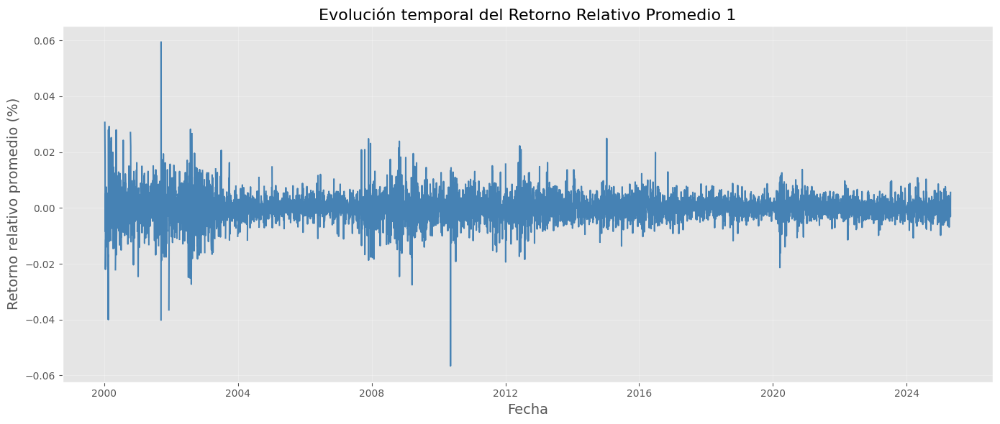

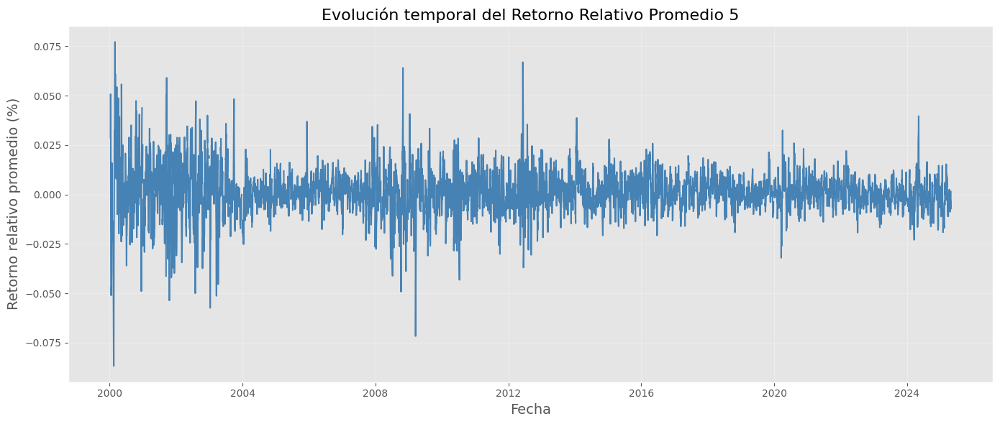

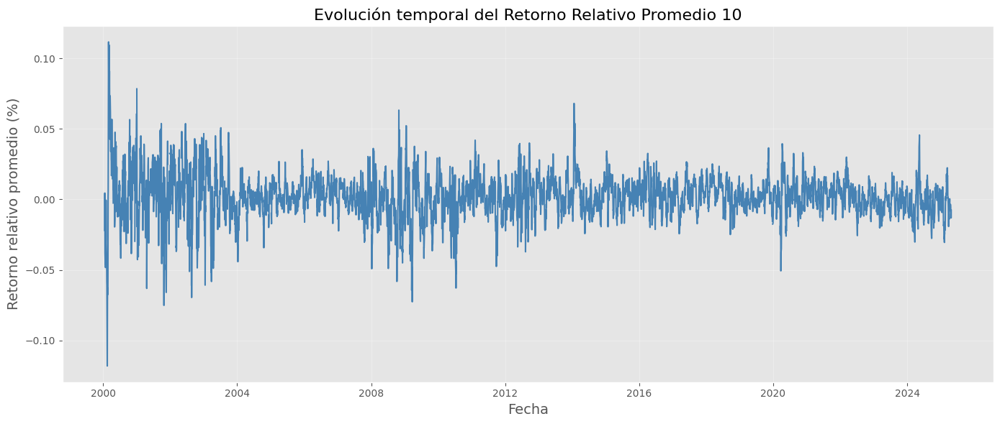

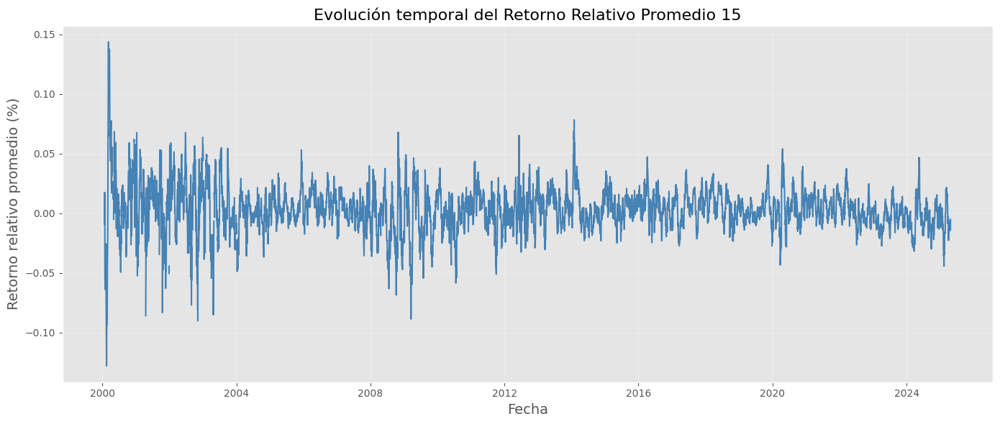

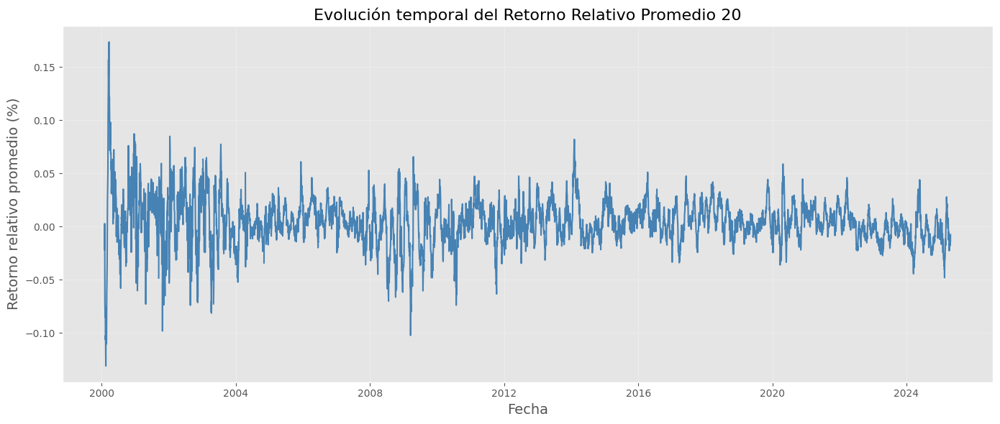

...

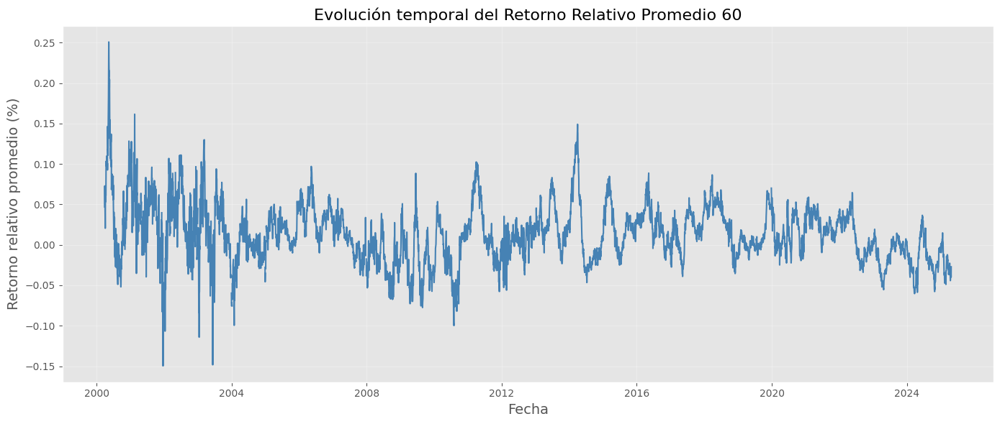

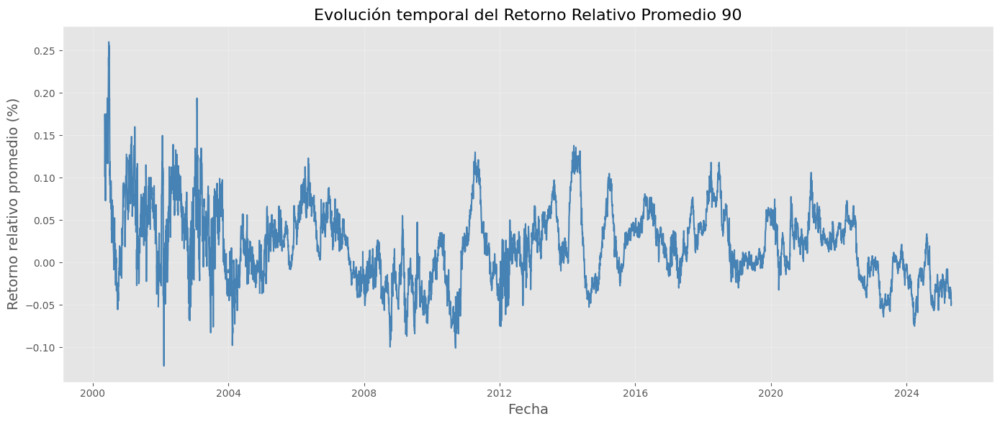

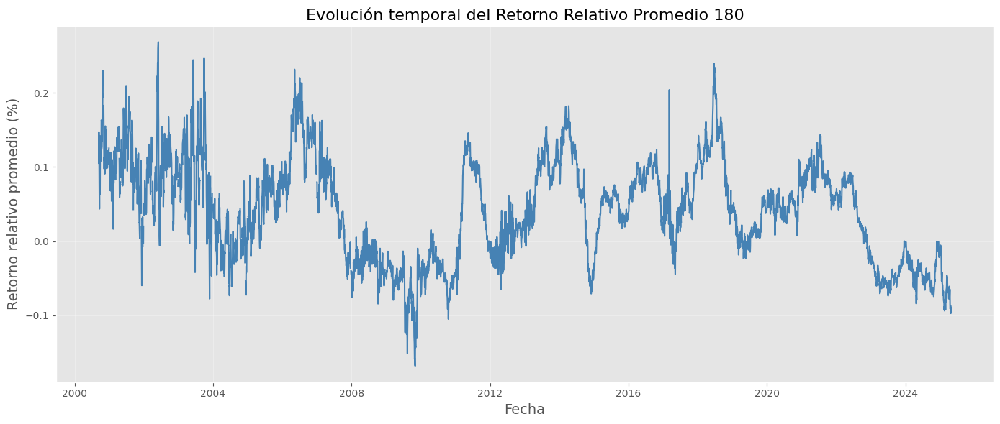

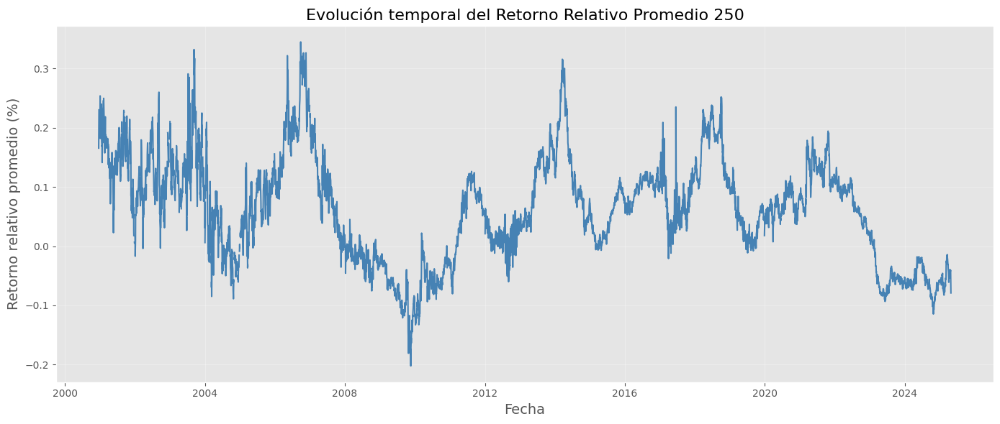

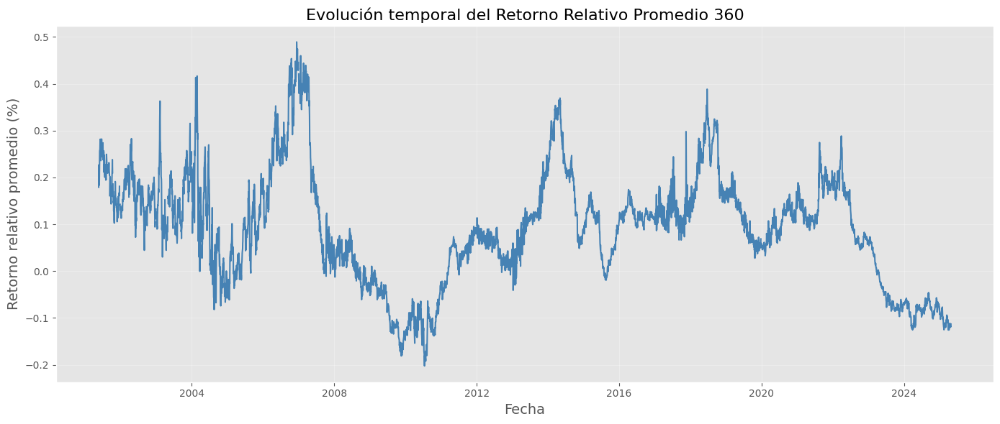

In [ ]:
for returns in past_returns_cols:
  df_grouped = df_labeled.groupby('Date')[returns].mean()

  plt.figure(figsize=(14,6))
  plt.plot(df_grouped.index, df_grouped, color='steelblue')
  plt.title(f'Evolución temporal del Retorno Relativo Promedio {returns.replace("Past_Rel_Return_", "")}', fontsize=16)
  plt.xlabel('Fecha', fontsize=14)
  plt.ylabel('Retorno relativo promedio (%)', fontsize=14)
  plt.grid(True, alpha=0.3)
  plt.tight_layout()
  plt.show()

<ipython-input-202-520bf6e6887a>:52: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


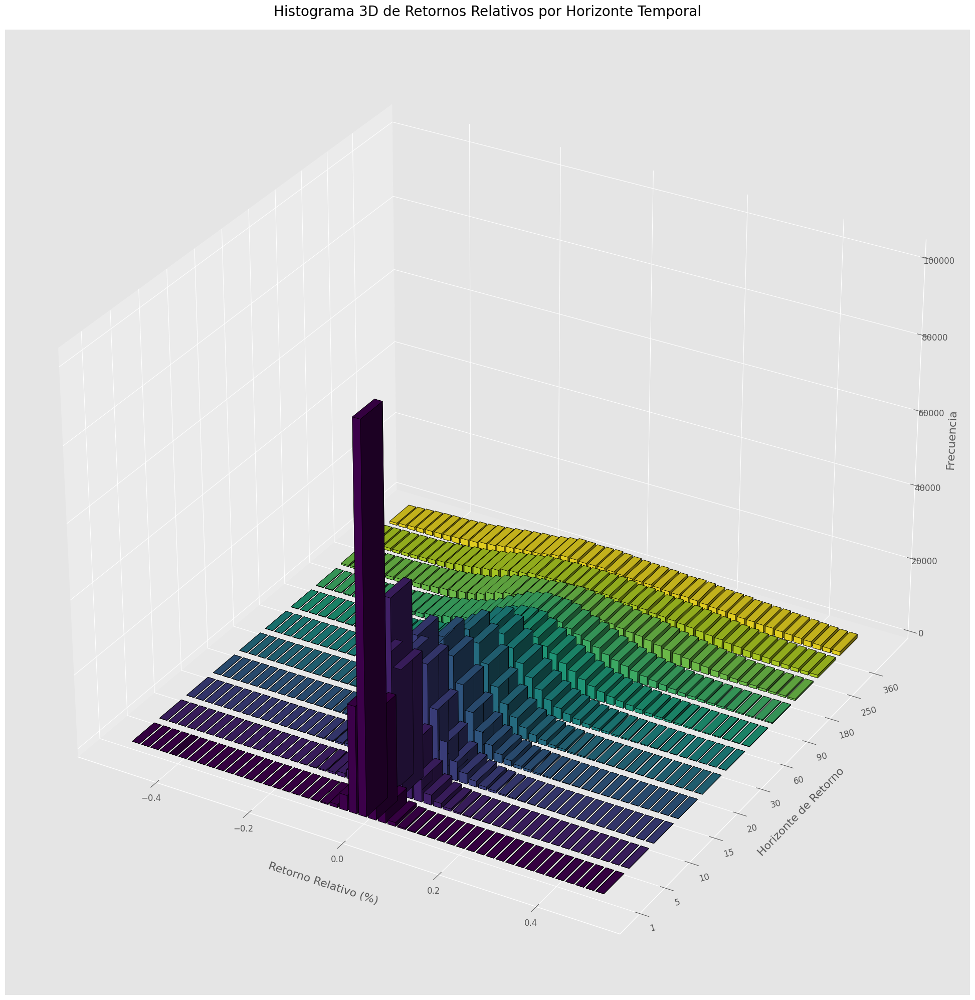

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D


# Definir bins comunes
bins = np.linspace(-0.5, 0.5, 50)  # Ajusta si necesitas más o menos dispersión

# Crear la figura
fig = plt.figure(figsize=(30, 25))
ax = fig.add_subplot(111, projection='3d')

# Posiciones para cada retorno relativo en el eje Y (profundidad)
z_positions = np.arange(len(past_returns_cols)) * 2.5  # Separación mayor entre etiquetas

# Ancho de cada barra
dx = (bins[1] - bins[0]) * 0.8
dy = 2.0  # Igual al espacio entre retornos, para que no se solapen

# Colores alternos para diferenciar mejor
colors = plt.cm.viridis(np.linspace(0, 1, len(past_returns_cols)))

# Loop para cada tipo de retorno
for i, (col, color) in enumerate(zip(past_returns_cols, colors)):
    data = df_labeled[col].dropna()
    hist, edges = np.histogram(data, bins=bins)

    xs = edges[:-1]
    ys = np.full_like(xs, z_positions[i])
    zs = np.zeros_like(xs)
    ax.bar3d(xs, ys, zs, dx, dy, hist, shade=True, color=color, edgecolor='black')

# Etiquetas de ejes
ax.set_xlabel('Retorno Relativo (%)', fontsize=16, labelpad=20)
ax.set_ylabel('Horizonte de Retorno', fontsize=16, labelpad=20)
ax.set_zlabel('Frecuencia', fontsize=16, labelpad=10)

# Mejorar las etiquetas en el eje Y (profundidad)
ax.set_yticks(z_positions)
new_returns_cols = [col.replace("Past_Rel_Return_", "") for col in past_returns_cols]
new_returns_cols
ax.set_yticklabels(new_returns_cols, fontsize=12, rotation=15, ha='left')

# Mejorar visualmente
ax.tick_params(axis='x', labelsize=12)
ax.tick_params(axis='z', labelsize=12)
ax.view_init(elev=30, azim=-60)  # Mejor ángulo de visión 3D
ax.grid(True)

# Título
plt.title('Histograma 3D de Retornos Relativos por Horizonte Temporal', fontsize=20, pad=20)
plt.tight_layout()
plt.show()


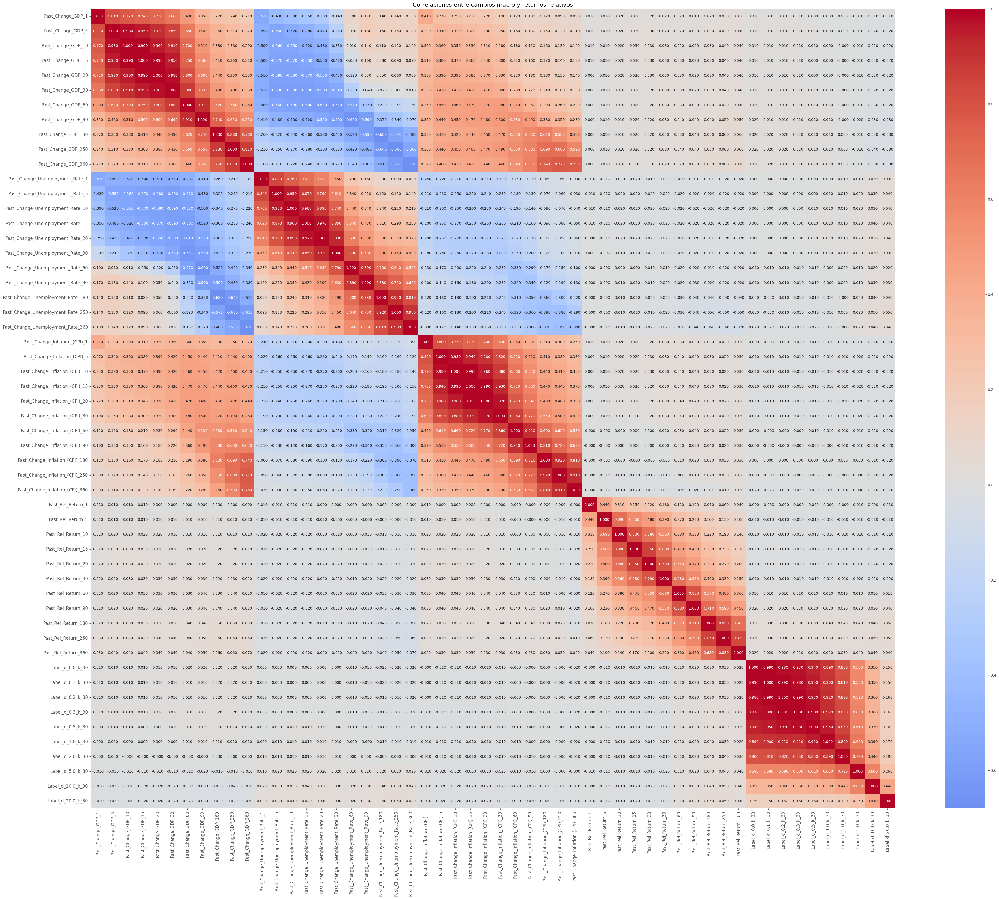

In [ ]:
# Selecciona solo las columnas relevantes
correlation_cols = [col for col in df_labeled.columns if 'Past_Change_' in col
                    or 'Past_Rel_Return_' in col
                    or 'Label_d_' in col]
corr_matrix = df_labeled[correlation_cols].corr().round(2)

plt.figure(figsize=(50, 40))
sns.heatmap(corr_matrix, cmap='coolwarm', center=0, annot=True, fmt=".3f", # Formato de anotaciones
            annot_kws={"size": 10})  # Tamaño de la anotación
plt.title("Correlaciones entre cambios macro y retornos relativos", fontsize=16) # Ajustar tamaño del título
plt.xticks(fontsize=12) # Tamaño de etiquetas en el eje x
plt.yticks(fontsize=12) # Tamaño de etiquetas en el eje y
plt.show()

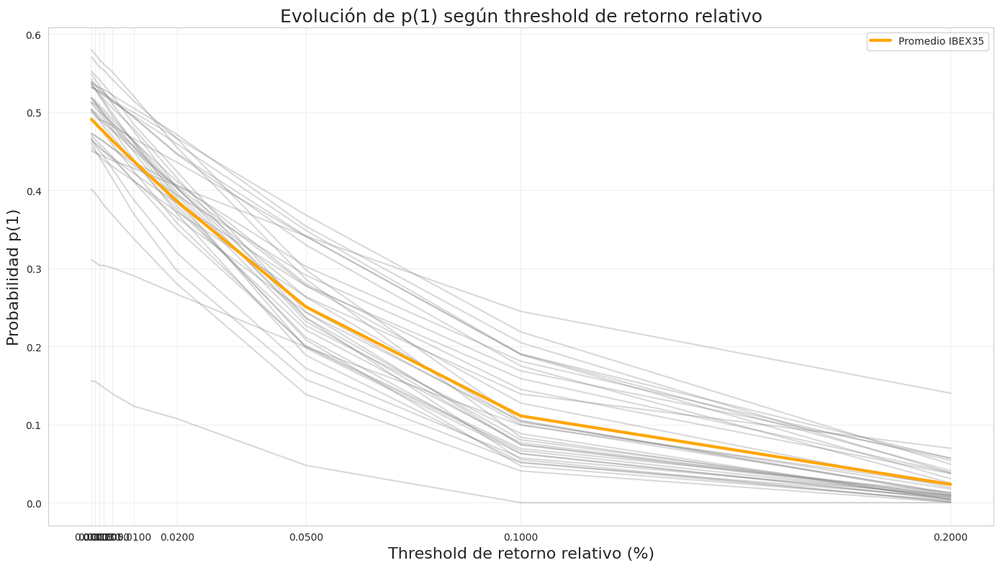

In [ ]:
# Gráfico
plt.figure(figsize=(14,8))

for ticker in p1_table.index[:-1]:  # Excluye 'Average'
    plt.plot(thresholds_d, p1_table.loc[ticker].values, alpha=0.3, color='gray')

# Añadir la línea del promedio en color destacado
plt.plot(thresholds_d, p1_table.loc['Average'].values, label='Promedio IBEX35', color='orange', linewidth=3)

# Estética
plt.title('Evolución de p(1) según threshold de retorno relativo', fontsize=18)
plt.xlabel('Threshold de retorno relativo (%)', fontsize=16)
plt.ylabel('Probabilidad p(1)', fontsize=16)
plt.grid(True, alpha=0.3)
plt.legend()
plt.xticks(thresholds_d)
plt.tight_layout()
plt.show()

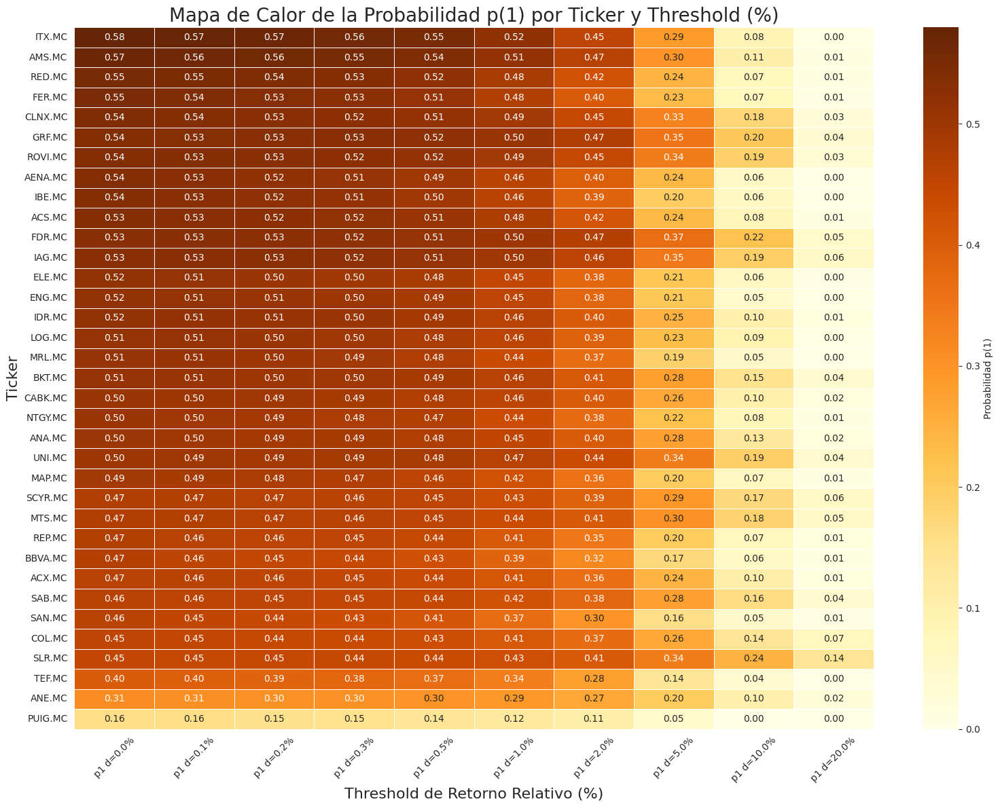

In [ ]:
# Cargar el DataFrame de tu tabla
df_p1 = p1_table.copy()

# Opcional: eliminar fila 'Average' para enfocarnos solo en tickers
df_p1 = df_p1.drop('Average', axis=0)

# Ordenar tickers por p(1) en el primer threshold (0.1%)
df_p1_sorted = df_p1.sort_values(by=df_p1.columns[0], ascending=False)


# Crear el heatmap
plt.figure(figsize=(16, 12))
sns.heatmap(
    df_p1_sorted,
    cmap="YlOrBr",         # Colores: de amarillo a azul
    annot=True,            # Mostrar los valores numéricos
    fmt=".2f",             # Formato dos decimales
    linewidths=0.5,        # Líneas divisorias
    cbar_kws={'label': 'Probabilidad p(1)'}  # Etiqueta de la barra de color
)

# Estética
plt.title('Mapa de Calor de la Probabilidad p(1) por Ticker y Threshold (%)', fontsize=20)
plt.xlabel('Threshold de Retorno Relativo (%)', fontsize=16)
plt.ylabel('Ticker', fontsize=16)
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

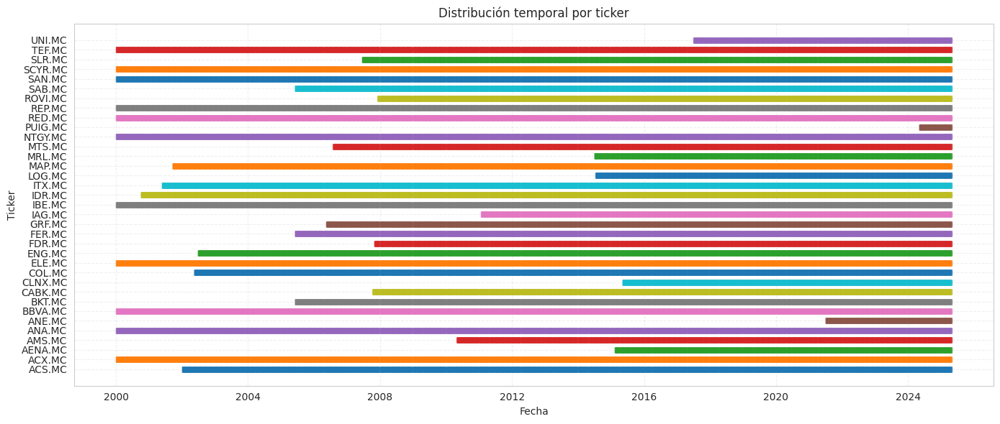

In [ ]:
plt.figure(figsize=(14, 6))
for ticker in df_labeled['Ticker'].unique():
    subset = df_labeled[df_labeled['Ticker'] == ticker]
    plt.plot(subset['Date'], [ticker]*len(subset), '|', alpha=0.5)

plt.title("Distribución temporal por ticker")
plt.xlabel("Fecha")
plt.ylabel("Ticker")
plt.grid(True, linestyle='--', alpha=0.3)
plt.tight_layout()
plt.show()


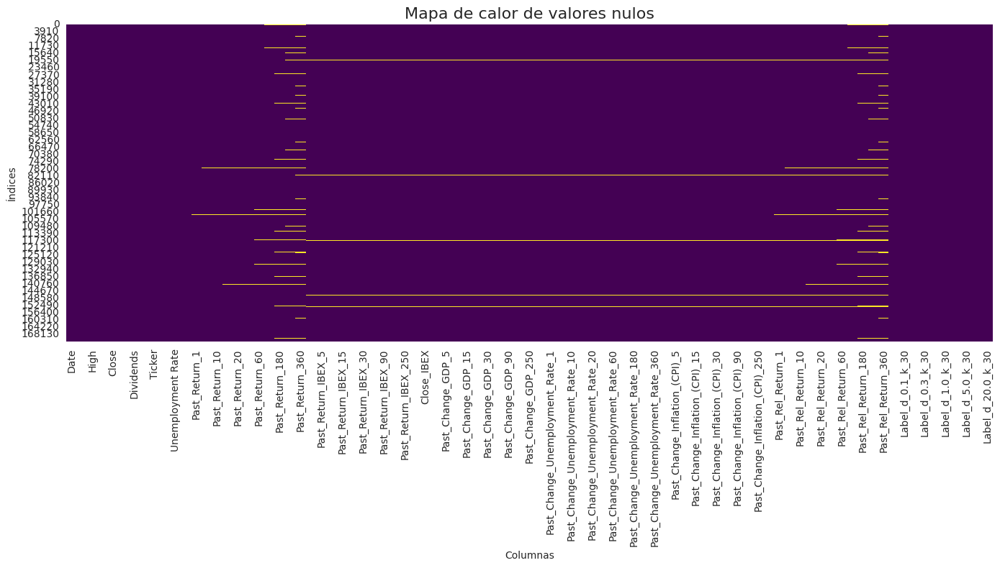

In [ ]:
# Mapa de calor
plt.figure(figsize=(14, 8))
sns.heatmap(df_labeled.isnull(), cbar=False, cmap='viridis')
plt.title("Mapa de calor de valores nulos", fontsize=16)
plt.xlabel("Columnas")
plt.ylabel("Índices")
plt.tight_layout()
plt.show()

In [ ]:
# Tabla resumen de nulos
null_summary = df_labeled.isnull().sum().to_frame(name='Nulos')
null_summary['Porcentaje'] = 100 * null_summary['Nulos'] / len(df_labeled)
null_summary = null_summary[null_summary['Nulos'] > 0].sort_values('Porcentaje', ascending=False)
null_summary

,Nulos,Porcentaje
Past_Rel_Return_360,13307,7.736133
Past_Return_360,12525,7.281511
Past_Rel_Return_250,9661,5.616501
Past_Return_250,8785,5.107232
Past_Rel_Return_180,7269,4.225893
...,...,...
Past_Return_20,735,0.427298
Past_Return_15,560,0.325561
Past_Return_10,385,0.223823
Past_Return_5,210,0.122085


<ipython-input-112-980a0bd2730e>:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=null_pct.values, y=null_pct.index, palette="rocket")


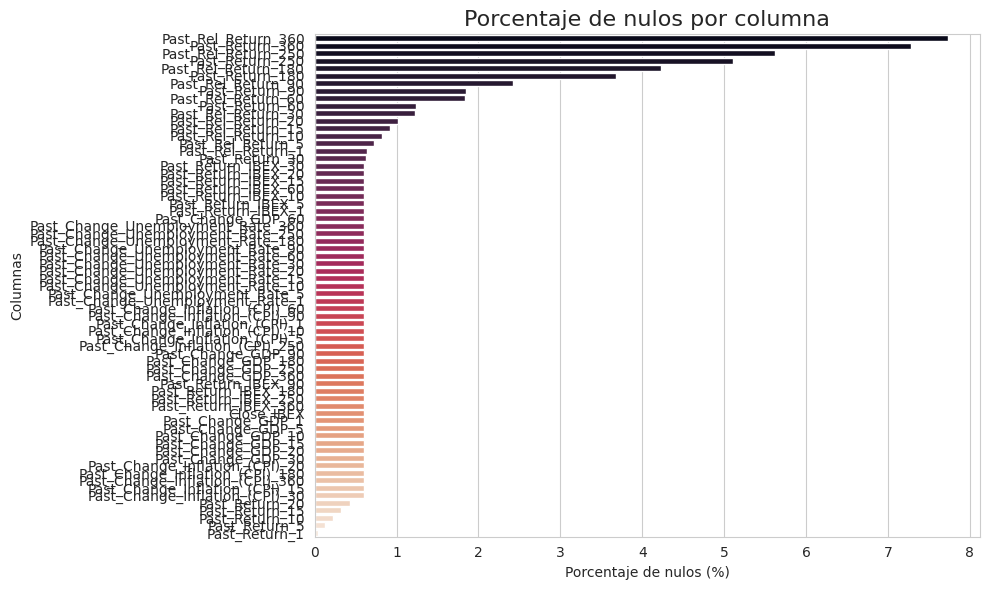

In [ ]:
# % de nulos por columna
null_pct = df_labeled.isnull().mean().sort_values(ascending=False) * 100
null_pct = null_pct[null_pct > 0]  # Filtrar solo columnas con nulos

# Gráfico de barras
plt.figure(figsize=(10, 6))
sns.barplot(x=null_pct.values, y=null_pct.index, palette="rocket")
plt.title("Porcentaje de nulos por columna", fontsize=16)
plt.xlabel("Porcentaje de nulos (%)")
plt.ylabel("Columnas")
plt.tight_layout()
plt.show()

In [ ]:
# % de nulos por ticker
nulls_by_ticker = df_labeled.groupby("Ticker").apply(lambda g: g.isnull().mean().mean() * 100)

# Visualización
plt.figure(figsize=(12, 6))
nulls_by_ticker.sort_values(ascending=False).plot(kind='bar', color='salmon')
plt.title("Porcentaje medio de nulos por ticker", fontsize=16)
plt.ylabel("Porcentaje (%)")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()

In [ ]:
feature_cols = [col for col in df_labeled.columns if 'Past_Rel_Return' in col]

In [ ]:
# PCA sobre retornos relativos
df_pca = df_labeled[feature_cols].dropna()
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(df_pca)

# Componentes PCA
pca = PCA(n_components=2)
pca_result = pca.fit_transform(scaled_data)
pca_df = pd.DataFrame(pca_result, columns=["PCA1", "PCA2"])

# Plot
plt.figure(figsize=(8, 6))
sns.scatterplot(data=pca_df, x="PCA1", y="PCA2", alpha=0.3)
plt.title("Reducción de dimensionalidad PCA (retornos relativos)")
plt.tight_layout()
plt.show()


In [ ]:
# t-SNE sobre los datos escalados
tsne = TSNE(n_components=2, perplexity=30, max_iter=250, method='barnes_hut', random_state=seed)
tsne_result = tsne.fit_transform(scaled_data)
tsne_df = pd.DataFrame(tsne_result, columns=["tSNE1", "tSNE2"])

# Visualización de t-SNE
plt.figure(figsize=(8, 6))
sns.scatterplot(data=tsne_df, x="tSNE1", y="tSNE2", alpha=0.3)
plt.title("Reducción de dimensionalidad t-SNE (retornos relativos)")
plt.tight_layout()
plt.show()

In [ ]:
# Visualización combinada de PCA y t-SNE
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# PCA
sns.scatterplot(data=pca_df, x="PCA1", y="PCA2", ax=axes[0], alpha=0.3)
axes[0].set_title("PCA")

# t-SNE
sns.scatterplot(data=tsne_df, x="tSNE1", y="tSNE2", ax=axes[1], alpha=0.3)
axes[1].set_title("t-SNE")

plt.tight_layout()
plt.show()

# CLASSIFICATION

## INITIALIZE

In [ ]:
summary_df = pd.DataFrame()
beta = 1
n_splits = 5
k = future_days[0]
label_col = f'Label_d_0.1_k_{k}'

quantile = 80
feature_cols = [col for col in df_labeled.columns if 'Past_Rel_Return' in col]

In [ ]:
params = {
    "objective": "binary:logistic",  # Clasificación binaria
    "eval_metric": "logloss",        # Función de pérdida
    "eta": 0.25,                      # Tasa de aprendizaje
    "max_depth": 8,                   # Profundidad del árbol
    "subsample": 0.8,                  # Para evitar overfitting
    "colsample_bytree": 0.55,           # Para evitar overfitting
    "n_estimators": 64,
    "scale_pos_weight": 2,
    "random_state": seed
}

## XGBOOST - TOTAL

In [ ]:
# Definir fecha de corte para train y test
train_cutoff = df_labeled['Date'].quantile((quantile)/100)

# División basada en fecha
train_df = df_labeled[df_labeled['Date'] <= train_cutoff].copy()
test_df = df_labeled[df_labeled['Date'] > train_cutoff].copy()

# Verificar las dimensiones de los conjuntos
print(f"Train dataset size: {train_df.shape}")
print(f"Test dataset size: {test_df.shape}")

Train dataset size: (137617, 89)
Test dataset size: (34394, 89)


In [ ]:
# Obtener X e y
X_train_final = train_df[feature_cols]
y_train_final = train_df[label_col]
X_test = test_df[feature_cols]
y_test = test_df[label_col]

In [ ]:
# XGBmodel
XGBmodel = XGBClassifier(**params)

# Entrenar modelo final en todo el conjunto de entrenamiento
XGBmodel.fit(X_train_final, y_train_final)

# Predecir labels con dataset de test
y_test_pred = XGBmodel.predict(X_test)

In [ ]:
# Métricas de rendimiento en test
test_acc = accuracy_score(y_test, y_test_pred)
test_prec = precision_score(y_test, y_test_pred, zero_division=0)
test_rec = recall_score(y_test, y_test_pred, zero_division=0)
test_f = fbeta_score(y_test, y_test_pred, zero_division=0, beta=beta)

print("\n📌 Resultados en Test:")
print(f"Accuracy: {test_acc:.4f}")
print(f"Precision: {test_prec:.4f}")
print(f"Recall: {test_rec:.4f}")
print(f"F-score: {test_f:.4f}")


📌 Resultados en Test:
Accuracy: 0.4638
Precision: 0.4574
Recall: 0.9170
F-score: 0.6103


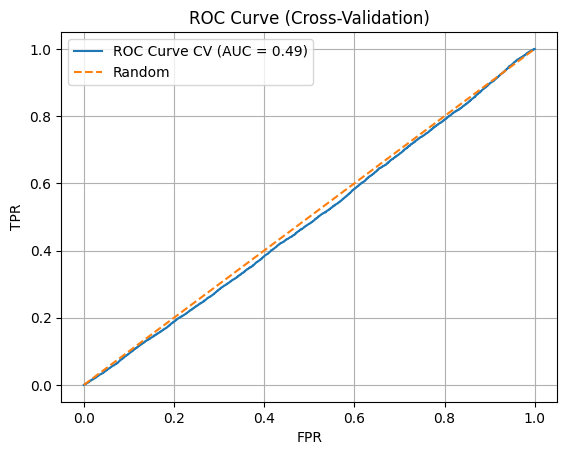

In [ ]:
y_test_prob = XGBmodel.predict_proba(X_test)[:, 1]

fpr, tpr, _ = roc_curve(y_test, y_test_prob)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, label=f'ROC Curve CV (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', label='Random')
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.title('ROC Curve (Cross-Validation)')
plt.legend()
plt.grid(True)
plt.show()

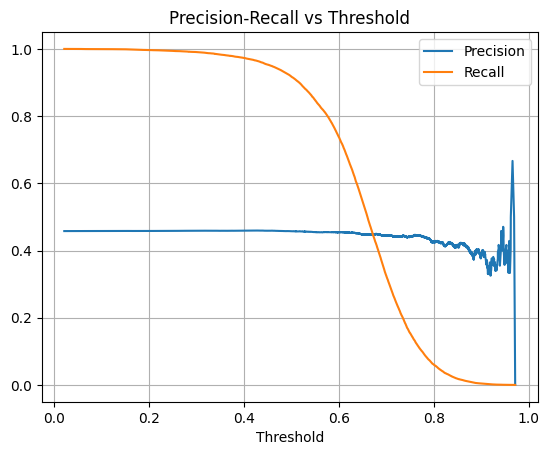

In [ ]:
precisions, recalls, thresholds = precision_recall_curve(y_test, y_test_prob)

plt.plot(thresholds, precisions[:-1], label='Precision')
plt.plot(thresholds, recalls[:-1], label='Recall')
plt.xlabel('Threshold')
plt.legend()
plt.grid(True)
plt.title('Precision-Recall vs Threshold')
plt.show()

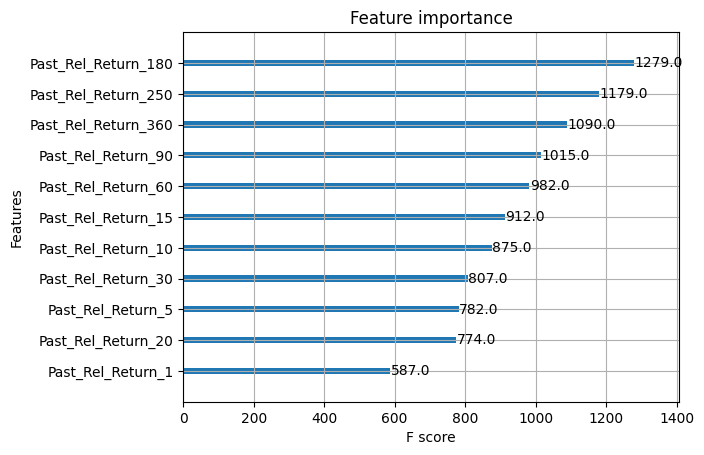

In [ ]:
plot_importance(XGBmodel, max_num_features=20)
plt.show()

In [ ]:
XGBmodel.get_booster().get_score(importance_type='gain')

{'Past_Rel_Return_1': 9.175400733947754,
 'Past_Rel_Return_5': 6.7352399826049805,
 'Past_Rel_Return_10': 7.197259426116943,
 'Past_Rel_Return_15': 7.243687629699707,
 'Past_Rel_Return_20': 8.691461563110352,
 'Past_Rel_Return_30': 7.580527305603027,
 'Past_Rel_Return_60': 8.948042869567871,
 'Past_Rel_Return_90': 9.645880699157715,
 'Past_Rel_Return_180': 9.40516471862793,
 'Past_Rel_Return_250': 9.699844360351562,
 'Past_Rel_Return_360': 11.221521377563477}

[[ 1512 17134]
 [ 1307 14441]]


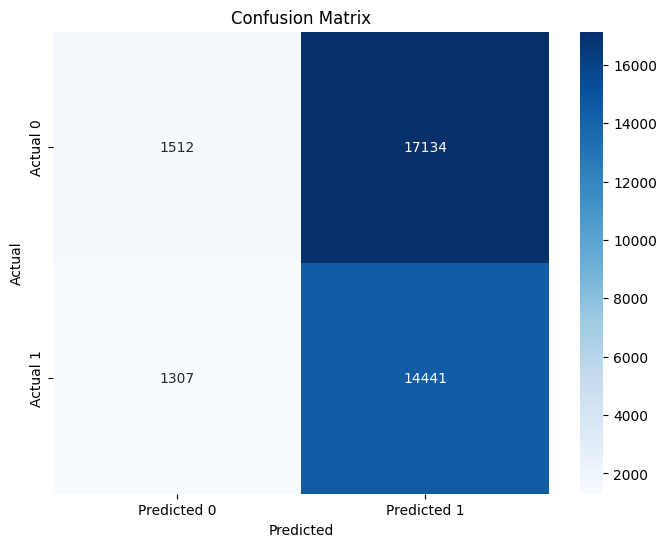

In [ ]:
cm = confusion_matrix(y_test, y_test_pred)
print(cm)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Predicted 0', 'Predicted 1'],
            yticklabels=['Actual 0', 'Actual 1'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

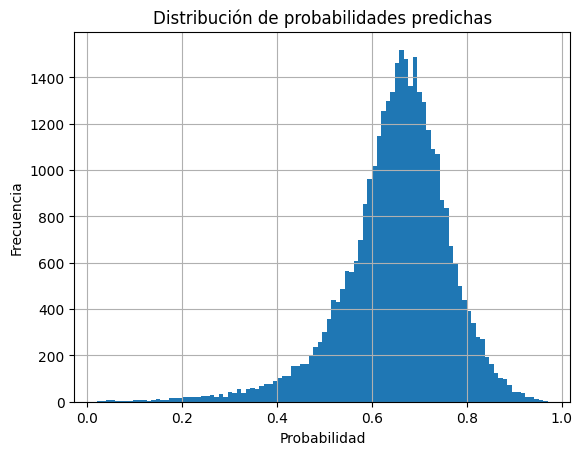

In [ ]:
plt.hist(y_test_prob, bins=100)
plt.title("Distribución de probabilidades predichas")
plt.xlabel("Probabilidad")
plt.ylabel("Frecuencia")
plt.grid(True)
plt.show()

## XGBOOST - TOTAL TSCV

In [ ]:
# Definir fecha de corte para train y test
train_cutoff = df_labeled['Date'].quantile((quantile)/100)

# División basada en fecha
train_df = df_labeled[df_labeled['Date'] <= train_cutoff].copy()
test_df = df_labeled[df_labeled['Date'] > train_cutoff].copy()

# Verificar dimensiones
print(f"Train dataset size: {train_df.shape}")
print(f"Test dataset size: {test_df.shape}")

# Crear TimeSeriesSplit
tscv = TimeSeriesSplit(n_splits=n_splits)

Train dataset size: (137617, 89)
Test dataset size: (34394, 89)


In [ ]:
# Obtener X e y del conjunto de entrenamiento
X_train_final = train_df[feature_cols]
y_train_final = train_df[label_col]
X_test = test_df[feature_cols]
y_test = test_df[label_col]

In [ ]:
# Ajustar scale_pos_weight basado en el desbalance de clases
##scale_pos_weight = sum(y_train_total == 0) / sum(y_train_total == 1)
##params["scale_pos_weight"] = scale_pos_weight

In [ ]:
# Lista para almacenar resultados de validación cruzada, mejor modelo, etc.
results = []
best_f2 = -1
best_model = None

val_probs_all = []
val_labels_all = []

# Validación cruzada temporal en train_df
for i, (train_index, val_index) in enumerate(tscv.split(X_train_final)):
    X_train, X_val = X_train_final.iloc[train_index], X_train_final.iloc[val_index]
    y_train, y_val = y_train_final.iloc[train_index], y_train_final.iloc[val_index]

    #print(f"Fold {i}:")
    #print(f"  Train: index={train_index}")
    #print(f"  Test:  index={val_index}")

    # Crear y entrenar modelo
    model = XGBClassifier(**params)
    model.fit(X_train, y_train)

    # Predicciones en validación
    y_pred = model.predict(X_val)

    # Evaluar rendimiento
    acc = accuracy_score(y_val, y_pred)
    prec = precision_score(y_val, y_pred, zero_division=0)
    rec = recall_score(y_val, y_pred, zero_division=0)
    f = fbeta_score(y_val, y_pred, zero_division=0, beta=beta)

    # Guardar resultados
    results.append({
        'Train Start': X_train.index.min(),
        'Train End': X_train.index.max(),
        'Val Start': X_val.index.min(),
        'Val End': X_val.index.max(),
        'Accuracy': acc,
        'Precision': prec,
        'Recall': rec,
        'F-score': f
    })

    y_val_proba = model.predict_proba(X_val)[:, 1]

    # Guardar resultados
    val_probs_all.extend(y_val_proba)
    val_labels_all.extend(y_val)

      # Guardar el mejor modelo
    if f > best_f2:
        best_f2 = f
        XGBoost_best = deepcopy(model)

In [ ]:
# Convertir resultados a DataFrame
results_df = pd.DataFrame(results)

# Mostrar métricas promedio de validación
print("Resultados de validación cruzada (promedio):")
print(results_df.mean(numeric_only=True).round(4))

Resultados de validación cruzada (promedio):
Train Start         0.0000
Train End       86117.2000
Val Start       86118.2000
Val End        114530.4000
Accuracy            0.5084
Precision           0.5088
Recall              0.8354
F-score             0.6304
dtype: float64


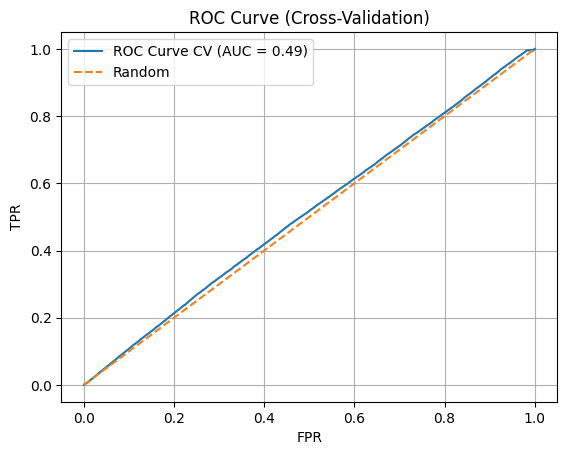

In [ ]:
fpr, tpr, _ = roc_curve(val_labels_all, val_probs_all)
roc_auc_val = auc(fpr, tpr)

plt.plot(fpr, tpr, label=f'ROC Curve CV (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', label='Random')
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.title('ROC Curve (Cross-Validation)')
plt.legend()
plt.grid(True)
plt.show()

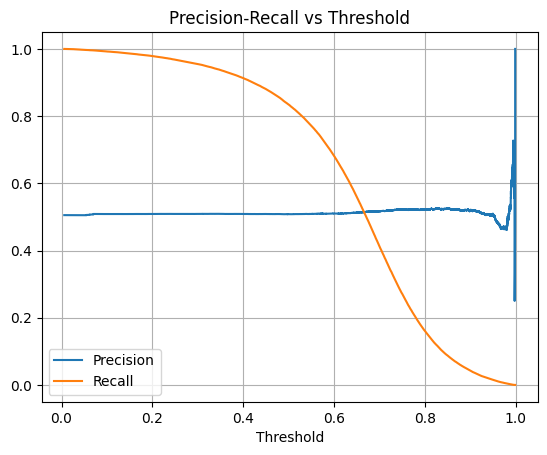

In [ ]:
precisions, recalls, thresholds = precision_recall_curve(val_labels_all, val_probs_all)

plt.plot(thresholds, precisions[:-1], label='Precision')
plt.plot(thresholds, recalls[:-1], label='Recall')
plt.xlabel('Threshold')
plt.legend()
plt.grid(True)
plt.title('Precision-Recall vs Threshold')
plt.show()

In [ ]:
# Entrenar modelo final en todo el conjunto de entrenamiento
#XGBoost_best.fit(X_train_final, y_train_final)

# Prediccion
y_test_pred = XGBoost_best.predict(X_test)

In [ ]:
# Métricas en test
test_acc = accuracy_score(y_test, y_test_pred)
test_prec = precision_score(y_test, y_test_pred, zero_division=0)
test_rec = recall_score(y_test, y_test_pred, zero_division=0)
test_f = fbeta_score(y_test, y_test_pred, zero_division=0, beta=beta)

print(f"Test Accuracy: {test_acc:.4f}")
print(f"Test Precision: {test_prec:.4f}")
print(f"Test Recall: {test_rec:.4f}")
print(f"Test F-score: {test_f:.4f}")

Test Accuracy: 0.4815
Test Precision: 0.4612
Test Recall: 0.7870
Test F-score: 0.5816


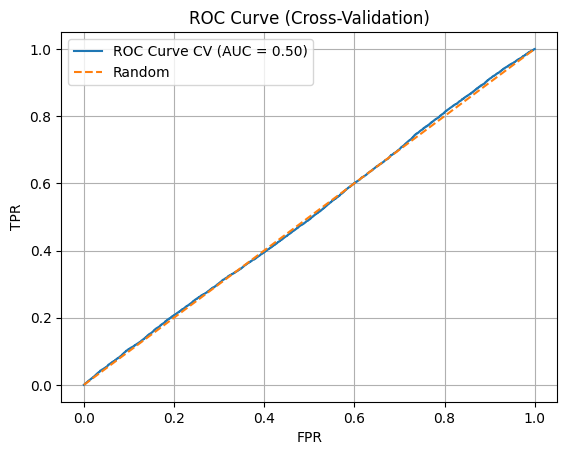

In [ ]:
y_test_prob = XGBoost_best.predict_proba(X_test)[:, 1]

fpr, tpr, _ = roc_curve(y_test, y_test_prob)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, label=f'ROC Curve CV (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', label='Random')
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.title('ROC Curve (Cross-Validation)')
plt.legend()
plt.grid(True)
plt.show()

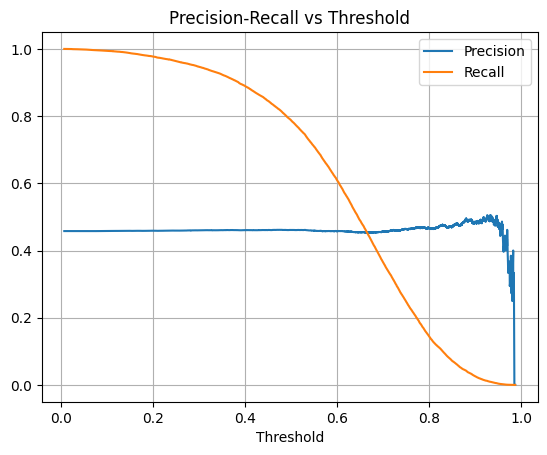

In [ ]:
precisions, recalls, thresholds = precision_recall_curve(y_test, y_test_prob)

plt.plot(thresholds, precisions[:-1], label='Precision')
plt.plot(thresholds, recalls[:-1], label='Recall')
plt.xlabel('Threshold')
plt.legend()
plt.grid(True)
plt.title('Precision-Recall vs Threshold')
plt.show()

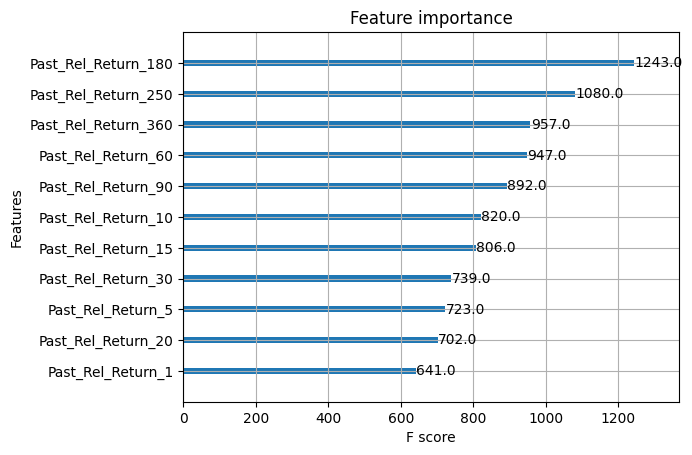

In [ ]:
plot_importance(XGBoost_best, max_num_features=20)
plt.show()

In [ ]:
XGBoost_best.get_booster().get_score(importance_type='gain')

{'Past_Rel_Return_1': 5.133619785308838,
 'Past_Rel_Return_5': 5.03318977355957,
 'Past_Rel_Return_10': 5.695949077606201,
 'Past_Rel_Return_15': 5.992897033691406,
 'Past_Rel_Return_20': 6.83302640914917,
 'Past_Rel_Return_30': 5.965976238250732,
 'Past_Rel_Return_60': 7.198250770568848,
 'Past_Rel_Return_90': 7.233771800994873,
 'Past_Rel_Return_180': 7.429621696472168,
 'Past_Rel_Return_250': 7.616659641265869,
 'Past_Rel_Return_360': 8.924349784851074}

[[ 4167 14479]
 [ 3355 12393]]


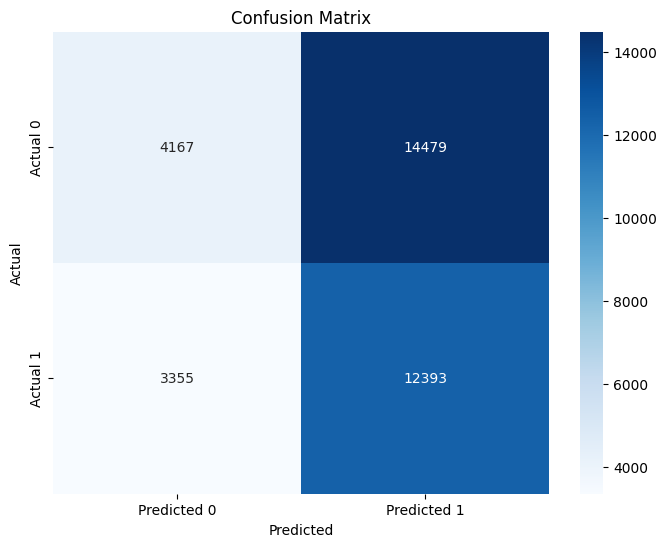

In [ ]:
cm = confusion_matrix(y_test, y_test_pred)
print(cm)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Predicted 0', 'Predicted 1'],
            yticklabels=['Actual 0', 'Actual 1'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

In [ ]:
try:
    val_roc_auc = roc_auc_val if roc_auc_val else np.nan
except NameError:
    val_roc_auc = np.nan

model_results = {
    'Model': 'XGBoost Past TSCV',  # o cualquier nombre que quieras

    # Métricas de Test
    'Test_Accuracy': test_acc,
    'Test_Precision': test_prec,
    'Test_Recall': test_rec,
    'Test_Fscore': test_f,
    'Test_ROC_AUC': roc_auc,

    # Métricas de Validación (puedes poner N/A si no se calculan)
    'Val_Accuracy': results_df['Accuracy'].mean() if not results_df.empty else np.nan,
    'Val_Precision': results_df['Precision'].mean() if not results_df.empty else np.nan,
    'Val_Recall': results_df['Recall'].mean() if not results_df.empty else np.nan,
    'Val_Fscore': results_df['F-score'].mean() if not results_df.empty else np.nan,
    'Val_ROC_AUC': val_roc_auc
}

# Inicializar si aún no existe
try:
    summary_df
except NameError:
    summary_df = pd.DataFrame()

# Añadir los resultados del modelo
summary_df = pd.concat([summary_df, pd.DataFrame([model_results])], ignore_index=True)
summary_df

,Model,Test_Accuracy,Test_Precision,Test_Recall,Test_Fscore,Test_ROC_AUC,Val_Accuracy,Val_Precision,Val_Recall,Val_Fscore,Val_ROC_AUC
0,XGBoost Past TSCV,0.481479,0.461186,0.786957,0.581558,0.502907,0.50838,0.508754,0.835381,0.630431,0.513108


## XGBOOST - TOTAL TSCV + RS / BS

In [ ]:
# Definir fecha de corte para train y test
train_cutoff = df_labeled['Date'].quantile((quantile)/100)

# División basada en fecha
train_df = df_labeled[df_labeled['Date'] <= train_cutoff].copy()
test_df = df_labeled[df_labeled['Date'] > train_cutoff].copy()

# Verificar dimensiones
print(f"Train dataset size: {train_df.shape}")
print(f"Test dataset size: {test_df.shape}")

# Crear TimeSeriesSplit
tscv = TimeSeriesSplit(n_splits=n_splits)

Train dataset size: (137617, 89)
Test dataset size: (34394, 89)


In [ ]:
# Obtener X e y del conjunto de entrenamiento
X_train_final = train_df[feature_cols]
y_train_final = train_df[label_col]
X_test = test_df[feature_cols]
y_test = test_df[label_col]

In [ ]:
# Espacio de búsqueda amplio para Random Search
param_dist = {
    "eta": uniform(0.01, 0.3),  # Tasa de aprendizaje
    "max_depth": randint(3, 10),  # Profundidad
    "subsample": uniform(0.5, 0.5),
    "colsample_bytree": uniform(0.5, 0.5),
    "scale_pos_weight": uniform(0.5, 2.0),  # Ajuste de clases desbalanceadas
    "n_estimators": randint(50, 300),  # Número de árboles
}

In [ ]:
# Definir particiones timeseriessplit
tscv = TimeSeriesSplit(n_splits=n_splits)

# Definir F2 como función de scoring
f2_scorer = make_scorer(fbeta_score, beta=beta, average='binary')  # Usa 'binary' para clasificación binaria

# Modelo base
xgb_model = XGBClassifier(objective="binary:logistic", eval_metric="logloss", random_state=seed)

In [ ]:
# Randomized Search
random_search = RandomizedSearchCV(
    estimator=xgb_model,
    param_distributions=param_dist,
    n_iter= 3,
    #cv=tscv,
    scoring=f2_scorer,
    verbose=2,
    random_state=seed,
    n_jobs=-1
)

# Entrenamiento con Randomized Search
random_search.fit(X_train_final, y_train_final)

Fitting 5 folds for each of 3 candidates, totalling 15 fits


RandomizedSearchCV(estimator=XGBClassifier(base_score=None, booster=None,
                                           callbacks=None,
                                           colsample_bylevel=None,
                                           colsample_bynode=None,
                                           colsample_bytree=None, device=None,
                                           early_stopping_rounds=None,
                                           enable_categorical=False,
                                           eval_metric='logloss',
                                           feature_types=None, gamma=None,
                                           grow_policy=None,
                                           importance_type=None,
                                           interaction_constraints=None,
                                           learning_rate...
                                        'n_estimators': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x7c0f3b180110>,
                                        'scale_pos_weight': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x7c0f3b182f50>,
                                        'subsample': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x7c0f3b180a10>},
                   random_state=34,
                   scoring=make_scorer(fbeta_score, response_method='predict', beta=1, average=binary),
                   verbose=2)

In [ ]:
# Mejores parámetros encontrados
best_params_random = random_search.best_params_
print("Random Search:", best_params_random)
best_params_random

Random Search: {'colsample_bytree': np.float64(0.5067103048697013), 'eta': np.float64(0.20454183544695714), 'max_depth': 9, 'n_estimators': 55, 'scale_pos_weight': np.float64(1.7180714068954397), 'subsample': np.float64(0.9039964094408228)}


{'colsample_bytree': np.float64(0.5067103048697013),
 'eta': np.float64(0.20454183544695714),
 'max_depth': 9,
 'n_estimators': 55,
 'scale_pos_weight': np.float64(1.7180714068954397),
 'subsample': np.float64(0.9039964094408228)}

In [ ]:
# Bayesian Search con un espacio más reducido
bayesian_search = BayesSearchCV(
    estimator=XGBClassifier(objective="binary:logistic", eval_metric="logloss", random_state=seed),
    search_spaces={
        "eta": (best_params_random["eta"] * 0.8, best_params_random["eta"] * 1.2),
        "max_depth": (max(3, best_params_random["max_depth"] - 2), min(10, best_params_random["max_depth"] + 2)),
        "subsample": (max(0.5, best_params_random["subsample"] - 0.2), min(1.0, best_params_random["subsample"] + 0.2)),
        "colsample_bytree": (max(0.5, best_params_random["colsample_bytree"] - 0.2), min(1.0, best_params_random["colsample_bytree"] + 0.2)),
        "scale_pos_weight": (max(0.5, best_params_random["scale_pos_weight"] - 0.5), best_params_random["scale_pos_weight"] + 0.5),
        "n_estimators": (max(50, best_params_random["n_estimators"] - 50), min(300, best_params_random["n_estimators"] + 50))
    },
    n_iter=3,
    #cv=tscv,
    scoring=f2_scorer,
    verbose=2,
    random_state=seed,
    n_jobs=-1
)

# Entrenamiento con Bayesian Optimization
bayesian_search.fit(X_train_final, y_train_final)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits


BayesSearchCV(estimator=XGBClassifier(base_score=None, booster=None,
                                      callbacks=None, colsample_bylevel=None,
                                      colsample_bynode=None,
                                      colsample_bytree=None, device=None,
                                      early_stopping_rounds=None,
                                      enable_categorical=False,
                                      eval_metric='logloss', feature_types=None,
                                      gamma=None, grow_policy=None,
                                      importance_type=None,
                                      interaction_constraints=None,
                                      learning_rate=None...
              scoring=make_scorer(fbeta_score, response_method='predict', beta=1, average=binary),
              search_spaces={'colsample_bytree': (0.5,
                                                  np.float64(0.7067103048697012)),
                             'eta': (np.float64(0.16363346835756573),
                                     np.float64(0.24545020253634856)),
                             'max_depth': (7, 10), 'n_estimators': (50, 105),
                             'scale_pos_weight': (np.float64(1.2180714068954397),
                                                  np.float64(2.2180714068954397)),
                             'subsample': (np.float64(0.7039964094408229),
                                           1.0)},
              verbose=2)

In [ ]:
# Mejores parámetros encontrados con Bayesian Optimization
best_params_bayes = bayesian_search.best_params_
print("Mejores Bayesian Search:", best_params_bayes)
best_params_bayes

Mejores Bayesian Search: OrderedDict([('colsample_bytree', 0.529112706796016), ('eta', 0.24346110222610298), ('max_depth', 8), ('n_estimators', 64), ('scale_pos_weight', 2.155692344361828), ('subsample', 0.8556557877201786)])


OrderedDict([('colsample_bytree', 0.529112706796016),
             ('eta', 0.24346110222610298),
             ('max_depth', 8),
             ('n_estimators', 64),
             ('scale_pos_weight', 2.155692344361828),
             ('subsample', 0.8556557877201786)])

In [ ]:
# Lista para almacenar resultados de validación cruzada, mejor modelo, etc.
results = []
best_f2 = -1
best_model = None

val_probs_all = []
val_labels_all = []

# Validación cruzada temporal en train_df
for i, (train_index, val_index) in enumerate(tscv.split(X_train_final)):
    X_train, X_val = X_train_final.iloc[train_index], X_train_final.iloc[val_index]
    y_train, y_val = y_train_final.iloc[train_index], y_train_final.iloc[val_index]

    #print(f"Fold {i}:")
    #print(f"  Train: index={train_index}")
    #print(f"  Test:  index={val_index}")

    # Crear y entrenar modelo
    model = XGBClassifier(**best_params_bayes,
                            objective="binary:logistic",
                            eval_metric="logloss",
                            random_state=seed)

    model.fit(X_train, y_train)

    # Predicciones en validación
    y_pred = model.predict(X_val)

    # Evaluar rendimiento
    acc = accuracy_score(y_val, y_pred)
    prec = precision_score(y_val, y_pred, zero_division=0)
    rec = recall_score(y_val, y_pred, zero_division=0)
    f = fbeta_score(y_val, y_pred, zero_division=0, beta=beta)

    # Guardar resultados
    results.append({
        'Train Start': X_train.index.min(),
        'Train End': X_train.index.max(),
        'Val Start': X_val.index.min(),
        'Val End': X_val.index.max(),
        'Accuracy': acc,
        'Precision': prec,
        'Recall': rec,
        'F-score': f
    })

    y_val_proba = model.predict_proba(X_val)[:, 1]

    # Guardar resultados
    val_probs_all.extend(y_val_proba)
    val_labels_all.extend(y_val)

      # Guardar el mejor modelo
    if f > best_f2:
        best_f2 = f
        XGBoost_best = deepcopy(model)

# Convertir resultados a DataFrame
results_df = pd.DataFrame(results)

# Mostrar métricas promedio de validación
print("Resultados de validación cruzada (promedio):")
print(results_df.mean(numeric_only=True).round(4))

Resultados de validación cruzada (promedio):
Train Start         0.0000
Train End       86117.2000
Val Start       86118.2000
Val End        114530.4000
Accuracy            0.5099
Precision           0.5091
Recall              0.8704
F-score             0.6408
dtype: float64


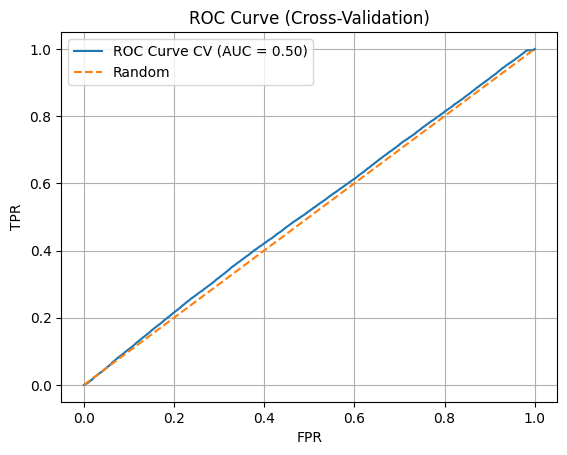

In [ ]:
fpr, tpr, _ = roc_curve(val_labels_all, val_probs_all)
roc_auc_val = auc(fpr, tpr)

plt.plot(fpr, tpr, label=f'ROC Curve CV (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', label='Random')
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.title('ROC Curve (Cross-Validation)')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
# Entrenar modelo final en todo el conjunto de entrenamiento
#XGBoost_best.fit(X_train_final, y_train_final)

# Prediccion
y_test_pred = XGBoost_best.predict(X_test)

In [ ]:
# Métricas en test
test_acc = accuracy_score(y_test, y_test_pred)
test_prec = precision_score(y_test, y_test_pred, zero_division=0)
test_rec = recall_score(y_test, y_test_pred, zero_division=0)
test_f = fbeta_score(y_test, y_test_pred, zero_division=0, beta=beta)

print(f"Test Accuracy: {test_acc:.4f}")
print(f"Test Precision: {test_prec:.4f}")
print(f"Test Recall: {test_rec:.4f}")
print(f"Test F-score: {test_f:.4f}")

Test Accuracy: 0.4751
Test Precision: 0.4593
Test Recall: 0.8256
Test F-score: 0.5902


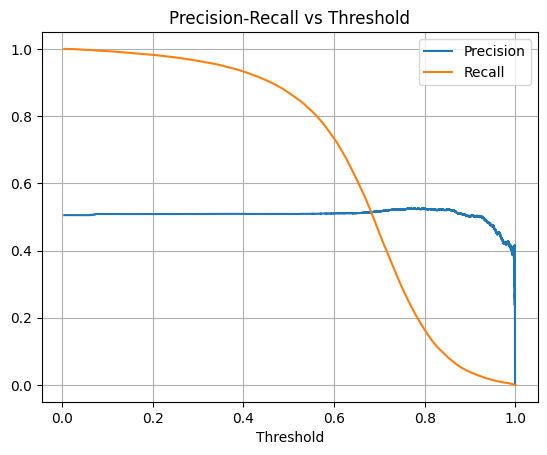

In [ ]:
precisions, recalls, thresholds = precision_recall_curve(val_labels_all, val_probs_all)

plt.plot(thresholds, precisions[:-1], label='Precision')
plt.plot(thresholds, recalls[:-1], label='Recall')
plt.xlabel('Threshold')
plt.legend()
plt.grid(True)
plt.title('Precision-Recall vs Threshold')
plt.show()

In [ ]:
# Entrenar modelo final en todo el conjunto de entrenamiento
#XGBoost_best.fit(X_train_final, y_train_final)

# Prediccion
y_test_pred = XGBoost_best.predict(X_test)

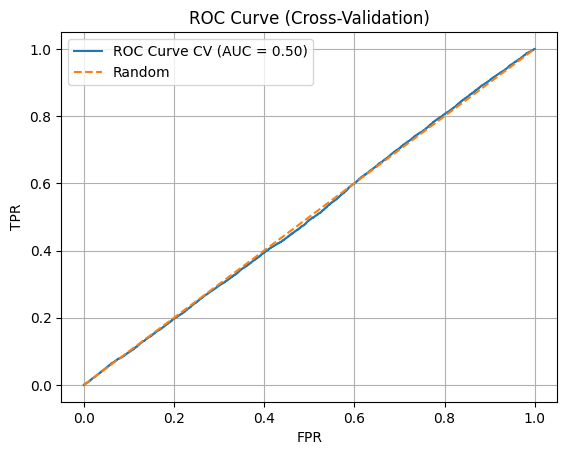

In [ ]:
y_test_prob = XGBoost_best.predict_proba(X_test)[:, 1]

fpr, tpr, _ = roc_curve(y_test, y_test_prob)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, label=f'ROC Curve CV (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', label='Random')
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.title('ROC Curve (Cross-Validation)')
plt.legend()
plt.grid(True)
plt.show()

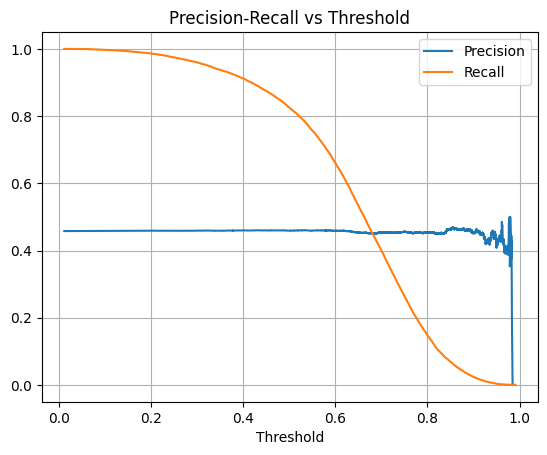

In [ ]:
precisions, recalls, thresholds = precision_recall_curve(y_test, y_test_prob)

plt.plot(thresholds, precisions[:-1], label='Precision')
plt.plot(thresholds, recalls[:-1], label='Recall')
plt.xlabel('Threshold')
plt.legend()
plt.grid(True)
plt.title('Precision-Recall vs Threshold')
plt.show()

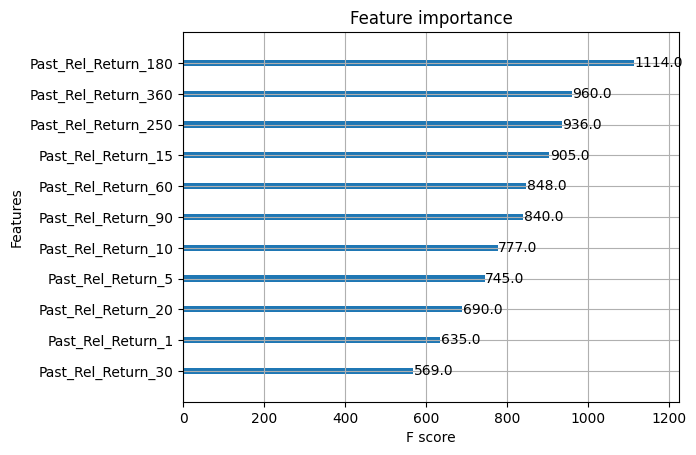

In [ ]:
plot_importance(XGBoost_best, max_num_features=20)
plt.show()

In [ ]:
XGBoost_best.get_booster().get_score(importance_type='gain')

{'Past_Rel_Return_1': 5.392678260803223,
 'Past_Rel_Return_5': 5.192706108093262,
 'Past_Rel_Return_10': 5.603693962097168,
 'Past_Rel_Return_15': 5.666708469390869,
 'Past_Rel_Return_20': 6.3807454109191895,
 'Past_Rel_Return_30': 6.37561559677124,
 'Past_Rel_Return_60': 6.8893866539001465,
 'Past_Rel_Return_90': 7.263023853302002,
 'Past_Rel_Return_180': 7.668982028961182,
 'Past_Rel_Return_250': 9.265266418457031,
 'Past_Rel_Return_360': 9.326501846313477}

[[ 3341 15305]
 [ 2747 13001]]


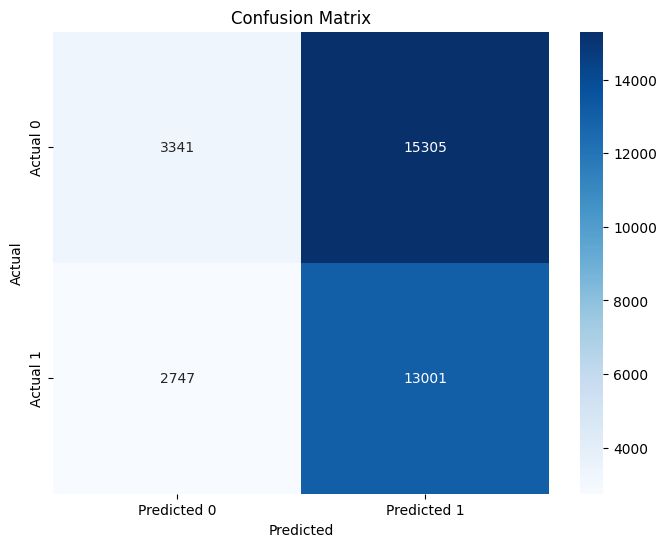

In [ ]:
cm = confusion_matrix(y_test, y_test_pred)
print(cm)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Predicted 0', 'Predicted 1'],
            yticklabels=['Actual 0', 'Actual 1'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

In [ ]:
try:
    val_roc_auc = roc_auc_val if roc_auc_val else np.nan
except NameError:
    val_roc_auc = np.nan

model_results = {
    'Model': 'XGBoost Past TSCV RS/BS',  # o cualquier nombre que quieras

    # Métricas de Test
    'Test_Accuracy': test_acc,
    'Test_Precision': test_prec,
    'Test_Recall': test_rec,
    'Test_Fscore': test_f,
    'Test_ROC_AUC': roc_auc,

    # Métricas de Validación (puedes poner N/A si no se calculan)
    'Val_Accuracy': results_df['Accuracy'].mean() if not results_df.empty else np.nan,
    'Val_Precision': results_df['Precision'].mean() if not results_df.empty else np.nan,
    'Val_Recall': results_df['Recall'].mean() if not results_df.empty else np.nan,
    'Val_Fscore': results_df['F-score'].mean() if not results_df.empty else np.nan,
    'Val_ROC_AUC': val_roc_auc
}

# Inicializar si aún no existe
try:
    summary_df
except NameError:
    summary_df = pd.DataFrame()

# Añadir los resultados del modelo
summary_df = pd.concat([summary_df, pd.DataFrame([model_results])], ignore_index=True)
summary_df

,Model,Test_Accuracy,Test_Precision,Test_Recall,Test_Fscore,Test_ROC_AUC,Val_Accuracy,Val_Precision,Val_Recall,Val_Fscore,Val_ROC_AUC
0,XGBoost Past TSCV,0.481479,0.461186,0.786957,0.581558,0.502907,0.508380,0.508754,0.835381,0.630431,0.513108
1,XGBoost Past TSCV RS/BS,0.475141,0.459302,0.825565,0.590230,0.498947,0.509915,0.509059,0.870443,0.640792,0.514077


## SVM - TOTAL

In [ ]:
# Borrar NaN para cumplir
df_labeled_clean = df_labeled.dropna(axis=0, how='any').sort_values(['Ticker', 'Date'])

In [ ]:
# Definir fecha de corte para train y test
train_cutoff = df_labeled_clean['Date'].quantile((quantile)/100)

# División basada en fecha
train_df = df_labeled_clean[df_labeled_clean['Date'] <= train_cutoff].copy()
test_df = df_labeled_clean[df_labeled_clean['Date'] > train_cutoff].copy()

# Verificar dimensiones
print(f"Train dataset size: {train_df.shape}")
print(f"Test dataset size: {test_df.shape}")

Train dataset size: (126968, 89)
Test dataset size: (31736, 89)


In [ ]:
# Obtener X e y
X_train_final = train_df[feature_cols]
y_train_final = train_df[label_col]
X_test = test_df[feature_cols]
y_test = test_df[label_col]

In [ ]:
# Escalar
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train_final)
X_test_scaled = scaler.transform(X_test)

# Entrenar modelo
svm_model = SVC(kernel='sigmoid', probability=True, random_state=seed,
                verbose=True, max_iter=50, gamma = 'auto')

# Entrenar el modelo
svm_model.fit(X_train_scaled, y_train_final)

y_test_pred = svm_model.predict(X_test_scaled)

[LibSVM]

/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:305: ConvergenceWarning: Solver terminated early (max_iter=50).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


In [ ]:
# Evaluar el rendimiento
test_acc = accuracy_score(y_test, y_test_pred)
test_prec = precision_score(y_test, y_test_pred, zero_division=0)
test_rec = recall_score(y_test, y_test_pred, zero_division=0)
test_f = fbeta_score(y_test, y_test_pred, zero_division=0, beta=beta)

print(f"Test Accuracy: {test_acc:.4f}")
print(f"Test Precision: {test_prec:.4f}")
print(f"Test Recall: {test_rec:.4f}")
print(f"Test F-score: {test_f:.4f}")

Test Accuracy: 0.4657
Test Precision: 0.4566
Test Recall: 0.9557
Test F-score: 0.6180


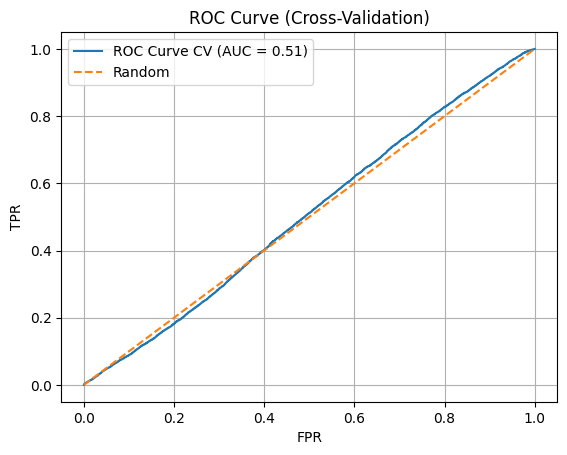

In [ ]:
y_test_prob = svm_model.predict_proba(X_test_scaled)[:, 1]

fpr, tpr, _ = roc_curve(y_test, y_test_prob)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, label=f'ROC Curve CV (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', label='Random')
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.title('ROC Curve (Cross-Validation)')
plt.legend()
plt.grid(True)
plt.show()

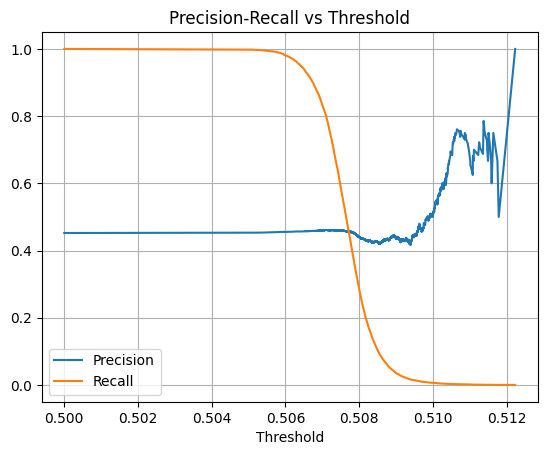

In [ ]:
precisions, recalls, thresholds = precision_recall_curve(y_test, y_test_prob)

plt.plot(thresholds, precisions[:-1], label='Precision')
plt.plot(thresholds, recalls[:-1], label='Recall')
plt.xlabel('Threshold')
plt.legend()
plt.grid(True)
plt.title('Precision-Recall vs Threshold')
plt.show()

[[ 1065 16321]
 [  636 13714]]


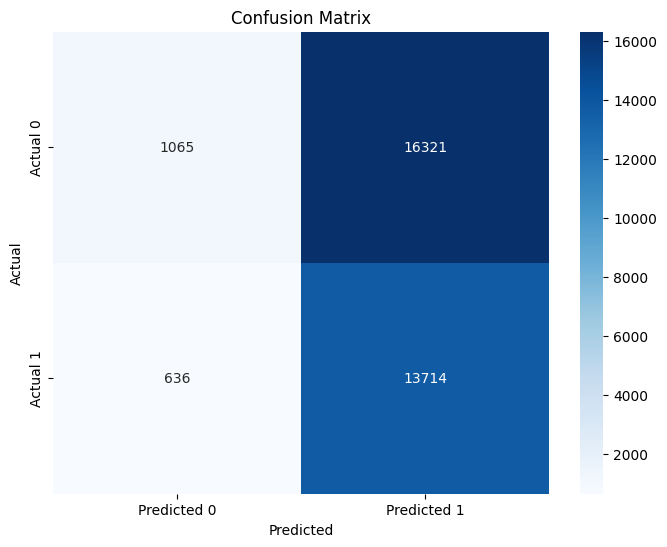

In [ ]:
cm = confusion_matrix(y_test, y_test_pred)
print(cm)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Predicted 0', 'Predicted 1'],
            yticklabels=['Actual 0', 'Actual 1'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

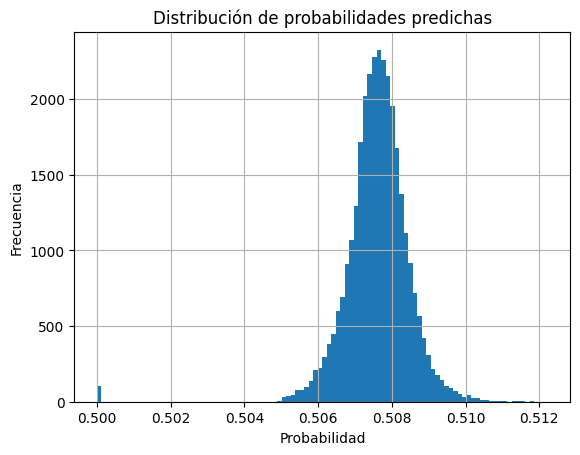

In [ ]:
plt.hist(y_test_prob, bins=100)
plt.title("Distribución de probabilidades predichas")
plt.xlabel("Probabilidad")
plt.ylabel("Frecuencia")
plt.grid(True)
plt.show()

In [ ]:
try:
    val_roc_auc = roc_auc_val if roc_auc_val else np.nan
except NameError:
    val_roc_auc = np.nan

model_results = {
    'Model': 'SVM Past',  # o cualquier nombre que quieras

    # Métricas de Test
    'Test_Accuracy': test_acc,
    'Test_Precision': test_prec,
    'Test_Recall': test_rec,
    'Test_Fscore': test_f,
    'Test_ROC_AUC': roc_auc,

    # Métricas de Validación (puedes poner N/A si no se calculan)
    'Val_Accuracy': results_df['Accuracy'].mean() if not results_df.empty else np.nan,
    'Val_Precision': results_df['Precision'].mean() if not results_df.empty else np.nan,
    'Val_Recall': results_df['Recall'].mean() if not results_df.empty else np.nan,
    'Val_Fscore': results_df['F-score'].mean() if not results_df.empty else np.nan,
    'Val_ROC_AUC': val_roc_auc
}

# Inicializar si aún no existe
try:
    summary_df
except NameError:
    summary_df = pd.DataFrame()

# Añadir los resultados del modelo
summary_df = pd.concat([summary_df, pd.DataFrame([model_results])], ignore_index=True)
summary_df

,Model,Test_Accuracy,Test_Precision,Test_Recall,Test_Fscore,Test_ROC_AUC,Val_Accuracy,Val_Precision,Val_Recall,Val_Fscore,Val_ROC_AUC
0,XGBoost Past TSCV,0.481479,0.461186,0.786957,0.581558,0.502907,0.508380,0.508754,0.835381,0.630431,0.513108
1,XGBoost Past TSCV RS/BS,0.475141,0.459302,0.825565,0.590230,0.498947,0.509915,0.509059,0.870443,0.640792,0.514077
2,SVM Past,0.465686,0.456601,0.955679,0.617957,0.506807,0.509915,0.509059,0.870443,0.640792,0.514077


## XGBOOST - TICKER

In [ ]:
# Definir fecha de corte para train y test
train_cutoff = df_labeled['Date'].quantile((quantile)/100)

# División basada en fecha
train_df = df_labeled[df_labeled['Date'] <= train_cutoff].copy()
test_df = df_labeled[df_labeled['Date'] > train_cutoff].copy()

# Verificar las dimensiones de los conjuntos
print(f"Train dataset size: {train_df.shape}")
print(f"Test dataset size: {test_df.shape}")

Train dataset size: (137617, 89)
Test dataset size: (34394, 89)


In [ ]:
# Resultados para cada ticker
results = []


# Obtener los tickers únicos en el conjunto de entrenamiento
train_tickers = train_df['Ticker'].unique()

# Entrenar y evaluar el modelo directamente en el conjunto de entrenamiento y test
for ticker in train_tickers:
    ticker_train_data = train_df[train_df['Ticker'] == ticker].sort_values(by='Date')
    ticker_test_data = test_df[test_df['Ticker'] == ticker].sort_values(by='Date')

    # Obtener X (features) e y (label) para el conjunto de entrenamiento
    X_train = ticker_train_data[feature_cols]
    y_train = ticker_train_data[label_col]

    # Verificar si hay suficientes datos para entrenar
    if len(X_train) == 0:
        print(f"No hay datos para entrenar el ticker {ticker}, saltando.")
        continue

    # Crear y entrenar el modelo XGBoost
    model = XGBClassifier(**params)
    model.fit(X_train, y_train)

    # Predicciones para el conjunto de entrenamiento
    y_pred_train = model.predict(X_train)

    # Evaluar rendimiento en entrenamiento
    acc_train = accuracy_score(y_train, y_pred_train)
    prec_train = precision_score(y_train, y_pred_train, zero_division=0)
    rec_train = recall_score(y_train, y_pred_train, zero_division=0)
    f_train = fbeta_score(y_train, y_pred_train, zero_division=0, beta=beta)

    # Guardar resultados del entrenamiento
    results.append({
        'Ticker': ticker,
        'Train Start': X_train.index.min(),
        'Train End': X_train.index.max(),
        'Accuracy (Train)': acc_train,
        'Precision (Train)': prec_train,
        'Recall (Train)': rec_train,
        'F-score (Train)': f_train
    })

    # Comprobación final en el conjunto de test
    if len(ticker_test_data) > 0:  # Asegurarse de que haya datos de test para este ticker
        X_test = ticker_test_data[feature_cols]
        y_test = ticker_test_data[label_col]

        # Predicción en el conjunto de test
        y_pred_test = model.predict(X_test)

        # Evaluar rendimiento en test
        acc_test = accuracy_score(y_test, y_pred_test)
        prec_test = precision_score(y_test, y_pred_test, zero_division=0)
        rec_test = recall_score(y_test, y_pred_test, zero_division=0)
        f_test = fbeta_score(y_test, y_pred_test, zero_division=0, beta=beta)

        # Guardar los resultados de la comprobación final
        results.append({
            'Ticker': ticker,
            'Train Start': X_train.index.min(),
            'Train End': X_train.index.max(),
            'Test Start': X_test.index.min(),
            'Test End': X_test.index.max(),
            'Accuracy (Test)': acc_test,
            'Precision (Test)': prec_test,
            'Recall (Test)': rec_test,
            'F-score (Test)': f_test
        })

In [ ]:
# Convertir resultados a DataFrame
results_df = pd.DataFrame(results)

# Agrupar por ticker y ordenar por F-score en test
results_df = results_df.groupby('Ticker').agg({
    'Accuracy (Train)': 'mean',
    'Precision (Train)': 'mean',
    'Recall (Train)': 'mean',
    'F-score (Train)': 'mean',
    'Accuracy (Test)': 'mean',
    'Precision (Test)': 'mean',
    'Recall (Test)': 'mean',
    'F-score (Test)': 'mean'
}).reset_index()

# Ordenar por F-score en test
results_df.sort_values(by='F-score (Test)', ascending=False, inplace=True)

# Mostrar los resultados
results_df

,Ticker,Accuracy (Train),Precision (Train),Recall (Train),F-score (Train),Accuracy (Test),Precision (Test),Recall (Test),F-score (Test)
3,AMS.MC,0.998235,0.997045,1.000000,0.998520,0.551244,0.519728,0.795833,0.628807
0,ACS.MC,0.993568,0.988825,0.998832,0.993803,0.557214,0.631034,0.613065,0.621920
7,CABK.MC,0.997700,0.995224,1.000000,0.997606,0.547264,0.594203,0.645105,0.618609
2,AENA.MC,0.998755,0.997768,1.000000,0.998883,0.587065,0.569061,0.630612,0.598258
18,ITX.MC,0.992988,0.988753,0.999331,0.994014,0.513433,0.534431,0.667290,0.593516
17,IDR.MC,0.990191,0.981536,0.999248,0.990313,0.584080,0.693735,0.511111,0.588583
15,IAG.MC,0.998865,0.997948,1.000000,0.998973,0.520398,0.493151,0.684989,0.573451
19,LOG.MC,0.999431,1.000000,0.998828,0.999413,0.564179,0.627409,0.526032,0.572266
10,ELE.MC,0.989449,0.980445,1.000000,0.990126,0.502488,0.449529,0.785882,0.571918
16,IBE.MC,0.990540,0.983062,0.999662,0.991293,0.488557,0.475387,0.705637,0.568067


In [ ]:
# Calculate the averages of the relevant columns in results_df
average_metrics = results_df.mean(numeric_only=True)

# Create a new DataFrame for the averages
average_metrics_df = pd.DataFrame(average_metrics).transpose()

# Display the averages below the original results_df
print("\nAverage Metrics:")
average_metrics_df



Average Metrics:


,Accuracy (Train),Precision (Train),Recall (Train),F-score (Train),Accuracy (Test),Precision (Test),Recall (Test),F-score (Test)
0,0.994174,0.989064,0.99951,0.994238,0.486356,0.465462,0.573181,0.497202


## XGBOOST - TICKER + TSS

In [ ]:
def evaluate_model(model, X_test, y_test, beta=1):
    y_pred = model.predict(X_test)
    test_acc = accuracy_score(y_test, y_pred)
    test_prec = precision_score(y_test, y_pred, zero_division=0)
    test_rec = recall_score(y_test, y_pred, zero_division=0)
    test_f = fbeta_score(y_test, y_pred, zero_division=0, beta=beta)
    #print(f"Test Accuracy: {test_acc:.4f}")
    #print(f"Test Precision: {test_prec:.4f}")
    #print(f"Test Recall: {test_rec:.4f}")
    #print(f"Test F-score: {test_f:.4f}")
    return test_acc, test_prec, test_rec, test_f

def plot_metrics(model, X_test, y_test):
    y_test_prob = model.predict_proba(X_test)[:, 1]
    fpr, tpr, _ = roc_curve(y_test, y_test_prob)
    roc_auc = auc(fpr, tpr)
    plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], linestyle='--', label='Random')
    plt.show()

    precisions, recalls, thresholds = precision_recall_curve(y_test, y_test_prob)
    plt.plot(thresholds, precisions[:-1], label='Precision')
    plt.plot(thresholds, recalls[:-1], label='Recall')
    plt.show()

    plot_importance(model, max_num_features=20)
    plt.show()

    cm = confusion_matrix(y_test, model.predict(X_test))
    sns.heatmap(cm, annot=True, fmt='d')
    plt.show()

    plt.hist(y_test_prob, bins=100)
    plt.show()

In [ ]:
# Dict para guardar resultados
results_per_ticker = {}

for ticker in df_labeled['Ticker'].unique():
    print(f"\nProcessing ticker: {ticker}")
    ticker_df = df_labeled[df_labeled['Ticker'] == ticker].copy()

    train_cutoff = ticker_df['Date'].quantile(quantile / 100)
    train_df = ticker_df[ticker_df['Date'] <= train_cutoff]
    test_df = ticker_df[ticker_df['Date'] > train_cutoff]

    print(f"Train dataset size: {train_df.shape}")
    print(f"Test dataset size: {test_df.shape}")

    X_train_final = train_df[feature_cols]
    y_train_final = train_df[label_col]
    X_test_final = test_df[feature_cols]
    y_test_final = test_df[label_col]

    # Validar si hay más de una clase en el conjunto de entrenamiento
    if y_train_final.nunique() < 2:
        print(f"Skipping {ticker}: only one class present in training data.")
        continue

    tscv = TimeSeriesSplit(n_splits=n_splits)
    results = []
    best_f2 = -1
    best_model = None

    for train_idx, val_idx in tscv.split(X_train_final):
        X_train, X_val = X_train_final.iloc[train_idx], X_train_final.iloc[val_idx]
        y_train, y_val = y_train_final.iloc[train_idx], y_train_final.iloc[val_idx]

        # Validar clases en la partición de entrenamiento
        if y_train.nunique() < 2:
            continue

        model = XGBClassifier(**params)
        model.fit(X_train, y_train)
        y_pred = model.predict(X_val)

        acc = accuracy_score(y_val, y_pred)
        prec = precision_score(y_val, y_pred, zero_division=0)
        rec = recall_score(y_val, y_pred, zero_division=0)
        f = fbeta_score(y_val, y_pred, zero_division=0, beta=beta)

        results.append({'Accuracy': acc, 'Precision': prec, 'Recall': rec, 'F-score': f})

        if f > best_f2:
            best_f2 = f
            best_model = deepcopy(model)

    if best_model is None:
        print(f"No valid model for {ticker}, skipping.")
        continue

    #best_model.fit(X_train_final, y_train_final)
    test_acc = accuracy_score(y_test_final, best_model.predict(X_test_final))
    test_prec = precision_score(y_test_final, best_model.predict(X_test_final), zero_division=0)
    test_rec = recall_score(y_test_final, best_model.predict(X_test_final), zero_division=0)
    test_f = fbeta_score(y_test_final, best_model.predict(X_test_final), zero_division=0, beta=beta)

    results_df = pd.DataFrame(results)

    results_per_ticker[ticker] = {
        'params': params,
        'n_splits': n_splits,
        'quantile': quantile,
        'beta': beta,
        'features': feature_cols,
        'test_accuracy': test_acc,
        'test_precision': test_prec,
        'test_recall': test_rec,
        'test_fbeta_score': test_f,
        'cross_validation_results': results_df
    }


Processing ticker: ACS.MC
Train dataset size: (4784, 89)
Test dataset size: (1196, 89)

Processing ticker: ACX.MC
Train dataset size: (5201, 89)
Test dataset size: (1301, 89)

Processing ticker: AENA.MC
Train dataset size: (2089, 89)
Test dataset size: (523, 89)

Processing ticker: AMS.MC
Train dataset size: (3070, 89)
Test dataset size: (768, 89)

Processing ticker: ANA.MC
Train dataset size: (5201, 89)
Test dataset size: (1301, 89)

Processing ticker: ANE.MC
Train dataset size: (782, 89)
Test dataset size: (196, 89)

Processing ticker: BBVA.MC
Train dataset size: (5201, 89)
Test dataset size: (1301, 89)

Processing ticker: BKT.MC
Train dataset size: (4069, 89)
Test dataset size: (1018, 89)

Processing ticker: CABK.MC
Train dataset size: (3586, 89)
Test dataset size: (897, 89)

Processing ticker: CLNX.MC
Train dataset size: (2043, 89)
Test dataset size: (511, 89)

Processing ticker: COL.MC
Train dataset size: (4708, 89)
Test dataset size: (1177, 89)

Processing ticker: ELE.MC
Train d

In [ ]:
# Resultados globales por ticker
results_table_data = []

for ticker, results in results_per_ticker.items():
    cv_results = results['cross_validation_results'].mean(numeric_only=True)
    results_table_data.append({
        'Ticker': ticker,
        'Test Precision': results['test_precision'],
        'Test Accuracy': results['test_accuracy'],
        'Test Recall': results['test_recall'],
        'Test Fbeta Score': results['test_fbeta_score'],
        'CV Precision': cv_results['Precision'],
        'CV Accuracy': cv_results['Accuracy'],
        'CV Recall': cv_results['Recall'],
        'CV F-score': cv_results['F-score'],
    })

results_df = pd.DataFrame(results_table_data)

In [ ]:
results_df = results_df.sort_values(by='CV F-score', ascending=False)
results_df

,Ticker,Test Precision,Test Accuracy,Test Recall,Test Fbeta Score,CV Precision,CV Accuracy,CV Recall,CV F-score
26,RED.MC,0.462700,0.478862,0.877104,0.605814,0.575250,0.540878,0.772674,0.654512
3,AMS.MC,0.470833,0.481771,0.952247,0.630112,0.564558,0.528376,0.772256,0.648510
2,AENA.MC,0.483871,0.527725,0.502092,0.492813,0.545739,0.539080,0.858455,0.646264
17,IBE.MC,0.463863,0.473482,0.560317,0.507549,0.582463,0.565358,0.757437,0.646033
12,ENG.MC,0.359825,0.370623,0.990385,0.527867,0.552562,0.522308,0.721948,0.618239
14,FER.MC,0.405714,0.450884,0.288032,0.336892,0.582214,0.549853,0.662041,0.610465
11,ELE.MC,0.459677,0.506533,0.811388,0.586873,0.587615,0.556351,0.632465,0.601774
15,GRF.MC,0.414400,0.456140,0.616667,0.495694,0.555726,0.539535,0.641419,0.583290
19,ITX.MC,0.543524,0.536645,0.786482,0.642812,0.607173,0.527628,0.625138,0.582546
4,ANA.MC,0.413392,0.498078,0.531835,0.465192,0.535073,0.522633,0.632682,0.574624


In [ ]:
# Calculate the averages of the relevant columns in results_df
average_metrics = results_df.mean(numeric_only=True)

# Create a new DataFrame for the averages
average_metrics_df = pd.DataFrame(average_metrics).transpose()

# Display the averages below the original results_df
print("\nAverage Metrics:")
average_metrics_df


Average Metrics:


,Test Precision,Test Accuracy,Test Recall,Test Fbeta Score,CV Precision,CV Accuracy,CV Recall,CV F-score
0,0.433569,0.507392,0.586429,0.476721,0.498247,0.514589,0.551518,0.493868


## LSTM - TOTAL


In [ ]:
timesteps = 30
batch = 256
n_features = len(feature_cols)

train_size = 0.7
val_size = 0.2
test_size = 0.1

assert np.isclose(train_size + val_size + test_size, 1.0), "train + val + test deben sumar 1"

In [ ]:
# Ordenar
df_labeled_nan = df_labeled.dropna().sort_values(["Ticker", "Date"]).reset_index(drop=True)

In [ ]:
# GENERACIÓN DE SECUENCIAS POR TICKER
all_X = []
all_y = []

for ticker in df_labeled_nan["Ticker"].unique():
    df_ticker = df_labeled_nan[df_labeled_nan["Ticker"] == ticker]
    X_ticker = df_ticker[feature_cols].values
    y_ticker = df_ticker[label_col].values

    # Normalizar
    scaler = MinMaxScaler()
    X_scaled = scaler.fit_transform(X_ticker)

    # Crear secuencias
    gen = TimeseriesGenerator(X_scaled, y_ticker, length=timesteps, batch_size=1)
    for i in range(len(gen)):
        x_seq, y_seq = gen[i]
        all_X.append(x_seq[0])
        all_y.append(y_seq[0])

X_array = np.array(all_X)
y_array = np.array(all_y)

# División SECUENCIAL basada en porcentajes
n_samples = len(X_array)
train_end = int(train_size * n_samples)
val_end = train_end + int(val_size * n_samples)

X_train = X_array[:train_end]
y_train = y_array[:train_end]

X_val = X_array[train_end:val_end]
y_val = y_array[train_end:val_end]

X_test = X_array[val_end:]
y_test = y_array[val_end:]

In [ ]:
# Verificar
print(f"Tamaño de X_train: {X_train.shape}")
print(f"Tamaño de X_val: {X_val.shape}")
print(f"Tamaño de X_test: {X_test.shape}")

Tamaño de X_train: (110378, 30, 11)
Tamaño de X_val: (31536, 30, 11)
Tamaño de X_test: (15770, 30, 11)


In [ ]:
# Crear generadores de secuencias
train_generator = TimeseriesGenerator(X_train, y_train, length=timesteps, batch_size=batch)
val_generator = TimeseriesGenerator(X_val, y_val, length=timesteps, batch_size=batch)
test_generator = TimeseriesGenerator(X_test, y_test, length=timesteps, batch_size=batch)

# Inspección
X_train_seq, y_train_seq = train_generator[0]
X_val_seq, y_val_seq = val_generator[0]
X_test_seq, y_test_seq = test_generator[0]

print(f"Tamaño de X_train_seq: {X_train_seq.shape}")
print(f"Tamaño de y_train_seq: {y_train_seq.shape}")
print(f"Tamaño de X_val_seq: {X_val_seq.shape}")
print(f"Tamaño de y_val_seq: {y_val_seq.shape}")
print(f"Tamaño de X_test_seq: {X_test_seq.shape}")
print(f"Tamaño de y_test_seq: {y_test_seq.shape}")

Tamaño de X_train_seq: (256, 30, 30, 11)
Tamaño de y_train_seq: (256,)
Tamaño de X_val_seq: (256, 30, 30, 11)
Tamaño de y_val_seq: (256,)
Tamaño de X_test_seq: (256, 30, 30, 11)
Tamaño de y_test_seq: (256,)


In [ ]:
# Definir el modelo LSTM
model = Sequential()
model.add(LSTM(256, activation='tanh', input_shape=(timesteps, len(feature_cols)), return_sequences=True))
model.add(LSTM(128, activation='tanh', kernel_regularizer=regularizers.l2(0.01), return_sequences=True))
model.add(Dropout(0.5))
model.add(LSTM(64, activation='tanh', return_sequences=False))
model.add(Dense(1, activation='sigmoid'))

model.compile(optimizer=Adam(learning_rate=0.001), loss='binary_crossentropy', metrics=['binary_accuracy'])
model.summary()

/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_28"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_54 (LSTM)                  │ (None, 30, 256)        │       274,432 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_55 (LSTM)                  │ (None, 30, 128)        │       197,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_56 (Dropout)            │ (None, 30, 128)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_56 (LSTM)                  │ (None, 64)             │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_28 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 521,025 (1.99 MB)

 Trainable params: 521,025 (1.99 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
# Early stopping para prevenir sobreajuste
early_stopping = EarlyStopping(monitor='val_binary_accuracy', patience=5, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=0.0001)

history = model.fit(
    X_train, y_train,
    validation_data=(X_val, y_val),
    epochs=1,
    batch_size=batch,
    callbacks=[early_stopping, reduce_lr],
    verbose=1
)

432/432 ━━━━━━━━━━━━━━━━━━━━ 588s 1s/step - binary_accuracy: 0.5039 - loss: 1.3854 - val_binary_accuracy: 0.5108 - val_loss: 0.6931 - learning_rate: 0.0010


In [ ]:
# Predecir etiquetas en test
y_pred_probs = model.predict(X_test).flatten()
y_pred = (y_pred_probs > 0.5).astype(int)

493/493 ━━━━━━━━━━━━━━━━━━━━ 45s 88ms/step


In [ ]:
test_loss, test_accuracy = model.evaluate(X_test, y_test)
print(f'Pérdida en test: {test_loss}')
print(f'Precisión en test: {test_accuracy}')

493/493 ━━━━━━━━━━━━━━━━━━━━ 44s 88ms/step - binary_accuracy: 0.5574 - loss: 0.6916
Pérdida en test: 0.691448450088501
Precisión en test: 0.5588459372520447


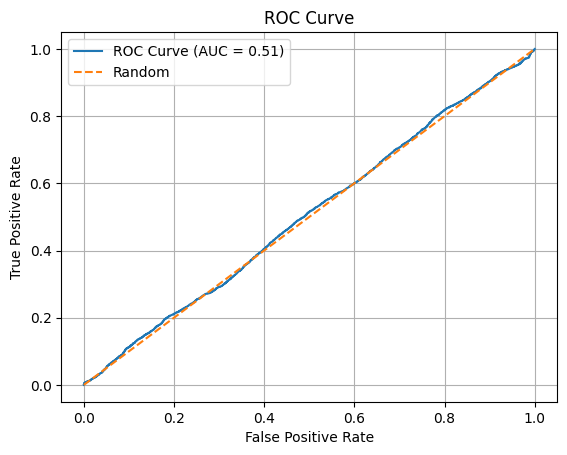

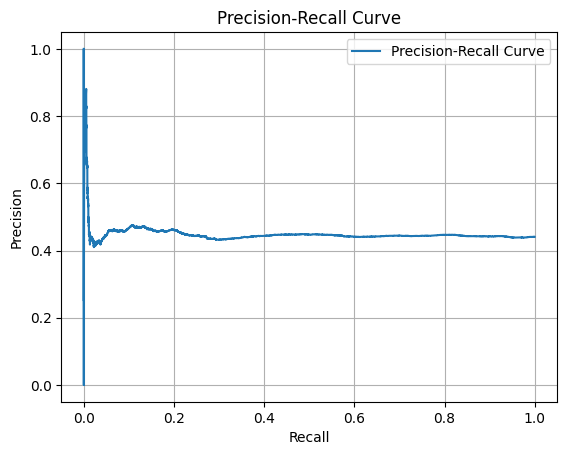

In [ ]:
# ROC Curve
fpr, tpr, _ = roc_curve(y_test, y_pred_probs)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', label='Random')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend()
plt.grid(True)
plt.show()

# Precision-Recall Curve
precision, recall, thresholds = precision_recall_curve(y_test, y_pred_probs)

plt.plot(recall, precision, label='Precision-Recall Curve')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.legend()
plt.grid(True)
plt.show()

# RETURNS - STOCK DATA + MACRO US + SIGNALS

---



In [ ]:
# Fixed
k_values = [1, 5, 10, 15, 20, 30, 60, 90, 180, 250, 360]
print("Valores de k fijos:", k_values)

# Definir los umbrales de decisión
thresholds_d = [0.01/100, 0.1/100, 0.2/100, 0.3/100, 0.5/100, 1/100, 2/100, 5/100, 10/100, 20/100,]
future_days = [30]
print("Umbrales de beneficio:", thresholds_d)
print("Días futuros a considerar:", future_days)

Valores de k fijos: [1, 5, 10, 15, 20, 30, 60, 90, 180, 250, 360]
Umbrales de beneficio: [0.0001, 0.001, 0.002, 0.003, 0.005, 0.01, 0.02, 0.05, 0.1, 0.2]
Días futuros a considerar: [30]


In [ ]:
# Filtrar datos de IBEX35
ibex_data = merged_df[index_df_final["Ticker"] == "IBEX35"].copy()
ibex_data = ibex_data.sort_values("Date").drop_duplicates()

# Calcular retornos pasados del IBEX35
for k in k_values:
    ibex_data[f"Past_Return_IBEX_{k}"] = ibex_data["Close"].pct_change(periods=k).shift(1)

# Calcular cambios relativos de las variables macroeconómicas
macro_vars = ["GDP", "Unemployment Rate", "Inflation (CPI)"]
for var in macro_vars:
    for k in k_values:
        ibex_data[f"Past_Change_{var.replace(' ', '_')}_{k}"] = ibex_data[var].shift(1).pct_change(periods=k)

# Lista para almacenar los resultados
stock_returns_list = []
relative_returns_list = []

# Filtrar todos los tickers excepto IBEX35
tickers = merged_df["Ticker"].unique()
tickers = [t for t in tickers if t != "IBEX35"]

# Procesar cada ticker
for ticker in tickers:
    df_ticker = merged_df[merged_df["Ticker"] == ticker].copy()
    df_ticker = df_ticker.sort_values("Date").drop_duplicates()

    # Calcular retornos pasados individuales
    for k in k_values:
        df_ticker[f"Past_Return_{k}"] = df_ticker["Close"].shift(1).pct_change(periods=k)

    stock_returns_list.append(df_ticker)

    # Unir datos del ticker con el IBEX35
    df_merged = df_ticker.merge(
        ibex_data[["Date"] + [f"Past_Return_IBEX_{k}" for k in k_values] + ["Close"] +
                  [f"Past_Change_{var.replace(' ', '_')}_{k}" for var in macro_vars for k in k_values]],
        on="Date", how="left", suffixes=("", "_IBEX")
    )

    # Calcular retornos relativos pasados
    for k in k_values:
        df_merged[f"Past_Rel_Return_{k}"] = df_merged[f"Past_Return_{k}"] - df_merged[f"Past_Return_IBEX_{k}"]

    # Añadir cambios relativos de las variables macro
    # (ya están disponibles en las columnas Past_Change_XXX, no necesitan más operaciones aquí)

    relative_returns_list.append(df_merged)

# Concatenar todos los datos
stock_returns_df = pd.concat(stock_returns_list, ignore_index=True).drop_duplicates()
relative_returns_df = pd.concat(relative_returns_list, ignore_index=True).drop_duplicates()

<ipython-input-23-27a5e3deef82>:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  ibex_data = merged_df[index_df_final["Ticker"] == "IBEX35"].copy()


In [ ]:
# Listado de columnas de retornos relativos
past_returns_cols = [col for col in relative_returns_df.columns if 'Past_Rel_Return' in col]

In [ ]:
ibex_data[(ibex_data['Date'].isin(['2025-04-01', '2025-03-31',
                  '2025-03-26', '2025-03-25',
                  '2025-03-24', '2025-03-21']))][['Date', 'Close', 'Past_Return_IBEX_5']]

<ipython-input-25-e37f78925f20>:1: FutureWarning: The behavior of 'isin' with dtype=datetime64[ns] and castable values (e.g. strings) is deprecated. In a future version, these will not be considered matching by isin. Explicitly cast to the appropriate dtype before calling isin instead.
  ibex_data[(ibex_data['Date'].isin(['2025-04-01', '2025-03-31',


,Date,Close,Past_Return_IBEX_5
183428,2025-03-21,13350.200195,0.037828
183464,2025-03-24,13323.299805,0.026528
183500,2025-03-25,13484.299805,0.013394
183536,2025-03-26,13432.200195,0.009704
183644,2025-03-31,13135.400391,-0.003064
183680,2025-04-01,13297.000000,-0.014103


In [ ]:
 relative_returns_df[(relative_returns_df['Ticker'] == 'ITX.MC') &
                                (relative_returns_df['Date']
                                 .isin(['2025-04-01', '2025-03-31',
                                        '2025-03-26', '2025-03-25',
                                        '2025-03-24', '2025-03-21']))][['Date', 'Close', 'Past_Return_5', 'Past_Rel_Return_5']]

<ipython-input-26-60b52d901fab>:3: FutureWarning: The behavior of 'isin' with dtype=datetime64[ns] and castable values (e.g. strings) is deprecated. In a future version, these will not be considered matching by isin. Explicitly cast to the appropriate dtype before calling isin instead.
  .isin(['2025-04-01', '2025-03-31',


,Date,Close,Past_Return_5,Past_Rel_Return_5
83942,2025-03-21,46.730000,0.050213,0.012385
83943,2025-03-24,47.000000,0.041918,0.015390
83944,2025-03-25,46.430000,0.040514,0.027119
83945,2025-03-26,46.810001,0.026304,0.016600
83948,2025-03-31,45.849998,-0.010700,-0.007636
83949,2025-04-01,46.189999,-0.024468,-0.010365


In [ ]:
 relative_returns_df[(relative_returns_df['Ticker'] == 'REP.MC') &
                                (relative_returns_df['Date']
                                 .isin(['2025-03-03', '2025-02-28',
                                        '2025-02-27', '2025-02-21',
                                        '2025-02-20']))][['Date', 'Inflation (CPI)', 'Past_Change_Inflation_(CPI)_5']]

<ipython-input-27-dbbc5bdd71d6>:3: FutureWarning: The behavior of 'isin' with dtype=datetime64[ns] and castable values (e.g. strings) is deprecated. In a future version, these will not be considered matching by isin. Explicitly cast to the appropriate dtype before calling isin instead.
  .isin(['2025-03-03', '2025-02-28',


,Date,Inflation (CPI),Past_Change_Inflation_(CPI)_5
51970,2025-02-20,319.666429,-0.000125
51971,2025-02-21,319.660714,-0.000125
51975,2025-02-27,319.626429,-0.000125
51976,2025-02-28,319.620714,-0.000125
51977,2025-03-03,319.615000,-0.000125


In [ ]:
%%capture
df_signal = relative_returns_df.copy()

for d in thresholds_d:
    for k in future_days:
        col_label = f"Label_d_{d*100:.1f}_k_{k}"

        # Retorno futuro relativo verdadero
        df_signal[col_label] = (
            df_signal.groupby("Ticker").apply(
                lambda g: (g["Close"].shift(-k) / g["Close"] - 1) -
                          (g["Close_IBEX"].shift(-k) / g["Close_IBEX"] - 1)
            ).reset_index(level=0, drop=True) > d
        ).astype(int)

In [ ]:
p1_table = pd.DataFrame(index=df_signal["Ticker"].unique())

for d in thresholds_d:
    col_values = []

    for ticker in df_signal["Ticker"].unique():
        subset = df_signal[df_signal["Ticker"] == ticker]
        label_cols = [f"Label_d_{d*100:.1f}_k_{k}" for k in future_days]
        p1_value = subset[label_cols].mean().mean()
        col_values.append(p1_value)

    p1_table[f"{d*100:.1f}%"] = col_values

p1_table.loc["Average"] = p1_table.mean()

p1_table.round(3)

,0.0%,0.1%,0.2%,0.3%,0.5%,1.0%,2.0%,5.0%,10.0%,20.0%
ACX.MC,0.465,0.460,0.456,0.450,0.440,0.412,0.365,0.243,0.104,0.012
ANA.MC,0.502,0.497,0.491,0.485,0.476,0.451,0.405,0.278,0.127,0.020
BBVA.MC,0.467,0.457,0.450,0.444,0.427,0.387,0.320,0.172,0.057,0.009
ELE.MC,0.518,0.513,0.504,0.497,0.483,0.449,0.380,0.212,0.063,0.005
IBE.MC,0.536,0.529,0.521,0.514,0.498,0.461,0.389,0.198,0.063,0.004
NTGY.MC,0.503,0.498,0.489,0.482,0.469,0.436,0.375,0.221,0.077,0.008
RED.MC,0.552,0.547,0.541,0.535,0.522,0.484,0.424,0.244,0.074,0.010
REP.MC,0.470,0.465,0.459,0.454,0.443,0.411,0.350,0.201,0.069,0.013
SAN.MC,0.460,0.452,0.442,0.433,0.415,0.369,0.297,0.158,0.051,0.007
SCYR.MC,0.473,0.470,0.466,0.462,0.454,0.432,0.394,0.291,0.169,0.057


In [ ]:
df_signal = df_signal.sort_values(by=['Ticker', 'Date']).reset_index(drop=True)

In [ ]:
# Verificar las dimensiones de los conjuntos
print(f"Dataset size: {df_signal.shape}")

Dataset size: (172011, 89)


#PREANALYSIS

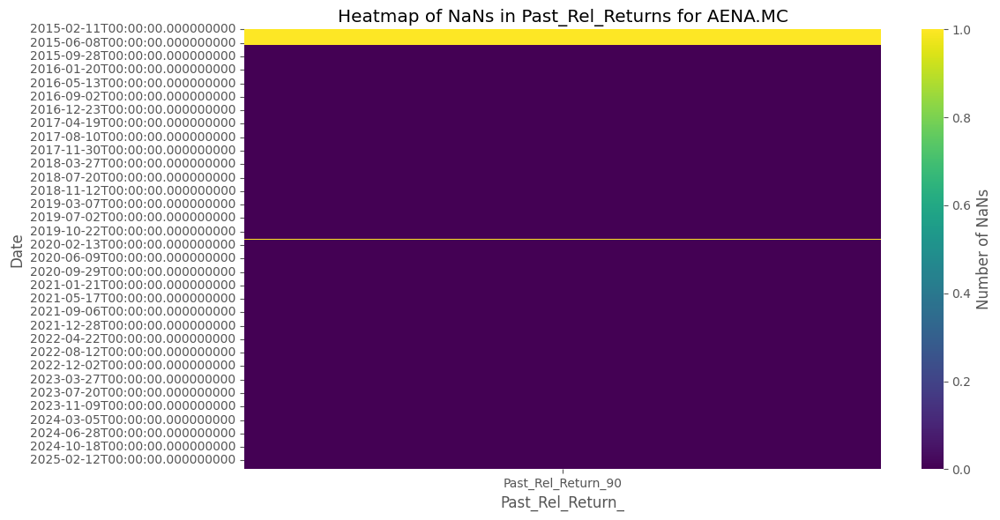

In [ ]:
# prompt: Show a heatmap per date of df_signal about NaNs in past_rel_returns for 1 example ticker

import matplotlib.pyplot as plt
import seaborn as sns

# Select a sample ticker
sample_ticker = df_signal['Ticker'].unique()[2]  # Replace with the desired ticker

# Filter the DataFrame for the sample ticker
df_ticker = df_signal[df_signal['Ticker'] == sample_ticker].copy()

# Create a pivot table to show NaN counts per date
nan_counts = df_ticker.pivot_table(index='Date', values='Past_Rel_Return_90', aggfunc=lambda x: x.isna().sum())

# Create the heatmap
plt.figure(figsize=(12, 6))
sns.heatmap(nan_counts, cmap='viridis', cbar_kws={'label': 'Number of NaNs'})
plt.title(f'Heatmap of NaNs in Past_Rel_Returns for {sample_ticker}')
plt.xlabel('Past_Rel_Return_')  # Replace with the actual column name if different
plt.ylabel('Date')
plt.tight_layout()
plt.show()


<ipython-input-253-2656fd2c7cf8>:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Ticker', y='Past_Rel_Return_15', data=df_signal, palette='pastel')


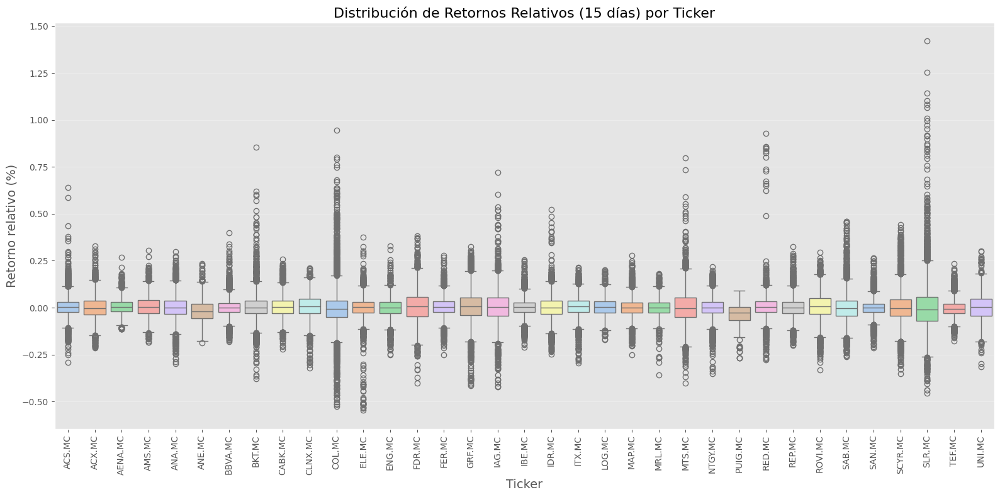

In [ ]:
plt.figure(figsize=(16,8))
sns.boxplot(x='Ticker', y='Past_Rel_Return_15', data=df_signal, palette='pastel')
plt.title('Distribución de Retornos Relativos (15 días) por Ticker', fontsize=16)
plt.xlabel('Ticker', fontsize=14)
plt.ylabel('Retorno relativo (%)', fontsize=14)
plt.xticks(rotation=90)
plt.grid(axis='y', alpha=0.3)
plt.tight_layout()
plt.show()

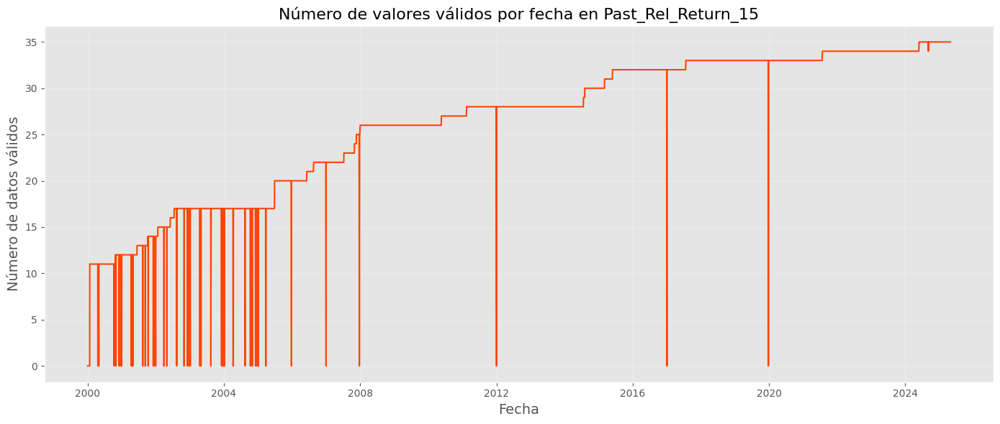

In [ ]:
valid_counts = df_signal.groupby('Date')['Past_Rel_Return_15'].count()

plt.figure(figsize=(14,6))
plt.plot(valid_counts.index, valid_counts, color='orangered')
plt.title('Número de valores válidos por fecha en Past_Rel_Return_15', fontsize=16)
plt.xlabel('Fecha', fontsize=14)
plt.ylabel('Número de datos válidos', fontsize=14)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

In [ ]:
relative_returns_df.columns

Index(['Date', 'Open', 'High', 'Low', 'Close', 'Volume', 'Dividends',
       'Stock Splits', 'Ticker', 'GDP', 'Unemployment Rate', 'Inflation (CPI)',
       'Past_Return_1', 'Past_Return_5', 'Past_Return_10', 'Past_Return_15',
       'Past_Return_20', 'Past_Return_30', 'Past_Return_60', 'Past_Return_90',
       'Past_Return_180', 'Past_Return_250', 'Past_Return_360',
       'Past_Return_IBEX_1', 'Past_Return_IBEX_5', 'Past_Return_IBEX_10',
       'Past_Return_IBEX_15', 'Past_Return_IBEX_20', 'Past_Return_IBEX_30',
       'Past_Return_IBEX_60', 'Past_Return_IBEX_90', 'Past_Return_IBEX_180',
       'Past_Return_IBEX_250', 'Past_Return_IBEX_360', 'Close_IBEX',
       'Past_Change_GDP_1', 'Past_Change_GDP_5', 'Past_Change_GDP_10',
       'Past_Change_GDP_15', 'Past_Change_GDP_20', 'Past_Change_GDP_30',
       'Past_Change_GDP_60', 'Past_Change_GDP_90', 'Past_Change_GDP_180',
       'Past_Change_GDP_250', 'Past_Change_GDP_360',
       'Past_Change_Unemployment_Rate_1', 'Past_Change_Unemploy

In [ ]:
macro_returns_cols = [col for col in relative_returns_df.columns if 'Past_Change_' in col]

for returns in macro_returns_cols:
  df_grouped = df_signal.groupby('Date')[returns].mean()

  plt.figure(figsize=(14,6))
  plt.plot(df_grouped.index, df_grouped, color='steelblue')
  plt.title(f'Evolución temporal del Retorno Relativo Promedio {returns.replace("Past_Rel_Return_", "")}', fontsize=16)
  plt.xlabel('Fecha', fontsize=14)
  plt.ylabel('Retorno relativo promedio (%)', fontsize=14)
  plt.grid(True, alpha=0.3)
  plt.tight_layout()
  plt.show()

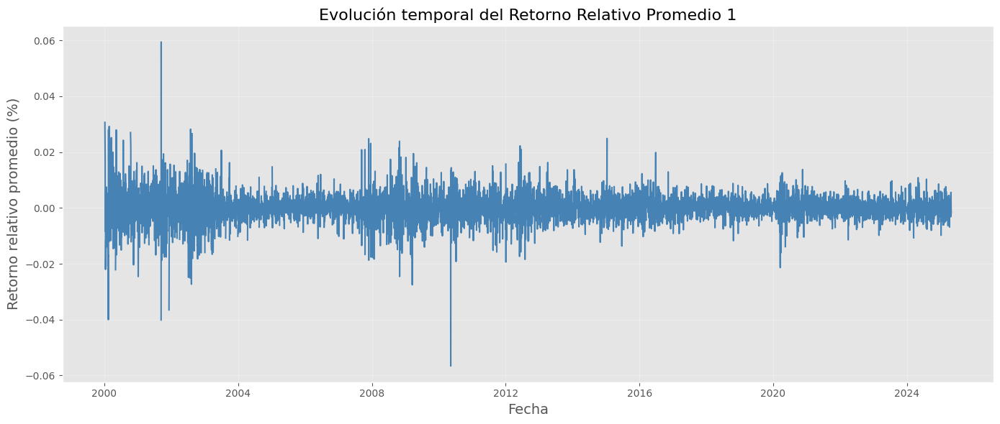

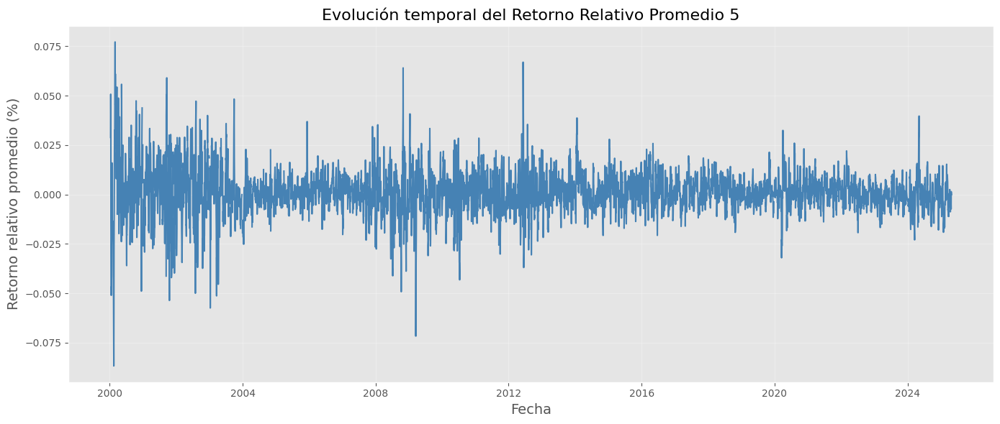

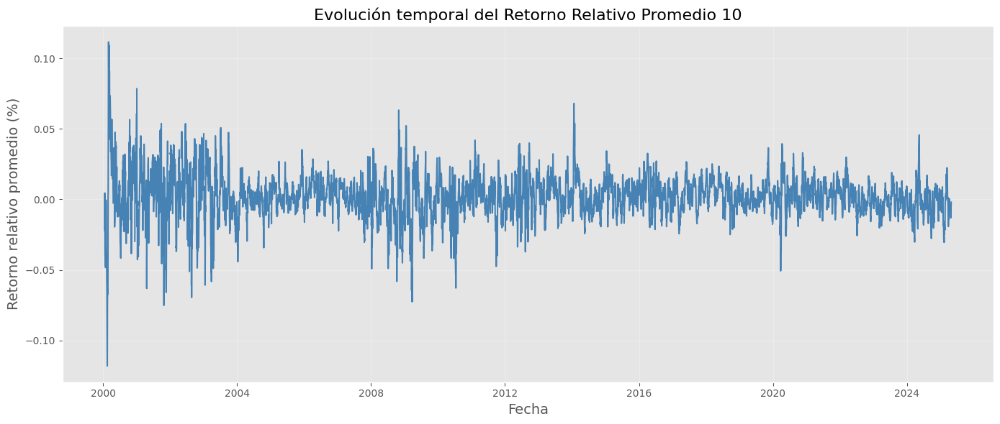

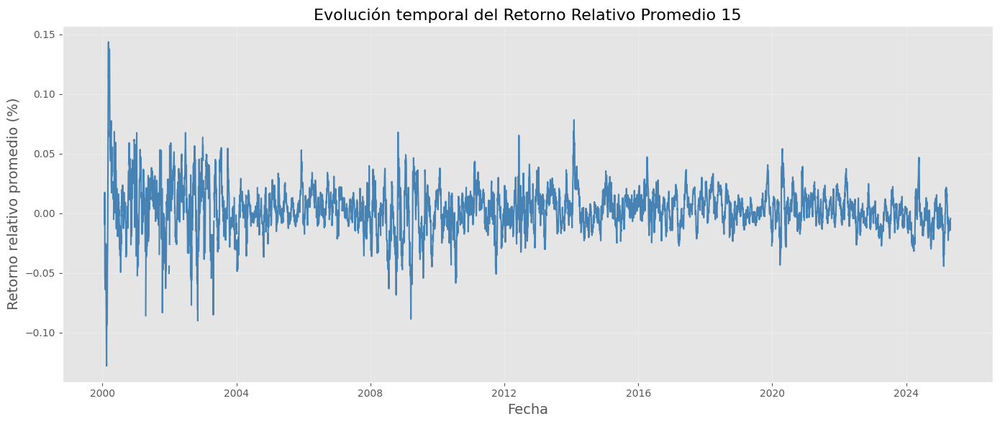

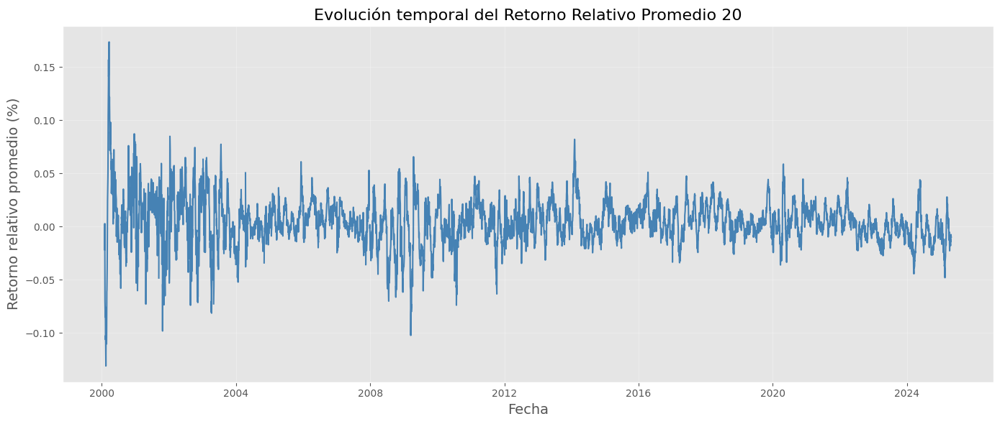

...

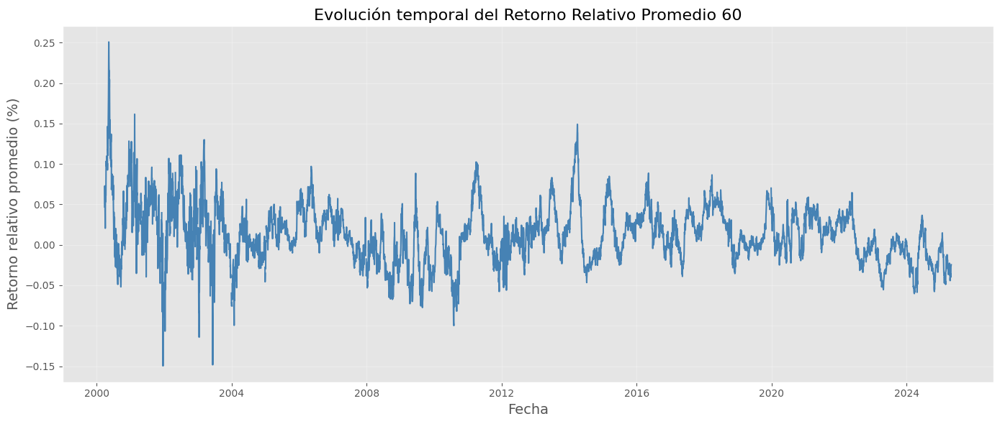

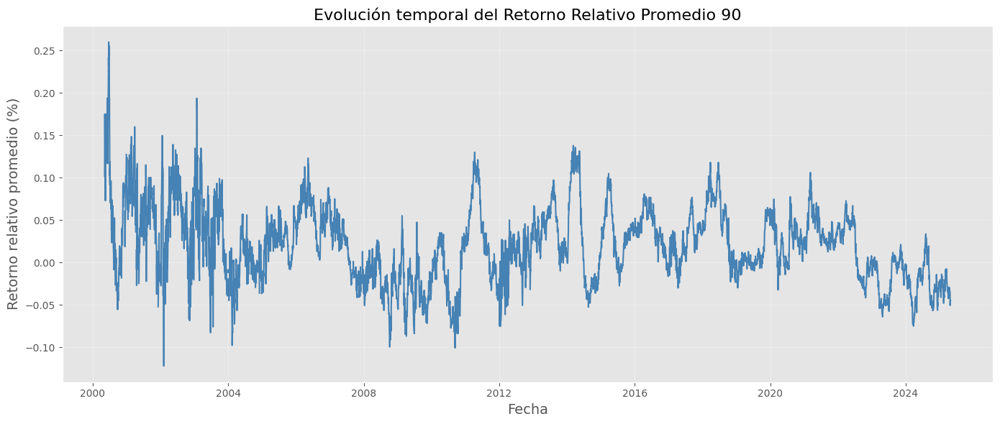

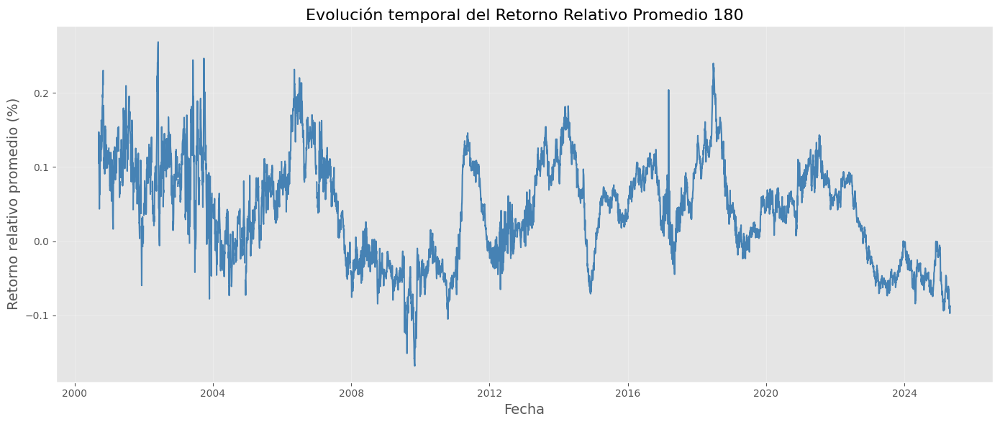

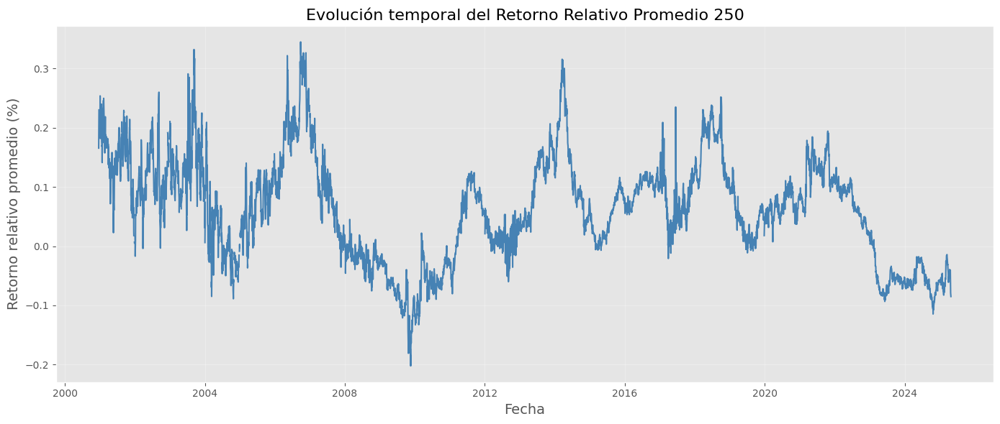

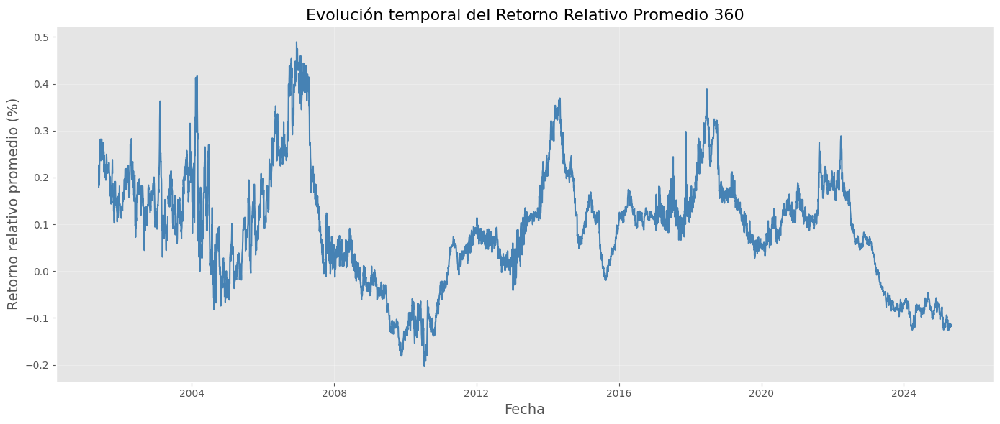

In [ ]:
for returns in past_returns_cols:
  df_grouped = df_signal.groupby('Date')[returns].mean()

  plt.figure(figsize=(14,6))
  plt.plot(df_grouped.index, df_grouped, color='steelblue')
  plt.title(f'Evolución temporal del Retorno Relativo Promedio {returns.replace("Past_Rel_Return_", "")}', fontsize=16)
  plt.xlabel('Fecha', fontsize=14)
  plt.ylabel('Retorno relativo promedio (%)', fontsize=14)
  plt.grid(True, alpha=0.3)
  plt.tight_layout()
  plt.show()

<ipython-input-258-e8761ed10c4c>:52: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


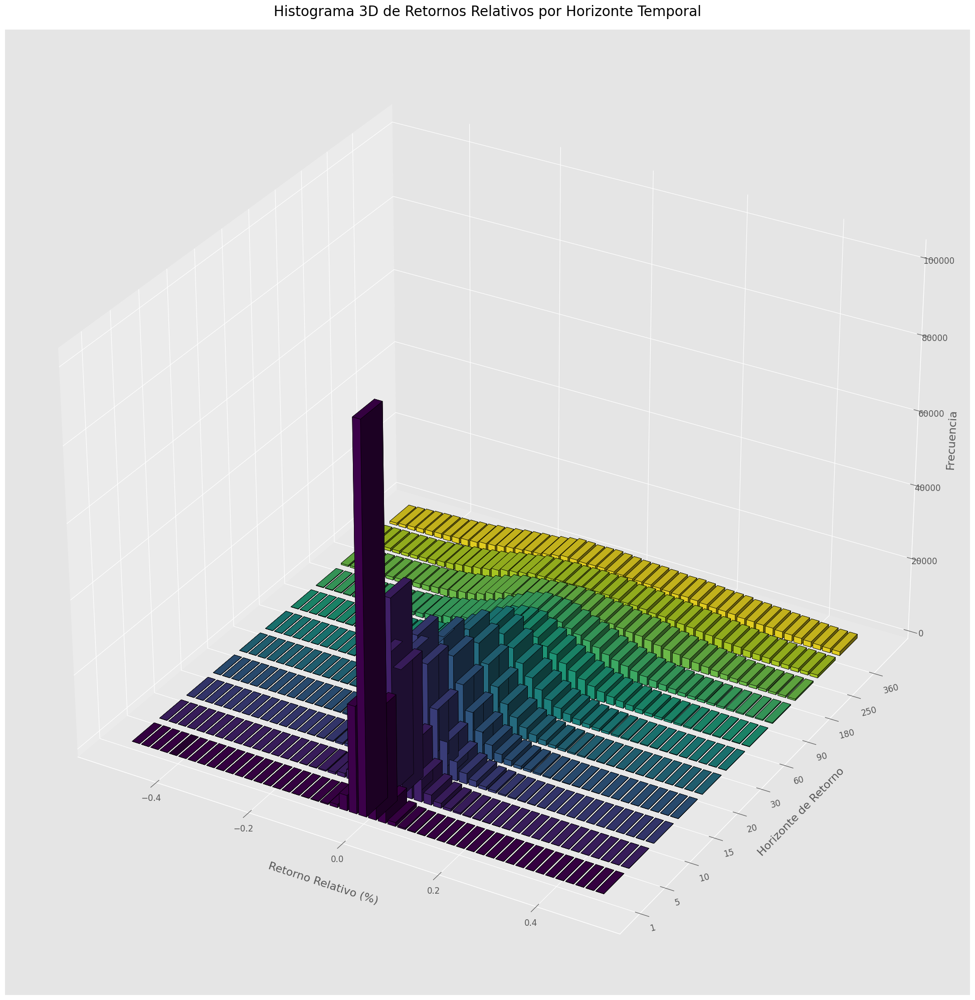

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D


# Definir bins comunes
bins = np.linspace(-0.5, 0.5, 50)  # Ajusta si necesitas más o menos dispersión

# Crear la figura
fig = plt.figure(figsize=(30, 25))
ax = fig.add_subplot(111, projection='3d')

# Posiciones para cada retorno relativo en el eje Y (profundidad)
z_positions = np.arange(len(past_returns_cols)) * 2.5  # Separación mayor entre etiquetas

# Ancho de cada barra
dx = (bins[1] - bins[0]) * 0.8
dy = 2.0  # Igual al espacio entre retornos, para que no se solapen

# Colores alternos para diferenciar mejor
colors = plt.cm.viridis(np.linspace(0, 1, len(past_returns_cols)))

# Loop para cada tipo de retorno
for i, (col, color) in enumerate(zip(past_returns_cols, colors)):
    data = df_signal[col].dropna()
    hist, edges = np.histogram(data, bins=bins)

    xs = edges[:-1]
    ys = np.full_like(xs, z_positions[i])
    zs = np.zeros_like(xs)
    ax.bar3d(xs, ys, zs, dx, dy, hist, shade=True, color=color, edgecolor='black')

# Etiquetas de ejes
ax.set_xlabel('Retorno Relativo (%)', fontsize=16, labelpad=20)
ax.set_ylabel('Horizonte de Retorno', fontsize=16, labelpad=20)
ax.set_zlabel('Frecuencia', fontsize=16, labelpad=10)

# Mejorar las etiquetas en el eje Y (profundidad)
ax.set_yticks(z_positions)
new_returns_cols = [col.replace("Past_Rel_Return_", "") for col in past_returns_cols]
new_returns_cols
ax.set_yticklabels(new_returns_cols, fontsize=12, rotation=15, ha='left')

# Mejorar visualmente
ax.tick_params(axis='x', labelsize=12)
ax.tick_params(axis='z', labelsize=12)
ax.view_init(elev=30, azim=-60)  # Mejor ángulo de visión 3D
ax.grid(True)

# Título
plt.title('Histograma 3D de Retornos Relativos por Horizonte Temporal', fontsize=20, pad=20)
plt.tight_layout()
plt.show()


In [ ]:
# Selecciona solo las columnas relevantes
correlation_cols = [col for col in df_signal.columns if 'Past_Change_' in col
                    or 'Past_Rel_Return_' in col
                    or 'Label_d_' in col]
corr_matrix = df_signal[correlation_cols].corr().round(3) # Redondear a 3 dígitos

plt.figure(figsize=(50, 40))
sns.heatmap(corr_matrix, cmap='coolwarm', center=0, annot=True, fmt=".3f", # Formato de anotaciones
            annot_kws={"size": 10})  # Tamaño de la anotación
plt.title("Correlaciones entre cambios macro y retornos relativos", fontsize=16) # Ajustar tamaño del título
plt.xticks(fontsize=12) # Tamaño de etiquetas en el eje x
plt.yticks(fontsize=12) # Tamaño de etiquetas en el eje y
plt.show()

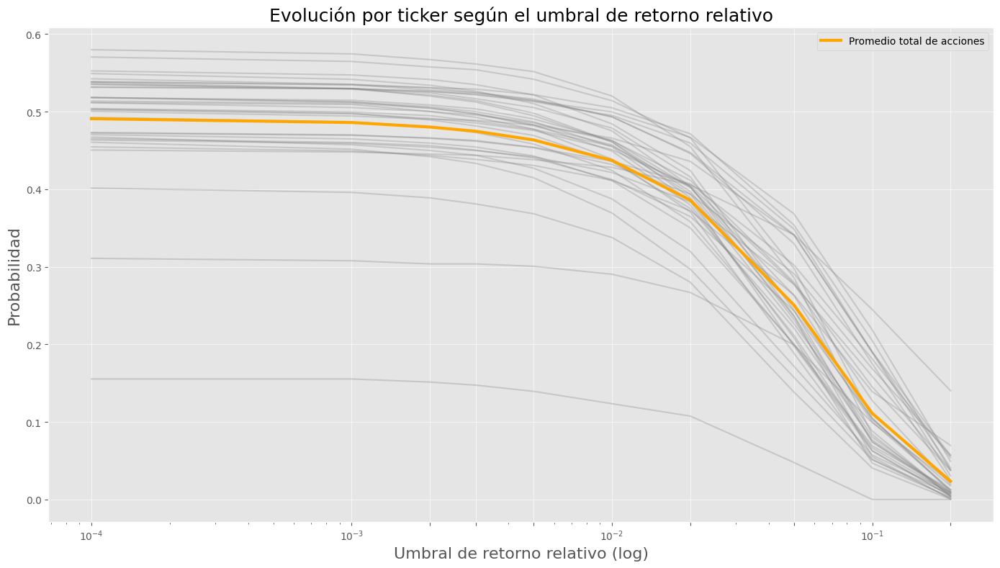

In [ ]:
# Gráfico
plt.figure(figsize=(14,8))

for ticker in p1_table.index[:-1]:  # Excluye 'Average'
    plt.plot(thresholds_d, p1_table.loc[ticker].values, alpha=0.3, color='gray')

# Añadir la línea del promedio en color destacado
plt.plot(thresholds_d, p1_table.loc['Average'].values, label='Promedio total de acciones', color='orange', linewidth=3)

# Estética
plt.title('Evolución por ticker según el umbral de retorno relativo', fontsize=18)
plt.xlabel('Umbral de retorno relativo (log)', fontsize=16)
plt.ylabel('Probabilidad', fontsize=16)
plt.grid(True, alpha=0.6)
plt.legend()
plt.xscale('log')
plt.xticks(thresholds_d)
plt.tight_layout()
plt.show()

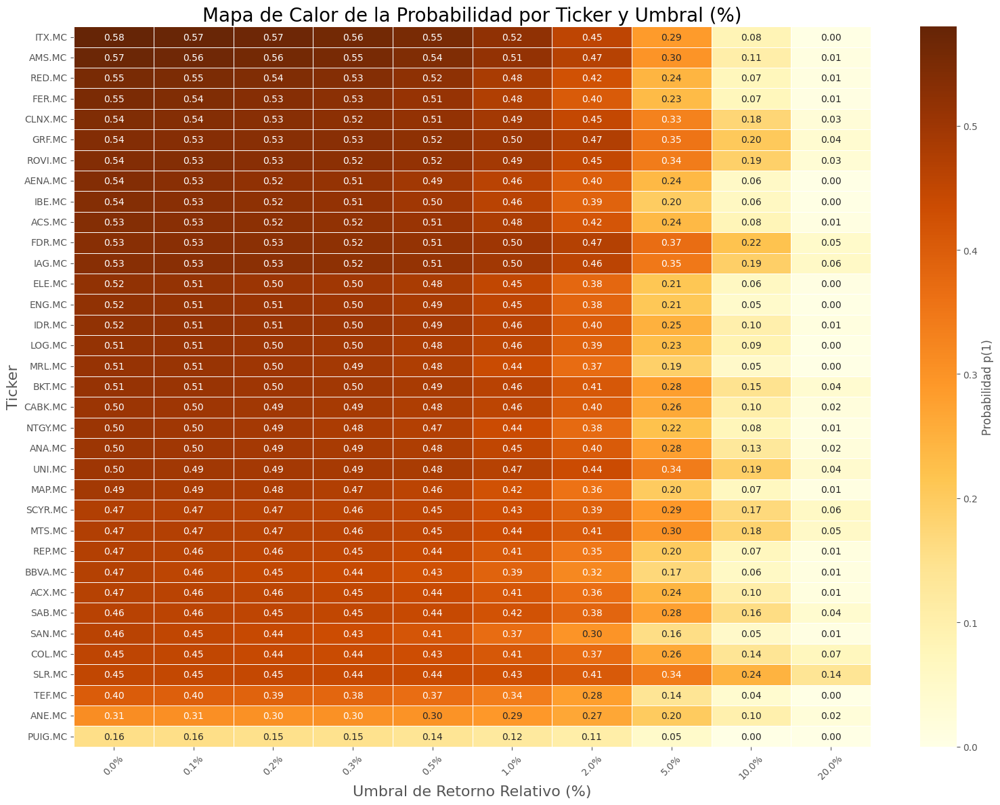

In [ ]:
# Cargar el DataFrame de tu tabla
df_p1 = p1_table.copy()

# Opcional: eliminar fila 'Average' para enfocarnos solo en tickers
df_p1 = df_p1.drop('Average', axis=0)

# Ordenar tickers por p(1) en el primer threshold (0.1%)
df_p1_sorted = df_p1.sort_values(by=df_p1.columns[0], ascending=False)


# Crear el heatmap
plt.figure(figsize=(16, 12))
sns.heatmap(
    df_p1_sorted,
    cmap="YlOrBr",         # Colores: de amarillo a azul
    annot=True,            # Mostrar los valores numéricos
    fmt=".2f",             # Formato dos decimales
    linewidths=0.5,        # Líneas divisorias
    cbar_kws={'label': 'Probabilidad p(1)'}  # Etiqueta de la barra de color
)

# Estética
plt.title('Mapa de Calor de la Probabilidad por Ticker y Umbral (%)', fontsize=20)
plt.xlabel('Umbral de Retorno Relativo (%)', fontsize=16)
plt.ylabel('Ticker', fontsize=16)
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

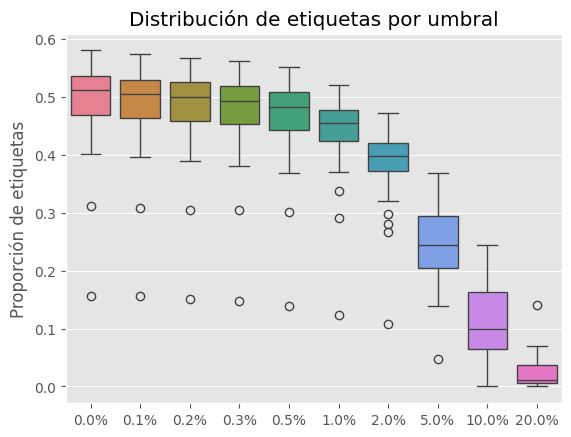

In [ ]:
p1_table_noavg = p1_table.drop("Average")
sns.boxplot(data=p1_table_noavg)
sns.set_style("whitegrid")

plt.ylabel("Proporción de etiquetas")
plt.title("Distribución de etiquetas por umbral")
plt.show()

# SEÑALES

## SEÑAL 1: GOLDEN CROSS
Señal clásica: cuando la media móvil corta (e.g., 50 días) cruza hacia arriba o hacia abajo la media larga (e.g., 200 días).


In [ ]:
label_col = f'Label_d_0.5_k_{k}'

In [ ]:
signal = 'golden_cross'

In [ ]:
df_signal[signal] = (
    df_signal.groupby('Ticker')['Close'].transform(lambda x: x.shift(1).ewm(span=50).mean()) >
    df_signal.groupby('Ticker')['Close'].transform(lambda x: x.shift(1).ewm(span=200).mean())
) & (
    df_signal.groupby('Ticker')['Close'].transform(lambda x: x.shift(2).ewm(span=50).mean()) <=
    df_signal.groupby('Ticker')['Close'].transform(lambda x: x.shift(2).ewm(span=200).mean())
)

In [ ]:
# Tasa de éxito cuando hay señal vs cuando no
success_with_signal = df_signal[df_signal[signal] == True][label_col].mean()
success_without_signal = df_signal[df_signal[signal] == False][label_col].mean()
print(f"Tasa con señal: {success_with_signal:.2%}")
print(f"Tasa sin señal: {success_without_signal:.2%}")

Tasa con señal: 49.03%
Tasa sin señal: 47.30%


In [ ]:
# Tabla de contingencia
contingency = pd.crosstab(df_signal[signal], df_signal[label_col])
chi2, p, _, _ = chi2_contingency(contingency)
roc_auc_score(df_signal[label_col], df_signal[signal].astype(int))

print('Media label 1:', df_signal[label_col].mean())
print(f"Tabla de contingencia ({signal}):")
print(contingency)
print(f"p-value: {p:.4f}")
print('ROC Score', roc_auc_score(df_signal[label_col], df_signal[signal].astype(int)))

Media label 1: 0.4731034643133288
Tabla de contingencia (golden_cross):
Label_d_0.5_k_30      0      1
golden_cross                  
False             90342  81100
True                290    279
p-value: 0.4339
ROC Score 0.5001143250291249


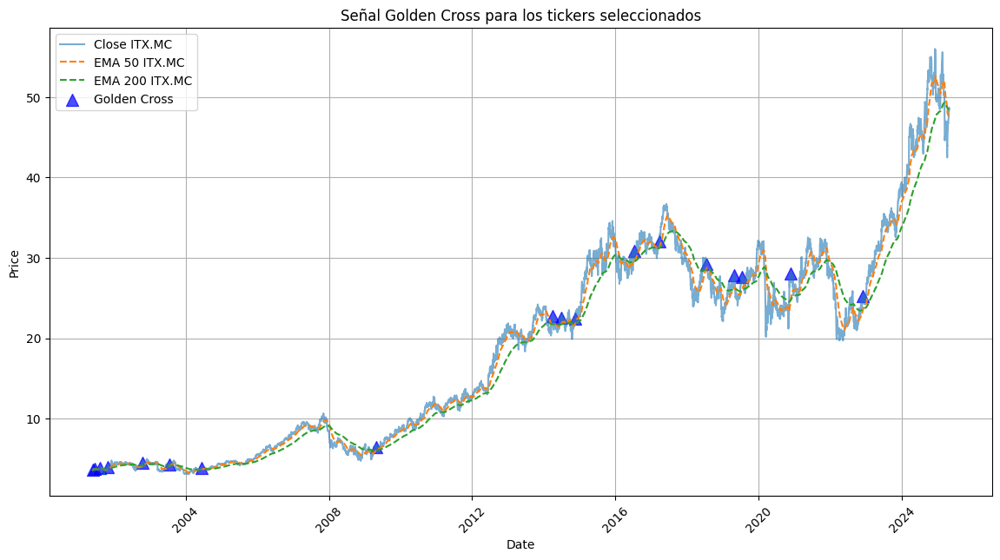

In [ ]:
df_signal['EMA_50'] = df_signal.groupby('Ticker')['Close'].transform(lambda x: x.shift(1).ewm(span=50).mean())
df_signal['EMA_200'] = df_signal.groupby('Ticker')['Close'].transform(lambda x: x.shift(1).ewm(span=200).mean())
df_signal['golden_cross'] = (
    df_signal['EMA_50'] > df_signal['EMA_200']
) & (df_signal['EMA_50'].shift(1) <= df_signal['EMA_200'].shift(1))

# Gráfico
plt.figure(figsize=(14, 7))
for ticker in df_signal['Ticker'].unique()[19:20]:  # seleccionar ticker
    df_ticker = df_signal[df_signal['Ticker'] == ticker]

    plt.plot(df_ticker['Date'], df_ticker['Close'], label=f'Close {ticker}', alpha=0.6)
    plt.plot(df_ticker['Date'], df_ticker['EMA_50'], label=f'EMA 50 {ticker}', linestyle='--')
    plt.plot(df_ticker['Date'], df_ticker['EMA_200'], label=f'EMA 200 {ticker}', linestyle='--')

    # Marcar las señales Golden Cross
    plt.scatter(df_ticker[df_ticker['golden_cross']].Date,
                df_ticker[df_ticker['golden_cross']]['Close'],
                marker='^', color='b', s=100, label='Golden Cross', alpha=0.7)

plt.title("Señal Golden Cross para los tickers seleccionados")
plt.legend(loc='best')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.grid(True)
plt.show()

## SEÑAL 2: ROTURA ASCENDENTE DE MEDIAS MOVILES
Precio supera el máximo de los últimos XX días.


In [ ]:
signal = 'breakout_signal'

In [ ]:
df_signal[signal] = (df_signal['Close'].shift(1) > df_signal['Close'].shift(2).rolling(30).max())

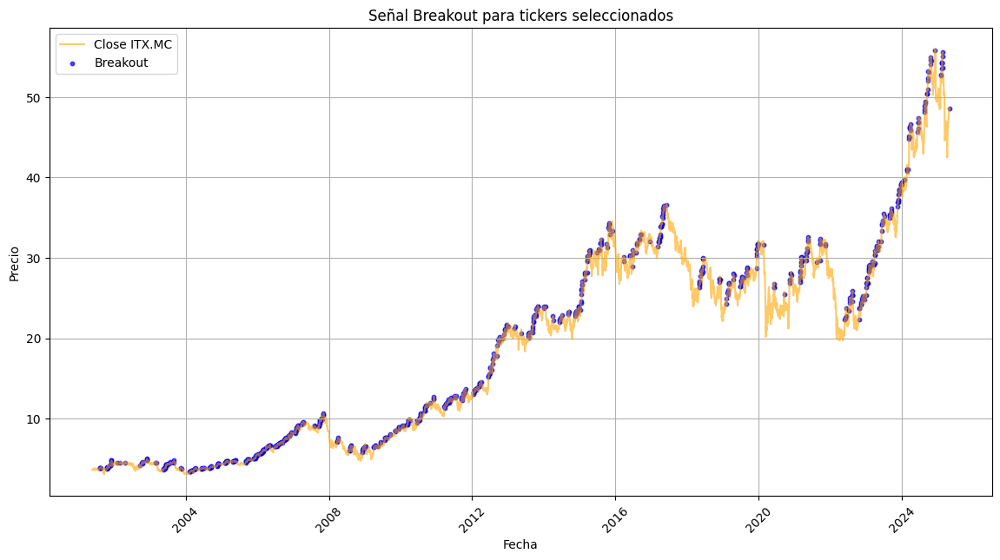

In [ ]:
# Gráfico para visualizar el Breakout Signal
plt.figure(figsize=(14, 7))
for ticker in df_signal['Ticker'].unique()[19:20]:
    df_ticker = df_signal[df_signal['Ticker'] == ticker]

    plt.plot(df_ticker['Date'], df_ticker['Close'], label=f'Close {ticker}', alpha=0.6, color='orange')

    # Marcar las señales de Breakout
    plt.scatter(df_ticker[df_ticker['breakout_signal']].Date,
                df_ticker[df_ticker['breakout_signal']]['Close'],
                marker='o', color='b', s=10, label='Breakout', alpha=0.7)

plt.title("Señal Breakout para tickers seleccionados")
plt.legend(loc='best')
plt.xlabel('Fecha')
plt.ylabel('Precio')
plt.xticks(rotation=45)
plt.grid(True)
plt.show()

## SEÑAL 3: PICO DE VOLUMEN
Si el volumen del día es mucho mayor que su media de los últimos XX días.

In [ ]:
signal = 'volume_spike'

In [ ]:
df_signal['volume_spike'] = (
    df_signal['Volume'] > df_signal.groupby('Ticker')['Volume'].transform(lambda x: x.shift(1).rolling(30).mean() * 1.5)
)

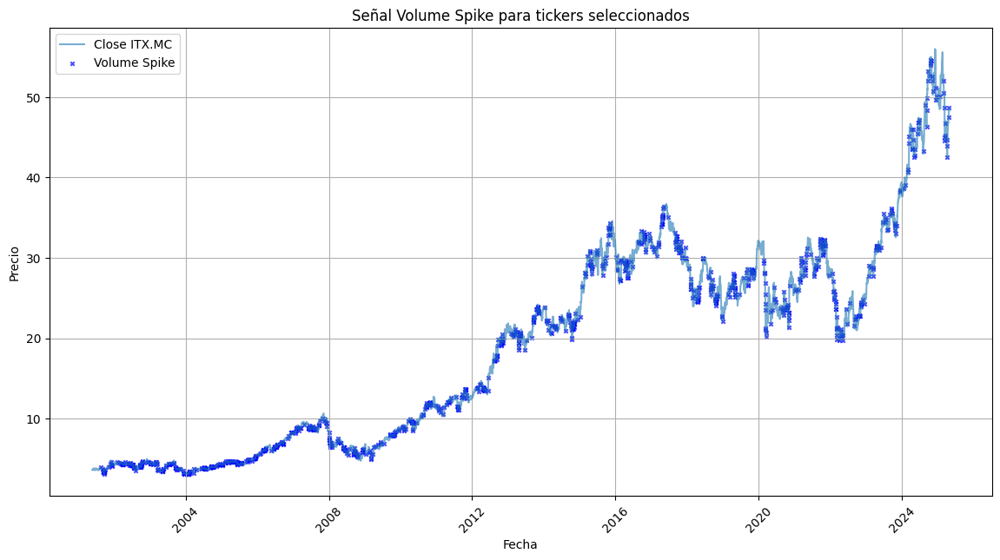

In [ ]:
# Gráfico para visualizar el Volume Spike Signal
plt.figure(figsize=(14, 7))
for ticker in df_signal['Ticker'].unique()[19:20]:
    df_ticker = df_signal[df_signal['Ticker'] == ticker]

    plt.plot(df_ticker['Date'], df_ticker['Close'], label=f'Close {ticker}', alpha=0.6)

    # Marcar las señales de Volume Spike
    plt.scatter(df_ticker[df_ticker['volume_spike']].Date,
                df_ticker[df_ticker['volume_spike']]['Close'],
                marker='x', color='b', s=10, label='Volume Spike', alpha=0.7)

plt.title(f"Señal Volume Spike para tickers seleccionados")
plt.legend(loc='best')
plt.xlabel('Fecha')
plt.ylabel('Precio')
plt.xticks(rotation=45)
plt.grid(True)
plt.show()

## SEÑAL 4: PULLBACK
Si el precio subió un XX% en los últimos Z días pero ha corregido ligeramente en los últimos Y.


In [ ]:
signal = 'pullback_signal'

In [ ]:
df_signal[signal] = (
    df_signal.groupby('Ticker')['Close'].pct_change(10).shift(1) > 0.2
) & (
    df_signal.groupby('Ticker')['Close'].pct_change(5).shift(1) < 0
)

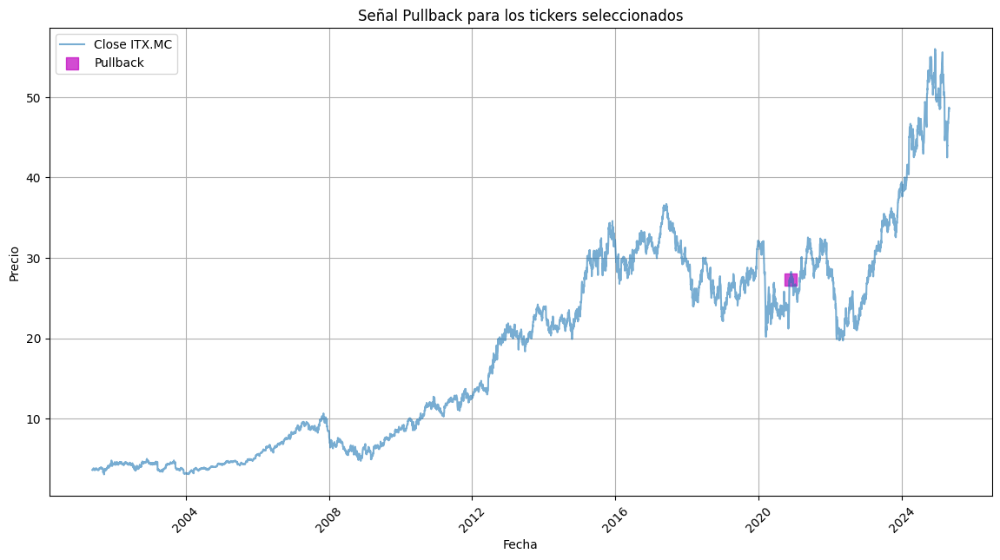

In [ ]:
# Gráfico para visualizar el Pullback Signal
plt.figure(figsize=(14, 7))
for ticker in df_signal['Ticker'].unique()[19:20]:
    df_ticker = df_signal[df_signal['Ticker'] == ticker]

    plt.plot(df_ticker['Date'], df_ticker['Close'], label=f'Close {ticker}', alpha=0.6)

    # Marcar las señales de Pullback
    plt.scatter(df_ticker[df_ticker['pullback_signal']].Date,
                df_ticker[df_ticker['pullback_signal']]['Close'],
                marker='s', color='m', s=100, label='Pullback', alpha=0.7)

plt.title("Señal Pullback para los tickers seleccionados")
plt.legend(loc='best')
plt.xlabel('Fecha')
plt.ylabel('Precio')
plt.xticks(rotation=45)
plt.grid(True)
plt.show()

## SEÑALES COMPLEJAS: MACD-12-26, BOLLINGER-20, RSI-14

In [ ]:
# Función segura de señales
def compute_signals(df):
    df = df.copy()
    df = df.sort_values("Date")

    # Inicializar columnas para evitar KeyError después
    df["MA20"] = np.nan
    df["STD20"] = np.nan
    df["Upper_BB"] = np.nan
    df["Lower_BB"] = np.nan
    df["BB_breakout"] = 0

    df["MACD"] = np.nan
    df["MACD_Signal"] = np.nan
    df["MACD_Crossover"] = 0

    df["RSI"] = np.nan
    df["RSI_oversold"] = 0
    df["RSI_overbought"] = 0

    # Bollinger Bands (20-day window)
    df["MA20"] = df["Close"].rolling(window=20, min_periods=1).mean()
    df["STD20"] = df["Close"].rolling(window=20, min_periods=1).std()
    df["Upper_BB"] = df["MA20"] + (2 * df["STD20"])
    df["Lower_BB"] = df["MA20"] - (2 * df["STD20"])
    df["BB_breakout"] = (df["Close"] > df["Upper_BB"]).astype(int)

    # MACD
    ema_12 = df["Close"].ewm(span=12, adjust=False).mean()
    ema_26 = df["Close"].ewm(span=26, adjust=False).mean()
    df["MACD"] = ema_12 - ema_26
    df["MACD_Signal"] = df["MACD"].ewm(span=9, adjust=False).mean()
    df["MACD_Crossover"] = ((df["MACD"] > df["MACD_Signal"]) & (df["MACD"].shift(1) <= df["MACD_Signal"].shift(1))).astype(int)

    # RSI (14-day)
    delta = df["Close"].diff()
    gain = delta.clip(lower=0)
    loss = -delta.clip(upper=0)

    avg_gain = gain.rolling(window=14, min_periods=1).mean()
    avg_loss = loss.rolling(window=14, min_periods=1).mean()
    rs = avg_gain / (avg_loss + 1e-6)
    df["RSI"] = 100 - (100 / (1 + rs))

    df["RSI_oversold"] = (df["RSI"] < 20).astype(int)
    df["RSI_overbought"] = (df["RSI"] > 80).astype(int)

    return df

In [ ]:
df_signal = df_signal.groupby("Ticker").apply(compute_signals).reset_index(drop=True)

<ipython-input-48-d16ef5192d0d>:1: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df_signal = df_signal.groupby("Ticker").apply(compute_signals).reset_index(drop=True)


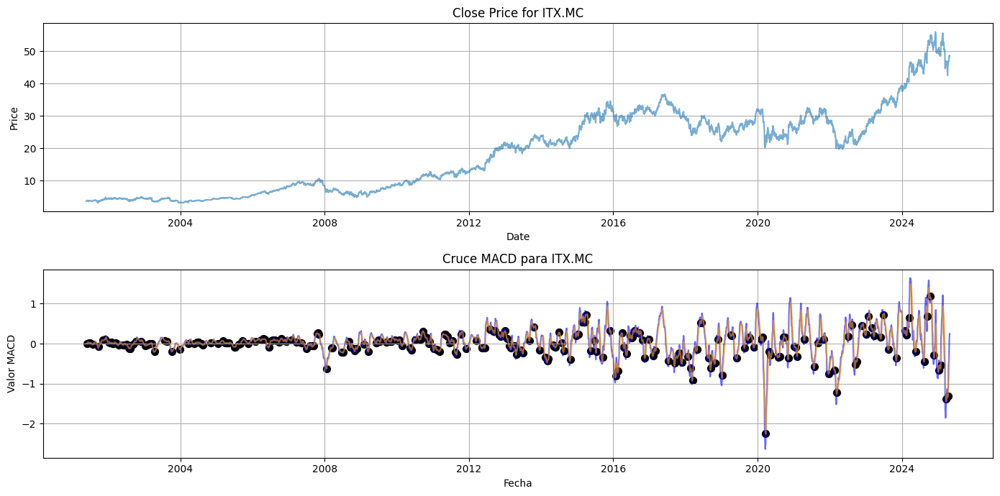

In [ ]:
# Gráfico MACD con Crossover
plt.figure(figsize=(14, 7))

for ticker in df_signal['Ticker'].unique()[19:20]:
    df_ticker = df_signal[df_signal['Ticker'] == ticker]

    # Graficar el Close
    plt.subplot(2, 1, 1)
    plt.plot(df_ticker['Date'], df_ticker['Close'], label=f'Close {ticker}', alpha=0.6)
    plt.title(f"Close Price for {ticker}")
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.grid(True)

    # Graficar MACD y señal
    plt.subplot(2, 1, 2)
    plt.plot(df_ticker['Date'], df_ticker['MACD'], label=f'MACD {ticker}', alpha=0.6, color='blue')
    plt.plot(df_ticker['Date'], df_ticker['MACD_Signal'], label=f'MACD Signal {ticker}', alpha=0.6, color='orange')

    # Resaltar el crossover
    plt.scatter(df_ticker[df_ticker['MACD_Crossover'] == 1]['Date'],
                df_ticker[df_ticker['MACD_Crossover'] == 1]['MACD'],
                marker='o', color='k', s=50, label='MACD Crossover')

    plt.title(f"Cruce MACD para {ticker}")
    plt.xlabel('Fecha')
    plt.ylabel('Valor MACD')
    plt.grid(True)

plt.tight_layout()
plt.show()

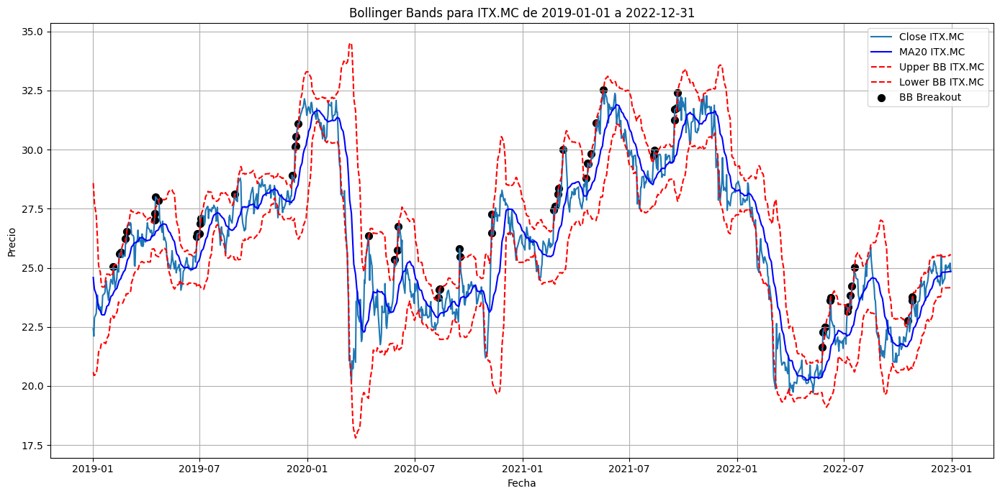

In [ ]:
# Función para filtrar por fecha y graficar las Bollinger Bands
def plot_bollinger_bands(df, start_date, end_date, ticker):
    # Filtrar por el rango de fechas
    df_filtered = df[(df['Date'] >= start_date) & (df['Date'] <= end_date) & (df['Ticker'] == ticker)]

    # Verificar si hay datos para el ticker y fechas seleccionadas
    if df_filtered.empty:
        print(f"No data available for {ticker} between {start_date} and {end_date}.")
        return

    # Graficar Bollinger Bands
    plt.figure(figsize=(14, 7))

    # Graficar el precio de cierre
    plt.plot(df_filtered['Date'], df_filtered['Close'], label=f'Close {ticker}', alpha=1.0)

    # Graficar la media móvil de 20 días (MA20)
    plt.plot(df_filtered['Date'], df_filtered['MA20'], label=f'MA20 {ticker}', color='blue')

    # Graficar las bandas superior e inferior
    plt.plot(df_filtered['Date'], df_filtered['Upper_BB'], label=f'Upper BB {ticker}', linestyle='--', color='red')
    plt.plot(df_filtered['Date'], df_filtered['Lower_BB'], label=f'Lower BB {ticker}', linestyle='--', color='red')

    # Resaltar los Breakouts
    plt.scatter(df_filtered[df_filtered['BB_breakout'] == 1]['Date'],
                df_filtered[df_filtered['BB_breakout'] == 1]['Close'],
                marker='o', color='k', s=50, label='BB Breakout')

    # Títulos y etiquetas
    plt.title(f"Bollinger Bands para {ticker} de {start_date} a {end_date}")
    plt.xlabel('Fecha')
    plt.ylabel('Precio')
    plt.grid(True)
    plt.legend()

    plt.tight_layout()
    plt.show()

start_date = '2019-01-01'
end_date = '2022-12-31'
ticker = 'ITX.MC'
plot_bollinger_bands(df_signal, start_date, end_date, ticker)

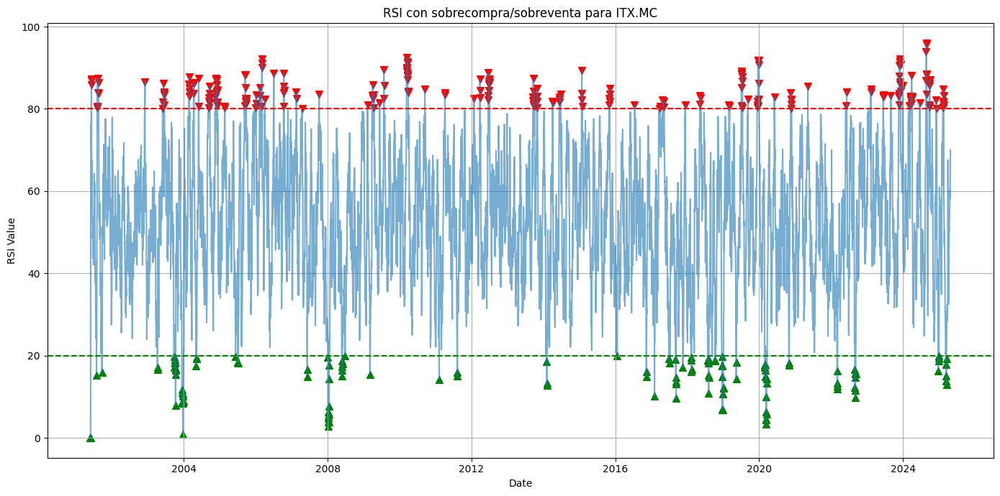

In [ ]:
# Gráfico RSI con Niveles de Sobrecompra y Sobreventa
plt.figure(figsize=(14, 7))

for ticker in df_signal['Ticker'].unique()[19:20]:
    df_ticker = df_signal[df_signal['Ticker'] == ticker]

    # Graficar el RSI
    plt.plot(df_ticker['Date'], df_ticker['RSI'], label=f'RSI {ticker}', alpha=0.6)

    # Añadir líneas de sobrecompra (80) y sobreventa (20)
    plt.axhline(80, color='red', linestyle='--', label='Overbought (80)')
    plt.axhline(20, color='green', linestyle='--', label='Oversold (20)')

    # Resaltar las señales de sobrecompra y sobreventa
    plt.scatter(df_ticker[df_ticker['RSI_overbought'] == 1]['Date'],
                df_ticker[df_ticker['RSI_overbought'] == 1]['RSI'],
                marker='v', color='r', s=50, label='RSI Overbought')

    plt.scatter(df_ticker[df_ticker['RSI_oversold'] == 1]['Date'],
                df_ticker[df_ticker['RSI_oversold'] == 1]['RSI'],
                marker='^', color='g', s=50, label='RSI Oversold')

    plt.title(f"RSI con sobrecompra/sobreventa para {ticker}")
    plt.xlabel('Date')
    plt.ylabel('RSI Value')
    plt.grid(True)

plt.tight_layout()
plt.show()

## COMBINACION DE SEÑALES

In [ ]:
# Señal 1: Pullback en tendencia alcista + sobreventa
# Lógica: La acción está en una tendencia alcista y sufre una pequeña corrección (pullback) que la deja en sobreventa, ideal para entrar.
df_signal['combo_pullback_rsi'] = df_signal['pullback_signal'] & df_signal['RSI_oversold']

# Señal 2: Ruptura de banda de Bollinger + volumen alto
# Lógica: Ruptura del rango de volatilidad (BB) respaldada por volumen anormal, lo que puede indicar un movimiento explosivo.
df_signal['combo_bb_volume'] = df_signal['BB_breakout'] & df_signal['volume_spike']

# Señal 3: Ruptura de resistencia + MACD alcista
# Lógica: Confirmación de ruptura técnica con un cruce alcista del MACD.
df_signal['combo_breakout_macd'] = df_signal['breakout_signal'] & df_signal['MACD_Crossover']

# Señal 4: Cruce de medias (Golden Cross) + sobrecompra (RSI alto)
# Lógica: Tendencia alcista ya desarrollada, pero sobrecomprada — posible señal de agotamiento.
df_signal['combo_golden_rsi_over'] = df_signal['golden_cross'] & df_signal['RSI_overbought']

# Señal 5: MACD alcista + RSI en zona media (no extremo)
# Lógica: Momentum ascendente sin estar sobrecomprado ni sobrevendido, lo que puede significar inicio de tendencia.
df_signal['combo_macd_rsi_mid'] = df_signal['MACD_Crossover'] & (
    (df_signal['RSI'] > 40) & (df_signal['RSI'] < 60)
)

# Señal 6: Bollinger Breakout + RSI bajo (posible rebote desde zona de soporte)
# Lógica: La acción rompe por debajo la banda inferior y está sobrevendida → posible rebote técnico.
df_signal['combo_bb_rsi_low'] = df_signal['BB_breakout'] & df_signal['RSI_oversold']

# Señal 7: Pullback + Golden Cross
# Lógica: El activo está en tendencia (cruce de medias) y ha retrocedido, dando posible oportunidad de entrada.
df_signal['combo_pullback_golden'] = df_signal['pullback_signal'] & df_signal['golden_cross']

df_signal['combo_bb_rsi'] = df_signal['BB_breakout'] & df_signal['RSI_overbought']

df_signal['combo_breakout_pullback'] = df_signal['breakout_signal'] & df_signal['pullback_signal']

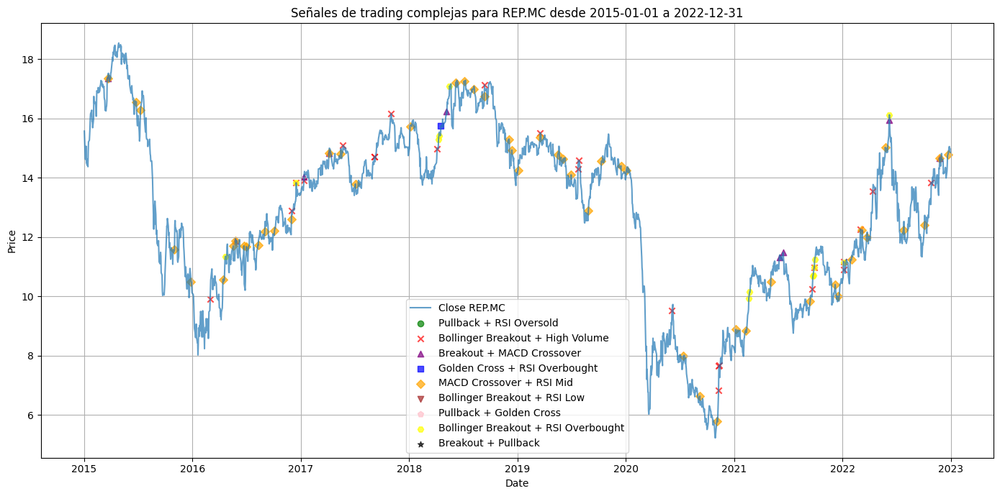

In [ ]:
# Función para graficar señales complejas
def plot_signals(df, start_date, end_date, ticker):
    # Filtrar los datos por rango de fechas y ticker
    df_filtered = df[(df['Date'] >= start_date) & (df['Date'] <= end_date) & (df['Ticker'] == ticker)]

    # Verificar si hay datos para el ticker y fechas seleccionadas
    if df_filtered.empty:
        print(f"No data available for {ticker} between {start_date} and {end_date}.")
        return

    # Graficar el precio de cierre
    plt.figure(figsize=(14, 7))
    plt.plot(df_filtered['Date'], df_filtered['Close'], label=f'Close {ticker}', alpha=0.7)

    # Señales complejas
    signals = [
        ('combo_pullback_rsi', 'Pullback + RSI Oversold', 'green', 'o'),
        ('combo_bb_volume', 'Bollinger Breakout + High Volume', 'red', 'x'),
        ('combo_breakout_macd', 'Breakout + MACD Crossover', 'purple', '^'),
        ('combo_golden_rsi_over', 'Golden Cross + RSI Overbought', 'blue', 's'),
        ('combo_macd_rsi_mid', 'MACD Crossover + RSI Mid', 'orange', 'D'),
        ('combo_bb_rsi_low', 'Bollinger Breakout + RSI Low', 'brown', 'v'),
        ('combo_pullback_golden', 'Pullback + Golden Cross', 'pink', 'p'),
        ('combo_bb_rsi', 'Bollinger Breakout + RSI Overbought', 'yellow', 'H'),
        ('combo_breakout_pullback', 'Breakout + Pullback', 'black', '*')
    ]

    for signal, label, color, marker in signals:
        # Filtrar las señales que están activas (True)
        signal_points = df_filtered[df_filtered[signal] == 1]
        plt.scatter(signal_points['Date'], signal_points['Close'], label=label, color=color, marker=marker, alpha=0.7)

    # Títulos y etiquetas
    plt.title(f"Señales de trading complejas para {ticker} desde {start_date} a {end_date}")
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.grid(True)
    plt.legend()

    plt.tight_layout()
    plt.show()

start_date = '2015-01-01'
end_date = '2022-12-31'
ticker = 'REP.MC'

plot_signals(df_signal, start_date, end_date, ticker)

## OTRAS

In [ ]:
df_signal['RR_rolling_mean_180'] = df_signal['Past_Rel_Return_180'].rolling(window=5).mean()
df_signal['RR_rolling_std_180'] = df_signal['Past_Rel_Return_180'].rolling(window=5).std()

df_signal['Sharpe_RR_180'] = df_signal['Past_Rel_Return_180'] / df_signal['RR_rolling_std_180']

df_signal['Momentum_ratio_360_180'] = df_signal['Past_Rel_Return_360'] / df_signal['Past_Rel_Return_180']

In [ ]:
df_signal['Rel_Rank_180'] = df_signal.groupby('Date')['Past_Rel_Return_180'].rank(pct=True)
df_signal['Rel_Z_180'] = (df_signal['Past_Rel_Return_180'] - df_signal.groupby('Date')['Past_Rel_Return_180'].transform('mean')) / df_signal.groupby('Date')['Past_Rel_Return_180'].transform('std')


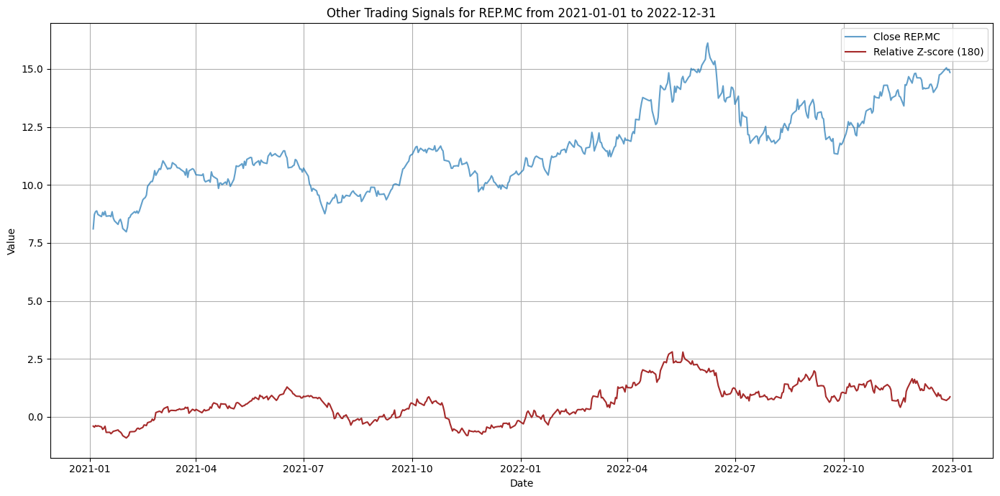

In [ ]:
def plot_other_signals(df, start_date, end_date, ticker):
    # Filtrar los datos por rango de fechas y ticker
    df_filtered = df[(df['Date'] >= start_date) & (df['Date'] <= end_date) & (df['Ticker'] == ticker)]

    # Verificar si hay datos para el ticker y fechas seleccionadas
    if df_filtered.empty:
        print(f"No data available for {ticker} between {start_date} and {end_date}.")
        return

    # Crear la figura
    plt.figure(figsize=(14, 7))

    # Graficar el precio de cierre
    plt.plot(df_filtered['Date'], df_filtered['Close'], label=f'Close {ticker}', alpha=0.7)

    # Señales complejas (Rolling Mean y Rolling Std, Sharpe, Momentum Ratio, etc.)
    signals = [
        #('RR_rolling_mean_180', 'Rolling Mean (180)', 'green', '--'),
        #('RR_rolling_std_180', 'Rolling Std (180)', 'orange', '--'),
        #('Sharpe_RR_180', 'Sharpe Ratio (180)', 'blue', '-'),
        #('Momentum_ratio_360_180', 'Momentum Ratio (360/180)', 'red', '-'),
        #('Rel_Rank_180', 'Relative Rank (180)', 'purple', '-'),
        ('Rel_Z_180', 'Relative Z-score (180)', 'brown', '-')
    ]

    for signal, label, color, linestyle in signals:
        # Graficar cada señal en función de la fecha
        plt.plot(df_filtered['Date'], df_filtered[signal], label=label, color=color, linestyle=linestyle)

    # Títulos y etiquetas
    plt.title(f"Other Trading Signals for {ticker} from {start_date} to {end_date}")
    plt.xlabel('Date')
    plt.ylabel('Value')
    plt.grid(True)
    plt.legend()

    # Mejorar la visualización
    plt.tight_layout()
    plt.show()

# Ejemplo de uso:
# Introduce las fechas en formato 'YYYY-MM-DD' y el ticker deseado
start_date = '2021-01-01'
end_date = '2022-12-31'
ticker = 'REP.MC'  # Puedes cambiar el ticker por el que desees

plot_other_signals(df_signal, start_date, end_date, ticker)

## RESUMEN

In [ ]:
signals = ['golden_cross', 'breakout_signal', 'volume_spike', 'pullback_signal', 'BB_breakout',
           'MACD_Crossover', 'RSI_oversold', 'RSI_overbought', 'combo_pullback_rsi', 'combo_bb_volume',
           'combo_breakout_macd', 'combo_golden_rsi_over', 'combo_macd_rsi_mid', 'combo_bb_rsi_low',
           'combo_pullback_golden', 'combo_bb_rsi', 'combo_breakout_pullback', 'RR_rolling_mean_180', 'RR_rolling_std_180',
           'Sharpe_RR_180', 'Momentum_ratio_360_180', 'Rel_Rank_180', 'Rel_Z_180']

df_signal.loc[:, signals] = df_signal[signals].fillna(0)

for col in signals:
    df_signal[col] = df_signal[col].astype(int)

summary_signals = pd.DataFrame(index=signals, columns=['Positivo con señal', 'Positivo sin señal', 'p-value', 'ROC AUC'])

for signal in signals:
    '''
    # Check for 0 occurrences or NaN values
    if df_signal[signal].sum() == 0 or df_signal[signal].isnull().values.any():
        print(f"Signal '{signal}' has 0 occurrences or NaN values. Skipping...")
        summary_signals.loc[signal] = [np.nan, np.nan, np.nan, np.nan] # Fill with NaN for skipped signals
        continue
    '''
    try:
        success_with_signal = df_signal[df_signal[signal] == 1][label_col].mean()
        success_without_signal = df_signal[df_signal[signal] == 0][label_col].mean()
        contingency = pd.crosstab(df_signal[signal], df_signal[label_col])
        chi2, p, _, _ = chi2_contingency(contingency)
        roc_auc = roc_auc_score(df_signal[label_col], df_signal[signal])

        summary_signals.loc[signal] = [success_with_signal, success_without_signal, p, roc_auc]

    except Exception as e:
        print(f"Error calculating summary for signal {signal}: {e}")
        summary_signals.loc[signal] = [np.nan, np.nan, np.nan, np.nan] # Fill with NaN for signals with errors

summary_signals

,Positivo con señal,Positivo sin señal,p-value,ROC AUC
golden_cross,0.490334,0.473046,0.433906,0.500114
breakout_signal,0.482573,0.471954,0.006274,0.502056
volume_spike,0.47311,0.473102,1.0,0.500002
pullback_signal,0.635417,0.473013,0.002043,0.500182
BB_breakout,0.486886,0.472295,0.005735,0.501532
MACD_Crossover,0.474717,0.473036,0.793901,0.500129
RSI_oversold,0.472186,0.473133,0.902113,0.499942
RSI_overbought,0.502896,0.471595,0.0,0.502879
combo_pullback_rsi,NaN,0.473103,1.0,0.5
combo_bb_volume,0.479846,0.472979,0.456887,0.500246


In [ ]:
# Filter for signals with better success with the signal than without
end_signals = summary_signals[summary_signals['Positivo con señal'] > summary_signals['Positivo sin señal']]

# Further filter for low p-values
end_signals = end_signals[summary_signals['p-value'] < 0.05]

end_signals

<ipython-input-58-16dc3485a226>:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  end_signals = end_signals[summary_signals['p-value'] < 0.05]


,Positivo con señal,Positivo sin señal,p-value,ROC AUC
breakout_signal,0.482573,0.471954,0.006274,0.502056
pullback_signal,0.635417,0.473013,0.002043,0.500182
BB_breakout,0.486886,0.472295,0.005735,0.501532
RSI_overbought,0.502896,0.471595,0.0,0.502879
RR_rolling_mean_180,0.612416,0.472173,0.0,0.501848
Sharpe_RR_180,0.479086,0.476558,0.0,0.519059
Rel_Rank_180,0.514614,0.471535,0.0,0.503031
Rel_Z_180,0.506251,0.47085,0.0,0.513742


## PREANALYSIS

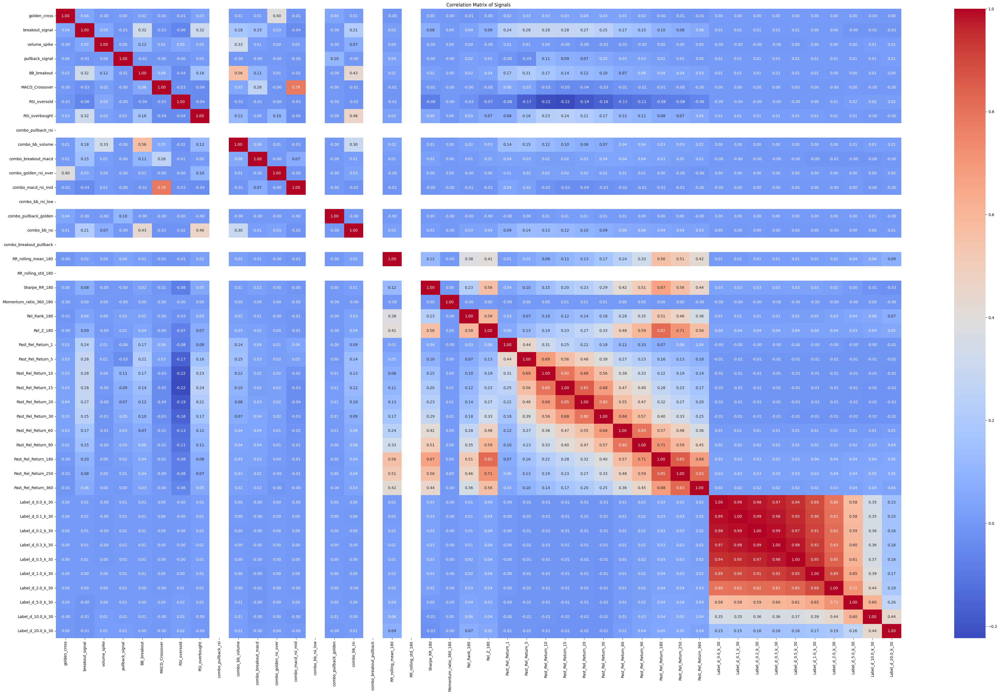

In [ ]:
label_cols = [col for col in df_signal.columns if 'Label' in col]
past_returns_features = [col for col in df_signal.columns if 'Past_Rel_Return' in col]


# Correlation analysis
correlation_matrix = df_signal[signals + past_returns_features + label_cols].corr()

# Create the heatmap
plt.figure(figsize=(50, 30))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix of Signals')
plt.show()


# CLASSIFICATION

## INITIALIZE

In [ ]:
beta = 1
n_splits = 5
quantile = 80
k = future_days[0]

past_returns_features = [col for col in df_signal.columns if 'Past_Rel_Return' in col]
macro_features = [col for col in df_signal.columns if 'Past_Change_' in col]
signals_all = signals
indicators = ['MA20', 'STD20', 'Upper_BB', 'Lower_BB', 'MACD', 'RSI']

feature_cols = past_returns_features + macro_features + end_signals.index.tolist() # + signals_all + indicators

In [ ]:
feature_cols

['Past_Rel_Return_1',
 'Past_Rel_Return_5',
 'Past_Rel_Return_10',
 'Past_Rel_Return_15',
 'Past_Rel_Return_20',
 'Past_Rel_Return_30',
 'Past_Rel_Return_60',
 'Past_Rel_Return_90',
 'Past_Rel_Return_180',
 'Past_Rel_Return_250',
 'Past_Rel_Return_360',
 'Past_Change_GDP_1',
 'Past_Change_GDP_5',
 'Past_Change_GDP_10',
 'Past_Change_GDP_15',
 'Past_Change_GDP_20',
 'Past_Change_GDP_30',
 'Past_Change_GDP_60',
 'Past_Change_GDP_90',
 'Past_Change_GDP_180',
 'Past_Change_GDP_250',
 'Past_Change_GDP_360',
 'Past_Change_Unemployment_Rate_1',
 'Past_Change_Unemployment_Rate_5',
 'Past_Change_Unemployment_Rate_10',
 'Past_Change_Unemployment_Rate_15',
 'Past_Change_Unemployment_Rate_20',
 'Past_Change_Unemployment_Rate_30',
 'Past_Change_Unemployment_Rate_60',
 'Past_Change_Unemployment_Rate_90',
 'Past_Change_Unemployment_Rate_180',
 'Past_Change_Unemployment_Rate_250',
 'Past_Change_Unemployment_Rate_360',
 'Past_Change_Inflation_(CPI)_1',
 'Past_Change_Inflation_(CPI)_5',
 'Past_Change_In

In [ ]:
params = {
    "objective": "binary:logistic",  # Clasificación binaria
    "eval_metric": "logloss",        # Función de pérdida
    "eta": 0.25,                      # Tasa de aprendizaje
    "max_depth": 8,                   # Profundidad del árbol
    "subsample": 0.8,                  # Para evitar overfitting
    "colsample_bytree": 0.55,           # Para evitar overfitting
    "n_estimators": 64,
    "scale_pos_weight": 2,
    "random_state": seed
}

## XGBOOST - TOTAL

In [ ]:
# Definir fecha de corte para train y test
train_cutoff = df_signal['Date'].quantile((quantile)/100)

# División basada en fecha
train_df = df_signal[df_signal['Date'] <= train_cutoff].copy()
test_df = df_signal[df_signal['Date'] > train_cutoff].copy()

# Verificar las dimensiones de los conjuntos
print(f"Train dataset size: {train_df.shape}")
print(f"Test dataset size: {test_df.shape}")

Train dataset size: (137617, 121)
Test dataset size: (34394, 121)


In [ ]:
# Obtener X e y
X_train_final = train_df[feature_cols]
y_train_final = train_df[label_col]
X_test_final = test_df[feature_cols]
y_test_final = test_df[label_col]

In [ ]:
# XGBmodel
XGBmodel = XGBClassifier(**params)

# Entrenar modelo final en todo el conjunto de entrenamiento
XGBmodel.fit(X_train_final, y_train_final)

# Predecir labels con dataset de test
y_test_pred = XGBmodel.predict(X_test_final)

In [ ]:
# Métricas de rendimiento en test
test_acc = accuracy_score(y_test_final, y_test_pred)
test_prec = precision_score(y_test_final, y_test_pred, zero_division=0)
test_rec = recall_score(y_test_final, y_test_pred, zero_division=0)
test_f = fbeta_score(y_test_final, y_test_pred, zero_division=0, beta=beta)

print("\n📌 Resultados en Test:")
print(f"Accuracy: {test_acc:.4f}")
print(f"Precision: {test_prec:.4f}")
print(f"Recall: {test_rec:.4f}")
print(f"F-score: {test_f:.4f}")


📌 Resultados en Test:
Accuracy: 0.4817
Precision: 0.4243
Recall: 0.5170
F-score: 0.4661


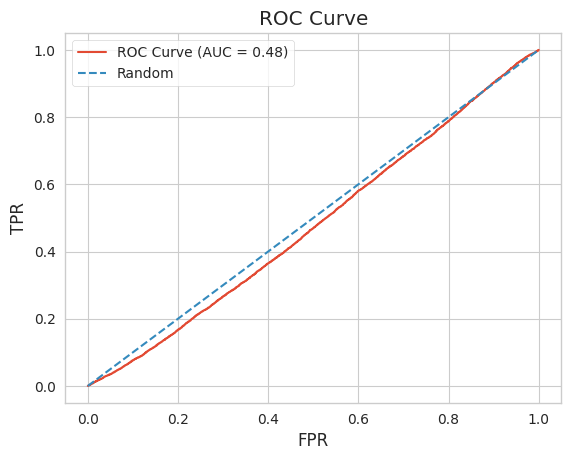

In [ ]:
y_test_prob = XGBmodel.predict_proba(X_test_final)[:, 1]

fpr, tpr, _ = roc_curve(y_test_final, y_test_prob)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', label='Random')
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.title('ROC Curve')
plt.legend()
plt.grid(True)
plt.show()

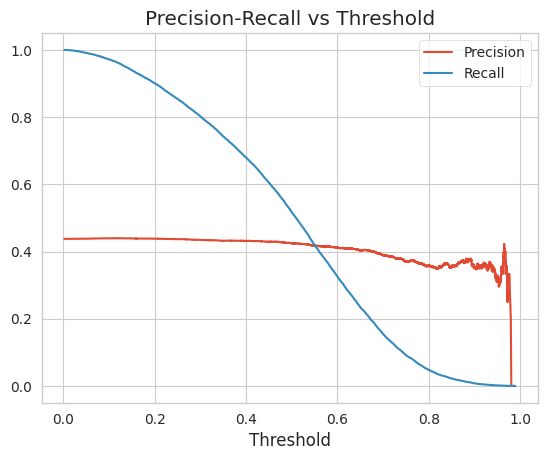

In [ ]:
precisions, recalls, thresholds = precision_recall_curve(y_test_final, y_test_prob)

plt.plot(thresholds, precisions[:-1], label='Precision')
plt.plot(thresholds, recalls[:-1], label='Recall')
plt.xlabel('Threshold')
plt.legend()
plt.grid(True)
plt.title('Precision-Recall vs Threshold')
plt.show()

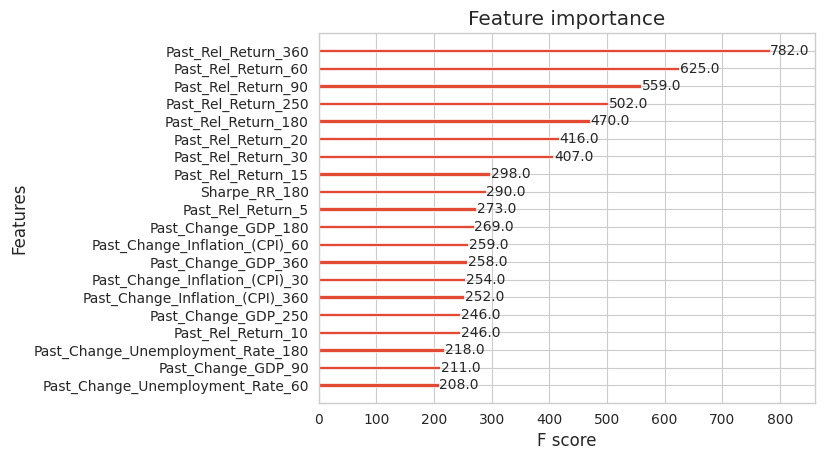

In [ ]:
plot_importance(XGBmodel, max_num_features=20)
plt.show()

In [ ]:
XGBmodel.get_booster().get_score(importance_type='gain')

{'Past_Rel_Return_1': 4.515414237976074,
 'Past_Rel_Return_5': 7.250226020812988,
 'Past_Rel_Return_10': 10.5055570602417,
 'Past_Rel_Return_15': 10.274249076843262,
 'Past_Rel_Return_20': 11.408124923706055,
 'Past_Rel_Return_30': 15.008356094360352,
 'Past_Rel_Return_60': 15.427862167358398,
 'Past_Rel_Return_90': 17.077564239501953,
 'Past_Rel_Return_180': 20.504213333129883,
 'Past_Rel_Return_250': 20.31786346435547,
 'Past_Rel_Return_360': 16.97503089904785,
 'Past_Change_GDP_1': 33.386959075927734,
 'Past_Change_GDP_5': 33.44818115234375,
 'Past_Change_GDP_10': 30.15868377685547,
 'Past_Change_GDP_15': 21.525501251220703,
 'Past_Change_GDP_20': 21.01164436340332,
 'Past_Change_GDP_30': 22.050275802612305,
 'Past_Change_GDP_60': 19.608455657958984,
 'Past_Change_GDP_90': 22.361787796020508,
 'Past_Change_GDP_180': 23.848512649536133,
 'Past_Change_GDP_250': 18.911388397216797,
 'Past_Change_GDP_360': 24.273048400878906,
 'Past_Change_Unemployment_Rate_1': 12.178132057189941,
 'Pas

[[ 8789 10556]
 [ 7269  7780]]


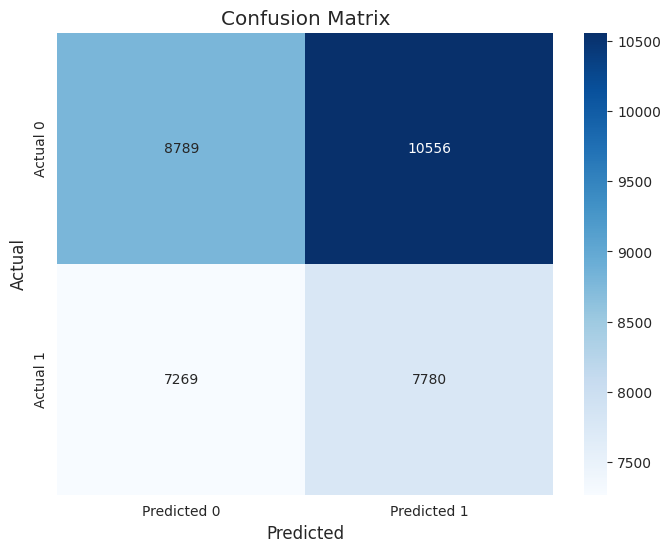

In [ ]:
cm = confusion_matrix(y_test_final, y_test_pred)
print(cm)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Predicted 0', 'Predicted 1'],
            yticklabels=['Actual 0', 'Actual 1'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

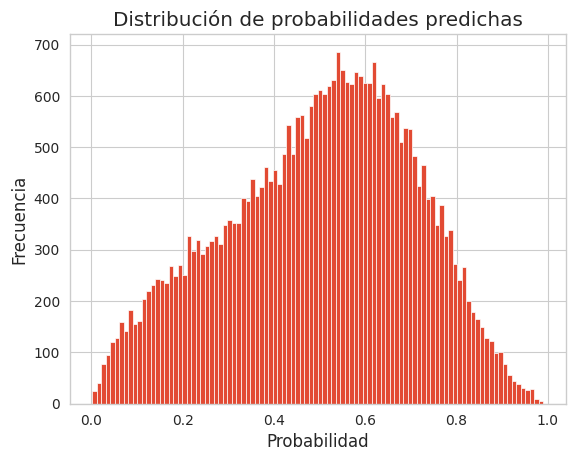

In [ ]:
plt.hist(y_test_prob, bins=100)
plt.title("Distribución de probabilidades predichas")
plt.xlabel("Probabilidad")
plt.ylabel("Frecuencia")
plt.grid(True)
plt.show()

## XGBOOST - TOTAL TIMESERIESSPLIT

In [ ]:
# Definir fecha de corte para train y test
#train_cutoff = df_signal[df_signal['Ticker'] == 'ITX.MC']['Date'].quantile((quantile)/100)
train_cutoff = df_signal['Date'].quantile((quantile)/100)


# División basada en fecha
train_df = df_signal[df_signal['Date'] <= train_cutoff].copy()
test_df = df_signal[df_signal['Date'] > train_cutoff].copy()

# Verificar dimensiones
print(f"Train dataset size: {train_df.shape}")
print(f"Test dataset size: {test_df.shape}")

# Crear TimeSeriesSplit
tscv = TimeSeriesSplit(n_splits=n_splits)

Train dataset size: (137617, 121)
Test dataset size: (34394, 121)


In [ ]:
# Obtener X e y del conjunto de entrenamiento
X_train_final = train_df[feature_cols]
y_train_final = train_df[label_col]
X_test_final = test_df[feature_cols]
y_test_final = test_df[label_col]

In [ ]:
# Ajustar scale_pos_weight basado en el desbalance de clases
##scale_pos_weight = sum(y_train_total == 0) / sum(y_train_total == 1)
##params["scale_pos_weight"] = scale_pos_weight

In [ ]:
# Lista para almacenar resultados de validación cruzada, mejor modelo, etc.
results = []
best_f2 = -1
best_model = None

val_probs_all = []
val_labels_all = []

# Validación cruzada temporal en train_df
for i, (train_index, val_index) in enumerate(tscv.split(X_train_final)):
    X_train, X_val = X_train_final.iloc[train_index], X_train_final.iloc[val_index]
    y_train, y_val = y_train_final.iloc[train_index], y_train_final.iloc[val_index]

    #print(f"Fold {i}:")
    #print(f"  Train: index={train_index}")
    #print(f"  Test:  index={val_index}")

    # Crear y entrenar modelo
    model = XGBClassifier(**params)
    model.fit(X_train, y_train)

    # Predicciones en validación
    y_pred = model.predict(X_val)

    # Evaluar rendimiento
    acc = accuracy_score(y_val, y_pred)
    prec = precision_score(y_val, y_pred, zero_division=0)
    rec = recall_score(y_val, y_pred, zero_division=0)
    f = fbeta_score(y_val, y_pred, zero_division=0, beta=beta)

    # Guardar resultados
    results.append({
        'Train Start': X_train.index.min(),
        'Train End': X_train.index.max(),
        'Val Start': X_val.index.min(),
        'Val End': X_val.index.max(),
        'Accuracy': acc,
        'Precision': prec,
        'Recall': rec,
        'F-score': f
    })

    y_val_proba = model.predict_proba(X_val)[:, 1]

    # Guardar resultados
    val_probs_all.extend(y_val_proba)
    val_labels_all.extend(y_val)

      # Guardar el mejor modelo
    if f > best_f2:
        best_f2 = f
        XGBoost_best = deepcopy(model)

In [ ]:
# Convertir resultados a DataFrame
results_df = pd.DataFrame(results)

# Mostrar métricas promedio de validación
print("Resultados de validación cruzada (promedio):")
print(results_df.mean(numeric_only=True).round(4))

Resultados de validación cruzada (promedio):
Train Start         0.0000
Train End       86117.2000
Val Start       86118.2000
Val End        114530.4000
Accuracy            0.5423
Precision           0.5183
Recall              0.6908
F-score             0.5905
dtype: float64


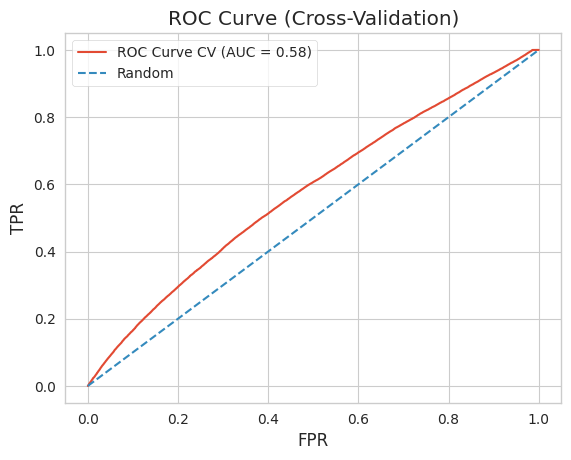

In [ ]:
fpr, tpr, _ = roc_curve(val_labels_all, val_probs_all)
roc_auc_val = auc(fpr, tpr)

plt.plot(fpr, tpr, label=f'ROC Curve CV (AUC = {roc_auc_val:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', label='Random')
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.title('ROC Curve (Cross-Validation)')
plt.legend()
plt.grid(True)
plt.show()

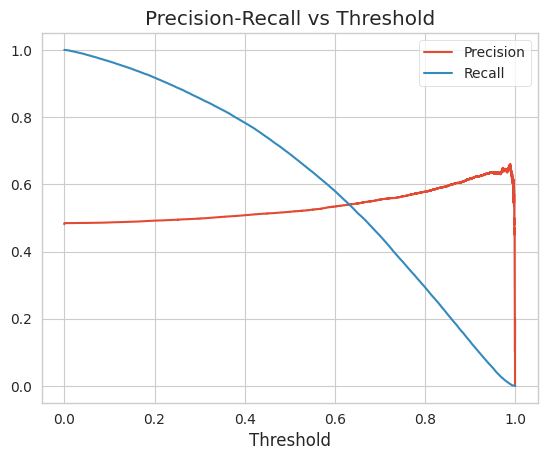

In [ ]:
precisions, recalls, thresholds = precision_recall_curve(val_labels_all, val_probs_all)

plt.plot(thresholds, precisions[:-1], label='Precision')
plt.plot(thresholds, recalls[:-1], label='Recall')
plt.xlabel('Threshold')
plt.legend()
plt.grid(True)
plt.title('Precision-Recall vs Threshold')
plt.show()

In [ ]:
# Entrenar modelo final en todo el conjunto de entrenamiento
#XGBoost_best.fit(X_train_final, y_train_final)

# Prediccion
y_test_pred = XGBoost_best.predict(X_test_final)

In [ ]:
# Métricas en test
test_acc = accuracy_score(y_test_final, y_test_pred)
test_prec = precision_score(y_test_final, y_test_pred, zero_division=0)
test_rec = recall_score(y_test_final, y_test_pred, zero_division=0)
test_f = fbeta_score(y_test_final, y_test_pred, zero_division=0, beta=beta)

print(f"Test Accuracy: {test_acc:.4f}")
print(f"Test Precision: {test_prec:.4f}")
print(f"Test Recall: {test_rec:.4f}")
print(f"Test F-score: {test_f:.4f}")

Test Accuracy: 0.4933
Test Precision: 0.4310
Test Recall: 0.4939
Test F-score: 0.4603


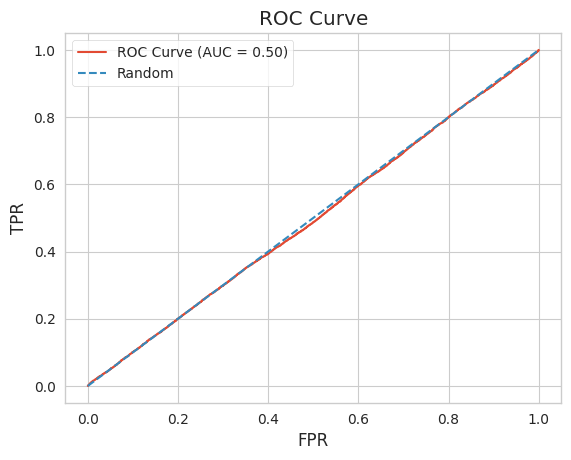

In [ ]:
y_test_prob = XGBoost_best.predict_proba(X_test_final)[:, 1]

fpr, tpr, _ = roc_curve(y_test_final, y_test_prob)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', label='Random')
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.title('ROC Curve')
plt.legend()
plt.grid(True)
plt.show()

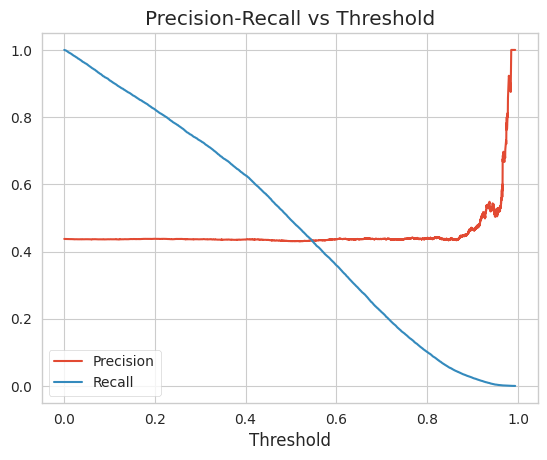

In [ ]:
precisions, recalls, thresholds = precision_recall_curve(y_test_final, y_test_prob)

plt.plot(thresholds, precisions[:-1], label='Precision')
plt.plot(thresholds, recalls[:-1], label='Recall')
plt.xlabel('Threshold')
plt.legend()
plt.grid(True)
plt.title('Precision-Recall vs Threshold')
plt.show()

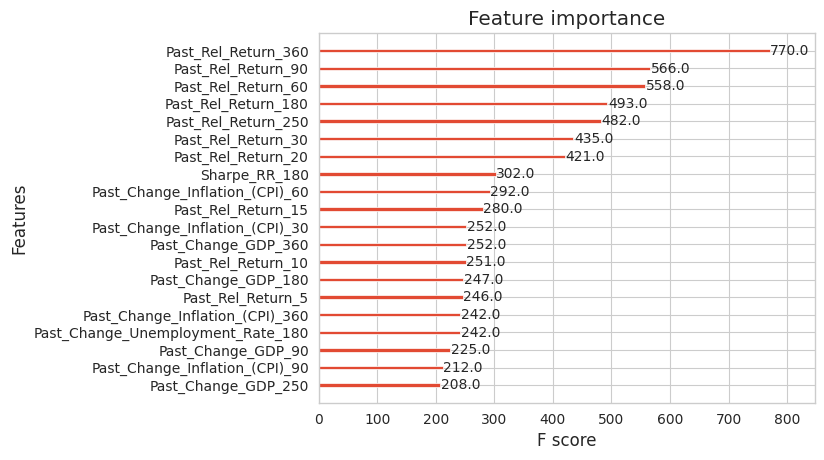

In [ ]:
plot_importance(XGBoost_best, max_num_features=20)
plt.show()

In [ ]:
XGBoost_best.get_booster().get_score(importance_type='gain')

{'Past_Rel_Return_1': 4.3111467361450195,
 'Past_Rel_Return_5': 6.267110347747803,
 'Past_Rel_Return_10': 8.156865119934082,
 'Past_Rel_Return_15': 10.135477066040039,
 'Past_Rel_Return_20': 10.993101119995117,
 'Past_Rel_Return_30': 12.626009941101074,
 'Past_Rel_Return_60': 14.7123441696167,
 'Past_Rel_Return_90': 15.426868438720703,
 'Past_Rel_Return_180': 16.127826690673828,
 'Past_Rel_Return_250': 15.739027976989746,
 'Past_Rel_Return_360': 15.162762641906738,
 'Past_Change_GDP_1': 25.348371505737305,
 'Past_Change_GDP_5': 20.011924743652344,
 'Past_Change_GDP_10': 28.605695724487305,
 'Past_Change_GDP_15': 18.230144500732422,
 'Past_Change_GDP_20': 15.418559074401855,
 'Past_Change_GDP_30': 20.614593505859375,
 'Past_Change_GDP_60': 16.062530517578125,
 'Past_Change_GDP_90': 17.392000198364258,
 'Past_Change_GDP_180': 19.269681930541992,
 'Past_Change_GDP_250': 16.776182174682617,
 'Past_Change_GDP_360': 21.82245445251465,
 'Past_Change_Unemployment_Rate_1': 10.19398307800293,
 '

[[9535 9810]
 [7617 7432]]


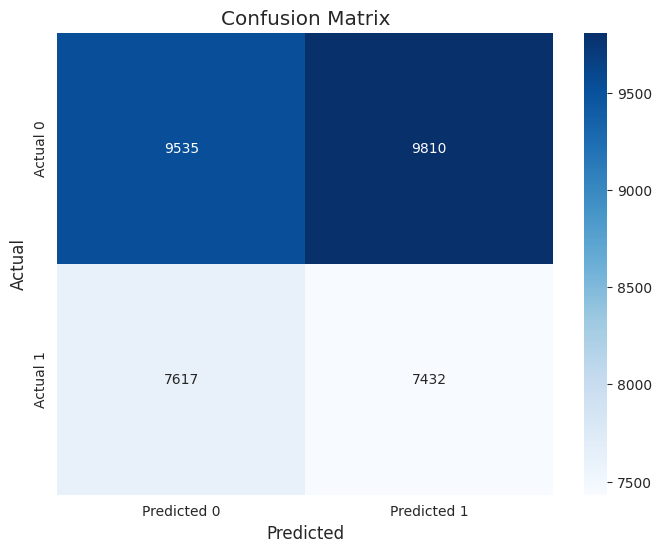

In [ ]:
cm = confusion_matrix(y_test_final, y_test_pred)
print(cm)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Predicted 0', 'Predicted 1'],
            yticklabels=['Actual 0', 'Actual 1'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

In [ ]:
try:
    val_roc_auc = roc_auc_val if roc_auc_val else np.nan
except NameError:
    val_roc_auc = np.nan

model_results = {
    'Model': 'XGBoost All TSCV',  # o cualquier nombre que quieras

    # Métricas de Test
    'Test_Accuracy': test_acc,
    'Test_Precision': test_prec,
    'Test_Recall': test_rec,
    'Test_Fscore': test_f,
    'Test_ROC_AUC': roc_auc,

    # Métricas de Validación (puedes poner N/A si no se calculan)
    'Val_Accuracy': results_df['Accuracy'].mean() if not results_df.empty else np.nan,
    'Val_Precision': results_df['Precision'].mean() if not results_df.empty else np.nan,
    'Val_Recall': results_df['Recall'].mean() if not results_df.empty else np.nan,
    'Val_Fscore': results_df['F-score'].mean() if not results_df.empty else np.nan,
    'Val_ROC_AUC': val_roc_auc
}

# Inicializar si aún no existe
try:
    summary_df
except NameError:
    summary_df = pd.DataFrame()

# Añadir los resultados del modelo
summary_df = pd.concat([summary_df, pd.DataFrame([model_results])], ignore_index=True)
summary_df

,Model,Test_Accuracy,Test_Precision,Test_Recall,Test_Fscore,Test_ROC_AUC,Val_Accuracy,Val_Precision,Val_Recall,Val_Fscore,Val_ROC_AUC
0,XGBoost Past TSCV,0.481479,0.461186,0.786957,0.581558,0.502907,0.508380,0.508754,0.835381,0.630431,0.513108
1,XGBoost Past TSCV RS/BS,0.475141,0.459302,0.825565,0.590230,0.498947,0.509915,0.509059,0.870443,0.640792,0.514077
2,SVM Past,0.465686,0.456601,0.955679,0.617957,0.506807,0.509915,0.509059,0.870443,0.640792,0.514077
3,XGBoost All TSCV,0.493313,0.431040,0.493853,0.460314,0.496700,0.542318,0.518259,0.690781,0.590467,0.576955


## XGBOOST - TOTAL TIMESERIESSPLIT + LABEL ENCODING

In [ ]:
le = LabelEncoder()
df_signal["Ticker_encoded"] = le.fit_transform(df_signal["Ticker"])

# Luego añádelo a tus features
if "Ticker_encoded" not in feature_cols:
    feature_cols.append("Ticker_encoded")

In [ ]:
# Definir fecha de corte para train y test
#train_cutoff = df_signal[df_signal['Ticker'] == 'ITX.MC']['Date'].quantile((quantile)/100)
train_cutoff = df_signal['Date'].quantile((quantile)/100)

# División basada en fecha
train_df = df_signal[df_signal['Date'] <= train_cutoff].copy()
test_df = df_signal[df_signal['Date'] > train_cutoff].copy()

# Verificar dimensiones
print(f"Train dataset size: {train_df.shape}")
print(f"Test dataset size: {test_df.shape}")

# Crear TimeSeriesSplit
tscv = TimeSeriesSplit(n_splits=n_splits)

Train dataset size: (137617, 122)
Test dataset size: (34394, 122)


In [ ]:
# Obtener X e y del conjunto de entrenamiento
X_train_final = train_df[feature_cols]
y_train_final = train_df[label_col]
X_test_final = test_df[feature_cols]
y_test_final = test_df[label_col]

In [ ]:
# Ajustar scale_pos_weight basado en el desbalance de clases
##scale_pos_weight = sum(y_train_total == 0) / sum(y_train_total == 1)
##params["scale_pos_weight"] = scale_pos_weight

In [ ]:
# Lista para almacenar resultados de validación cruzada, mejor modelo, etc.
results = []
best_f2 = -1
best_model = None

val_probs_all = []
val_labels_all = []

# Validación cruzada temporal en train_df
for i, (train_index, val_index) in enumerate(tscv.split(X_train_final)):
    X_train, X_val = X_train_final.iloc[train_index], X_train_final.iloc[val_index]
    y_train, y_val = y_train_final.iloc[train_index], y_train_final.iloc[val_index]

    #print(f"Fold {i}:")
    #print(f"  Train: index={train_index}")
    #print(f"  Test:  index={val_index}")

    # Crear y entrenar modelo
    model = XGBClassifier(**params)
    model.fit(X_train, y_train)

    # Predicciones en validación
    y_pred = model.predict(X_val)

    # Evaluar rendimiento
    acc = accuracy_score(y_val, y_pred)
    prec = precision_score(y_val, y_pred, zero_division=0)
    rec = recall_score(y_val, y_pred, zero_division=0)
    f = fbeta_score(y_val, y_pred, zero_division=0, beta=beta)

    # Guardar resultados
    results.append({
        'Train Start': X_train.index.min(),
        'Train End': X_train.index.max(),
        'Val Start': X_val.index.min(),
        'Val End': X_val.index.max(),
        'Accuracy': acc,
        'Precision': prec,
        'Recall': rec,
        'F-score': f
    })

    y_val_proba = model.predict_proba(X_val)[:, 1]

    # Guardar resultados
    val_probs_all.extend(y_val_proba)
    val_labels_all.extend(y_val)

      # Guardar el mejor modelo
    if f > best_f2:
        best_f2 = f
        XGBoost_best = deepcopy(model)

In [ ]:
# Convertir resultados a DataFrame
results_df = pd.DataFrame(results)

# Mostrar métricas promedio de validación
print("Resultados de validación cruzada (promedio):")
print(results_df.mean(numeric_only=True).round(4))

Resultados de validación cruzada (promedio):
Train Start         0.0000
Train End       86117.2000
Val Start       86118.2000
Val End        114530.4000
Accuracy            0.5454
Precision           0.5196
Recall              0.5748
F-score             0.5430
dtype: float64


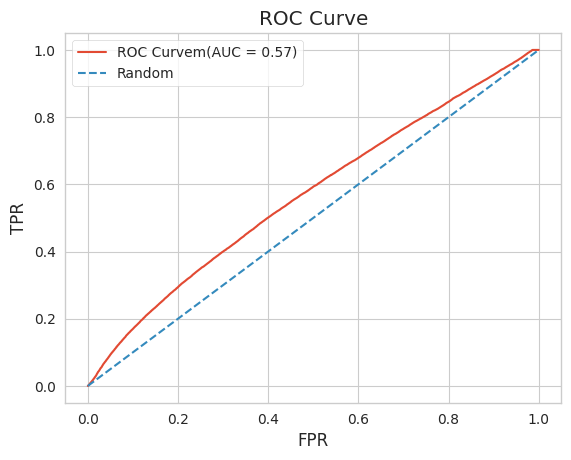

In [ ]:
fpr, tpr, _ = roc_curve(val_labels_all, val_probs_all)
roc_auc_val = auc(fpr, tpr)

plt.plot(fpr, tpr, label=f'ROC Curvem(AUC = {roc_auc_val:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', label='Random')
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.title('ROC Curve')
plt.legend()
plt.grid(True)
plt.show()

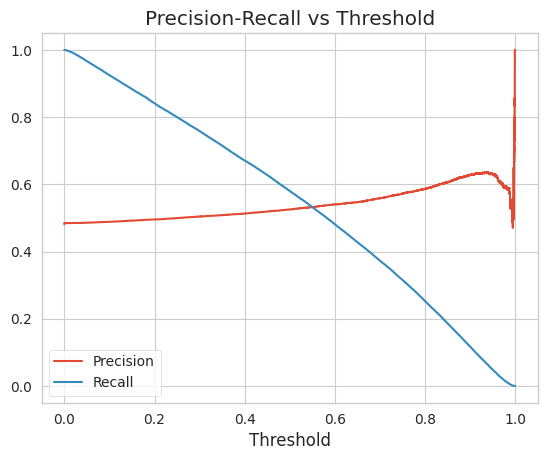

In [ ]:
precisions, recalls, thresholds = precision_recall_curve(val_labels_all, val_probs_all)

plt.plot(thresholds, precisions[:-1], label='Precision')
plt.plot(thresholds, recalls[:-1], label='Recall')
plt.xlabel('Threshold')
plt.legend()
plt.grid(True)
plt.title('Precision-Recall vs Threshold')
plt.show()

In [ ]:
# Entrenar modelo final en todo el conjunto de entrenamiento
#XGBoost_best.fit(X_train_final, y_train_final)

# Prediccion
y_test_pred = XGBoost_best.predict(X_test_final)

In [ ]:
# Métricas en test
test_acc = accuracy_score(y_test_final, y_test_pred)
test_prec = precision_score(y_test_final, y_test_pred, zero_division=0)
test_rec = recall_score(y_test_final, y_test_pred, zero_division=0)
test_f = fbeta_score(y_test_final, y_test_pred, zero_division=0, beta=beta)

print(f"Test Accuracy: {test_acc:.4f}")
print(f"Test Precision: {test_prec:.4f}")
print(f"Test Recall: {test_rec:.4f}")
print(f"Test F-score: {test_f:.4f}")

Test Accuracy: 0.4908
Test Precision: 0.4033
Test Recall: 0.3418
Test F-score: 0.3700


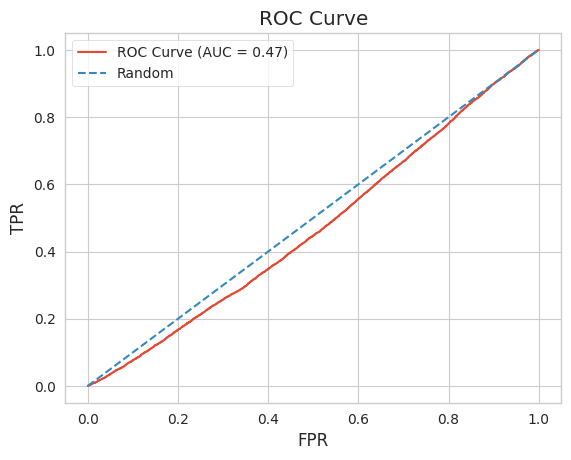

In [ ]:
y_test_prob = XGBoost_best.predict_proba(X_test_final)[:, 1]

fpr, tpr, _ = roc_curve(y_test_final, y_test_prob)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', label='Random')
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.title('ROC Curve')
plt.legend()
plt.grid(True)
plt.show()

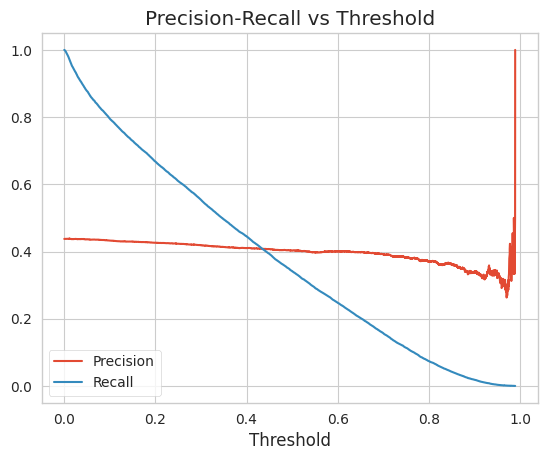

In [ ]:
precisions, recalls, thresholds = precision_recall_curve(y_test_final, y_test_prob)

plt.plot(thresholds, precisions[:-1], label='Precision')
plt.plot(thresholds, recalls[:-1], label='Recall')
plt.xlabel('Threshold')
plt.legend()
plt.grid(True)
plt.title('Precision-Recall vs Threshold')
plt.show()

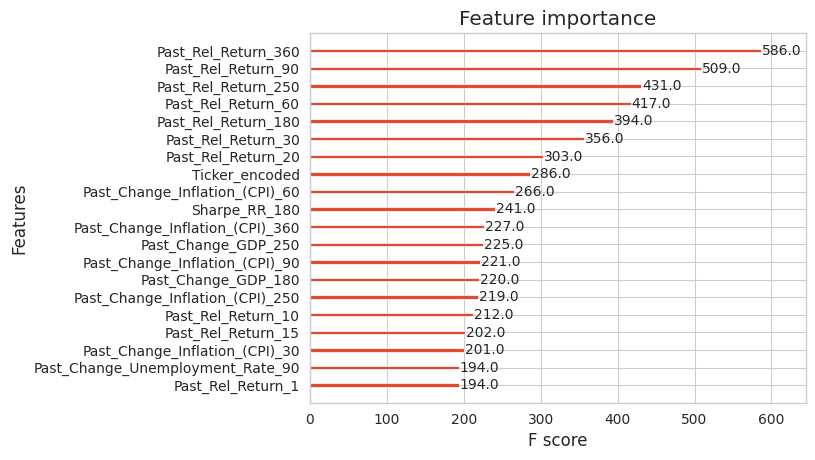

In [ ]:
plot_importance(XGBoost_best, max_num_features=20)
plt.show()

In [ ]:
XGBoost_best.get_booster().get_score(importance_type='gain')

{'Past_Rel_Return_1': 3.453235626220703,
 'Past_Rel_Return_5': 5.438537120819092,
 'Past_Rel_Return_10': 7.53835391998291,
 'Past_Rel_Return_15': 5.604920864105225,
 'Past_Rel_Return_20': 7.840190887451172,
 'Past_Rel_Return_30': 9.620330810546875,
 'Past_Rel_Return_60': 9.702643394470215,
 'Past_Rel_Return_90': 12.091322898864746,
 'Past_Rel_Return_180': 10.683366775512695,
 'Past_Rel_Return_250': 12.034531593322754,
 'Past_Rel_Return_360': 14.491340637207031,
 'Past_Change_GDP_1': 6.680480480194092,
 'Past_Change_GDP_5': 12.564690589904785,
 'Past_Change_GDP_10': 16.448951721191406,
 'Past_Change_GDP_15': 16.47577667236328,
 'Past_Change_GDP_20': 12.512072563171387,
 'Past_Change_GDP_30': 12.898740768432617,
 'Past_Change_GDP_60': 15.901495933532715,
 'Past_Change_GDP_90': 11.410833358764648,
 'Past_Change_GDP_180': 16.27655792236328,
 'Past_Change_GDP_250': 14.131752014160156,
 'Past_Change_GDP_360': 15.411972999572754,
 'Past_Change_Unemployment_Rate_1': 9.470124244689941,
 'Past_C

[[11735  7610]
 [ 9905  5144]]


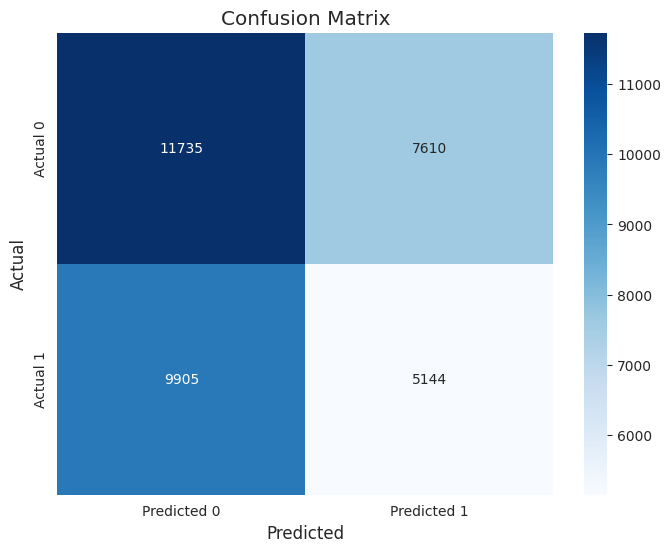

In [ ]:
cm = confusion_matrix(y_test_final, y_test_pred)
print(cm)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Predicted 0', 'Predicted 1'],
            yticklabels=['Actual 0', 'Actual 1'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

In [ ]:
try:
    val_roc_auc = roc_auc_val if roc_auc_val else np.nan
except NameError:
    val_roc_auc = np.nan

model_results = {
    'Model': 'XGBoost All TSCV LE',  # o cualquier nombre que quieras

    # Métricas de Test
    'Test_Accuracy': test_acc,
    'Test_Precision': test_prec,
    'Test_Recall': test_rec,
    'Test_Fscore': test_f,
    'Test_ROC_AUC': roc_auc,

    # Métricas de Validación (puedes poner N/A si no se calculan)
    'Val_Accuracy': results_df['Accuracy'].mean() if not results_df.empty else np.nan,
    'Val_Precision': results_df['Precision'].mean() if not results_df.empty else np.nan,
    'Val_Recall': results_df['Recall'].mean() if not results_df.empty else np.nan,
    'Val_Fscore': results_df['F-score'].mean() if not results_df.empty else np.nan,
    'Val_ROC_AUC': val_roc_auc
}

# Inicializar si aún no existe
try:
    summary_df
except NameError:
    summary_df = pd.DataFrame()

# Añadir los resultados del modelo
summary_df = pd.concat([summary_df, pd.DataFrame([model_results])], ignore_index=True)
summary_df

,Model,Test_Accuracy,Test_Precision,Test_Recall,Test_Fscore,Test_ROC_AUC,Val_Accuracy,Val_Precision,Val_Recall,Val_Fscore,Val_ROC_AUC
0,XGBoost Past TSCV,0.481479,0.461186,0.786957,0.581558,0.502907,0.508380,0.508754,0.835381,0.630431,0.513108
1,XGBoost Past TSCV RS/BS,0.475141,0.459302,0.825565,0.590230,0.498947,0.509915,0.509059,0.870443,0.640792,0.514077
2,SVM Past,0.465686,0.456601,0.955679,0.617957,0.506807,0.509915,0.509059,0.870443,0.640792,0.514077
3,XGBoost All TSCV,0.493313,0.431040,0.493853,0.460314,0.496700,0.542318,0.518259,0.690781,0.590467,0.576955
4,XGBoost All TSCV LE,0.490754,0.403324,0.341817,0.370032,0.469534,0.545378,0.519616,0.574766,0.542950,0.568624


## XGBOOST - TOTAL TIMESERIESSPLIT + TARGET ENCODING

In [ ]:
# Definir fecha de corte para train y test
#train_cutoff = df_signal[df_signal['Ticker'] == 'ITX.MC']['Date'].quantile((quantile)/100)
train_cutoff = df_signal['Date'].quantile((quantile)/100)

# División basada en fecha
train_df = df_signal[df_signal['Date'] <= train_cutoff].copy()
test_df = df_signal[df_signal['Date'] > train_cutoff].copy()

from category_encoders import TargetEncoder

# Create a TargetEncoder object
encoder = TargetEncoder(cols=['Ticker'])
if 'Ticker' not in feature_cols:
  feature_cols_te = feature_cols + ['Ticker']

# Fit and transform the training data
train_df_encoded = encoder.fit_transform(train_df, train_df[label_col])
test_df_encoded = encoder.transform(test_df, test_df[label_col])

# Verificar dimensiones
print(f"Train dataset size: {train_df_encoded.shape}")
print(f"Test dataset size: {test_df_encoded.shape}")

# Crear TimeSeriesSplit
tscv = TimeSeriesSplit(n_splits=n_splits)

Train dataset size: (137617, 122)
Test dataset size: (34394, 122)


In [ ]:
# Obtener X e y del conjunto de entrenamiento
X_train_final = train_df_encoded[feature_cols_te]
y_train_final = train_df_encoded[label_col]
X_test_final = test_df_encoded[feature_cols_te]
y_test_final = test_df_encoded[label_col]

In [ ]:
# Ajustar scale_pos_weight basado en el desbalance de clases
##scale_pos_weight = sum(y_train_total == 0) / sum(y_train_total == 1)
##params["scale_pos_weight"] = scale_pos_weight

In [ ]:
# Lista para almacenar resultados de validación cruzada, mejor modelo, etc.
results = []
best_f2 = -1
best_model = None

val_probs_all = []
val_labels_all = []

# Validación cruzada temporal en train_df
for i, (train_index, val_index) in enumerate(tscv.split(X_train_final)):
    X_train, X_val = X_train_final.iloc[train_index], X_train_final.iloc[val_index]
    y_train, y_val = y_train_final.iloc[train_index], y_train_final.iloc[val_index]

    #print(f"Fold {i}:")
    #print(f"  Train: index={train_index}")
    #print(f"  Test:  index={val_index}")

    # Crear y entrenar modelo
    model = XGBClassifier(**params)
    model.fit(X_train, y_train)

    # Predicciones en validación
    y_pred = model.predict(X_val)

    # Evaluar rendimiento
    acc = accuracy_score(y_val, y_pred)
    prec = precision_score(y_val, y_pred, zero_division=0)
    rec = recall_score(y_val, y_pred, zero_division=0)
    f = fbeta_score(y_val, y_pred, zero_division=0, beta=beta)

    # Guardar resultados
    results.append({
        'Train Start': X_train.index.min(),
        'Train End': X_train.index.max(),
        'Val Start': X_val.index.min(),
        'Val End': X_val.index.max(),
        'Accuracy': acc,
        'Precision': prec,
        'Recall': rec,
        'F-score': f
    })

    y_val_proba = model.predict_proba(X_val)[:, 1]

    # Guardar resultados
    val_probs_all.extend(y_val_proba)
    val_labels_all.extend(y_val)

      # Guardar el mejor modelo
    if f > best_f2:
        best_f2 = f
        XGBoost_best = deepcopy(model)

In [ ]:
# Convertir resultados a DataFrame
results_df = pd.DataFrame(results)

# Mostrar métricas promedio de validación
print("Resultados de validación cruzada (promedio):")
print(results_df.mean(numeric_only=True).round(4))

Resultados de validación cruzada (promedio):
Train Start         0.0000
Train End       86117.2000
Val Start       86118.2000
Val End        114530.4000
Accuracy            0.5559
Precision           0.5313
Recall              0.5989
F-score             0.5619
dtype: float64


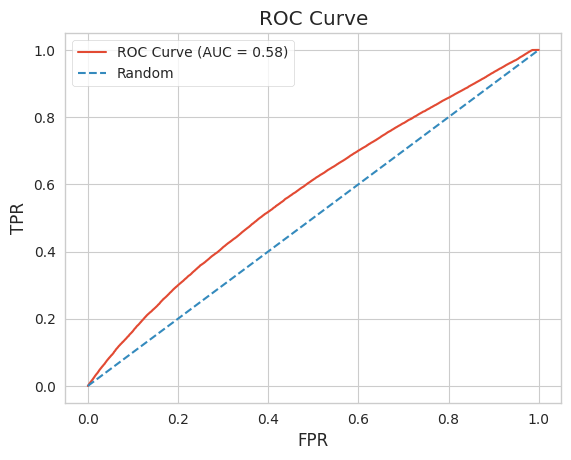

In [ ]:
fpr, tpr, _ = roc_curve(val_labels_all, val_probs_all)
roc_auc_val = auc(fpr, tpr)

plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {roc_auc_val:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', label='Random')
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.title('ROC Curve')
plt.legend()
plt.grid(True)
plt.show()

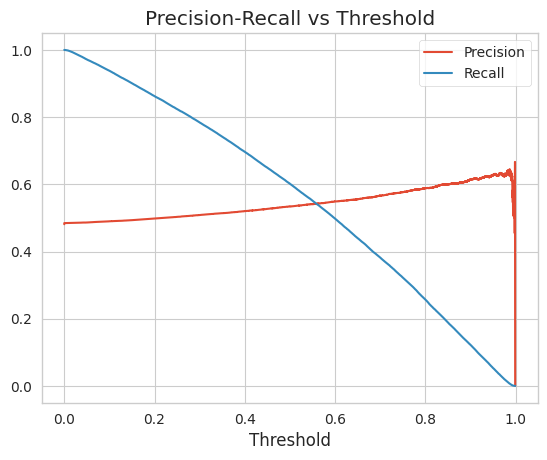

In [ ]:
precisions, recalls, thresholds = precision_recall_curve(val_labels_all, val_probs_all)

plt.plot(thresholds, precisions[:-1], label='Precision')
plt.plot(thresholds, recalls[:-1], label='Recall')
plt.xlabel('Threshold')
plt.legend()
plt.grid(True)
plt.title('Precision-Recall vs Threshold')
plt.show()

In [ ]:
# Entrenar modelo final en todo el conjunto de entrenamiento
#XGBoost_best.fit(X_train_final, y_train_final)

# Prediccion
y_test_pred = XGBoost_best.predict(X_test_final)

In [ ]:
# Métricas en test
test_acc = accuracy_score(y_test_final, y_test_pred)
test_prec = precision_score(y_test_final, y_test_pred, zero_division=0)
test_rec = recall_score(y_test_final, y_test_pred, zero_division=0)
test_f = fbeta_score(y_test_final, y_test_pred, zero_division=0, beta=beta)

print(f"Test Accuracy: {test_acc:.4f}")
print(f"Test Precision: {test_prec:.4f}")
print(f"Test Recall: {test_rec:.4f}")
print(f"Test F-score: {test_f:.4f}")

Test Accuracy: 0.4896
Test Precision: 0.4218
Test Recall: 0.4485
Test F-score: 0.4347


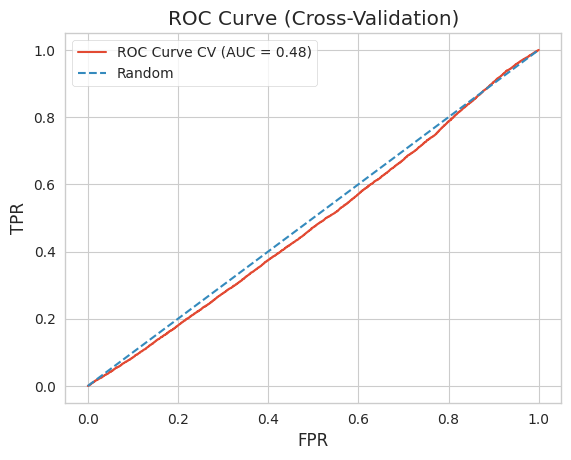

In [ ]:
y_test_prob = XGBoost_best.predict_proba(X_test_final)[:, 1]

fpr, tpr, _ = roc_curve(y_test_final, y_test_prob)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, label=f'ROC Curve CV (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', label='Random')
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.title('ROC Curve (Cross-Validation)')
plt.legend()
plt.grid(True)
plt.show()

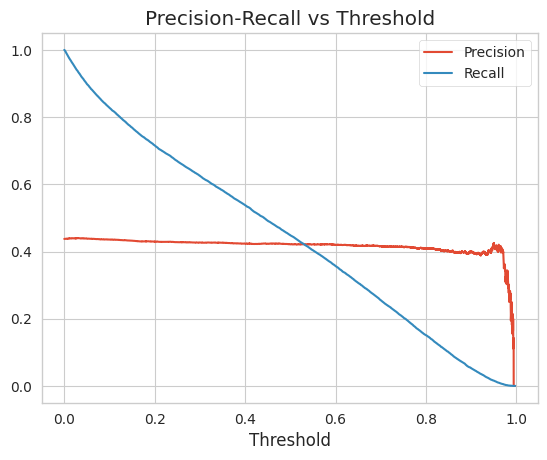

In [ ]:
precisions, recalls, thresholds = precision_recall_curve(y_test_final, y_test_prob)

plt.plot(thresholds, precisions[:-1], label='Precision')
plt.plot(thresholds, recalls[:-1], label='Recall')
plt.xlabel('Threshold')
plt.legend()
plt.grid(True)
plt.title('Precision-Recall vs Threshold')
plt.show()

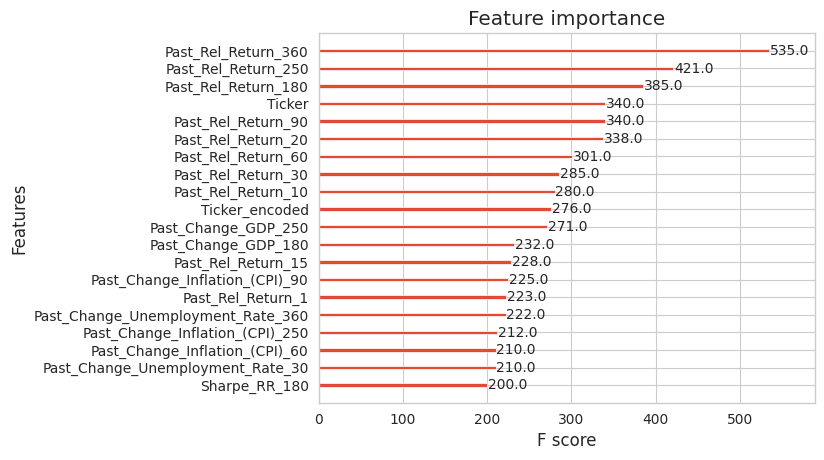

In [ ]:
plot_importance(XGBoost_best, max_num_features=20)
plt.show()

In [ ]:
XGBoost_best.get_booster().get_score(importance_type='gain')

{'Past_Rel_Return_1': 3.261245012283325,
 'Past_Rel_Return_5': 4.621506690979004,
 'Past_Rel_Return_10': 6.558058738708496,
 'Past_Rel_Return_15': 6.2036824226379395,
 'Past_Rel_Return_20': 8.157733917236328,
 'Past_Rel_Return_30': 9.349197387695312,
 'Past_Rel_Return_60': 9.541492462158203,
 'Past_Rel_Return_90': 11.065634727478027,
 'Past_Rel_Return_180': 12.139447212219238,
 'Past_Rel_Return_250': 14.087235450744629,
 'Past_Rel_Return_360': 12.1432466506958,
 'Past_Change_GDP_1': 9.574846267700195,
 'Past_Change_GDP_5': 17.768413543701172,
 'Past_Change_GDP_10': 12.416767120361328,
 'Past_Change_GDP_15': 18.46445083618164,
 'Past_Change_GDP_20': 15.58194637298584,
 'Past_Change_GDP_30': 13.362771034240723,
 'Past_Change_GDP_60': 10.37923526763916,
 'Past_Change_GDP_90': 14.285002708435059,
 'Past_Change_GDP_180': 16.45549774169922,
 'Past_Change_GDP_250': 14.454258918762207,
 'Past_Change_GDP_360': 16.198801040649414,
 'Past_Change_Unemployment_Rate_1': 9.81556510925293,
 'Past_Chan

[[10092  9253]
 [ 8300  6749]]


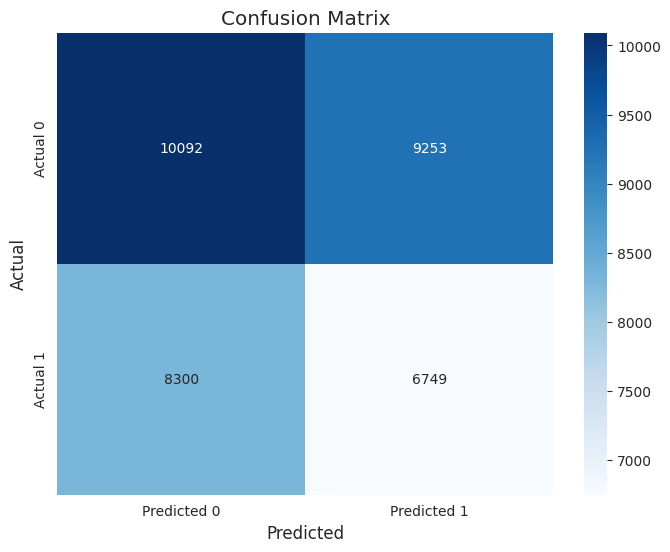

In [ ]:
cm = confusion_matrix(y_test_final, y_test_pred)
print(cm)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Predicted 0', 'Predicted 1'],
            yticklabels=['Actual 0', 'Actual 1'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

In [ ]:
try:
    val_roc_auc = roc_auc_val if roc_auc_val else np.nan
except NameError:
    val_roc_auc = np.nan

model_results = {
    'Model': 'XGBoost All TSCV TE',  # o cualquier nombre que quieras

    # Métricas de Test
    'Test_Accuracy': test_acc,
    'Test_Precision': test_prec,
    'Test_Recall': test_rec,
    'Test_Fscore': test_f,
    'Test_ROC_AUC': roc_auc,

    # Métricas de Validación (puedes poner N/A si no se calculan)
    'Val_Accuracy': results_df['Accuracy'].mean() if not results_df.empty else np.nan,
    'Val_Precision': results_df['Precision'].mean() if not results_df.empty else np.nan,
    'Val_Recall': results_df['Recall'].mean() if not results_df.empty else np.nan,
    'Val_Fscore': results_df['F-score'].mean() if not results_df.empty else np.nan,
    'Val_ROC_AUC': val_roc_auc
}

# Inicializar si aún no existe
try:
    summary_df
except NameError:
    summary_df = pd.DataFrame()

# Añadir los resultados del modelo
summary_df = pd.concat([summary_df, pd.DataFrame([model_results])], ignore_index=True)
summary_df

,Model,Test_Accuracy,Test_Precision,Test_Recall,Test_Fscore,Test_ROC_AUC,Val_Accuracy,Val_Precision,Val_Recall,Val_Fscore,Val_ROC_AUC
0,XGBoost Past TSCV,0.481479,0.461186,0.786957,0.581558,0.502907,0.508380,0.508754,0.835381,0.630431,0.513108
1,XGBoost Past TSCV RS/BS,0.475141,0.459302,0.825565,0.590230,0.498947,0.509915,0.509059,0.870443,0.640792,0.514077
2,SVM Past,0.465686,0.456601,0.955679,0.617957,0.506807,0.509915,0.509059,0.870443,0.640792,0.514077
3,XGBoost All TSCV,0.493313,0.431040,0.493853,0.460314,0.496700,0.542318,0.518259,0.690781,0.590467,0.576955
4,XGBoost All TSCV LE,0.490754,0.403324,0.341817,0.370032,0.469534,0.545378,0.519616,0.574766,0.542950,0.568624
5,XGBoost All TSCV TE,0.489649,0.421760,0.448468,0.434704,0.481934,0.555860,0.531294,0.598932,0.561861,0.579387


In [ ]:
xgboost_best

NameError: name 'xgboost_best' is not defined

## XGBOOST - TOTAL TIMESERIESSPLIT + TARGET ENCODING + RS / BS

In [ ]:
# Espacio de búsqueda amplio para Random Search
param_dist = {
    "eta": uniform(0.01, 0.3),  # Tasa de aprendizaje
    "max_depth": randint(3, 10),  # Profundidad
    "subsample": uniform(0.5, 0.5),
    "colsample_bytree": uniform(0.5, 0.5),
    "scale_pos_weight": uniform(0.5, 2.0),  # Ajuste de clases desbalanceadas
    "n_estimators": randint(50, 300),  # Número de árboles
}

In [ ]:
def custom_fbeta(y_true, y_pred):
    return fbeta_score(y_true, y_pred, beta=1, zero_division=0)

def optimize_xgboost(X, y, param_dist, n_splits=5, beta=1, seed=34):
    tscv = TimeSeriesSplit(n_splits=n_splits)
    f2_scorer = make_scorer(fbeta_score, beta=beta, zero_division=0)

    xgb_model = XGBClassifier(objective="binary:logistic", eval_metric="logloss", random_state=seed)

    random_search = RandomizedSearchCV(
        estimator=xgb_model,
        param_distributions=param_dist,
        n_iter=3,
        cv=tscv,
        scoring='f1',
        verbose=2,
        random_state=seed,
        n_jobs=-1
    )

    random_search.fit(X, y)
    best_params_random = random_search.best_params_
    print("\n Random Search:", best_params_random)
    print("Random best score:", random_search.best_score_)

    bayesian_search = BayesSearchCV(
        estimator=XGBClassifier(objective="binary:logistic", eval_metric="logloss", random_state=seed),
        search_spaces={
            "eta": (best_params_random["eta"] * 0.8, best_params_random["eta"] * 1.2),
            "max_depth": (max(3, best_params_random["max_depth"] - 2), min(10, best_params_random["max_depth"] + 2)),
            "subsample": (max(0.5, best_params_random["subsample"] - 0.2), min(1.0, best_params_random["subsample"] + 0.2)),
            "colsample_bytree": (max(0.5, best_params_random["colsample_bytree"] - 0.2), min(1.0, best_params_random["colsample_bytree"] + 0.2)),
            "scale_pos_weight": (max(0.5, best_params_random["scale_pos_weight"] - 0.5), best_params_random["scale_pos_weight"] + 0.5),
            "n_estimators": (max(50, best_params_random["n_estimators"] - 50), min(300, best_params_random["n_estimators"] + 50))
        },
        n_iter=3,
        cv=tscv,
        scoring='f1',
        verbose=2,
        random_state=seed,
        n_jobs=-1
    )

    bayesian_search.fit(X, y)
    best_params_bayes = dict(bayesian_search.best_params_)
    print("Mejores Bayesian Search:", best_params_bayes)
    print("Bayes best score:", bayesian_search.best_score_)

    return best_params_random, best_params_bayes

In [ ]:
# Definir fecha de corte para train y test
#train_cutoff = df_signal[df_signal['Ticker'] == 'ITX.MC']['Date'].quantile((quantile)/100)
train_cutoff = df_signal['Date'].quantile((quantile)/100)

# División basada en fecha
train_df = df_signal[df_signal['Date'] <= train_cutoff].copy()
test_df = df_signal[df_signal['Date'] > train_cutoff].copy()

from category_encoders import TargetEncoder

# Create a TargetEncoder object
encoder = TargetEncoder(cols=['Ticker'])
if 'Ticker' not in feature_cols:
  feature_cols_te = feature_cols + ['Ticker']

# Fit and transform the training data
train_df_encoded = encoder.fit_transform(train_df, train_df[label_col])
test_df_encoded = encoder.transform(test_df, test_df[label_col])

# Verificar dimensiones
print(f"Train dataset size: {train_df_encoded.shape}")
print(f"Test dataset size: {test_df_encoded.shape}")

# Crear TimeSeriesSplit
tscv = TimeSeriesSplit(n_splits=n_splits)

Train dataset size: (137617, 122)
Test dataset size: (34394, 122)


In [ ]:
# Obtener X e y del conjunto de entrenamiento
X_train_final = train_df_encoded[feature_cols_te]
y_train_final = train_df_encoded[label_col]
X_test_final = test_df_encoded[feature_cols_te]
y_test_final = test_df_encoded[label_col]

In [ ]:
# Ajustar scale_pos_weight basado en el desbalance de clases
##scale_pos_weight = sum(y_train_total == 0) / sum(y_train_total == 1)
##params["scale_pos_weight"] = scale_pos_weight

In [ ]:
# Lista para almacenar resultados de validación cruzada, mejor modelo, etc.
results = []
best_f2 = -1
best_model = None

val_probs_all = []
val_labels_all = []

# Validación cruzada temporal en train_df
for i, (train_index, val_index) in enumerate(tscv.split(X_train_final)):
    X_train, X_val = X_train_final.iloc[train_index], X_train_final.iloc[val_index]
    y_train, y_val = y_train_final.iloc[train_index], y_train_final.iloc[val_index]

    #print(f"Fold {i}:")
    #print(f"  Train: index={train_index}")
    #print(f"  Test:  index={val_index}")

    best_params_random, best_params_bayes = optimize_xgboost(X_train, y_train,
                                                            param_dist=param_dist, beta=beta, seed=seed)

    # Crear y entrenar modelo
    model = XGBClassifier(**best_params_bayes)
    model.fit(X_train, y_train)

    # Predicciones en validación
    y_pred = model.predict(X_val)

    # Evaluar rendimiento
    acc = accuracy_score(y_val, y_pred)
    prec = precision_score(y_val, y_pred, zero_division=0)
    rec = recall_score(y_val, y_pred, zero_division=0)
    f = fbeta_score(y_val, y_pred, zero_division=0, beta=beta)

    # Guardar resultados
    results.append({
        'Train Start': X_train.index.min(),
        'Train End': X_train.index.max(),
        'Val Start': X_val.index.min(),
        'Val End': X_val.index.max(),
        'Accuracy': acc,
        'Precision': prec,
        'Recall': rec,
        'F-score': f
    })

    y_val_proba = model.predict_proba(X_val)[:, 1]

    # Guardar resultados
    val_probs_all.extend(y_val_proba)
    val_labels_all.extend(y_val)

      # Guardar el mejor modelo
    if f > best_f2:
        best_f2 = f
        XGBoost_best = deepcopy(model)

Fitting 5 folds for each of 3 candidates, totalling 15 fits

 Random Search: {'colsample_bytree': np.float64(0.5192808404407048), 'eta': np.float64(0.2440301381574025), 'max_depth': 9, 'n_estimators': 135, 'scale_pos_weight': np.float64(1.7657853729689545), 'subsample': np.float64(0.5069454241601093)}
Random best score: 0.5325019877956245
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Mejores Bayesian Search: {'colsample_bytree': 0.5308831183706987, 'eta': 0.29046305506335596, 'max_depth': 8, 'n_estimators': 111, 'scale_pos_weight': 2.2034063104353425, 'subsample': 0.6060298434440957}
Bayes best score: 0.5310613019592825
Fitting 5 folds for each of 3 candidates, totalling 15 fits

 Random Search: {'colsample_bytree': np.float64(0.5067103048697013), 'eta': np.float64(0.20454183544695714), 'max_depth': 9, 'n_estimators': 55, 'scale_pos_weight': np.float64(1.71

In [ ]:
# Convertir resultados a DataFrame
results_df = pd.DataFrame(results)

# Mostrar métricas promedio de validación
print("Resultados de validación cruzada (promedio):")
print(results_df.mean(numeric_only=True))

Resultados de validación cruzada (promedio):
Train Start         0.000000
Train End       86117.200000
Val Start       86118.200000
Val End        114530.400000
Accuracy            0.555528
Precision           0.530566
Recall              0.610921
F-score             0.565395
dtype: float64


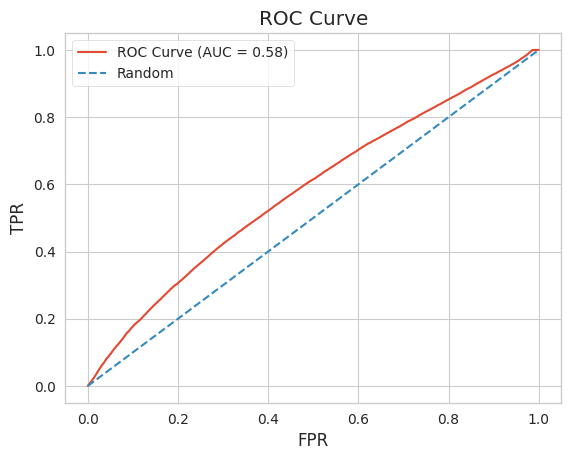

In [ ]:
fpr, tpr, _ = roc_curve(val_labels_all, val_probs_all)
roc_auc_val = auc(fpr, tpr)

plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {roc_auc_val:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', label='Random')
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.title('ROC Curve')
plt.legend()
plt.grid(True)
plt.show()

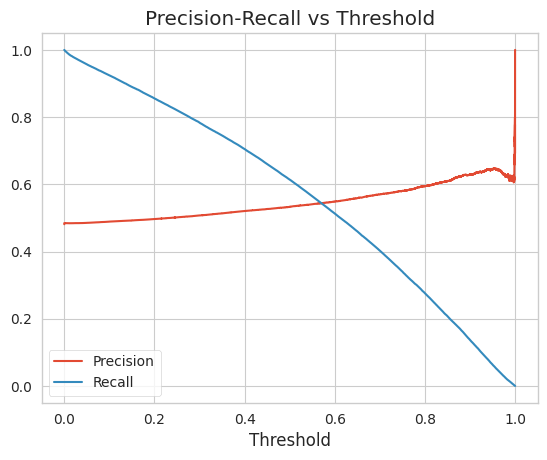

In [ ]:
precisions, recalls, thresholds = precision_recall_curve(val_labels_all, val_probs_all)

plt.plot(thresholds, precisions[:-1], label='Precision')
plt.plot(thresholds, recalls[:-1], label='Recall')
plt.xlabel('Threshold')
plt.legend()
plt.grid(True)
plt.title('Precision-Recall vs Threshold')
plt.show()

In [ ]:
# Entrenar modelo final en todo el conjunto de entrenamiento
#XGBoost_best.fit(X_train_final, y_train_final)

# Prediccion
y_test_pred = XGBoost_best.predict(X_test_final)

In [ ]:
# Métricas en test
test_acc = accuracy_score(y_test_final, y_test_pred)
test_prec = precision_score(y_test_final, y_test_pred, zero_division=0)
test_rec = recall_score(y_test_final, y_test_pred, zero_division=0)
test_f = fbeta_score(y_test_final, y_test_pred, zero_division=0, beta=beta)

print(f"Test Accuracy: {test_acc:.4f}")
print(f"Test Precision: {test_prec:.4f}")
print(f"Test Recall: {test_rec:.4f}")
print(f"Test F-score: {test_f:.4f}")

Test Accuracy: 0.4737
Test Precision: 0.4058
Test Recall: 0.4372
Test F-score: 0.4209


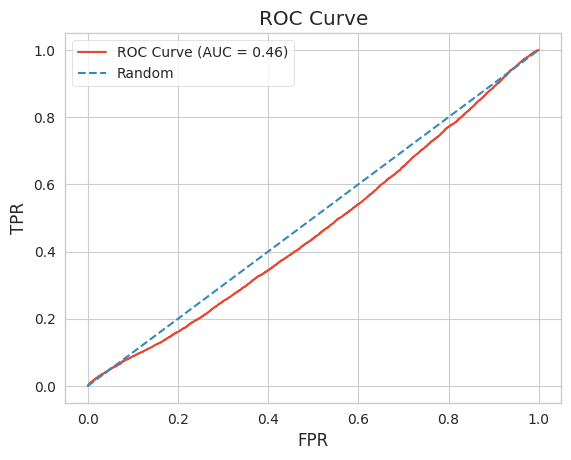

In [ ]:
y_test_prob = XGBoost_best.predict_proba(X_test_final)[:, 1]

fpr, tpr, _ = roc_curve(y_test_final, y_test_prob)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', label='Random')
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.title('ROC Curve')
plt.legend()
plt.grid(True)
plt.show()

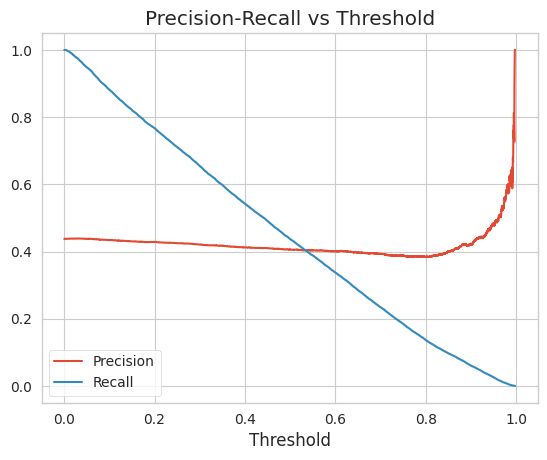

In [ ]:
precisions, recalls, thresholds = precision_recall_curve(y_test_final, y_test_prob)

plt.plot(thresholds, precisions[:-1], label='Precision')
plt.plot(thresholds, recalls[:-1], label='Recall')
plt.xlabel('Threshold')
plt.legend()
plt.grid(True)
plt.title('Precision-Recall vs Threshold')
plt.show()

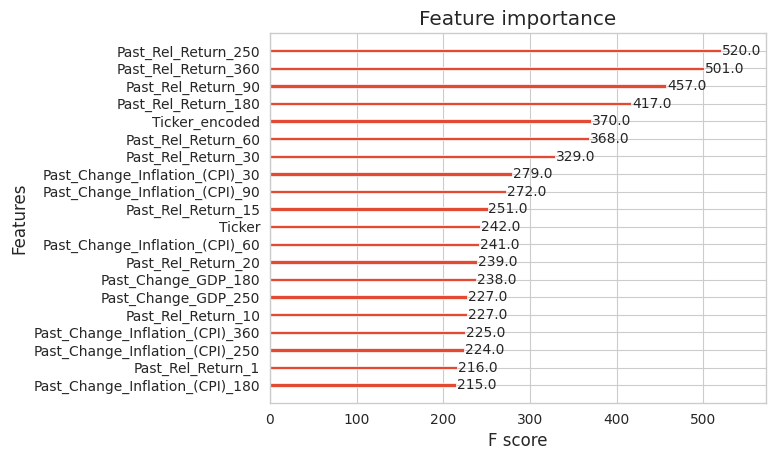

In [ ]:
plot_importance(XGBoost_best, max_num_features=20)
plt.show()

In [ ]:
XGBoost_best.get_booster().get_score(importance_type='gain')

{'Past_Rel_Return_1': 3.5305752754211426,
 'Past_Rel_Return_5': 5.097151756286621,
 'Past_Rel_Return_10': 6.4701690673828125,
 'Past_Rel_Return_15': 6.870913505554199,
 'Past_Rel_Return_20': 8.061981201171875,
 'Past_Rel_Return_30': 10.345096588134766,
 'Past_Rel_Return_60': 9.865119934082031,
 'Past_Rel_Return_90': 11.868767738342285,
 'Past_Rel_Return_180': 11.491025924682617,
 'Past_Rel_Return_250': 14.643996238708496,
 'Past_Rel_Return_360': 12.7522611618042,
 'Past_Change_GDP_1': 11.031867980957031,
 'Past_Change_GDP_5': 13.012752532958984,
 'Past_Change_GDP_10': 13.908655166625977,
 'Past_Change_GDP_15': 19.914358139038086,
 'Past_Change_GDP_20': 11.801486015319824,
 'Past_Change_GDP_30': 15.877132415771484,
 'Past_Change_GDP_60': 12.11899471282959,
 'Past_Change_GDP_90': 14.846415519714355,
 'Past_Change_GDP_180': 19.865062713623047,
 'Past_Change_GDP_250': 12.314008712768555,
 'Past_Change_GDP_360': 20.930662155151367,
 'Past_Change_Unemployment_Rate_1': 10.20249080657959,
 'Pa

[[9711 9634]
 [8469 6580]]


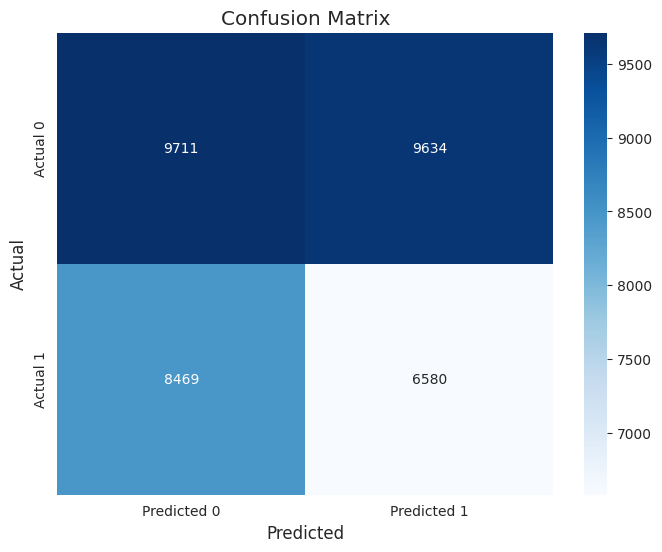

In [ ]:
cm = confusion_matrix(y_test_final, y_test_pred)
print(cm)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Predicted 0', 'Predicted 1'],
            yticklabels=['Actual 0', 'Actual 1'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

In [ ]:
try:
    val_roc_auc = roc_auc_val if roc_auc_val else np.nan
except NameError:
    val_roc_auc = np.nan

model_results = {
    'Model': 'XGBoost All TSCV TE RS/BS',

    # Métricas de Test
    'Test_Accuracy': test_acc,
    'Test_Precision': test_prec,
    'Test_Recall': test_rec,
    'Test_Fscore': test_f,
    'Test_ROC_AUC': roc_auc,

    # Métricas de Validación (puedes poner N/A si no se calculan)
    'Val_Accuracy': results_df['Accuracy'].mean() if not results_df.empty else np.nan,
    'Val_Precision': results_df['Precision'].mean() if not results_df.empty else np.nan,
    'Val_Recall': results_df['Recall'].mean() if not results_df.empty else np.nan,
    'Val_Fscore': results_df['F-score'].mean() if not results_df.empty else np.nan,
    'Val_ROC_AUC': val_roc_auc
}

# Inicializar si aún no existe
try:
    summary_df
except NameError:
    summary_df = pd.DataFrame()

# Añadir los resultados del modelo
summary_df = pd.concat([summary_df, pd.DataFrame([model_results])], ignore_index=True)

In [ ]:
summary_df

,Model,Test_Accuracy,Test_Precision,Test_Recall,Test_Fscore,Test_ROC_AUC,Val_Accuracy,Val_Precision,Val_Recall,Val_Fscore,Val_ROC_AUC
0,XGBoost Past TSCV,0.481479,0.461186,0.786957,0.581558,0.502907,0.508380,0.508754,0.835381,0.630431,0.513108
1,XGBoost Past TSCV RS/BS,0.475141,0.459302,0.825565,0.590230,0.498947,0.509915,0.509059,0.870443,0.640792,0.514077
2,SVM Past,0.465686,0.456601,0.955679,0.617957,0.506807,0.509915,0.509059,0.870443,0.640792,0.514077
3,XGBoost All TSCV,0.493313,0.431040,0.493853,0.460314,0.496700,0.542318,0.518259,0.690781,0.590467,0.576955
4,XGBoost All TSCV LE,0.490754,0.403324,0.341817,0.370032,0.469534,0.545378,0.519616,0.574766,0.542950,0.568624
5,XGBoost All TSCV TE,0.489649,0.421760,0.448468,0.434704,0.481934,0.555860,0.531294,0.598932,0.561861,0.579387
6,XGBoost All TSCV TE RS/BS,0.473658,0.405822,0.437238,0.420945,0.464339,0.555528,0.530566,0.610921,0.565395,0.581564


## XGBOOST - PER TICKER + TSCV

In [ ]:
def evaluate_model(model, X_test, y_test, beta=1):
    y_pred = model.predict(X_test)
    test_acc = accuracy_score(y_test, y_pred)
    test_prec = precision_score(y_test, y_pred, zero_division=0)
    test_rec = recall_score(y_test, y_pred, zero_division=0)
    test_f = fbeta_score(y_test, y_pred, zero_division=0, beta=beta)
    #print(f"Test Accuracy: {test_acc:.4f}")
    #print(f"Test Precision: {test_prec:.4f}")
    #print(f"Test Recall: {test_rec:.4f}")
    #print(f"Test F-score: {test_f:.4f}")
    return test_acc, test_prec, test_rec, test_f

def plot_metrics(model, X_test, y_test):
    y_test_prob = model.predict_proba(X_test)[:, 1]
    fpr, tpr, _ = roc_curve(y_test, y_test_prob)
    roc_auc = auc(fpr, tpr)
    plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], linestyle='--', label='Random')
    plt.show()

    precisions, recalls, thresholds = precision_recall_curve(y_test, y_test_prob)
    plt.plot(thresholds, precisions[:-1], label='Precision')
    plt.plot(thresholds, recalls[:-1], label='Recall')
    plt.show()

    plot_importance(model, max_num_features=20)
    plt.show()

    cm = confusion_matrix(y_test, model.predict(X_test))
    sns.heatmap(cm, annot=True, fmt='d')
    plt.show()

    plt.hist(y_test_prob, bins=100)
    plt.show()

In [ ]:
# Dict para guardar resultados
results_per_ticker = {}

for ticker in df_signal['Ticker'].unique():
    print(f"\nProcessing ticker: {ticker}")
    ticker_df = df_signal[df_signal['Ticker'] == ticker].copy()

    train_cutoff = ticker_df['Date'].quantile(quantile / 100)
    train_df = ticker_df[ticker_df['Date'] <= train_cutoff]
    test_df = ticker_df[ticker_df['Date'] > train_cutoff]

    print(f"Train dataset size: {train_df.shape}")
    print(f"Test dataset size: {test_df.shape}")

    X_train_final = train_df[feature_cols]
    y_train_final = train_df[label_col]
    X_test_final = test_df[feature_cols]
    y_test_final = test_df[label_col]

    # Validar si hay más de una clase en el conjunto de entrenamiento
    if y_train_final.nunique() < 2:
        print(f"Skipping {ticker}: only one class present in training data.")
        continue

    tscv = TimeSeriesSplit(n_splits=n_splits)
    results = []
    best_f2 = -1
    best_model = None

    for train_idx, val_idx in tscv.split(X_train_final):
        X_train, X_val = X_train_final.iloc[train_idx], X_train_final.iloc[val_idx]
        y_train, y_val = y_train_final.iloc[train_idx], y_train_final.iloc[val_idx]

        # Validar clases en la partición de entrenamiento
        if y_train.nunique() < 2:
            continue

        model = XGBClassifier(**params)
        model.fit(X_train, y_train)
        y_pred = model.predict(X_val)

        acc = accuracy_score(y_val, y_pred)
        prec = precision_score(y_val, y_pred, zero_division=0)
        rec = recall_score(y_val, y_pred, zero_division=0)
        f = fbeta_score(y_val, y_pred, zero_division=0, beta=beta)

        results.append({'Accuracy': acc, 'Precision': prec, 'Recall': rec, 'F-score': f})

        if f > best_f2:
            best_f2 = f
            best_model = deepcopy(model)

    if best_model is None:
        print(f"No valid model for {ticker}, skipping.")
        continue

    best_model.fit(X_train_final, y_train_final)
    test_acc = accuracy_score(y_test_final, best_model.predict(X_test_final))
    test_prec = precision_score(y_test_final, best_model.predict(X_test_final), zero_division=0)
    test_rec = recall_score(y_test_final, best_model.predict(X_test_final), zero_division=0)
    test_f = fbeta_score(y_test_final, best_model.predict(X_test_final), zero_division=0, beta=beta)

    results_df = pd.DataFrame(results)

    results_per_ticker[ticker] = {
        'params': params,
        'n_splits': n_splits,
        'quantile': quantile,
        'beta': beta,
        'features': feature_cols,
        'test_accuracy': test_acc,
        'test_precision': test_prec,
        'test_recall': test_rec,
        'test_fbeta_score': test_f,
        'cross_validation_results': results_df
    }


Processing ticker: ACS.MC
Train dataset size: (4784, 121)
Test dataset size: (1196, 121)

Processing ticker: ACX.MC
Train dataset size: (5201, 121)
Test dataset size: (1301, 121)

Processing ticker: AENA.MC
Train dataset size: (2089, 121)
Test dataset size: (523, 121)

Processing ticker: AMS.MC
Train dataset size: (3070, 121)
Test dataset size: (768, 121)

Processing ticker: ANA.MC
Train dataset size: (5201, 121)
Test dataset size: (1301, 121)

Processing ticker: ANE.MC
Train dataset size: (782, 121)
Test dataset size: (196, 121)

Processing ticker: BBVA.MC
Train dataset size: (5201, 121)
Test dataset size: (1301, 121)

Processing ticker: BKT.MC
Train dataset size: (4069, 121)
Test dataset size: (1018, 121)

Processing ticker: CABK.MC
Train dataset size: (3586, 121)
Test dataset size: (897, 121)

Processing ticker: CLNX.MC
Train dataset size: (2043, 121)
Test dataset size: (511, 121)

Processing ticker: COL.MC
Train dataset size: (4708, 121)
Test dataset size: (1177, 121)

Processing 

In [ ]:
# Resultados globales por ticker
results_table_data = []

for ticker, results in results_per_ticker.items():
    cv_results = results['cross_validation_results'].mean(numeric_only=True)
    results_table_data.append({
        'Ticker': ticker,
        'Test Precision': results['test_precision'],
        'Test Accuracy': results['test_accuracy'],
        'Test Recall': results['test_recall'],
        'Test Fbeta Score': results['test_fbeta_score'],
        'CV Precision': cv_results['Precision'],
        'CV Accuracy': cv_results['Accuracy'],
        'CV Recall': cv_results['Recall'],
        'CV F-score': cv_results['F-score'],
    })

results_df = pd.DataFrame(results_table_data)

In [ ]:
results_df = results_df.sort_values(by='Test Fbeta Score', ascending=False)
results_df

,Ticker,Test Precision,Test Accuracy,Test Recall,Test Fbeta Score,CV Precision,CV Accuracy,CV Recall,CV F-score
3,AMS.MC,0.452381,0.466146,0.944444,0.611742,0.538163,0.511937,0.742042,0.620766
5,ANE.MC,1.000000,0.943878,0.421053,0.592593,0.403213,0.670769,0.391296,0.322361
11,ELE.MC,0.465479,0.548040,0.794677,0.587079,0.526809,0.514781,0.666093,0.575176
19,ITX.MC,0.563748,0.561889,0.590982,0.577044,0.543915,0.458924,0.535880,0.515756
26,RED.MC,0.430657,0.458878,0.855072,0.572816,0.550096,0.512471,0.694796,0.600237
4,ANA.MC,0.429599,0.497310,0.808511,0.561074,0.489000,0.449423,0.465043,0.437449
16,IAG.MC,0.483607,0.460274,0.624339,0.545035,0.561661,0.563374,0.744765,0.610887
17,IBE.MC,0.456674,0.483474,0.652174,0.537190,0.509657,0.508083,0.692017,0.570637
30,SAN.MC,0.509985,0.537279,0.539837,0.524487,0.353407,0.508776,0.395057,0.358247
15,GRF.MC,0.443697,0.505676,0.640777,0.524330,0.496513,0.483101,0.752665,0.594141


In [ ]:
# Sort by recall
results_df = results_df.sort_values(by='Test Accuracy', ascending=False)
results_df

,Ticker,Test Precision,Test Accuracy,Test Recall,Test Fbeta Score,CV Precision,CV Accuracy,CV Recall,CV F-score
25,PUIG.MC,0.000000,1.000000,0.000000,0.000000,0.116667,0.751515,0.140000,0.127273
5,ANE.MC,1.000000,0.943878,0.421053,0.592593,0.403213,0.670769,0.391296,0.322361
10,COL.MC,0.400000,0.598131,0.353234,0.375165,0.444197,0.510204,0.323193,0.359319
24,NTGY.MC,0.514706,0.595696,0.390335,0.443975,0.495955,0.504157,0.664241,0.553630
20,LOG.MC,0.625000,0.590580,0.240000,0.346821,0.506338,0.538587,0.783847,0.604175
19,ITX.MC,0.563748,0.561889,0.590982,0.577044,0.543915,0.458924,0.535880,0.515756
0,ACS.MC,0.617169,0.548495,0.414977,0.496269,0.471838,0.482058,0.573505,0.512215
11,ELE.MC,0.465479,0.548040,0.794677,0.587079,0.526809,0.514781,0.666093,0.575176
7,BKT.MC,0.605578,0.537328,0.290076,0.392258,0.527602,0.494690,0.312811,0.317454
30,SAN.MC,0.509985,0.537279,0.539837,0.524487,0.353407,0.508776,0.395057,0.358247


## XGBOOST - PER TICKER + TSCV + RS / BS

In [ ]:
# Espacio de búsqueda amplio para Random Search
param_dist = {
    "eta": uniform(0.01, 0.3),  # Tasa de aprendizaje
    "max_depth": randint(3, 10),  # Profundidad
    "subsample": uniform(0.5, 0.5),
    "colsample_bytree": uniform(0.5, 0.5),
    "scale_pos_weight": uniform(0.5, 2.0),  # Ajuste de clases desbalanceadas
    "n_estimators": randint(50, 300),  # Número de árboles
}

In [ ]:
def evaluate_model(model, X_test, y_test, beta=1):
    y_pred = model.predict(X_test)
    test_acc = accuracy_score(y_test, y_pred)
    test_prec = precision_score(y_test, y_pred, zero_division=0)
    test_rec = recall_score(y_test, y_pred, zero_division=0)
    test_f = fbeta_score(y_test, y_pred, zero_division=0, beta=beta)
    #print(f"Test Accuracy: {test_acc:.4f}")
    #print(f"Test Precision: {test_prec:.4f}")
    #print(f"Test Recall: {test_rec:.4f}")
    #print(f"Test F-score: {test_f:.4f}")
    return test_acc, test_prec, test_rec, test_f

def plot_metrics(model, X_test, y_test):
    y_test_prob = model.predict_proba(X_test)[:, 1]
    fpr, tpr, _ = roc_curve(y_test, y_test_prob)
    roc_auc = auc(fpr, tpr)
    plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], linestyle='--', label='Random')
    plt.show()

    precisions, recalls, thresholds = precision_recall_curve(y_test, y_test_prob)
    plt.plot(thresholds, precisions[:-1], label='Precision')
    plt.plot(thresholds, recalls[:-1], label='Recall')
    plt.show()

    plot_importance(model, max_num_features=20)
    plt.show()

    cm = confusion_matrix(y_test, model.predict(X_test))
    sns.heatmap(cm, annot=True, fmt='d')
    plt.show()

    plt.hist(y_test_prob, bins=100)
    plt.show()

In [ ]:
def custom_fbeta(y_true, y_pred):
    return fbeta_score(y_true, y_pred, beta=1, zero_division=0)

def optimize_xgboost(X, y, param_dist, n_splits=5, beta=1, seed=34):
    tscv = TimeSeriesSplit(n_splits=n_splits)
    f2_scorer = make_scorer(fbeta_score, beta=beta, zero_division=0)

    xgb_model = XGBClassifier(objective="binary:logistic", eval_metric="logloss", random_state=seed)

    random_search = RandomizedSearchCV(
        estimator=xgb_model,
        param_distributions=param_dist,
        n_iter=3,
        cv=tscv,
        scoring='f1',
        verbose=2,
        random_state=seed,
        n_jobs=-1
    )

    random_search.fit(X, y)
    best_params_random = random_search.best_params_
    print("\n Random Search:", best_params_random)
    print("Random best score:", random_search.best_score_)

    bayesian_search = BayesSearchCV(
        estimator=XGBClassifier(objective="binary:logistic", eval_metric="logloss", random_state=seed),
        search_spaces={
            "eta": (best_params_random["eta"] * 0.8, best_params_random["eta"] * 1.2),
            "max_depth": (max(3, best_params_random["max_depth"] - 2), min(10, best_params_random["max_depth"] + 2)),
            "subsample": (max(0.5, best_params_random["subsample"] - 0.2), min(1.0, best_params_random["subsample"] + 0.2)),
            "colsample_bytree": (max(0.5, best_params_random["colsample_bytree"] - 0.2), min(1.0, best_params_random["colsample_bytree"] + 0.2)),
            "scale_pos_weight": (max(0.5, best_params_random["scale_pos_weight"] - 0.5), best_params_random["scale_pos_weight"] + 0.5),
            "n_estimators": (max(50, best_params_random["n_estimators"] - 50), min(300, best_params_random["n_estimators"] + 50))
        },
        n_iter=3,
        cv=tscv,
        scoring='f1',
        verbose=2,
        random_state=seed,
        n_jobs=-1
    )

    bayesian_search.fit(X, y)
    best_params_bayes = dict(bayesian_search.best_params_)
    print("Mejores Bayesian Search:", best_params_bayes)
    print("Bayes best score:", bayesian_search.best_score_)

    return best_params_random, best_params_bayes

In [ ]:
# Dict para guardar resultados
results_per_ticker = {}

for ticker in df_signal['Ticker'].unique():
    print(f"\nProcessing ticker: {ticker}")
    ticker_df = df_signal[df_signal['Ticker'] == ticker].copy()

    train_cutoff = ticker_df['Date'].quantile(quantile / 100)
    train_df = ticker_df[ticker_df['Date'] <= train_cutoff]
    test_df = ticker_df[ticker_df['Date'] > train_cutoff]

    print(f"Train dataset size: {train_df.shape}")
    print(f"Test dataset size: {test_df.shape}")

    X_train_final = train_df[feature_cols]
    y_train_final = train_df[label_col]
    X_test_final = test_df[feature_cols]
    y_test_final = test_df[label_col]

    # Validar si hay más de una clase en el conjunto de entrenamiento
    if y_train_final.nunique() < 2:
        print(f"Skipping {ticker}: only one class present in training data.")
        continue

    best_params_random, best_params_bayes = optimize_xgboost(X_train_final, y_train_final,
                                                            param_dist=param_dist, beta=beta, seed=seed)

    tscv = TimeSeriesSplit(n_splits=n_splits)
    results = []
    best_f2 = -1
    best_model = None

    for train_idx, val_idx in tscv.split(X_train_final):
        X_train, X_val = X_train_final.iloc[train_idx], X_train_final.iloc[val_idx]
        y_train, y_val = y_train_final.iloc[train_idx], y_train_final.iloc[val_idx]

        # Validar clases en la partición de entrenamiento
        if y_train.nunique() < 2:
            continue

        model = XGBClassifier(**best_params_bayes)
        model.fit(X_train, y_train)
        y_pred = model.predict(X_val)

        acc = accuracy_score(y_val, y_pred)
        prec = precision_score(y_val, y_pred, zero_division=0)
        rec = recall_score(y_val, y_pred, zero_division=0)
        f = fbeta_score(y_val, y_pred, zero_division=0, beta=beta)

        results.append({'Accuracy': acc, 'Precision': prec, 'Recall': rec, 'F-score': f})

        if f > best_f2:
            best_f2 = f
            best_model = deepcopy(model)

    if best_model is None:
        print(f"No valid model for {ticker}, skipping.")
        continue

    best_model.fit(X_train_final, y_train_final)
    test_acc = accuracy_score(y_test_final, best_model.predict(X_test_final))
    test_prec = precision_score(y_test_final, best_model.predict(X_test_final), zero_division=0)
    test_rec = recall_score(y_test_final, best_model.predict(X_test_final), zero_division=0)
    test_f = fbeta_score(y_test_final, best_model.predict(X_test_final), zero_division=0, beta=beta)

    results_df = pd.DataFrame(results)

    results_per_ticker[ticker] = {
        'params': best_params_bayes,
        'n_splits': n_splits,
        'quantile': quantile,
        'beta': beta,
        'features': feature_cols,
        'test_accuracy': test_acc,
        'test_precision': test_prec,
        'test_recall': test_rec,
        'test_fbeta_score': test_f,
        'cross_validation_results': results_df
    }


Processing ticker: ACS.MC
Train dataset size: (4784, 122)
Test dataset size: (1196, 122)
Fitting 5 folds for each of 3 candidates, totalling 15 fits

 Random Search: {'colsample_bytree': np.float64(0.5067103048697013), 'eta': np.float64(0.20454183544695714), 'max_depth': 9, 'n_estimators': 55, 'scale_pos_weight': np.float64(1.7180714068954397), 'subsample': np.float64(0.9039964094408228)}
Random best score: 0.4953419792992239
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Mejores Bayesian Search: {'colsample_bytree': 0.529112706796016, 'eta': 0.24346110222610298, 'max_depth': 8, 'n_estimators': 64, 'scale_pos_weight': 2.155692344361828, 'subsample': 0.8556557877201786}
Bayes best score: 0.5325124472263976

Processing ticker: ACX.MC
Train dataset size: (5201, 122)
Test dataset size: (1301, 122)
Fitting 5 folds for each of 3 candidates, totalling 15 fits

 Ra

In [ ]:
# Resultados globales por ticker
results_table_data = []

for ticker, results in results_per_ticker.items():
    cv_results = results['cross_validation_results'].mean(numeric_only=True)
    results_table_data.append({
        'Ticker': ticker,
        'Test Precision': results['test_precision'],
        'Test Accuracy': results['test_accuracy'],
        'Test Recall': results['test_recall'],
        'Test Fbeta Score': results['test_fbeta_score'],
        'CV Precision': cv_results['Precision'],
        'CV Accuracy': cv_results['Accuracy'],
        'CV Recall': cv_results['Recall'],
        'CV F-score': cv_results['F-score'],
    })

results_df = pd.DataFrame(results_table_data)

In [ ]:
results_df = results_df.sort_values(by='CV F-score', ascending=False)
results_df

,Ticker,Test Precision,Test Accuracy,Test Recall,Test Fbeta Score,CV Precision,CV Accuracy,CV Recall,CV F-score
3,AMS.MC,0.482309,0.529948,0.757310,0.589306,0.555496,0.533072,0.728457,0.627842
2,AENA.MC,0.400000,0.523901,0.253394,0.310249,0.527046,0.564368,0.789146,0.619158
12,ENG.MC,0.315502,0.380017,0.744845,0.443252,0.539451,0.523846,0.709023,0.602889
14,FER.MC,0.472603,0.533399,0.300654,0.367510,0.557255,0.518879,0.671851,0.598496
26,RED.MC,0.431818,0.474251,0.757246,0.550000,0.555699,0.522864,0.690099,0.597616
16,IAG.MC,0.529101,0.512329,0.529101,0.529101,0.524362,0.523045,0.747261,0.594456
15,GRF.MC,0.433836,0.493292,0.628641,0.513380,0.516819,0.502636,0.718114,0.592131
20,LOG.MC,0.496894,0.545290,0.320000,0.389294,0.504928,0.546739,0.736380,0.584753
11,ELE.MC,0.442825,0.517294,0.750951,0.557123,0.548659,0.526559,0.647205,0.575470
17,IBE.MC,0.444965,0.468101,0.635452,0.523416,0.520595,0.519630,0.696090,0.564777


In [ ]:
# Sort by recall
results_df = results_df.sort_values(by='Test Fbeta Score', ascending=False)
results_df

,Ticker,Test Precision,Test Accuracy,Test Recall,Test Fbeta Score,CV Precision,CV Accuracy,CV Recall,CV F-score
3,AMS.MC,0.482309,0.529948,0.757310,0.589306,0.555496,0.533072,0.728457,0.627842
0,ACS.MC,0.580000,0.544314,0.542902,0.560838,0.460465,0.470263,0.518341,0.484914
11,ELE.MC,0.442825,0.517294,0.750951,0.557123,0.548659,0.526559,0.647205,0.575470
26,RED.MC,0.431818,0.474251,0.757246,0.550000,0.555699,0.522864,0.690099,0.597616
31,SCYR.MC,0.504155,0.536510,0.597701,0.546957,0.438046,0.489838,0.594211,0.489971
19,ITX.MC,0.556326,0.547231,0.516908,0.535893,0.550259,0.469682,0.522603,0.514090
4,ANA.MC,0.403194,0.453497,0.781431,0.531929,0.528221,0.472517,0.501703,0.452725
16,IAG.MC,0.529101,0.512329,0.529101,0.529101,0.524362,0.523045,0.747261,0.594456
17,IBE.MC,0.444965,0.468101,0.635452,0.523416,0.520595,0.519630,0.696090,0.564777
7,BKT.MC,0.657817,0.590373,0.425573,0.516802,0.610104,0.518879,0.388413,0.395106


## LSTM - TOTAL


In [ ]:
timesteps = 20
batch = 256
n_features = len(feature_cols)

train_size = 0.7
val_size = 0.2
test_size = 0.1

assert np.isclose(train_size + val_size + test_size, 1.0), "train + val + test deben sumar 1"

In [ ]:
# Ordenar
df_signal_nan = df_signal.dropna().sort_values(["Ticker", "Date"]).reset_index(drop=True)


In [ ]:
# GENERACIÓN DE SECUENCIAS POR TICKER
all_X = []
all_y = []

for ticker in df_signal_nan["Ticker"].unique():
    df_ticker = df_signal_nan[df_signal_nan["Ticker"] == ticker]
    X_ticker = df_ticker[feature_cols].values
    y_ticker = df_ticker[label_col].values

    # Normalizar
    scaler = MinMaxScaler()
    X_scaled = scaler.fit_transform(X_ticker)

    # Crear secuencias
    gen = TimeseriesGenerator(X_scaled, y_ticker, length=timesteps, batch_size=1)
    for i in range(len(gen)):
        x_seq, y_seq = gen[i]
        all_X.append(x_seq[0])
        all_y.append(y_seq[0])

X_array = np.array(all_X)
y_array = np.array(all_y)

# División SECUENCIAL basada en porcentajes
n_samples = len(X_array)
train_end = int(train_size * n_samples)
val_end = train_end + int(val_size * n_samples)

X_train = X_array[:train_end]
y_train = y_array[:train_end]

X_val = X_array[train_end:val_end]
y_val = y_array[train_end:val_end]

X_test = X_array[val_end:]
y_test = y_array[val_end:]

In [ ]:
# Verificar
print(f"Tamaño de X_train: {X_train.shape}")
print(f"Tamaño de X_val: {X_val.shape}")
print(f"Tamaño de X_test: {X_test.shape}")

Tamaño de X_train: (110616, 20, 52)
Tamaño de X_val: (31604, 20, 52)
Tamaño de X_test: (15804, 20, 52)


In [ ]:
# Crear generadores de secuencias
train_generator = TimeseriesGenerator(X_train, y_train, length=timesteps, batch_size=batch)
val_generator = TimeseriesGenerator(X_val, y_val, length=timesteps, batch_size=batch)
test_generator = TimeseriesGenerator(X_test, y_test, length=timesteps, batch_size=batch)

# Inspección
X_train_seq, y_train_seq = train_generator[0]
X_val_seq, y_val_seq = val_generator[0]
X_test_seq, y_test_seq = test_generator[0]

print(f"Tamaño de X_train_seq: {X_train_seq.shape}")
print(f"Tamaño de y_train_seq: {y_train_seq.shape}")
print(f"Tamaño de X_val_seq: {X_val_seq.shape}")
print(f"Tamaño de y_val_seq: {y_val_seq.shape}")
print(f"Tamaño de X_test_seq: {X_test_seq.shape}")
print(f"Tamaño de y_test_seq: {y_test_seq.shape}")

Tamaño de X_train_seq: (256, 20, 20, 52)
Tamaño de y_train_seq: (256,)
Tamaño de X_val_seq: (256, 20, 20, 52)
Tamaño de y_val_seq: (256,)
Tamaño de X_test_seq: (256, 20, 20, 52)
Tamaño de y_test_seq: (256,)


In [ ]:
# Definir el modelo LSTM
model = Sequential()
model.add(LSTM(128, activation='tanh', input_shape=(timesteps, len(feature_cols)), return_sequences=True))
model.add(LSTM(64, activation='tanh', kernel_regularizer=regularizers.l2(0.01), return_sequences=True))
model.add(Dropout(0.5))
model.add(LSTM(32, activation='tanh', return_sequences=False))
model.add(Dense(1, activation='sigmoid'))

model.compile(optimizer=Adam(learning_rate=0.001), loss='binary_crossentropy', metrics=['binary_accuracy'])
model.summary()

/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_42"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_130 (LSTM)                 │ (None, 20, 128)        │        92,672 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_131 (LSTM)                 │ (None, 20, 64)         │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_88 (Dropout)            │ (None, 20, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_132 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_46 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 154,529 (603.63 KB)

 Trainable params: 154,529 (603.63 KB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
# Early stopping para prevenir sobreajuste
early_stopping = EarlyStopping(monitor='val_binary_accuracy', patience=10, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=0.0001)

history = model.fit(
    X_train, y_train,
    validation_data=(X_val, y_val),
    epochs=40,
    batch_size=batch,
    callbacks=[early_stopping, reduce_lr],
    verbose=1
)

Epoch 1/40
433/433 ━━━━━━━━━━━━━━━━━━━━ 13s 19ms/step - binary_accuracy: 0.5190 - loss: 1.1383 - val_binary_accuracy: 0.5387 - val_loss: 0.6905 - learning_rate: 0.0010
Epoch 2/40
433/433 ━━━━━━━━━━━━━━━━━━━━ 8s 18ms/step - binary_accuracy: 0.5330 - loss: 0.6899 - val_binary_accuracy: 0.5285 - val_loss: 0.6924 - learning_rate: 0.0010
Epoch 3/40
433/433 ━━━━━━━━━━━━━━━━━━━━ 7s 16ms/step - binary_accuracy: 0.5471 - loss: 0.6867 - val_binary_accuracy: 0.5122 - val_loss: 0.6953 - learning_rate: 0.0010
Epoch 4/40
433/433 ━━━━━━━━━━━━━━━━━━━━ 8s 18ms/step - binary_accuracy: 0.5555 - loss: 0.6827 - val_binary_accuracy: 0.5365 - val_loss: 0.6949 - learning_rate: 0.0010
Epoch 5/40
433/433 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - binary_accuracy: 0.5645 - loss: 0.6786 - val_binary_accuracy: 0.5383 - val_loss: 0.6989 - learning_rate: 0.0010
Epoch 6/40
433/433 ━━━━━━━━━━━━━━━━━━━━ 10s 15ms/step - binary_accuracy: 0.5729 - loss: 0.6749 - val_binary_accuracy: 0.5332 - val_loss: 0.7088 - learning_rate: 0.

In [ ]:
y_pred_probs = model.predict(X_test).flatten()
y_pred = (y_pred_probs > 0.5).astype(int)

test_loss, test_accuracy = model.evaluate(X_test, y_test, verbose=0)
print(f'Pérdida en test: {test_loss}')
print(f'Precisión en test: {test_accuracy}')

494/494 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step
Pérdida en test: 0.8027458190917969
Precisión en test: 0.5335358381271362


In [ ]:
y_pred_probs = model.predict(X_test).flatten()
y_pred = (y_pred_probs > 0.5).astype(int)

test_loss, test_accuracy = model.evaluate(X_test, y_test, verbose=0)

test_acc = accuracy_score(y_test, y_pred)
test_prec = precision_score(y_test, y_pred, zero_division=0)
test_rec = recall_score(y_test, y_pred, zero_division=0)
test_f = f1_score(y_test, y_pred, zero_division=0)
test_roc_auc = roc_auc_score(y_test, y_pred_probs)

494/494 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step


In [ ]:
y_val_probs = model.predict(X_val).flatten()
y_val_pred = (y_val_probs > 0.5).astype(int)

val_acc = accuracy_score(y_val, y_val_pred)
val_prec = precision_score(y_val, y_val_pred, zero_division=0)
val_rec = recall_score(y_val, y_val_pred, zero_division=0)
val_f = f1_score(y_val, y_val_pred, zero_division=0)
val_roc_auc = roc_auc_score(y_val, y_val_probs)

988/988 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step


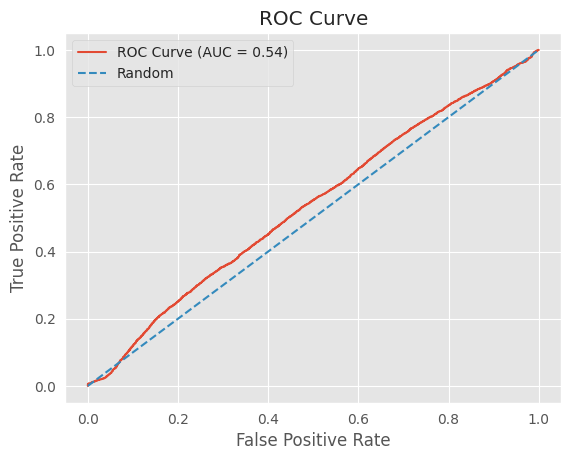

In [ ]:
# ROC Curve
fpr, tpr, _ = roc_curve(y_test, y_pred_probs)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', label='Random')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend()
plt.grid(True)
plt.show()

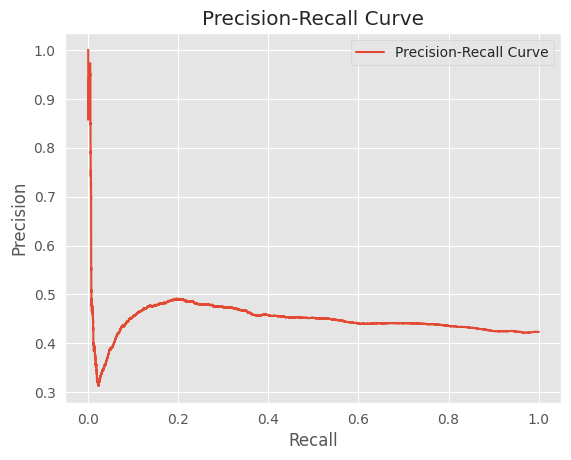

In [ ]:
# Precision-Recall
precision, recall, thresholds = precision_recall_curve(y_test, y_pred_probs)

plt.plot(recall, precision, label='Precision-Recall Curve')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
model_results = {
    'Model': 'LSTM all',

    'Test_Accuracy': test_acc,
    'Test_Precision': test_prec,
    'Test_Recall': test_rec,
    'Test_Fscore': test_f,
    'Test_ROC_AUC': test_roc_auc,

    'Val_Accuracy': val_acc,
    'Val_Precision': val_prec,
    'Val_Recall': val_rec,
    'Val_Fscore': val_f,
    'Val_ROC_AUC': val_roc_auc
}

try:
    summary_df
except NameError:
    summary_df = pd.DataFrame()

summary_df = pd.concat([summary_df, pd.DataFrame([model_results])], ignore_index=True)
summary_df

,Model,Test_Accuracy,Test_Precision,Test_Recall,Test_Fscore,Test_ROC_AUC,Val_Accuracy,Val_Precision,Val_Recall,Val_Fscore,Val_ROC_AUC
0,LSTM all,0.440986,0.387108,0.689348,0.495798,0.481179,0.481022,0.428571,0.347205,0.383621,0.478399
1,LSTM all,0.533536,0.452135,0.484595,0.467802,0.536290,0.548475,0.515777,0.457598,0.484949,0.560808


## LSTM - EMBEDDING

In [ ]:
n_features = len(feature_cols)
timesteps = 20
batch = 64
epochs = 40
split_train = 0.7
split_val = 0.2
if split_train + split_val > 1:
  raise ValueError("split_train + split_val cannot be greater than 1")
split_test = 1 - split_train - split_val

In [ ]:
# Borrar nulos
df_signal_nan = df_signal.dropna()

# Ordenar
df_signal_nan = df_signal.dropna().sort_values(["Ticker", "Date"]).reset_index(drop=True)

In [ ]:
# MAPEO DE TICKER A ÍNDICE PARA EMBEDDING
ticker_list = df_signal_nan["Ticker"].unique().tolist()
ticker2idx = {ticker: i for i, ticker in enumerate(ticker_list)}
df_signal_nan["Ticker_idx"] = df_signal_nan["Ticker"].map(ticker2idx)

In [ ]:
# GENERACIÓN DE SECUENCIAS CON EMBEDDING
X_all, y_all, tickers_all, dates_all = [], [], [], []

for ticker in df_signal_nan["Ticker"].unique():
    df_ticker = df_signal_nan[df_signal_nan["Ticker"] == ticker].copy()
    df_ticker = df_ticker.sort_values("Date").reset_index(drop=True)

    # Normalización y secuencias
    scaler = MinMaxScaler()
    X_scaled = scaler.fit_transform(df_ticker[feature_cols].values)
    y_ticker = df_ticker[label_col].values
    dates = df_ticker["Date"].values
    ticker_idx = ticker2idx[ticker]

    for i in range(timesteps, len(X_scaled)):
        X_all.append(X_scaled[i-timesteps:i])
        y_all.append(y_ticker[i])
        tickers_all.append(ticker_idx)
        dates_all.append(dates[i])

X_array = np.array(X_all)
y_array = np.array(y_all)
ticker_array = np.array(tickers_all)

In [ ]:
X_train, y_train, tick_train = [], [], []
X_val, y_val, tick_val = [], [], []
X_test, y_test, tick_test = [], [], []

for ticker_idx in np.unique(tickers_all):
    idx = [i for i, t in enumerate(tickers_all) if t == ticker_idx]
    dates = np.array(dates_all)[idx]
    sorted_idx = np.argsort(dates)

    X = np.array(X_all)[idx][sorted_idx]
    y = np.array(y_all)[idx][sorted_idx]
    tick = np.array(tickers_all)[idx][sorted_idx]

    n = len(X)
    n_train = int(n * split_train)
    n_val = int(n * split_val)

    X_train.append(X[:n_train])
    y_train.append(y[:n_train])
    tick_train.append(tick[:n_train])

    X_val.append(X[n_train:n_train+n_val])
    y_val.append(y[n_train:n_train+n_val])
    tick_val.append(tick[n_train:n_train+n_val])

    X_test.append(X[n_train+n_val:])
    y_test.append(y[n_train+n_val:])
    tick_test.append(tick[n_train+n_val:])

In [ ]:
# SPLIT TEMPORAL
# Añadir fecha para orden temporal
seq_dates = df_signal_nan.groupby("Ticker").apply(lambda x: x["Date"].iloc[timesteps:]).explode().values
seq_dates = pd.to_datetime(seq_dates)

df_seq = pd.DataFrame({
    "Date": seq_dates,
    "Ticker_idx": ticker_array,
    "y": y_array
})

# Ordenar por fecha
sorted_idx = np.argsort(df_seq["Date"].values)
X_array = X_array[sorted_idx]
y_array = y_array[sorted_idx]
ticker_array = ticker_array[sorted_idx]
df_seq = df_seq.iloc[sorted_idx]

# Cortes de fecha
cutoff_train = df_seq["Date"].quantile(quantile / 100)
cutoff_val = df_seq["Date"].quantile((quantile + (100 - quantile)/2) / 100)

train_idx = df_seq["Date"] <= cutoff_train
val_idx = (df_seq["Date"] > cutoff_train) & (df_seq["Date"] <= cutoff_val)
test_idx = df_seq["Date"] > cutoff_val

X_train, y_train, tick_train = X_array[train_idx], y_array[train_idx], ticker_array[train_idx]
X_val, y_val, tick_val = X_array[val_idx], y_array[val_idx], ticker_array[val_idx]
X_test, y_test, tick_test = X_array[test_idx], y_array[test_idx], ticker_array[test_idx]


<ipython-input-97-c4d7195530ac>:3: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  seq_dates = df_signal_nan.groupby("Ticker").apply(lambda x: x["Date"].iloc[timesteps:]).explode().values


In [ ]:
# MODELO LSTM CON EMBEDDING
# Inputs
input_seq = Input(shape=(timesteps, X_train.shape[2]), name="sequence_input")
input_ticker = Input(shape=(1,), name="ticker_input")

# Embedding
embedding_dim = 8
embedding = Embedding(input_dim=len(ticker2idx), output_dim=embedding_dim)(input_ticker)  # (None, 1, 8)
embedding_flat = Flatten()(embedding)  # (None, 8)
embedding_repeated = Dense(timesteps * embedding_dim, activation='relu')(embedding_flat)
embedding_reshaped = Reshape((timesteps, embedding_dim))(embedding_repeated)  # (None, timesteps, 8)

# Concatenar embedding con features
concat = Concatenate(axis=-1)([input_seq, embedding_reshaped])

# LSTM
x = LSTM(64, return_sequences=True, activation='tanh')(concat)
x = BatchNormalization()(x)
x = Dropout(0.4)(x)
#x = LSTM(64, return_sequences=True, kernel_regularizer=regularizers.l2(0.01), activation='tanh')(x)
x = Dropout(0.4)(x)
x = LSTM(32, return_sequences=False, kernel_regularizer=regularizers.l2(0.01), activation='tanh')(x)
output = Dense(1, activation="sigmoid")(x)

model = Model(inputs=[input_seq, input_ticker], outputs=output)

# Compilación
model.compile(optimizer=Adam(0.001), loss="binary_crossentropy", metrics=["binary_accuracy"])
model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ ticker_input        │ (None, 1)         │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_1         │ (None, 1, 8)      │        272 │ ticker_input[0][… │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ flatten_1 (Flatten) │ (None, 8)         │          0 │ embedding_1[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_2 (Dense)     │ (None, 160)       │      1,440 │ flatten_1[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequence_input      │ (None, 20, 52)    │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reshape_1 (Reshape) │ (None, 20, 8)     │          0 │ dense_2[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_1       │ (None, 20, 60)    │          0 │ sequence_input[0… │
│ (Concatenate)       │                   │            │ reshape_1[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lstm_2 (LSTM)       │ (None, 20, 64)    │     32,000 │ concatenate_1[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 20, 64)    │        256 │ lstm_2[0][0]      │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_2 (Dropout) │ (None, 20, 64)    │          0 │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_3 (Dropout) │ (None, 20, 64)    │          0 │ dropout_2[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lstm_3 (LSTM)       │ (None, 32)        │     12,416 │ dropout_3[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_3 (Dense)     │ (None, 1)         │         33 │ lstm_3[0][0]      │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 46,417 (181.32 KB)

 Trainable params: 46,289 (180.82 KB)

 Non-trainable params: 128 (512.00 B)

In [ ]:
# ENTRENAMIENTO
callbacks = [
    EarlyStopping(monitor='val_loss', patience=40, restore_best_weights=True),
    ReduceLROnPlateau(monitor='val_loss', patience=10, factor=0.5, min_lr=1e-5)
]

from sklearn.utils import class_weight

class_weights = class_weight.compute_class_weight(
    class_weight='balanced',
    classes=np.unique(y_train),
    y=y_train
)
class_weights = dict(enumerate(class_weights))

history = model.fit(
    x=[X_train, tick_train],
    y=y_train,
    validation_data=([X_val, tick_val], y_val),
    epochs=epochs,
    batch_size=batch,
    class_weight=class_weights,
    callbacks=callbacks,
    verbose=1
)

Epoch 1/40
1976/1976 ━━━━━━━━━━━━━━━━━━━━ 23s 10ms/step - binary_accuracy: 0.5429 - loss: 0.8301 - val_binary_accuracy: 0.4810 - val_loss: 0.7006 - learning_rate: 0.0010
Epoch 2/40
1976/1976 ━━━━━━━━━━━━━━━━━━━━ 20s 10ms/step - binary_accuracy: 0.5710 - loss: 0.6816 - val_binary_accuracy: 0.4628 - val_loss: 0.7156 - learning_rate: 0.0010
Epoch 3/40
1976/1976 ━━━━━━━━━━━━━━━━━━━━ 20s 9ms/step - binary_accuracy: 0.5790 - loss: 0.6761 - val_binary_accuracy: 0.4632 - val_loss: 0.7329 - learning_rate: 0.0010
Epoch 4/40
1976/1976 ━━━━━━━━━━━━━━━━━━━━ 19s 10ms/step - binary_accuracy: 0.5928 - loss: 0.6696 - val_binary_accuracy: 0.4636 - val_loss: 0.7440 - learning_rate: 0.0010
Epoch 5/40
1976/1976 ━━━━━━━━━━━━━━━━━━━━ 20s 10ms/step - binary_accuracy: 0.5997 - loss: 0.6638 - val_binary_accuracy: 0.4624 - val_loss: 0.7316 - learning_rate: 0.0010
Epoch 6/40
1976/1976 ━━━━━━━━━━━━━━━━━━━━ 20s 9ms/step - binary_accuracy: 0.6095 - loss: 0.6577 - val_binary_accuracy: 0.4677 - val_loss: 0.7390 - lear

In [ ]:
test_loss, test_acc = model.evaluate([X_test, tick_test], y_test)
print(f"🧪 Test loss: {test_loss:.4f} | Test accuracy: {test_acc:.4f}")

493/493 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - binary_accuracy: 0.4695 - loss: 0.7097
🧪 Test loss: 0.7200 | Test accuracy: 0.4410


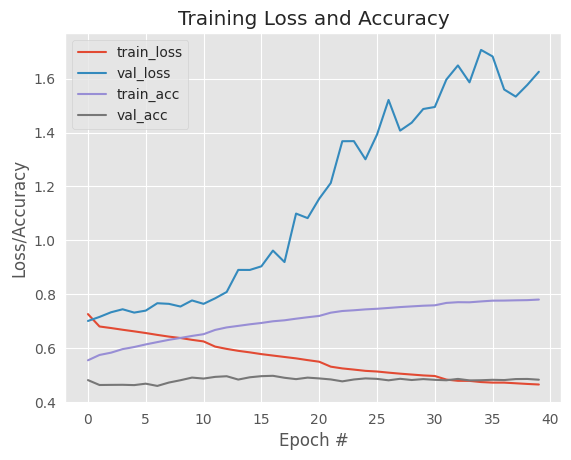

In [ ]:
epoch_numbers = range(1, len(history.history['loss']) + 1)[-1]


# Gráficas
plt.style.use("ggplot")
plt.figure()
plt.plot(np.arange(0, epoch_numbers), history.history["loss"], label="train_loss")
plt.plot(np.arange(0, epoch_numbers), history.history["val_loss"], label="val_loss")
plt.plot(np.arange(0, epoch_numbers), history.history["binary_accuracy"], label="train_acc")
plt.plot(np.arange(0, epoch_numbers), history.history["val_binary_accuracy"], label="val_acc")
plt.title("Training Loss and Accuracy")
plt.xlabel("Epoch #")
plt.ylabel("Loss/Accuracy")
plt.legend()
plt.show()

In [ ]:
# Predecir etiquetas en test
y_pred_probs = model.predict([X_test, tick_test]).flatten()
y_pred = (y_pred_probs > 0.5).astype(int)

493/493 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step


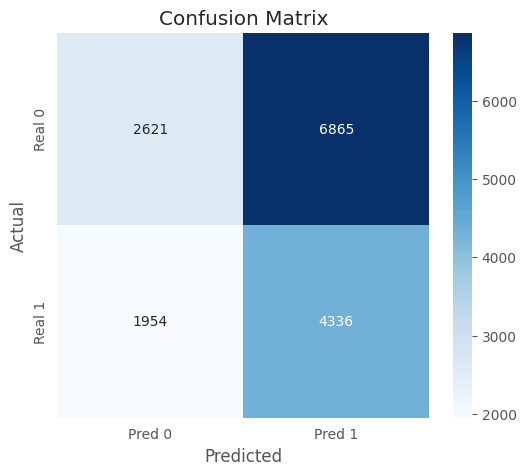

In [ ]:
# Matriz de confusión
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=["Pred 0", "Pred 1"], yticklabels=["Real 0", "Real 1"])
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix")
plt.show()

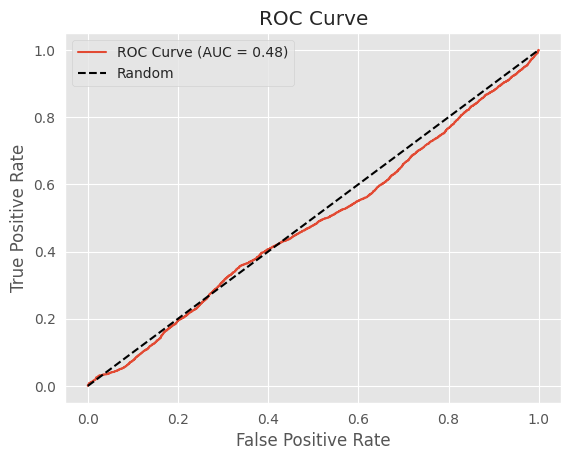

In [ ]:
fpr, tpr, _ = roc_curve(y_test, y_pred_probs)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend()
plt.grid(True)
plt.show()

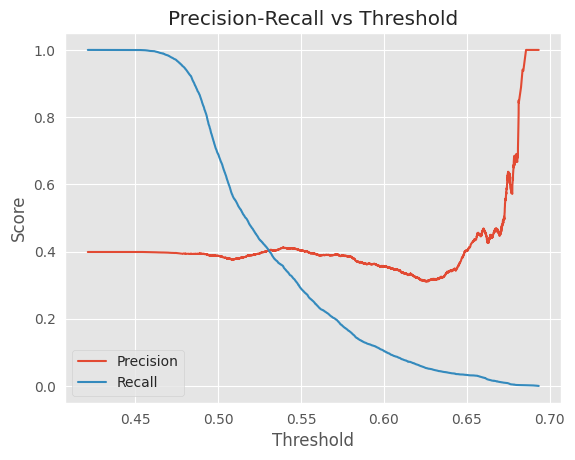

In [ ]:
precisions, recalls, thresholds = precision_recall_curve(y_test, y_pred_probs)

plt.plot(thresholds, precisions[:-1], label='Precision')
plt.plot(thresholds, recalls[:-1], label='Recall')
plt.xlabel("Threshold")
plt.ylabel("Score")
plt.title("Precision-Recall vs Threshold")
plt.grid(True)
plt.legend()
plt.show()

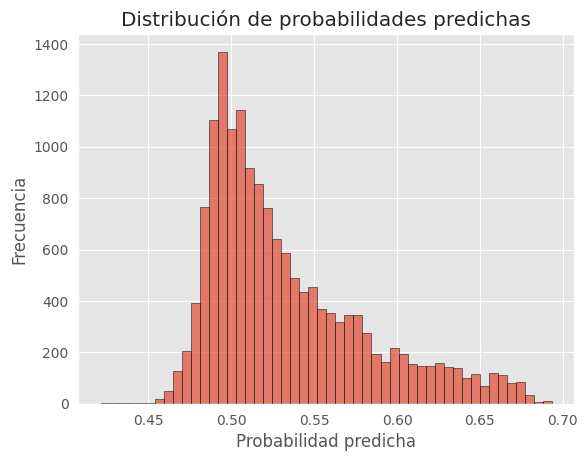

In [ ]:
plt.hist(y_pred_probs, bins=50, edgecolor='k', alpha=0.7)
plt.title("Distribución de probabilidades predichas")
plt.xlabel("Probabilidad predicha")
plt.ylabel("Frecuencia")
plt.grid(True)
plt.show()

In [ ]:
y_pred_probs = model.predict([X_test, tick_test])
y_pred = (y_pred_probs > 0.5).astype(int)

test_loss, test_accuracy = model.evaluate([X_test, tick_test], y_test, verbose=0)

test_acc = accuracy_score(y_test, y_pred)
test_prec = precision_score(y_test, y_pred, zero_division=0)
test_rec = recall_score(y_test, y_pred, zero_division=0)
test_f = f1_score(y_test, y_pred, zero_division=0)
test_roc_auc = roc_auc_score(y_test, y_pred_probs)

493/493 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step


In [ ]:
y_val_probs = model.predict([X_val, tick_val])
y_val_pred = (y_val_probs > 0.5).astype(int)

val_acc = accuracy_score(y_val, y_val_pred)
val_prec = precision_score(y_val, y_val_pred, zero_division=0)
val_rec = recall_score(y_val, y_val_pred, zero_division=0)
val_f = f1_score(y_val, y_val_pred, zero_division=0)
val_roc_auc = roc_auc_score(y_val, y_val_probs)

494/494 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step


In [ ]:
model_results = {
    'Model': 'LSTM all',

    'Test_Accuracy': test_acc,
    'Test_Precision': test_prec,
    'Test_Recall': test_rec,
    'Test_Fscore': test_f,
    'Test_ROC_AUC': test_roc_auc,

    'Val_Accuracy': val_acc,
    'Val_Precision': val_prec,
    'Val_Recall': val_rec,
    'Val_Fscore': val_f,
    'Val_ROC_AUC': val_roc_auc
}

try:
    summary_df
except NameError:
    summary_df = pd.DataFrame()

summary_df = pd.concat([summary_df, pd.DataFrame([model_results])], ignore_index=True)
summary_df

,Model,Test_Accuracy,Test_Precision,Test_Recall,Test_Fscore,Test_ROC_AUC,Val_Accuracy,Val_Precision,Val_Recall,Val_Fscore,Val_ROC_AUC
0,LSTM all,0.440986,0.387108,0.689348,0.495798,0.481179,0.481022,0.428571,0.347205,0.383621,0.478399


## LSTM - PER TICKER


In [ ]:
# Configuración inicial
timesteps = 10
batch_size = 16
epochs = 20
learning_rate = 0.0005
n_features = len(feature_cols)
results = {}

train_size = 0.7
val_size = 0.2
test_size = 0.1

assert np.isclose(train_size + val_size + test_size, 1.0), "train + val + test deben sumar 1"


In [ ]:
def train_lstm_by_ticker(
    df_signal,
    feature_cols,
    label_col,
    timesteps=30,
    batch_size=128,
    epochs=10,
    learning_rate=0.001,
    patience=10,
    plot_curves=False
):
    """
    Entrena un modelo LSTM independiente por cada ticker y guarda los resultados relevantes.
    """
    results = {}

    # Preprocesamiento: eliminar NaNs y ordenar

    for ticker in df_signal["Ticker"].unique():
        print(f"\nEntrenando modelo para: {ticker}")

        # Filtrar datos del ticker
        df_ticker = df_signal[df_signal["Ticker"] == ticker]
        X_ticker = df_ticker[feature_cols].values
        y_ticker = df_ticker[label_col].values

        if len(df_ticker) <= timesteps + 10:
            print(f"Ticker {ticker} ignorado por falta de datos suficientes.")
            continue

        # Crear secuencias
        X_seq, y_seq = [], []
        for i in range(timesteps, len(X_ticker)):
            X_seq.append(X_ticker[i - timesteps:i])
            y_seq.append(y_ticker[i])
        X_seq = np.array(X_seq)
        y_seq = np.array(y_seq)

        # División temporal: train, val, test
        n_samples = len(X_seq)
        n_train = int(train_size * n_samples)
        n_val = int(val_size * n_samples)

        X_train = X_seq[:n_train]
        y_train = y_seq[:n_train]

        X_val = X_seq[n_train:n_train + n_val]
        y_val = y_seq[n_train:n_train + n_val]

        X_test = X_seq[n_train + n_val:]
        y_test = y_seq[n_train + n_val:]

        # Normalizar características (solo sobre el conjunto de entrenamiento)
        scaler = MinMaxScaler()
        X_train_scaled = scaler.fit_transform(X_train.reshape(-1, X_train.shape[-1])).reshape(X_train.shape)

        # Aplicar la misma transformación al conjunto de validación y test
        X_val_scaled = scaler.transform(X_val.reshape(-1, X_val.shape[-1])).reshape(X_val.shape)
        X_test_scaled = scaler.transform(X_test.reshape(-1, X_test.shape[-1])).reshape(X_test.shape)

        # Definir modelo
        model = Sequential([
            Input(shape=(X_train.shape[1], X_train.shape[2])),
            LSTM(64, activation='tanh', return_sequences=True),
            Dropout(0.4),
            LSTM(32, activation='tanh', kernel_regularizer=regularizers.l2(0.001), return_sequences=True),
            Dropout(0.4),
            LSTM(16, activation='tanh', kernel_regularizer=regularizers.l2(0.001), return_sequences=False),
            Dense(1, activation='sigmoid')
        ])

        model.compile(
            optimizer=Adam(learning_rate=learning_rate, amsgrad=True),
            loss='binary_crossentropy', metrics=['binary_accuracy'])

        # Callbacks
        early_stopping = EarlyStopping(monitor='val_loss', patience=patience*2, restore_best_weights=True)
        reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=patience, min_lr=1e-5)

        # Entrenar modelo
        history = model.fit(
            X_train, y_train,
            validation_data=(X_val, y_val),
            epochs=epochs,
            batch_size=batch_size,
            callbacks=[early_stopping, reduce_lr],
            verbose=1
        )

        # Evaluar en cada partición
        train_loss, train_accuracy = model.evaluate(X_train, y_train, verbose=0)
        val_loss, val_accuracy = model.evaluate(X_val, y_val, verbose=0)
        test_loss, test_accuracy = model.evaluate(X_test, y_test, verbose=0)

        # Predicciones
        y_test_prob = model.predict(X_test).ravel()
        y_test_pred = (y_test_prob > 0.5).astype(int)

        # Métricas adicionales
        fpr, tpr, _ = roc_curve(y_test, y_test_prob)
        roc_auc = auc(fpr, tpr)
        precision, recall, _ = precision_recall_curve(y_test, y_test_prob)

        # Guardar resultados
        results[ticker] = {
            'train_loss': train_loss,
            'train_accuracy': train_accuracy,
            'val_loss': val_loss,
            'val_accuracy': val_accuracy,
            'test_loss': test_loss,
            'test_accuracy': test_accuracy,
            'roc_auc': roc_auc,
            'fpr': fpr,
            'tpr': tpr,
            'precision': precision,
            'recall': recall,
            'history': history.history
        }

        model.save(f"modelos_lstm/{ticker}_lstm_model.keras")

        # Opcional: Graficar curvas para cada ticker
        if plot_curves:
            plt.figure(figsize=(14, 6))

            # ROC
            plt.subplot(1, 2, 1)
            plt.plot(fpr, tpr, label=f'ROC AUC = {roc_auc:.2f}')
            plt.plot([0, 1], [0, 1], 'k--')
            plt.title(f'ROC Curve - {ticker}')
            plt.xlabel('False Positive Rate')
            plt.ylabel('True Positive Rate')
            plt.legend()

            # Precision-Recall
            plt.subplot(1, 2, 2)
            plt.plot(recall, precision, label='Precision-Recall Curve')
            plt.title(f'Precision-Recall Curve - {ticker}')
            plt.xlabel('Recall')
            plt.ylabel('Precision')
            plt.legend()

            plt.tight_layout()
            plt.show()

    return results

In [ ]:
df_signal = df_signal.dropna().sort_values(["Ticker", "Date"]).reset_index(drop=True)


os.makedirs("modelos_lstm", exist_ok=True)

results = train_lstm_by_ticker(df_signal=df_signal,
    feature_cols=feature_cols,
    label_col=label_col,
    timesteps=timesteps,
    batch_size=batch_size,
    epochs=epochs,
    learning_rate=learning_rate,
    patience=5,
    plot_curves=False)


Entrenando modelo para: ACS.MC
Epoch 1/20
245/245 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - binary_accuracy: 0.4972 - loss: 0.8000 - val_binary_accuracy: 0.5466 - val_loss: 0.7487 - learning_rate: 5.0000e-04
Epoch 2/20
245/245 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - binary_accuracy: 0.5511 - loss: 0.7353 - val_binary_accuracy: 0.5018 - val_loss: 0.7402 - learning_rate: 5.0000e-04
Epoch 3/20
245/245 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - binary_accuracy: 0.5913 - loss: 0.6992 - val_binary_accuracy: 0.5448 - val_loss: 0.7582 - learning_rate: 5.0000e-04
Epoch 4/20
245/245 ━━━━━━━━━━━━━━━━━━━━ 5s 21ms/step - binary_accuracy: 0.6229 - loss: 0.6643 - val_binary_accuracy: 0.5457 - val_loss: 0.7990 - learning_rate: 5.0000e-04
Epoch 5/20
245/245 ━━━━━━━━━━━━━━━━━━━━ 9s 16ms/step - binary_accuracy: 0.6481 - loss: 0.6471 - val_binary_accuracy: 0.5332 - val_loss: 0.8631 - learning_rate: 5.0000e-04
Epoch 6/20
245/245 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step - binary_accuracy: 0.6725 - loss: 0.6206 - val_binary_accuracy


Entrenando modelo para: ACX.MC
Epoch 1/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - binary_accuracy: 0.5438 - loss: 0.7831 - val_binary_accuracy: 0.5173 - val_loss: 0.7492 - learning_rate: 5.0000e-04
Epoch 2/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - binary_accuracy: 0.5773 - loss: 0.7137 - val_binary_accuracy: 0.4959 - val_loss: 0.7425 - learning_rate: 5.0000e-04
Epoch 3/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - binary_accuracy: 0.6142 - loss: 0.6826 - val_binary_accuracy: 0.4901 - val_loss: 0.7692 - learning_rate: 5.0000e-04
Epoch 4/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - binary_accuracy: 0.6320 - loss: 0.6649 - val_binary_accuracy: 0.4819 - val_loss: 0.7961 - learning_rate: 5.0000e-04
Epoch 5/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - binary_accuracy: 0.6548 - loss: 0.6503 - val_binary_accuracy: 0.4449 - val_loss: 0.8419 - learning_rate: 5.0000e-04
Epoch 6/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - binary_accuracy: 0.6699 - loss: 0.6331 - val_binary_accuracy: 


Entrenando modelo para: AENA.MC
Epoch 1/20
98/98 ━━━━━━━━━━━━━━━━━━━━ 5s 20ms/step - binary_accuracy: 0.5528 - loss: 0.7930 - val_binary_accuracy: 0.6667 - val_loss: 0.7171 - learning_rate: 5.0000e-04
Epoch 2/20
98/98 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - binary_accuracy: 0.6352 - loss: 0.7339 - val_binary_accuracy: 0.6465 - val_loss: 0.6949 - learning_rate: 5.0000e-04
Epoch 3/20
98/98 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - binary_accuracy: 0.6805 - loss: 0.6859 - val_binary_accuracy: 0.6331 - val_loss: 0.6850 - learning_rate: 5.0000e-04
Epoch 4/20
98/98 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - binary_accuracy: 0.6867 - loss: 0.6494 - val_binary_accuracy: 0.6376 - val_loss: 0.6829 - learning_rate: 5.0000e-04
Epoch 5/20
98/98 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - binary_accuracy: 0.7108 - loss: 0.6186 - val_binary_accuracy: 0.6286 - val_loss: 0.6989 - learning_rate: 5.0000e-04
Epoch 6/20
98/98 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - binary_accuracy: 0.7215 - loss: 0.6011 - val_binary_accuracy: 0.6353 -


Entrenando modelo para: AMS.MC
Epoch 1/20
152/152 ━━━━━━━━━━━━━━━━━━━━ 5s 15ms/step - binary_accuracy: 0.5535 - loss: 0.7933 - val_binary_accuracy: 0.5014 - val_loss: 0.7906 - learning_rate: 5.0000e-04
Epoch 2/20
152/152 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - binary_accuracy: 0.6006 - loss: 0.7278 - val_binary_accuracy: 0.4971 - val_loss: 0.7929 - learning_rate: 5.0000e-04
Epoch 3/20
152/152 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - binary_accuracy: 0.6363 - loss: 0.6817 - val_binary_accuracy: 0.5159 - val_loss: 0.8308 - learning_rate: 5.0000e-04
Epoch 4/20
152/152 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - binary_accuracy: 0.6978 - loss: 0.6278 - val_binary_accuracy: 0.4913 - val_loss: 0.8594 - learning_rate: 5.0000e-04
Epoch 5/20
152/152 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - binary_accuracy: 0.7243 - loss: 0.5967 - val_binary_accuracy: 0.5058 - val_loss: 0.8822 - learning_rate: 5.0000e-04
Epoch 6/20
152/152 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - binary_accuracy: 0.7299 - loss: 0.5746 - val_binary_accuracy

11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step



Entrenando modelo para: ANA.MC
Epoch 1/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 8s 10ms/step - binary_accuracy: 0.5250 - loss: 0.7933 - val_binary_accuracy: 0.4482 - val_loss: 0.7757 - learning_rate: 5.0000e-04
Epoch 2/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.5928 - loss: 0.7124 - val_binary_accuracy: 0.5321 - val_loss: 0.7718 - learning_rate: 5.0000e-04
Epoch 3/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6390 - loss: 0.6645 - val_binary_accuracy: 0.5526 - val_loss: 0.7852 - learning_rate: 5.0000e-04
Epoch 4/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - binary_accuracy: 0.6592 - loss: 0.6410 - val_binary_accuracy: 0.5461 - val_loss: 0.7864 - learning_rate: 5.0000e-04
Epoch 5/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - binary_accuracy: 0.6810 - loss: 0.6274 - val_binary_accuracy: 0.5510 - val_loss: 0.7973 - learning_rate: 5.0000e-04
Epoch 6/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - binary_accuracy: 0.6871 - loss: 0.6116 - val_binary_accuracy: 


Entrenando modelo para: ANE.MC
Epoch 1/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 4s 29ms/step - binary_accuracy: 0.8126 - loss: 0.7208 - val_binary_accuracy: 0.9339 - val_loss: 0.4868 - learning_rate: 5.0000e-04
Epoch 2/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - binary_accuracy: 0.8242 - loss: 0.6194 - val_binary_accuracy: 0.9339 - val_loss: 0.4356 - learning_rate: 5.0000e-04
Epoch 3/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - binary_accuracy: 0.8242 - loss: 0.5758 - val_binary_accuracy: 0.9339 - val_loss: 0.4162 - learning_rate: 5.0000e-04
Epoch 4/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - binary_accuracy: 0.8242 - loss: 0.5481 - val_binary_accuracy: 0.9339 - val_loss: 0.3783 - learning_rate: 5.0000e-04
Epoch 5/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - binary_accuracy: 0.8242 - loss: 0.5058 - val_binary_accuracy: 0.9339 - val_loss: 0.3618 - learning_rate: 5.0000e-04
Epoch 6/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - binary_accuracy: 0.8250 - loss: 0.4690 - val_binary_accuracy: 0.9339 -

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_ranking.py:1188: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_ranking.py:1033: UserWarning: No positive class found in y_true, recall is set to one for all thresholds.
  warnings.warn(



Entrenando modelo para: BBVA.MC
Epoch 1/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - binary_accuracy: 0.5906 - loss: 0.7785 - val_binary_accuracy: 0.5337 - val_loss: 0.7991 - learning_rate: 5.0000e-04
Epoch 2/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - binary_accuracy: 0.6066 - loss: 0.7152 - val_binary_accuracy: 0.5074 - val_loss: 0.7938 - learning_rate: 5.0000e-04
Epoch 3/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6215 - loss: 0.6871 - val_binary_accuracy: 0.4350 - val_loss: 0.8314 - learning_rate: 5.0000e-04
Epoch 4/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - binary_accuracy: 0.6223 - loss: 0.6710 - val_binary_accuracy: 0.4433 - val_loss: 0.8652 - learning_rate: 5.0000e-04
Epoch 5/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - binary_accuracy: 0.6400 - loss: 0.6544 - val_binary_accuracy: 0.4548 - val_loss: 0.8887 - learning_rate: 5.0000e-04
Epoch 6/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - binary_accuracy: 0.6563 - loss: 0.6438 - val_binary_accuracy:

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step



Entrenando modelo para: BKT.MC
Epoch 1/20
207/207 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - binary_accuracy: 0.5357 - loss: 0.7910 - val_binary_accuracy: 0.4130 - val_loss: 0.8116 - learning_rate: 5.0000e-04
Epoch 2/20
207/207 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - binary_accuracy: 0.6076 - loss: 0.7157 - val_binary_accuracy: 0.4098 - val_loss: 0.8249 - learning_rate: 5.0000e-04
Epoch 3/20
207/207 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - binary_accuracy: 0.6531 - loss: 0.6735 - val_binary_accuracy: 0.5042 - val_loss: 0.8350 - learning_rate: 5.0000e-04
Epoch 4/20
207/207 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - binary_accuracy: 0.6912 - loss: 0.6274 - val_binary_accuracy: 0.5393 - val_loss: 0.9541 - learning_rate: 5.0000e-04
Epoch 5/20
207/207 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.7193 - loss: 0.5782 - val_binary_accuracy: 0.5361 - val_loss: 1.0450 - learning_rate: 5.0000e-04
Epoch 6/20
207/207 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - binary_accuracy: 0.7508 - loss: 0.5410 - val_binary_accurac


Entrenando modelo para: CABK.MC
Epoch 1/20
180/180 ━━━━━━━━━━━━━━━━━━━━ 6s 13ms/step - binary_accuracy: 0.5303 - loss: 0.7992 - val_binary_accuracy: 0.4677 - val_loss: 0.7926 - learning_rate: 5.0000e-04
Epoch 2/20
180/180 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.5956 - loss: 0.7309 - val_binary_accuracy: 0.4507 - val_loss: 0.8037 - learning_rate: 5.0000e-04
Epoch 3/20
180/180 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - binary_accuracy: 0.6155 - loss: 0.6903 - val_binary_accuracy: 0.4921 - val_loss: 0.7950 - learning_rate: 5.0000e-04
Epoch 4/20
180/180 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - binary_accuracy: 0.6541 - loss: 0.6595 - val_binary_accuracy: 0.5140 - val_loss: 0.7929 - learning_rate: 5.0000e-04
Epoch 5/20
180/180 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - binary_accuracy: 0.6649 - loss: 0.6360 - val_binary_accuracy: 0.4933 - val_loss: 0.7864 - learning_rate: 5.0000e-04
Epoch 6/20
180/180 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - binary_accuracy: 0.6948 - loss: 0.6133 - val_binary_accura


Entrenando modelo para: CLNX.MC
Epoch 1/20
96/96 ━━━━━━━━━━━━━━━━━━━━ 5s 15ms/step - binary_accuracy: 0.6160 - loss: 0.7832 - val_binary_accuracy: 0.3257 - val_loss: 0.9781 - learning_rate: 5.0000e-04
Epoch 2/20
96/96 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - binary_accuracy: 0.6587 - loss: 0.7198 - val_binary_accuracy: 0.4472 - val_loss: 0.8743 - learning_rate: 5.0000e-04
Epoch 3/20
96/96 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - binary_accuracy: 0.7302 - loss: 0.6330 - val_binary_accuracy: 0.3693 - val_loss: 0.9331 - learning_rate: 5.0000e-04
Epoch 4/20
96/96 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - binary_accuracy: 0.7695 - loss: 0.5773 - val_binary_accuracy: 0.4725 - val_loss: 0.9378 - learning_rate: 5.0000e-04
Epoch 5/20
96/96 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - binary_accuracy: 0.7879 - loss: 0.5327 - val_binary_accuracy: 0.4289 - val_loss: 1.2134 - learning_rate: 5.0000e-04
Epoch 6/20
96/96 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - binary_accuracy: 0.8058 - loss: 0.5048 - val_binary_accuracy: 0.3739 - v


Entrenando modelo para: COL.MC
Epoch 1/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - binary_accuracy: 0.5772 - loss: 0.7860 - val_binary_accuracy: 0.5406 - val_loss: 0.7635 - learning_rate: 5.0000e-04
Epoch 2/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - binary_accuracy: 0.6166 - loss: 0.7027 - val_binary_accuracy: 0.4704 - val_loss: 0.7794 - learning_rate: 5.0000e-04
Epoch 3/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6321 - loss: 0.6659 - val_binary_accuracy: 0.4531 - val_loss: 0.8078 - learning_rate: 5.0000e-04
Epoch 4/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - binary_accuracy: 0.6611 - loss: 0.6429 - val_binary_accuracy: 0.4831 - val_loss: 0.8392 - learning_rate: 5.0000e-04
Epoch 5/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6776 - loss: 0.6242 - val_binary_accuracy: 0.4977 - val_loss: 0.8736 - learning_rate: 5.0000e-04
Epoch 6/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step - binary_accuracy: 0.6864 - loss: 0.6036 - val_binary_accuracy


Entrenando modelo para: ELE.MC
Epoch 1/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 6s 13ms/step - binary_accuracy: 0.5162 - loss: 0.7966 - val_binary_accuracy: 0.4375 - val_loss: 0.7722 - learning_rate: 5.0000e-04
Epoch 2/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - binary_accuracy: 0.5389 - loss: 0.7304 - val_binary_accuracy: 0.4803 - val_loss: 0.7884 - learning_rate: 5.0000e-04
Epoch 3/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - binary_accuracy: 0.5627 - loss: 0.7007 - val_binary_accuracy: 0.4803 - val_loss: 0.7975 - learning_rate: 5.0000e-04
Epoch 4/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - binary_accuracy: 0.5885 - loss: 0.6752 - val_binary_accuracy: 0.5008 - val_loss: 0.8104 - learning_rate: 5.0000e-04
Epoch 5/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - binary_accuracy: 0.6019 - loss: 0.6612 - val_binary_accuracy: 0.4967 - val_loss: 0.8275 - learning_rate: 5.0000e-04
Epoch 6/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - binary_accuracy: 0.6088 - loss: 0.6481 - val_binary_accuracy: 


Entrenando modelo para: ENG.MC
Epoch 1/20
239/239 ━━━━━━━━━━━━━━━━━━━━ 9s 14ms/step - binary_accuracy: 0.5180 - loss: 0.7922 - val_binary_accuracy: 0.4748 - val_loss: 0.7565 - learning_rate: 5.0000e-04
Epoch 2/20
239/239 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - binary_accuracy: 0.5578 - loss: 0.7252 - val_binary_accuracy: 0.5445 - val_loss: 0.7167 - learning_rate: 5.0000e-04
Epoch 3/20
239/239 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step - binary_accuracy: 0.6079 - loss: 0.6925 - val_binary_accuracy: 0.5619 - val_loss: 0.7094 - learning_rate: 5.0000e-04
Epoch 4/20
239/239 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - binary_accuracy: 0.6138 - loss: 0.6709 - val_binary_accuracy: 0.5646 - val_loss: 0.7071 - learning_rate: 5.0000e-04
Epoch 5/20
239/239 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6359 - loss: 0.6555 - val_binary_accuracy: 0.5775 - val_loss: 0.7218 - learning_rate: 5.0000e-04
Epoch 6/20
239/239 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6393 - loss: 0.6443 - val_binary_accuracy: 


Entrenando modelo para: FDR.MC
Epoch 1/20
180/180 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - binary_accuracy: 0.5651 - loss: 0.7925 - val_binary_accuracy: 0.5086 - val_loss: 0.8073 - learning_rate: 5.0000e-04
Epoch 2/20
180/180 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - binary_accuracy: 0.5998 - loss: 0.7184 - val_binary_accuracy: 0.5244 - val_loss: 0.8083 - learning_rate: 5.0000e-04
Epoch 3/20
180/180 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - binary_accuracy: 0.6272 - loss: 0.6812 - val_binary_accuracy: 0.4976 - val_loss: 0.7856 - learning_rate: 5.0000e-04
Epoch 4/20
180/180 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6406 - loss: 0.6599 - val_binary_accuracy: 0.5073 - val_loss: 0.7633 - learning_rate: 5.0000e-04
Epoch 5/20
180/180 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step - binary_accuracy: 0.6689 - loss: 0.6394 - val_binary_accuracy: 0.5000 - val_loss: 0.7490 - learning_rate: 5.0000e-04
Epoch 6/20
180/180 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - binary_accuracy: 0.6947 - loss: 0.6155 - val_binary_accuracy:


Entrenando modelo para: FER.MC
Epoch 1/20
207/207 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - binary_accuracy: 0.5412 - loss: 0.7962 - val_binary_accuracy: 0.4437 - val_loss: 0.7784 - learning_rate: 5.0000e-04
Epoch 2/20
207/207 ━━━━━━━━━━━━━━━━━━━━ 5s 10ms/step - binary_accuracy: 0.5847 - loss: 0.7303 - val_binary_accuracy: 0.4735 - val_loss: 0.7641 - learning_rate: 5.0000e-04
Epoch 3/20
207/207 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - binary_accuracy: 0.6155 - loss: 0.6913 - val_binary_accuracy: 0.4416 - val_loss: 0.7782 - learning_rate: 5.0000e-04
Epoch 4/20
207/207 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - binary_accuracy: 0.6374 - loss: 0.6637 - val_binary_accuracy: 0.4586 - val_loss: 0.8021 - learning_rate: 5.0000e-04
Epoch 5/20
207/207 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - binary_accuracy: 0.6395 - loss: 0.6505 - val_binary_accuracy: 0.4671 - val_loss: 0.8434 - learning_rate: 5.0000e-04
Epoch 6/20
207/207 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - binary_accuracy: 0.6723 - loss: 0.6272 - val_binary_accura


Entrenando modelo para: GRF.MC
Epoch 1/20
196/196 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - binary_accuracy: 0.5589 - loss: 0.7906 - val_binary_accuracy: 0.4334 - val_loss: 0.7954 - learning_rate: 5.0000e-04
Epoch 2/20
196/196 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - binary_accuracy: 0.5878 - loss: 0.7291 - val_binary_accuracy: 0.4826 - val_loss: 0.8530 - learning_rate: 5.0000e-04
Epoch 3/20
196/196 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - binary_accuracy: 0.6119 - loss: 0.6947 - val_binary_accuracy: 0.4714 - val_loss: 0.8823 - learning_rate: 5.0000e-04
Epoch 4/20
196/196 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - binary_accuracy: 0.6574 - loss: 0.6622 - val_binary_accuracy: 0.4692 - val_loss: 0.8916 - learning_rate: 5.0000e-04
Epoch 5/20
196/196 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - binary_accuracy: 0.6819 - loss: 0.6264 - val_binary_accuracy: 0.4356 - val_loss: 0.9341 - learning_rate: 5.0000e-04
Epoch 6/20
196/196 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - binary_accuracy: 0.7057 - loss: 0.5966 - val_binary_accura


Entrenando modelo para: IAG.MC
Epoch 1/20
144/144 ━━━━━━━━━━━━━━━━━━━━ 5s 15ms/step - binary_accuracy: 0.5084 - loss: 0.8099 - val_binary_accuracy: 0.4504 - val_loss: 0.7857 - learning_rate: 5.0000e-04
Epoch 2/20
144/144 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - binary_accuracy: 0.5846 - loss: 0.7508 - val_binary_accuracy: 0.4977 - val_loss: 0.7945 - learning_rate: 5.0000e-04
Epoch 3/20
144/144 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - binary_accuracy: 0.6448 - loss: 0.6839 - val_binary_accuracy: 0.5344 - val_loss: 0.8046 - learning_rate: 5.0000e-04
Epoch 4/20
144/144 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - binary_accuracy: 0.7021 - loss: 0.6093 - val_binary_accuracy: 0.5802 - val_loss: 0.7797 - learning_rate: 5.0000e-04
Epoch 5/20
144/144 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - binary_accuracy: 0.7429 - loss: 0.5563 - val_binary_accuracy: 0.6000 - val_loss: 0.7979 - learning_rate: 5.0000e-04
Epoch 6/20
144/144 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - binary_accuracy: 0.7745 - loss: 0.5158 - val_binary_accurac


Entrenando modelo para: IBE.MC
Epoch 1/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - binary_accuracy: 0.5378 - loss: 0.7888 - val_binary_accuracy: 0.5329 - val_loss: 0.7698 - learning_rate: 5.0000e-04
Epoch 2/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - binary_accuracy: 0.5778 - loss: 0.7145 - val_binary_accuracy: 0.5222 - val_loss: 0.7567 - learning_rate: 5.0000e-04
Epoch 3/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6176 - loss: 0.6799 - val_binary_accuracy: 0.5238 - val_loss: 0.7769 - learning_rate: 5.0000e-04
Epoch 4/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6504 - loss: 0.6516 - val_binary_accuracy: 0.5148 - val_loss: 0.8062 - learning_rate: 5.0000e-04
Epoch 5/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - binary_accuracy: 0.6697 - loss: 0.6340 - val_binary_accuracy: 0.5189 - val_loss: 0.8315 - learning_rate: 5.0000e-04
Epoch 6/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - binary_accuracy: 0.6836 - loss: 0.6184 - val_binary_accuracy: 


Entrenando modelo para: IDR.MC
Epoch 1/20
258/258 ━━━━━━━━━━━━━━━━━━━━ 7s 11ms/step - binary_accuracy: 0.5249 - loss: 0.7974 - val_binary_accuracy: 0.5696 - val_loss: 0.7311 - learning_rate: 5.0000e-04
Epoch 2/20
258/258 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.5474 - loss: 0.7325 - val_binary_accuracy: 0.5416 - val_loss: 0.7244 - learning_rate: 5.0000e-04
Epoch 3/20
258/258 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - binary_accuracy: 0.5770 - loss: 0.7028 - val_binary_accuracy: 0.4958 - val_loss: 0.7687 - learning_rate: 5.0000e-04
Epoch 4/20
258/258 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step - binary_accuracy: 0.6026 - loss: 0.6798 - val_binary_accuracy: 0.4448 - val_loss: 0.8071 - learning_rate: 5.0000e-04
Epoch 5/20
258/258 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - binary_accuracy: 0.6197 - loss: 0.6601 - val_binary_accuracy: 0.4423 - val_loss: 0.8562 - learning_rate: 5.0000e-04
Epoch 6/20
258/258 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6438 - loss: 0.6422 - val_binary_accuracy:


Entrenando modelo para: ITX.MC
Epoch 1/20
251/251 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - binary_accuracy: 0.6036 - loss: 0.7731 - val_binary_accuracy: 0.5419 - val_loss: 0.7696 - learning_rate: 5.0000e-04
Epoch 2/20
251/251 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6245 - loss: 0.7044 - val_binary_accuracy: 0.5506 - val_loss: 0.7979 - learning_rate: 5.0000e-04
Epoch 3/20
251/251 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6380 - loss: 0.6757 - val_binary_accuracy: 0.5602 - val_loss: 0.8375 - learning_rate: 5.0000e-04
Epoch 4/20
251/251 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step - binary_accuracy: 0.6437 - loss: 0.6557 - val_binary_accuracy: 0.5812 - val_loss: 0.8613 - learning_rate: 5.0000e-04
Epoch 5/20
251/251 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - binary_accuracy: 0.6543 - loss: 0.6394 - val_binary_accuracy: 0.5969 - val_loss: 0.8877 - learning_rate: 5.0000e-04
Epoch 6/20
251/251 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6638 - loss: 0.6257 - val_binary_accuracy:


Entrenando modelo para: LOG.MC
Epoch 1/20
105/105 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - binary_accuracy: 0.5608 - loss: 0.7983 - val_binary_accuracy: 0.6164 - val_loss: 0.7717 - learning_rate: 5.0000e-04
Epoch 2/20
105/105 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - binary_accuracy: 0.6035 - loss: 0.7490 - val_binary_accuracy: 0.6164 - val_loss: 0.7431 - learning_rate: 5.0000e-04
Epoch 3/20
105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - binary_accuracy: 0.6150 - loss: 0.7056 - val_binary_accuracy: 0.5367 - val_loss: 0.7313 - learning_rate: 5.0000e-04
Epoch 4/20
105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - binary_accuracy: 0.6624 - loss: 0.6620 - val_binary_accuracy: 0.5493 - val_loss: 0.7326 - learning_rate: 5.0000e-04
Epoch 5/20
105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - binary_accuracy: 0.6728 - loss: 0.6288 - val_binary_accuracy: 0.5325 - val_loss: 0.7480 - learning_rate: 5.0000e-04
Epoch 6/20
105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - binary_accuracy: 0.7032 - loss: 0.6037 - val_binary_accuracy


Entrenando modelo para: MAP.MC
Epoch 1/20
248/248 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - binary_accuracy: 0.5268 - loss: 0.7955 - val_binary_accuracy: 0.5747 - val_loss: 0.7453 - learning_rate: 5.0000e-04
Epoch 2/20
248/248 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - binary_accuracy: 0.5573 - loss: 0.7287 - val_binary_accuracy: 0.5482 - val_loss: 0.7459 - learning_rate: 5.0000e-04
Epoch 3/20
248/248 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - binary_accuracy: 0.5905 - loss: 0.6919 - val_binary_accuracy: 0.5137 - val_loss: 0.7679 - learning_rate: 5.0000e-04
Epoch 4/20
248/248 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - binary_accuracy: 0.5956 - loss: 0.6770 - val_binary_accuracy: 0.5066 - val_loss: 0.7786 - learning_rate: 5.0000e-04
Epoch 5/20
248/248 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step - binary_accuracy: 0.6180 - loss: 0.6654 - val_binary_accuracy: 0.5022 - val_loss: 0.7885 - learning_rate: 5.0000e-04
Epoch 6/20
248/248 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - binary_accuracy: 0.6256 - loss: 0.6531 - val_binary_accurac


Entrenando modelo para: MRL.MC
Epoch 1/20
105/105 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - binary_accuracy: 0.5488 - loss: 0.8007 - val_binary_accuracy: 0.4864 - val_loss: 0.8000 - learning_rate: 5.0000e-04
Epoch 2/20
105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - binary_accuracy: 0.5780 - loss: 0.7448 - val_binary_accuracy: 0.4823 - val_loss: 0.8555 - learning_rate: 5.0000e-04
Epoch 3/20
105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - binary_accuracy: 0.6045 - loss: 0.7081 - val_binary_accuracy: 0.4656 - val_loss: 0.8982 - learning_rate: 5.0000e-04
Epoch 4/20
105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - binary_accuracy: 0.6367 - loss: 0.6775 - val_binary_accuracy: 0.4572 - val_loss: 0.9185 - learning_rate: 5.0000e-04
Epoch 5/20
105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - binary_accuracy: 0.6484 - loss: 0.6556 - val_binary_accuracy: 0.4739 - val_loss: 0.9940 - learning_rate: 5.0000e-04
Epoch 6/20
105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - binary_accuracy: 0.6658 - loss: 0.6379 - val_binary_accura


Entrenando modelo para: MTS.MC
Epoch 1/20
194/194 ━━━━━━━━━━━━━━━━━━━━ 6s 15ms/step - binary_accuracy: 0.5682 - loss: 0.7883 - val_binary_accuracy: 0.4960 - val_loss: 0.7817 - learning_rate: 5.0000e-04
Epoch 2/20
194/194 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - binary_accuracy: 0.6267 - loss: 0.7108 - val_binary_accuracy: 0.5810 - val_loss: 0.7400 - learning_rate: 5.0000e-04
Epoch 3/20
194/194 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - binary_accuracy: 0.6579 - loss: 0.6707 - val_binary_accuracy: 0.5515 - val_loss: 0.7935 - learning_rate: 5.0000e-04
Epoch 4/20
194/194 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - binary_accuracy: 0.6995 - loss: 0.6312 - val_binary_accuracy: 0.5096 - val_loss: 0.8601 - learning_rate: 5.0000e-04
Epoch 5/20
194/194 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - binary_accuracy: 0.7018 - loss: 0.6085 - val_binary_accuracy: 0.4983 - val_loss: 0.9148 - learning_rate: 5.0000e-04
Epoch 6/20
194/194 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - binary_accuracy: 0.7215 - loss: 0.5805 - val_binary_accurac


Entrenando modelo para: NTGY.MC
Epoch 1/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - binary_accuracy: 0.5167 - loss: 0.7955 - val_binary_accuracy: 0.5082 - val_loss: 0.7550 - learning_rate: 5.0000e-04
Epoch 2/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - binary_accuracy: 0.5558 - loss: 0.7308 - val_binary_accuracy: 0.4885 - val_loss: 0.7442 - learning_rate: 5.0000e-04
Epoch 3/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.5838 - loss: 0.7044 - val_binary_accuracy: 0.4984 - val_loss: 0.7561 - learning_rate: 5.0000e-04
Epoch 4/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6083 - loss: 0.6832 - val_binary_accuracy: 0.4901 - val_loss: 0.7892 - learning_rate: 5.0000e-04
Epoch 5/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6242 - loss: 0.6630 - val_binary_accuracy: 0.4893 - val_loss: 0.8270 - learning_rate: 5.0000e-04
Epoch 6/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step - binary_accuracy: 0.6612 - loss: 0.6380 - val_binary_accuracy:


Entrenando modelo para: RED.MC
Epoch 1/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - binary_accuracy: 0.5634 - loss: 0.7872 - val_binary_accuracy: 0.5650 - val_loss: 0.7428 - learning_rate: 5.0000e-04
Epoch 2/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6067 - loss: 0.7056 - val_binary_accuracy: 0.5641 - val_loss: 0.7565 - learning_rate: 5.0000e-04
Epoch 3/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - binary_accuracy: 0.6158 - loss: 0.6804 - val_binary_accuracy: 0.5214 - val_loss: 0.7703 - learning_rate: 5.0000e-04
Epoch 4/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6293 - loss: 0.6574 - val_binary_accuracy: 0.5296 - val_loss: 0.8040 - learning_rate: 5.0000e-04
Epoch 5/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6367 - loss: 0.6423 - val_binary_accuracy: 0.5099 - val_loss: 0.8286 - learning_rate: 5.0000e-04
Epoch 6/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step - binary_accuracy: 0.6547 - loss: 0.6277 - val_binary_accuracy: 


Entrenando modelo para: REP.MC
Epoch 1/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 6s 13ms/step - binary_accuracy: 0.5244 - loss: 0.7924 - val_binary_accuracy: 0.5123 - val_loss: 0.7542 - learning_rate: 5.0000e-04
Epoch 2/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - binary_accuracy: 0.5736 - loss: 0.7243 - val_binary_accuracy: 0.4877 - val_loss: 0.7448 - learning_rate: 5.0000e-04
Epoch 3/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6055 - loss: 0.6930 - val_binary_accuracy: 0.5000 - val_loss: 0.7657 - learning_rate: 5.0000e-04
Epoch 4/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - binary_accuracy: 0.6205 - loss: 0.6752 - val_binary_accuracy: 0.5206 - val_loss: 0.7884 - learning_rate: 5.0000e-04
Epoch 5/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - binary_accuracy: 0.6455 - loss: 0.6520 - val_binary_accuracy: 0.5428 - val_loss: 0.8215 - learning_rate: 5.0000e-04
Epoch 6/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - binary_accuracy: 0.6703 - loss: 0.6314 - val_binary_accuracy: 


Entrenando modelo para: ROVI.MC
Epoch 1/20
178/178 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - binary_accuracy: 0.5680 - loss: 0.7965 - val_binary_accuracy: 0.3961 - val_loss: 0.8345 - learning_rate: 5.0000e-04
Epoch 2/20
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6002 - loss: 0.7338 - val_binary_accuracy: 0.4071 - val_loss: 0.8505 - learning_rate: 5.0000e-04
Epoch 3/20
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6247 - loss: 0.6931 - val_binary_accuracy: 0.4145 - val_loss: 0.8994 - learning_rate: 5.0000e-04
Epoch 4/20
178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - binary_accuracy: 0.6660 - loss: 0.6558 - val_binary_accuracy: 0.4145 - val_loss: 0.9451 - learning_rate: 5.0000e-04
Epoch 5/20
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - binary_accuracy: 0.6855 - loss: 0.6307 - val_binary_accuracy: 0.4194 - val_loss: 1.0026 - learning_rate: 5.0000e-04
Epoch 6/20
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - binary_accuracy: 0.6900 - loss: 0.6224 - val_binary_accuracy:


Entrenando modelo para: SAB.MC
Epoch 1/20
207/207 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - binary_accuracy: 0.5774 - loss: 0.7792 - val_binary_accuracy: 0.4098 - val_loss: 0.9169 - learning_rate: 5.0000e-04
Epoch 2/20
207/207 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - binary_accuracy: 0.6115 - loss: 0.7088 - val_binary_accuracy: 0.4023 - val_loss: 0.9173 - learning_rate: 5.0000e-04
Epoch 3/20
207/207 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - binary_accuracy: 0.6298 - loss: 0.6791 - val_binary_accuracy: 0.4331 - val_loss: 0.9875 - learning_rate: 5.0000e-04
Epoch 4/20
207/207 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - binary_accuracy: 0.6416 - loss: 0.6449 - val_binary_accuracy: 0.4172 - val_loss: 1.2052 - learning_rate: 5.0000e-04
Epoch 5/20
207/207 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - binary_accuracy: 0.6675 - loss: 0.6031 - val_binary_accuracy: 0.4459 - val_loss: 1.2976 - learning_rate: 5.0000e-04
Epoch 6/20
207/207 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - binary_accuracy: 0.6904 - loss: 0.5871 - val_binary_accura


Entrenando modelo para: SAN.MC
Epoch 1/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - binary_accuracy: 0.5742 - loss: 0.7821 - val_binary_accuracy: 0.5748 - val_loss: 0.7376 - learning_rate: 5.0000e-04
Epoch 2/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - binary_accuracy: 0.6270 - loss: 0.7040 - val_binary_accuracy: 0.5946 - val_loss: 0.7314 - learning_rate: 5.0000e-04
Epoch 3/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6390 - loss: 0.6654 - val_binary_accuracy: 0.5921 - val_loss: 0.7332 - learning_rate: 5.0000e-04
Epoch 4/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step - binary_accuracy: 0.6547 - loss: 0.6471 - val_binary_accuracy: 0.5995 - val_loss: 0.7378 - learning_rate: 5.0000e-04
Epoch 5/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6627 - loss: 0.6320 - val_binary_accuracy: 0.5888 - val_loss: 0.7533 - learning_rate: 5.0000e-04
Epoch 6/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6759 - loss: 0.6184 - val_binary_accuracy: 


Entrenando modelo para: SCYR.MC
Epoch 1/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - binary_accuracy: 0.5470 - loss: 0.7902 - val_binary_accuracy: 0.4054 - val_loss: 0.7942 - learning_rate: 5.0000e-04
Epoch 2/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - binary_accuracy: 0.6087 - loss: 0.7187 - val_binary_accuracy: 0.3783 - val_loss: 0.8200 - learning_rate: 5.0000e-04
Epoch 3/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - binary_accuracy: 0.6188 - loss: 0.6821 - val_binary_accuracy: 0.3668 - val_loss: 0.8649 - learning_rate: 5.0000e-04
Epoch 4/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - binary_accuracy: 0.6482 - loss: 0.6597 - val_binary_accuracy: 0.3495 - val_loss: 0.9107 - learning_rate: 5.0000e-04
Epoch 5/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6603 - loss: 0.6404 - val_binary_accuracy: 0.3972 - val_loss: 0.9698 - learning_rate: 5.0000e-04
Epoch 6/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - binary_accuracy: 0.6911 - loss: 0.6120 - val_binary_accuracy:


Entrenando modelo para: SLR.MC
Epoch 1/20
184/184 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - binary_accuracy: 0.5066 - loss: 0.7982 - val_binary_accuracy: 0.4726 - val_loss: 0.7814 - learning_rate: 5.0000e-04
Epoch 2/20
184/184 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - binary_accuracy: 0.6210 - loss: 0.7140 - val_binary_accuracy: 0.4200 - val_loss: 0.8033 - learning_rate: 5.0000e-04
Epoch 3/20
184/184 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step - binary_accuracy: 0.6361 - loss: 0.6701 - val_binary_accuracy: 0.4236 - val_loss: 0.8436 - learning_rate: 5.0000e-04
Epoch 4/20
184/184 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6661 - loss: 0.6326 - val_binary_accuracy: 0.4272 - val_loss: 0.9180 - learning_rate: 5.0000e-04
Epoch 5/20
184/184 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6867 - loss: 0.6011 - val_binary_accuracy: 0.4200 - val_loss: 1.0070 - learning_rate: 5.0000e-04
Epoch 6/20
184/184 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - binary_accuracy: 0.7051 - loss: 0.5742 - val_binary_accuracy


Entrenando modelo para: TEF.MC
Epoch 1/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 6s 13ms/step - binary_accuracy: 0.6219 - loss: 0.7694 - val_binary_accuracy: 0.5329 - val_loss: 0.7626 - learning_rate: 5.0000e-04
Epoch 2/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - binary_accuracy: 0.6576 - loss: 0.6942 - val_binary_accuracy: 0.4942 - val_loss: 0.8100 - learning_rate: 5.0000e-04
Epoch 3/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6703 - loss: 0.6591 - val_binary_accuracy: 0.4794 - val_loss: 0.8515 - learning_rate: 5.0000e-04
Epoch 4/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - binary_accuracy: 0.6711 - loss: 0.6402 - val_binary_accuracy: 0.4383 - val_loss: 0.8821 - learning_rate: 5.0000e-04
Epoch 5/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - binary_accuracy: 0.6816 - loss: 0.6237 - val_binary_accuracy: 0.4433 - val_loss: 0.8801 - learning_rate: 5.0000e-04
Epoch 6/20
266/266 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - binary_accuracy: 0.6891 - loss: 0.6116 - val_binary_accuracy: 


Entrenando modelo para: UNI.MC
Epoch 1/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - binary_accuracy: 0.5848 - loss: 0.8014 - val_binary_accuracy: 0.4708 - val_loss: 0.8058 - learning_rate: 5.0000e-04
Epoch 2/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - binary_accuracy: 0.6459 - loss: 0.7377 - val_binary_accuracy: 0.4708 - val_loss: 0.8487 - learning_rate: 5.0000e-04
Epoch 3/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - binary_accuracy: 0.6772 - loss: 0.6798 - val_binary_accuracy: 0.4708 - val_loss: 0.9842 - learning_rate: 5.0000e-04
Epoch 4/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - binary_accuracy: 0.7469 - loss: 0.6162 - val_binary_accuracy: 0.4708 - val_loss: 1.1141 - learning_rate: 5.0000e-04
Epoch 5/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - binary_accuracy: 0.7655 - loss: 0.5550 - val_binary_accuracy: 0.4800 - val_loss: 1.2191 - learning_rate: 5.0000e-04
Epoch 6/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - binary_accuracy: 0.7602 - loss: 0.5394 - val_binary_accuracy: 0.4892 -

In [ ]:
# Convertir resultados a DataFrame
results_df = pd.DataFrame.from_dict(results, orient='index')

# Opcional: ordenar columnas de interés
results_df = results_df[['train_loss', 'train_accuracy', 'val_loss', 'val_accuracy', 'test_loss', 'test_accuracy', 'roc_auc']]

results_df

,train_loss,train_accuracy,val_loss,val_accuracy,test_loss,test_accuracy,roc_auc
ACS.MC,0.704252,0.594933,0.740177,0.501792,0.707111,0.554562,0.704953
ACX.MC,0.687748,0.614662,0.742495,0.495888,0.759686,0.451560,0.583593
AENA.MC,0.614204,0.719209,0.682913,0.637584,0.711843,0.604444,0.577888
AMS.MC,0.734768,0.588696,0.790616,0.501445,0.923610,0.405172,0.814293
ANA.MC,0.660591,0.644737,0.771824,0.532072,0.967167,0.382594,0.468910
ANE.MC,0.428686,0.804245,0.351031,0.933884,0.266810,1.000000,NaN
BBVA.MC,0.684424,0.640742,0.793820,0.507401,0.826865,0.449918,0.507310
BKT.MC,0.717413,0.604792,0.811579,0.412951,0.769533,0.459746,0.458282
CABK.MC,0.606134,0.684284,0.782719,0.488429,0.812790,0.364078,0.421103
CLNX.MC,0.633839,0.715596,0.874341,0.447248,0.856322,0.369863,0.587752


## LSTM - PER TICKER - TOP 10 ACC


In [ ]:
# Configuración inicial
timesteps = 10
batch_size = 8
epochs = 20
learning_rate = 0.0005
n_features = len(feature_cols)
results = {}

train_size = 0.7
val_size = 0.2
test_size = 0.1

assert np.isclose(train_size + val_size + test_size, 1.0), "train + val + test deben sumar 1"


In [ ]:
def check_class_balance(y, ticker, partition_name):
    unique, counts = np.unique(y, return_counts=True)
    class_ratios = dict(zip(unique, counts / len(y)))

    if len(unique) < 2 or min(class_ratios.values()) < 0.05:
        print(f"⚠️ Ticker {ticker} - {partition_name} ignorado por desbalance de clases: {class_ratios}")
        return False
    return True

def train_lstm_by_ticker(
    df_signal,
    feature_cols,
    label_col,
    timesteps=30,
    batch_size=128,
    epochs=10,
    learning_rate=0.001,
    patience=10,
    plot_curves=False
):
    """
    Entrena un modelo LSTM independiente por cada ticker y guarda los resultados relevantes.
    """
    results = {}

    # Preprocesamiento: eliminar NaNs y ordenar
    #df_signal = df_signal.dropna().sort_values(["Ticker", "Date"]).reset_index(drop=True)

    for ticker in df_signal["Ticker"].unique():
        print(f"\nEvaluando ticker: {ticker}")

        df_ticker = df_signal[df_signal["Ticker"] == ticker].sort_values("Date")
        X_ticker = df_ticker[feature_cols].values
        y_ticker = df_ticker[label_col].values

        if len(df_ticker) <= timesteps + 300:
            print(f"Ticker {ticker} ignorado por pocos datos ({len(df_ticker)} muestras).")
            continue

        # Crear secuencias
        X_seq, y_seq = [], []
        for i in range(timesteps, len(X_ticker)):
            X_seq.append(X_ticker[i - timesteps:i])
            y_seq.append(y_ticker[i])
        X_seq = np.array(X_seq)
        y_seq = np.array(y_seq)

        # Comprobar distribución de clases
        unique, counts = np.unique(y_seq, return_counts=True)
        class_ratios = dict(zip(unique, counts / len(y_seq)))

        # División temporal: train, val, test
        n_samples = len(X_seq)
        n_train = int(train_size * n_samples)
        n_val = int(val_size * n_samples)

        X_train = X_seq[:n_train]
        y_train = y_seq[:n_train]

        X_val = X_seq[n_train:n_train + n_val]
        y_val = y_seq[n_train:n_train + n_val]

        X_test = X_seq[n_train + n_val:]
        y_test = y_seq[n_train + n_val:]

        # Comprobar distribución de clases en cada partición
        def check_class_balance(y, ticker, partition_name):
            unique, counts = np.unique(y, return_counts=True)
            class_ratios = dict(zip(unique, counts / len(y)))

            if len(unique) < 2 or min(class_ratios.values()) < 0.05:
                print(f"Ticker {ticker} - {partition_name} ignorado por desbalance de clases: {class_ratios}")
                return False
            return True

        # Comprobamos el balance en cada partición
        if not (check_class_balance(y_train, ticker, 'Train') and
                check_class_balance(y_val, ticker, 'Validation') and
                check_class_balance(y_test, ticker, 'Test')):
          continue

        # Reportar tamaños y balance de clases
        def label_stats(y):
            total = len(y)
            positives = np.sum(y)
            negatives = total - positives
            return f"Total={total}, Pos={positives} ({100*positives/total:.1f}%), Neg={negatives} ({100*negatives/total:.1f}%)"

        print(f"Train shape: {X_train.shape}, {label_stats(y_train)}")
        print(f"Val shape:   {X_val.shape}, {label_stats(y_val)}")
        print(f"Test shape:  {X_test.shape}, {label_stats(y_test)}")

        # Normalizar características (solo sobre el conjunto de entrenamiento)
        scaler = MinMaxScaler()
        X_train_scaled = scaler.fit_transform(X_train.reshape(-1, X_train.shape[-1])).reshape(X_train.shape)

        # Aplicar la misma transformación al conjunto de validación y test
        X_val_scaled = scaler.transform(X_val.reshape(-1, X_val.shape[-1])).reshape(X_val.shape)
        X_test_scaled = scaler.transform(X_test.reshape(-1, X_test.shape[-1])).reshape(X_test.shape)

        # Detectar desbalanceo y ajustar pesos de clase
        from sklearn.utils import class_weight
        class_weights = class_weight.compute_class_weight(
            class_weight='balanced',
            classes=np.unique(y_train),
            y=y_train
        )
        class_weight_dict = dict(enumerate(class_weights))

        # Definir modelo
        model = Sequential([
            Input(shape=(X_train.shape[1], X_train.shape[2])),
            LSTM(64, activation='tanh', return_sequences=True),
            Dropout(0.4),
            LSTM(32, activation='tanh', kernel_regularizer=regularizers.l2(0.001), return_sequences=True),
            Dropout(0.4),
            LSTM(16, activation='tanh', kernel_regularizer=regularizers.l2(0.001), return_sequences=False),
            Dense(1, activation='sigmoid')
        ])

        model.compile(
            optimizer=AdamW(learning_rate=1e-4, weight_decay=1e-4),
            loss = tf.keras.losses.BinaryCrossentropy(label_smoothing=0.05), metrics=['binary_accuracy'])

        # Callbacks
        early_stopping = EarlyStopping(monitor='val_loss', patience=patience*2, restore_best_weights=True)
        reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=patience, min_lr=1e-5)

        # Entrenar modelo
        history = model.fit(
            X_train_scaled, y_train,
            validation_data=(X_val_scaled, y_val),
            epochs=epochs,
            batch_size=batch_size,
            callbacks=[early_stopping, reduce_lr],
            class_weight=class_weight_dict,
            verbose=1
        )

        # Evaluar en cada partición
        train_loss, train_accuracy = model.evaluate(X_train, y_train, verbose=0)
        val_loss, val_accuracy = model.evaluate(X_val, y_val, verbose=0)
        test_loss, test_accuracy = model.evaluate(X_test, y_test, verbose=0)

        # Predicciones
        y_test_prob = model.predict(X_test).ravel()
        y_test_pred = (y_test_prob > 0.5).astype(int)

        # Métricas adicionales
        fpr, tpr, _ = roc_curve(y_test, y_test_prob)
        roc_auc = auc(fpr, tpr)
        precision, recall, _ = precision_recall_curve(y_test, y_test_prob)

        # Guardar resultados
        results[ticker] = {
            'shapes': {
                'train_shape': X_train.shape,
                'train_label_stats': label_stats(y_train),
                'val_shape': X_val.shape,
                'val_label_stats': label_stats(y_val),
                'test_shape': X_test.shape,
                'test_label_stats': label_stats(y_test)
            },
            'train_loss': train_loss,
            'train_accuracy': train_accuracy,
            'val_loss': val_loss,
            'val_accuracy': val_accuracy,
            'test_loss': test_loss,
            'test_accuracy': test_accuracy,
            'roc_auc': roc_auc,
            'fpr': fpr,
            'tpr': tpr,
            'precision': precision,
            'recall': recall,
            'history': history.history
        }

        # Opcional: Graficar curvas para cada ticker
        if plot_curves:
            plt.figure(figsize=(14, 6))

            # ROC
            plt.subplot(1, 2, 1)
            plt.plot(fpr, tpr, label=f'ROC AUC = {roc_auc:.2f}')
            plt.plot([0, 1], [0, 1], 'k--')
            plt.title(f'ROC Curve - {ticker}')
            plt.xlabel('False Positive Rate')
            plt.ylabel('True Positive Rate')
            plt.legend()

            # Precision-Recall
            plt.subplot(1, 2, 2)
            plt.plot(recall, precision, label='Precision-Recall Curve')
            plt.title(f'Precision-Recall Curve - {ticker}')
            plt.xlabel('Recall')
            plt.ylabel('Precision')
            plt.legend()

            plt.tight_layout()
            plt.show()

    return results

In [ ]:
df_ticker = df_signal[df_signal['Ticker'].isin(['MTS.MC', 'TEF.MC', 'SCYR.MC', 'AENA.MC', 'IDR.MC', 'ELE.MC', 'SAN.MC',
                                                'REP.MC', 'ITX.MC', 'ACS.MC'])]

df_ticker = df_ticker.dropna().sort_values(["Ticker", "Date"]).reset_index(drop=True)


os.makedirs("modelos_lstm", exist_ok=True)

results = train_lstm_by_ticker(df_signal=df_ticker,
    feature_cols=feature_cols,
    label_col=label_col,
    timesteps=timesteps,
    batch_size=batch_size,
    epochs=epochs,
    learning_rate=learning_rate,
    patience=5,
    plot_curves=False)


Evaluando ticker: ACS.MC
Train shape: (3908, 10, 52), Total=3908, Pos=1996 (51.1%), Neg=1912 (48.9%)
Val shape:   (1116, 10, 52), Total=1116, Pos=498 (44.6%), Neg=618 (55.4%)
Test shape:  (559, 10, 52), Total=559, Pos=314 (56.2%), Neg=245 (43.8%)
Epoch 1/20
489/489 ━━━━━━━━━━━━━━━━━━━━ 33s 32ms/step - binary_accuracy: 0.5022 - loss: 0.8094 - val_binary_accuracy: 0.5188 - val_loss: 0.7735 - learning_rate: 1.0000e-04
Epoch 2/20
489/489 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - binary_accuracy: 0.5480 - loss: 0.7624 - val_binary_accuracy: 0.6210 - val_loss: 0.7519 - learning_rate: 1.0000e-04
Epoch 3/20
489/489 ━━━━━━━━━━━━━━━━━━━━ 18s 27ms/step - binary_accuracy: 0.5739 - loss: 0.7263 - val_binary_accuracy: 0.5887 - val_loss: 0.7660 - learning_rate: 1.0000e-04
Epoch 4/20
489/489 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - binary_accuracy: 0.5899 - loss: 0.6981 - val_binary_accuracy: 0.5591 - val_loss: 0.7822 - learning_rate: 1.0000e-04
Epoch 5/20
489/489 ━━━━━━━━━━━━━━━━━━━━ 20s 28ms/step - binary_a

18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step

Evaluando ticker: AENA.MC
Train shape: (1567, 10, 52), Total=1567, Pos=662 (42.2%), Neg=905 (57.8%)
Val shape:   (447, 10, 52), Total=447, Pos=260 (58.2%), Neg=187 (41.8%)
Test shape:  (225, 10, 52), Total=225, Pos=76 (33.8%), Neg=149 (66.2%)
Epoch 1/20
196/196 ━━━━━━━━━━━━━━━━━━━━ 10s 18ms/step - binary_accuracy: 0.4603 - loss: 0.8168 - val_binary_accuracy: 0.4183 - val_loss: 0.8060 - learning_rate: 1.0000e-04
Epoch 2/20
196/196 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - binary_accuracy: 0.6062 - loss: 0.7866 - val_binary_accuracy: 0.4183 - val_loss: 0.7863 - learning_rate: 1.0000e-04
Epoch 3/20
196/196 ━━━━━━━━━━━━━━━━━━━━ 4s 20ms/step - binary_accuracy: 0.6285 - loss: 0.7585 - val_binary_accuracy: 0.4877 - val_loss: 0.7660 - learning_rate: 1.0000e-04
Epoch 4/20
196/196 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - binary_accuracy: 0.6496 - loss: 0.7293 - val_binary_accuracy: 0.6644 - val_loss: 0.7361 - learning_rate: 1.0000e-04
Epoch 5/20
196/196 ━━━━━━━━━━━━

In [ ]:
results

{'ACS.MC': {'shapes': {'train_shape': (3908, 10, 53),
   'train_label_stats': 'Total=3908, Pos=1996 (51.1%), Neg=1912 (48.9%)',
   'val_shape': (1116, 10, 53),
   'val_label_stats': 'Total=1116, Pos=498 (44.6%), Neg=618 (55.4%)',
   'test_shape': (559, 10, 53),
   'test_label_stats': 'Total=559, Pos=314 (56.2%), Neg=245 (43.8%)'},
  'train_loss': 0.7665413022041321,
  'train_accuracy': 0.5112589597702026,
  'val_loss': 0.7711385488510132,
  'val_accuracy': 0.5107526779174805,
  'test_loss': 0.7471832036972046,
  'test_accuracy': 0.5563506484031677,
  'roc_auc': np.float64(0.7390224879760822),
  'fpr': array([0.        , 0.        , 0.00408163, 0.00408163, 0.00816327,
         0.00816327, 0.01632653, 0.01632653, 0.02040816, 0.02040816,
         0.03265306, 0.03265306, 0.04489796, 0.04489796, 0.04897959,
         0.04897959, 0.05306122, 0.05306122, 0.05714286, 0.05714286,
         0.06530612, 0.06530612, 0.07346939, 0.07346939, 0.07755102,
         0.07755102, 0.08571429, 0.08571429, 0.0

In [ ]:
# Convertir resultados a DataFrame
results_df = pd.DataFrame.from_dict(results, orient='index')

# Opcional: ordenar columnas de interés
results_df = results_df[['train_loss', 'train_accuracy', 'val_loss', 'val_accuracy', 'test_loss', 'test_accuracy', 'roc_auc']]

results_df

,train_loss,train_accuracy,val_loss,val_accuracy,test_loss,test_accuracy,roc_auc
ACS.MC,0.747166,0.534289,0.752413,0.506272,0.741172,0.656530,0.745821
AENA.MC,0.795818,0.440332,0.784134,0.554810,0.805701,0.417778,0.484811
ELE.MC,0.721698,0.533835,0.744793,0.454770,0.726369,0.510673,0.622292
IDR.MC,0.763742,0.475636,0.767152,0.436333,0.810042,0.438240,0.348186
ITX.MC,0.710133,0.561705,0.726286,0.493019,0.719536,0.543554,0.488038
MTS.MC,0.733336,0.572630,0.743110,0.509626,0.723238,0.545249,0.412019
REP.MC,0.728977,0.557566,0.740415,0.449836,0.740636,0.446634,0.464595
SAN.MC,0.741901,0.510338,0.756529,0.473684,0.732736,0.640394,0.659384
SCYR.MC,0.746003,0.521382,0.765248,0.469572,0.755236,0.487685,0.454804
TEF.MC,0.724486,0.540883,0.724222,0.510691,0.729932,0.525452,0.303671


In [ ]:
results_df.sort_values(by='test_accuracy', ascending=False)

,train_loss,train_accuracy,val_loss,val_accuracy,test_loss,test_accuracy,roc_auc
ACS.MC,0.747166,0.534289,0.752413,0.506272,0.741172,0.656530,0.745821
SAN.MC,0.741901,0.510338,0.756529,0.473684,0.732736,0.640394,0.659384
MTS.MC,0.733336,0.572630,0.743110,0.509626,0.723238,0.545249,0.412019
ITX.MC,0.710133,0.561705,0.726286,0.493019,0.719536,0.543554,0.488038
TEF.MC,0.724486,0.540883,0.724222,0.510691,0.729932,0.525452,0.303671
ELE.MC,0.721698,0.533835,0.744793,0.454770,0.726369,0.510673,0.622292
SCYR.MC,0.746003,0.521382,0.765248,0.469572,0.755236,0.487685,0.454804
REP.MC,0.728977,0.557566,0.740415,0.449836,0.740636,0.446634,0.464595
IDR.MC,0.763742,0.475636,0.767152,0.436333,0.810042,0.438240,0.348186
AENA.MC,0.795818,0.440332,0.784134,0.554810,0.805701,0.417778,0.484811


## GRU - PER TICKER - TOP 10 ACC


In [ ]:
# Configuración inicial
timesteps = 10
batch_size = 8
epochs = 20
learning_rate = 0.0005
n_features = len(feature_cols)
results = {}

train_size = 0.7
val_size = 0.2
test_size = 0.1

assert np.isclose(train_size + val_size + test_size, 1.0), "train + val + test deben sumar 1"


In [ ]:
def check_class_balance(y, ticker, partition_name):
    unique, counts = np.unique(y, return_counts=True)
    class_ratios = dict(zip(unique, counts / len(y)))

    if len(unique) < 2 or min(class_ratios.values()) < 0.05:
        print(f"⚠️ Ticker {ticker} - {partition_name} ignorado por desbalance de clases: {class_ratios}")
        return False
    return True

def train_lstm_by_ticker(
    df_signal,
    feature_cols,
    label_col,
    timesteps=30,
    batch_size=128,
    epochs=10,
    learning_rate=0.001,
    patience=10,
    plot_curves=False
):
    """
    Entrena un modelo LSTM independiente por cada ticker y guarda los resultados relevantes.
    """
    results = {}

    # Preprocesamiento: eliminar NaNs y ordenar
    #df_signal = df_signal.dropna().sort_values(["Ticker", "Date"]).reset_index(drop=True)

    for ticker in df_signal["Ticker"].unique():
        print(f"\nEvaluando ticker: {ticker}")

        df_ticker = df_signal[df_signal["Ticker"] == ticker].sort_values("Date")
        X_ticker = df_ticker[feature_cols].values
        y_ticker = df_ticker[label_col].values

        if len(df_ticker) <= timesteps + 300:
            print(f"Ticker {ticker} ignorado por pocos datos ({len(df_ticker)} muestras).")
            continue

        # Crear secuencias
        X_seq, y_seq = [], []
        for i in range(timesteps, len(X_ticker)):
            X_seq.append(X_ticker[i - timesteps:i])
            y_seq.append(y_ticker[i])
        X_seq = np.array(X_seq)
        y_seq = np.array(y_seq)

        # Comprobar distribución de clases
        unique, counts = np.unique(y_seq, return_counts=True)
        class_ratios = dict(zip(unique, counts / len(y_seq)))

        # División temporal: train, val, test
        n_samples = len(X_seq)
        n_train = int(train_size * n_samples)
        n_val = int(val_size * n_samples)

        X_train = X_seq[:n_train]
        y_train = y_seq[:n_train]

        X_val = X_seq[n_train:n_train + n_val]
        y_val = y_seq[n_train:n_train + n_val]

        X_test = X_seq[n_train + n_val:]
        y_test = y_seq[n_train + n_val:]

        # Comprobar distribución de clases en cada partición
        def check_class_balance(y, ticker, partition_name):
            unique, counts = np.unique(y, return_counts=True)
            class_ratios = dict(zip(unique, counts / len(y)))

            if len(unique) < 2 or min(class_ratios.values()) < 0.05:
                print(f"Ticker {ticker} - {partition_name} ignorado por desbalance de clases: {class_ratios}")
                return False
            return True

        # Comprobamos el balance en cada partición
        if not (check_class_balance(y_train, ticker, 'Train') and
                check_class_balance(y_val, ticker, 'Validation') and
                check_class_balance(y_test, ticker, 'Test')):
          continue

        # Reportar tamaños y balance de clases
        def label_stats(y):
            total = len(y)
            positives = np.sum(y)
            negatives = total - positives
            return f"Total={total}, Pos={positives} ({100*positives/total:.1f}%), Neg={negatives} ({100*negatives/total:.1f}%)"

        print(f"Train shape: {X_train.shape}, {label_stats(y_train)}")
        print(f"Val shape:   {X_val.shape}, {label_stats(y_val)}")
        print(f"Test shape:  {X_test.shape}, {label_stats(y_test)}")

        # Normalizar características (solo sobre el conjunto de entrenamiento)
        scaler = MinMaxScaler()
        X_train_scaled = scaler.fit_transform(X_train.reshape(-1, X_train.shape[-1])).reshape(X_train.shape)

        # Aplicar la misma transformación al conjunto de validación y test
        X_val_scaled = scaler.transform(X_val.reshape(-1, X_val.shape[-1])).reshape(X_val.shape)
        X_test_scaled = scaler.transform(X_test.reshape(-1, X_test.shape[-1])).reshape(X_test.shape)

        # Detectar desbalanceo y ajustar pesos de clase
        from sklearn.utils import class_weight
        class_weights = class_weight.compute_class_weight(
            class_weight='balanced',
            classes=np.unique(y_train),
            y=y_train
        )
        class_weight_dict = dict(enumerate(class_weights))

        # Definir modelo
        model = Sequential([
            Input(shape=(X_train.shape[1], X_train.shape[2])),
            GRU(64, activation='tanh', return_sequences=True),
            Dropout(0.4),
            GRU(32, activation='tanh', kernel_regularizer=regularizers.l2(0.001), return_sequences=True),
            Dropout(0.4),
            GRU(16, activation='tanh', kernel_regularizer=regularizers.l2(0.001), return_sequences=False),
            Dense(1, activation='sigmoid')
        ])

        model.compile(
            optimizer=AdamW(learning_rate=1e-4, weight_decay=1e-4),
            loss = tf.keras.losses.BinaryCrossentropy(label_smoothing=0.05), metrics=['binary_accuracy'])

        # Callbacks
        early_stopping = EarlyStopping(monitor='val_loss', patience=patience*2, restore_best_weights=True)
        reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=patience, min_lr=1e-5)

        # Entrenar modelo
        history = model.fit(
            X_train_scaled, y_train,
            validation_data=(X_val_scaled, y_val),
            epochs=epochs,
            batch_size=batch_size,
            callbacks=[early_stopping, reduce_lr],
            class_weight=class_weight_dict,
            verbose=1
        )

        # Evaluar en cada partición
        train_loss, train_accuracy = model.evaluate(X_train, y_train, verbose=0)
        val_loss, val_accuracy = model.evaluate(X_val, y_val, verbose=0)
        test_loss, test_accuracy = model.evaluate(X_test, y_test, verbose=0)

        # Predicciones
        y_test_prob = model.predict(X_test).ravel()
        y_test_pred = (y_test_prob > 0.5).astype(int)

        # Métricas adicionales
        fpr, tpr, _ = roc_curve(y_test, y_test_prob)
        roc_auc = auc(fpr, tpr)
        precision, recall, _ = precision_recall_curve(y_test, y_test_prob)

        # Guardar resultados
        results[ticker] = {
            'shapes': {
                'train_shape': X_train.shape,
                'train_label_stats': label_stats(y_train),
                'val_shape': X_val.shape,
                'val_label_stats': label_stats(y_val),
                'test_shape': X_test.shape,
                'test_label_stats': label_stats(y_test)
            },
            'train_loss': train_loss,
            'train_accuracy': train_accuracy,
            'val_loss': val_loss,
            'val_accuracy': val_accuracy,
            'test_loss': test_loss,
            'test_accuracy': test_accuracy,
            'roc_auc': roc_auc,
            'fpr': fpr,
            'tpr': tpr,
            'precision': precision,
            'recall': recall,
            'history': history.history
        }

        # Opcional: Graficar curvas para cada ticker
        if plot_curves:
            plt.figure(figsize=(14, 6))

            # ROC
            plt.subplot(1, 2, 1)
            plt.plot(fpr, tpr, label=f'ROC AUC = {roc_auc:.2f}')
            plt.plot([0, 1], [0, 1], 'k--')
            plt.title(f'ROC Curve - {ticker}')
            plt.xlabel('False Positive Rate')
            plt.ylabel('True Positive Rate')
            plt.legend()

            # Precision-Recall
            plt.subplot(1, 2, 2)
            plt.plot(recall, precision, label='Precision-Recall Curve')
            plt.title(f'Precision-Recall Curve - {ticker}')
            plt.xlabel('Recall')
            plt.ylabel('Precision')
            plt.legend()

            plt.tight_layout()
            plt.show()

    return results

In [ ]:
df_ticker = df_signal[df_signal['Ticker'].isin(['MTS.MC', 'TEF.MC', 'SCYR.MC', 'AENA.MC', 'IDR.MC', 'ELE.MC', 'SAN.MC',
                                                'REP.MC', 'ITX.MC', 'ACS.MC'])]

df_ticker = df_ticker.dropna().sort_values(["Ticker", "Date"]).reset_index(drop=True)


os.makedirs("modelos_lstm", exist_ok=True)

results = train_lstm_by_ticker(df_signal=df_ticker,
    feature_cols=feature_cols,
    label_col=label_col,
    timesteps=timesteps,
    batch_size=batch_size,
    epochs=epochs,
    learning_rate=learning_rate,
    patience=5,
    plot_curves=False)


Evaluando ticker: ACS.MC
Train shape: (3908, 10, 53), Total=3908, Pos=1996 (51.1%), Neg=1912 (48.9%)
Val shape:   (1116, 10, 53), Total=1116, Pos=498 (44.6%), Neg=618 (55.4%)
Test shape:  (559, 10, 53), Total=559, Pos=314 (56.2%), Neg=245 (43.8%)
Epoch 1/20


Exception ignored in: <function DMatrix.__del__ at 0x7c0fdba78a40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/xgboost/core.py", line 929, in __del__
    def __del__(self) -> None:

KeyboardInterrupt: 


489/489 ━━━━━━━━━━━━━━━━━━━━ 46s 42ms/step - binary_accuracy: 0.5139 - loss: 0.8040 - val_binary_accuracy: 0.5565 - val_loss: 0.7775 - learning_rate: 1.0000e-04
Epoch 2/20
489/489 ━━━━━━━━━━━━━━━━━━━━ 19s 40ms/step - binary_accuracy: 0.5258 - loss: 0.7678 - val_binary_accuracy: 0.5851 - val_loss: 0.7692 - learning_rate: 1.0000e-04
Epoch 3/20
489/489 ━━━━━━━━━━━━━━━━━━━━ 19s 37ms/step - binary_accuracy: 0.5645 - loss: 0.7413 - val_binary_accuracy: 0.5556 - val_loss: 0.7874 - learning_rate: 1.0000e-04
Epoch 4/20
489/489 ━━━━━━━━━━━━━━━━━━━━ 19s 40ms/step - binary_accuracy: 0.5756 - loss: 0.7212 - val_binary_accuracy: 0.5744 - val_loss: 0.8202 - learning_rate: 1.0000e-04
Epoch 5/20
489/489 ━━━━━━━━━━━━━━━━━━━━ 19s 39ms/step - binary_accuracy: 0.5892 - loss: 0.7062 - val_binary_accuracy: 0.5771 - val_loss: 0.8460 - learning_rate: 1.0000e-04
Epoch 6/20
489/489 ━━━━━━━━━━━━━━━━━━━━ 19s 37ms/step - binary_accuracy: 0.5965 - loss: 0.6909 - val_binary_accuracy: 0.5735 - val_loss: 0.8616 - learn

In [ ]:
# Convertir resultados a DataFrame
results_df = pd.DataFrame.from_dict(results, orient='index')

# Opcional: ordenar columnas de interés
results_df = results_df[['train_loss', 'train_accuracy', 'val_loss', 'val_accuracy', 'test_loss', 'test_accuracy', 'roc_auc']]

results_df

,train_loss,train_accuracy,val_loss,val_accuracy,test_loss,test_accuracy,roc_auc
ACS.MC,0.766541,0.511259,0.771139,0.510753,0.747183,0.556351,0.739022
AENA.MC,0.974410,0.566688,0.656551,0.747204,0.995794,0.568889,0.595726
ELE.MC,0.789515,0.517622,0.838477,0.464638,0.716122,0.619048,0.651962
IDR.MC,0.795201,0.480000,0.778390,0.508489,0.773003,0.524535,0.503376
ITX.MC,0.755842,0.568187,0.833566,0.486911,0.765680,0.540070,0.473974
MTS.MC,0.753698,0.577160,0.827213,0.459796,0.677961,0.726244,0.712373
REP.MC,0.791144,0.445489,0.763897,0.476151,0.905891,0.228243,0.589806
SAN.MC,0.753212,0.578008,0.736548,0.616776,0.781789,0.518883,0.658563
SCYR.MC,0.713739,0.585291,0.773532,0.390625,0.698699,0.630542,0.550459
TEF.MC,0.714463,0.583412,0.714692,0.605263,0.699018,0.669951,0.674669


In [ ]:
results_df.sort_values(by='test_accuracy', ascending=False)

,train_loss,train_accuracy,val_loss,val_accuracy,test_loss,test_accuracy,roc_auc
MTS.MC,0.753698,0.577160,0.827213,0.459796,0.677961,0.726244,0.712373
TEF.MC,0.714463,0.583412,0.714692,0.605263,0.699018,0.669951,0.674669
SCYR.MC,0.713739,0.585291,0.773532,0.390625,0.698699,0.630542,0.550459
ELE.MC,0.789515,0.517622,0.838477,0.464638,0.716122,0.619048,0.651962
AENA.MC,0.974410,0.566688,0.656551,0.747204,0.995794,0.568889,0.595726
ACS.MC,0.766541,0.511259,0.771139,0.510753,0.747183,0.556351,0.739022
ITX.MC,0.755842,0.568187,0.833566,0.486911,0.765680,0.540070,0.473974
IDR.MC,0.795201,0.480000,0.778390,0.508489,0.773003,0.524535,0.503376
SAN.MC,0.753212,0.578008,0.736548,0.616776,0.781789,0.518883,0.658563
REP.MC,0.791144,0.445489,0.763897,0.476151,0.905891,0.228243,0.589806


# RETURNS AND FUTURE REL RETURN CALCULATION - STOCK DATA + MACRO US + REFINE

In [ ]:
# Fixed
k_values = [1, 5, 10, 15, 20, 30, 60, 90, 180, 250, 360]
print("Valores de k fijos:", k_values)

# Definir días regresión futura
d = 30
print("Días futuros a considerar:", d)

Valores de k fijos: [15, 30, 120, 180, 360, 540, 720, 1000]
Días futuros a considerar: 20


In [ ]:
# Filtrar datos de IBEX35
ibex_data = merged_df[index_df_final["Ticker"] == "IBEX35"].copy()
ibex_data = ibex_data.sort_values("Date").drop_duplicates()

# Calcular retornos pasados del IBEX35
for k in k_values:
    ibex_data[f"Past_Return_IBEX_{k}"] = ibex_data["Close"].shift(1).pct_change(periods=k)

# Lista para almacenar los resultados
stock_returns_list = []
relative_returns_list = []

# Filtrar todos los tickers excepto IBEX35
tickers = merged_df["Ticker"].unique()
tickers = [t for t in tickers if t != "IBEX35"]

# Procesar cada ticker
for ticker in tickers:
    df_ticker = merged_df[merged_df["Ticker"] == ticker].copy()
    df_ticker = df_ticker.sort_values("Date").drop_duplicates()

    # Calcular retornos pasados individuales
    for k in k_values:
        df_ticker[f"Past_Return_{k}"] = df_ticker["Close"].shift(1).pct_change(periods=k)

    stock_returns_list.append(df_ticker)

    # Unir con IBEX35
    df_merged = df_ticker.merge(
        ibex_data[["Date"] + [f"Past_Return_IBEX_{k}" for k in k_values] + ["Close"]],
        on="Date", how="left", suffixes=("", "_IBEX")
    )

    # Calcular retornos relativos pasados
    for k in k_values:
        df_merged[f"Past_Rel_Return_{k}"] = df_merged[f"Past_Return_{k}"] - df_merged[f"Past_Return_IBEX_{k}"]  # ✅

    relative_returns_list.append(df_merged)

# Concatenar todos los datos
stock_returns_df = pd.concat(stock_returns_list, ignore_index=True).drop_duplicates()
relative_returns_df = pd.concat(relative_returns_list, ignore_index=True).drop_duplicates()

df_regresion = relative_returns_df.copy()

In [ ]:
df_regresion = df_signal.copy()

In [ ]:
# Ordenar por Ticker y Fecha
df_regresion = df_regresion.sort_values(by=['Ticker', 'Date'])

# Calcular retornos relativos a d días
df_regresion['Future_Return'] = df_regresion.groupby('Ticker')['Close'].transform(lambda x: x.shift(-d) / x - 1)
df_regresion['Future_Return_IBEX'] = df_regresion['Close_IBEX'].shift(-d) / df_regresion['Close_IBEX'] - 1
df_regresion['Future_Rel_Return'] = df_regresion['Future_Return'] - df_regresion['Future_Return_IBEX']

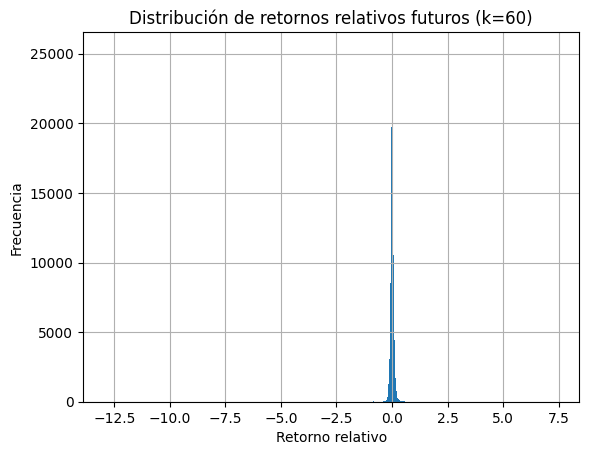

In [ ]:
plt.hist(df_regresion['Future_Rel_Return'].dropna(), bins=1000)
plt.title('Distribución de retornos relativos futuros (k=60)')
plt.xlabel('Retorno relativo')
plt.ylabel('Frecuencia')
plt.grid(True)
plt.show()

# REGRESSION

In [ ]:
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.dummy import DummyRegressor


In [ ]:
n_splits = 10
target_col = 'Future_Rel_Return'
quantile = 80
feature_cols = [col for col in df_regresion.columns if 'Past_Rel_Return' in col or
                'Volume' in col or
                col in ['GDP', 'Unemployment Rate', 'Inflation (CPI)']]

In [ ]:
# Modelo XGBoost
params_reg = {
    "objective": "reg:squaredlogerror",
    "eval_metric": "rmse",
    "eta": 0.1,
    "max_depth": 6,
    "subsample": 0.8,
    "colsample_bytree": 0.8,
    "random_state": seed
}

## XGBOOST - TOTAL

In [ ]:
# Eliminar filas con NaNs en features o target
df_regresion_clean = df_regresion.dropna(subset=feature_cols + [target_col])

In [ ]:
# Definir fecha de corte sobre el dataframe limpio
train_cutoff = df_regresion_clean['Date'].quantile((quantile)/100)

# División basada en fecha
train_df = df_regresion_clean[df_regresion_clean['Date'] <= train_cutoff].copy()
test_df = df_regresion_clean[df_regresion_clean['Date'] > train_cutoff].copy()

# Verificar las dimensiones de los conjuntos
print(f"Train dataset size: {train_df.shape}")
print(f"Test dataset size: {test_df.shape}")

Train dataset size: (119591, 58)
Test dataset size: (29868, 58)


In [ ]:
# Definir X e y
X_train_final = train_df[feature_cols]
y_train_final = train_df[target_col]
X_test_final = test_df[feature_cols]
y_test_final = test_df[target_col]

In [ ]:
dummy = DummyRegressor(strategy="mean")
dummy.fit(X_train_final, y_train_final)
y_dummy = dummy.predict(X_test_final)

print("R2 Dummy:", r2_score(y_test_final, y_dummy))

R2 Dummy: -0.008189981388234013


In [ ]:
# Modelo
XGBmodel_reg = XGBRegressor(**params_reg)
XGBmodel_reg.fit(X_train_final, y_train_final)

# Predicciones
y_test_pred = XGBmodel_reg.predict(X_test_final)

In [ ]:
# Métricas
mse = mean_squared_error(y_test_final, y_test_pred)
mae = mean_absolute_error(y_test_final, y_test_pred)
r2 = r2_score(y_test_final, y_test_pred)

print("\n Resultados en Test (Regresión):")
print(f"RMSE: {np.sqrt(mse):.4f}")
print(f"MAE: {mae:.4f}")
print(f"R2 Score: {r2:.4f}")


 Resultados en Test (Regresión):
RMSE: 0.0743
MAE: 0.0544
R2 Score: -0.1027


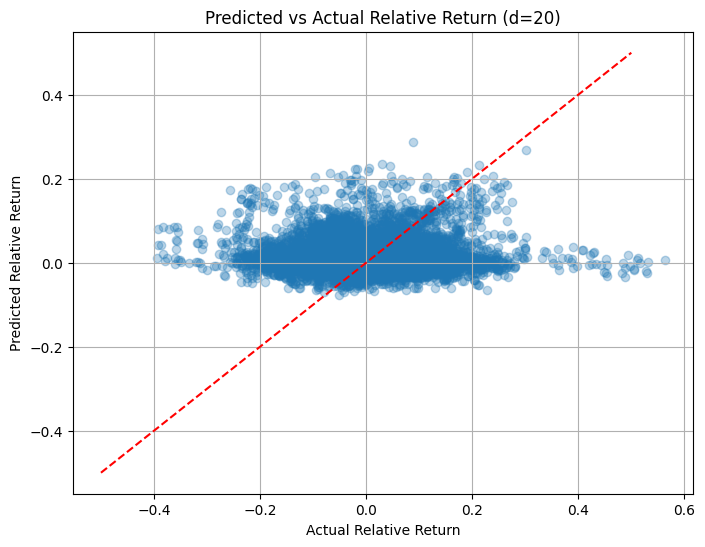

In [ ]:
plt.figure(figsize=(8,6))
plt.scatter(y_test_final, y_test_pred, alpha=0.3)
plt.xlabel("Actual Relative Return")
plt.ylabel("Predicted Relative Return")
plt.title(f"Predicted vs Actual Relative Return (d={d})")
plt.grid(True)
plt.plot([-0.5, 0.5], [-0.5, 0.5], '--', color='red')  # Línea ideal
plt.show()

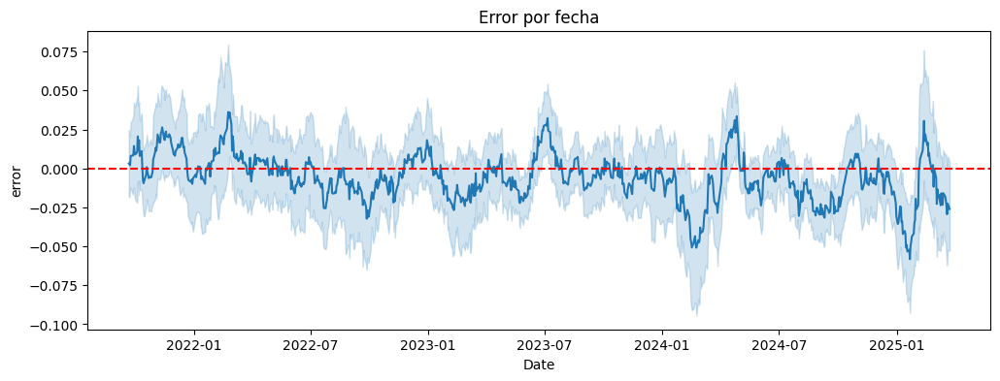

In [ ]:
df_errores = pd.DataFrame({
    "Date": test_df["Date"],
    "y_true": y_test_final,
    "y_pred": y_test_pred,
    "error": y_test_final - y_test_pred
})

plt.figure(figsize=(12, 4))
sns.lineplot(data=df_errores, x="Date", y="error")
plt.title("Error por fecha")
plt.axhline(0, color="red", linestyle="--")
plt.show()

## XGBOOST - BY TICKER

In [ ]:
tickers_total = df_regresion['Ticker'].unique()

In [ ]:
# Eliminar filas con NaNs en features o target
df_regresion_clean = df_regresion.dropna(subset=feature_cols + [target_col])

In [ ]:
for ticker in tickers_total:
  df_ticker = df_regresion_clean[df_regresion_clean['Ticker'] == ticker].copy()
  print('=============================', ticker, '=============================')

  # Definir fecha de corte para train y test
  train_cutoff = df_ticker['Date'].quantile((quantile)/100)

  # División basada en fecha
  train_df = df_ticker[df_ticker['Date'] <= train_cutoff].copy()
  test_df = df_ticker[df_ticker['Date'] > train_cutoff].copy()

  # Verificar las dimensiones de los conjuntos
  print(f"Train dataset size: {train_df.shape}")
  print(f"Test dataset size: {test_df.shape}")

  if len(train_df) == 0 or len(test_df) == 0:
    print(f"Saltar {ticker} set vacio.")
    continue # Saltar tickers con pocos datos o sin datos


  # Definir train y test
  X_train_final = train_df[feature_cols]
  y_train_final = train_df[target_col]
  X_test_final = test_df[feature_cols]
  y_test_final = test_df[target_col]

  dummy = DummyRegressor(strategy="mean")
  dummy.fit(X_train_final, y_train_final)
  y_dummy = dummy.predict(X_test_final)

  print("R2 Dummy:", r2_score(y_test_final, y_dummy))

  # Modelo
  XGBmodel_reg = XGBRegressor(**params_reg)
  XGBmodel_reg.fit(X_train_final, y_train_final)

  # Predicciones
  y_test_pred = XGBmodel_reg.predict(X_test_final)

  # Métricas
  mse = mean_squared_error(y_test_final, y_test_pred)
  mae = mean_absolute_error(y_test_final, y_test_pred)
  r2 = r2_score(y_test_final, y_test_pred)

  print("\n📈 Resultados en Test (Regresión):")
  print(f"RMSE: {np.sqrt(mse):.4f}")
  print(f"MAE: {mae:.4f}")
  print(f"R2 Score: {r2:.4f}")

============================= ACS.MC =============================
Train dataset size: (4166, 58)
Test dataset size: (1042, 58)
R2 Dummy: -0.0017054775538873912

📈 Resultados en Test (Regresión):
RMSE: 0.0649
MAE: 0.0532
R2 Score: -0.9256
============================= ACX.MC =============================
Train dataset size: (4548, 58)
Test dataset size: (1137, 58)
R2 Dummy: -0.00018312247425078532

📈 Resultados en Test (Regresión):
RMSE: 0.0767
MAE: 0.0602
R2 Score: -0.5932
============================= AENA.MC =============================
Train dataset size: (1493, 58)
Test dataset size: (373, 58)
R2 Dummy: -0.029916382164672184

📈 Resultados en Test (Regresión):
RMSE: 0.0350
MAE: 0.0292
R2 Score: 0.0812
============================= AMS.MC =============================
Train dataset size: (2472, 58)
Test dataset size: (618, 58)
R2 Dummy: -0.08343352110923852

📈 Resultados en Test (Regresión):
RMSE: 0.0611
MAE: 0.0472
R2 Score: -0.5538
============================= ANA.MC ===========

## XGBOOST - TIMESERIESSPLIT

In [ ]:
# Eliminar filas con NaNs en features o target
df_regresion_clean = df_regresion[df_regresion['Ticker'] == 'UNI.MC'].dropna(subset=feature_cols + [target_col])

In [ ]:
# Definir fecha de corte para train y test
train_cutoff = df_regresion_clean['Date'].quantile((quantile)/100)

# División basada en fecha
train_df = df_regresion_clean[df_regresion_clean['Date'] <= train_cutoff].copy()
test_df = df_regresion_clean[df_regresion_clean['Date'] > train_cutoff].copy()

# Verificar las dimensiones de los conjuntos
print(f"Train dataset size: {train_df.shape}")
print(f"Test dataset size: {test_df.shape}")

Train dataset size: (1005, 58)
Test dataset size: (252, 58)


In [ ]:
# Definir train y test
X_train_final = train_df[feature_cols]
y_train_final = train_df[target_col]
X_test_final = test_df[feature_cols]
y_test_final = test_df[target_col]

In [ ]:
#Time series split
tscv = TimeSeriesSplit(n_splits=n_splits)

In [ ]:
# Convertir a arrays
X = X_train_final.values
y = y_train_final.values

dates = df_regresion_clean["Date"].values  # Fechas alineadas

In [ ]:
#Inicializar
best_r2 = -np.inf
results = []
val_preds_all = []
val_true_all = []

# Loop de validación cruzada
for fold, (train_idx, test_idx) in enumerate(tscv.split(X)):
    print(f"\n ======== Fold {fold+1}/{n_splits}")

    X_train, X_test = X[train_idx], X[test_idx]
    y_train, y_test = y[train_idx], y[test_idx]
    dates_train, dates_test = dates[train_idx], dates[test_idx]

    # Dummy regressor
    dummy = DummyRegressor(strategy="mean")
    dummy.fit(X_train, y_train)
    y_dummy = dummy.predict(X_test)
    print("R2 Dummy:", r2_score(y_test, y_dummy))

    model = XGBRegressor(**params_reg)
    model.fit(X_train, y_train)

    y_pred = model.predict(X_test)

    # Métricas
    mse = mean_squared_error(y_test, y_pred)
    mae = mean_absolute_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    print("📈 Resultados XGBoost:")
    print(f"RMSE: {np.sqrt(mse):.4f}")
    print(f"MAE: {mae:.4f}")
    print(f"R2 Score: {r2:.4f}")

    # Guardar resultados del fold
    results.append({
        'Fold': fold + 1,
        'Train Start': pd.to_datetime(dates_train.min()),
        'Train End': pd.to_datetime(dates_train.max()),
        'Test Start': pd.to_datetime(dates_test.min()),
        'Test End': pd.to_datetime(dates_test.max()),
        'RMSE': np.sqrt(mse),
        'MAE': mae,
        'R2': r2
    })

    val_preds_all.extend(y_pred)
    val_true_all.extend(y_test)

    # Guardar mejor modelo
    if r2 > best_r2:
        best_r2 = r2
        XGBoost_reg_best = deepcopy(model)

# Convertir resultados a DataFrame
results_df = pd.DataFrame(results)


 ======== Fold 1/10
R2 Dummy: -2.9595888348486805
📈 Resultados XGBoost:
RMSE: 0.1442
MAE: 0.1272
R2 Score: -2.7639

 ======== Fold 2/10
R2 Dummy: -0.4897233736519584
📈 Resultados XGBoost:
RMSE: 0.1305
MAE: 0.1138
R2 Score: -1.6807

 ======== Fold 3/10
R2 Dummy: -0.11254928926979657
📈 Resultados XGBoost:
RMSE: 0.1222
MAE: 0.1037
R2 Score: -0.5732

 ======== Fold 4/10
R2 Dummy: -0.009128549610404324
📈 Resultados XGBoost:
RMSE: 0.0828
MAE: 0.0723
R2 Score: -0.0667

 ======== Fold 5/10
R2 Dummy: -0.10076292327114511
📈 Resultados XGBoost:
RMSE: 0.0730
MAE: 0.0587
R2 Score: -0.2697

 ======== Fold 6/10
R2 Dummy: -0.002945089700921555
📈 Resultados XGBoost:
RMSE: 0.1086
MAE: 0.0800
R2 Score: -0.2287

 ======== Fold 7/10
R2 Dummy: -0.02150241593745239
📈 Resultados XGBoost:
RMSE: 0.0787
MAE: 0.0667
R2 Score: 0.4080

 ======== Fold 8/10
R2 Dummy: -0.19982454974618769
📈 Resultados XGBoost:
RMSE: 0.0853
MAE: 0.0755
R2 Score: -1.0494

 ======== Fold 9/10
R2 Dummy: -0.5048401613663862
📈 Resultados X

In [ ]:
# Mostrar resumen
print("\n📊 Resumen de validación:")
print(results_df)

# Mostrar promedio de métricas
print("\n🔍 Promedio de métricas:")
print(results_df[['RMSE', 'MAE', 'R2']].mean())


📊 Resumen de validación:
   Fold Train Start  Train End Test Start   Test End      RMSE       MAE  \
0     1  2020-04-29 2020-09-09 2020-09-10 2021-01-18  0.144229  0.127221   
1     2  2020-04-29 2021-01-18 2021-01-19 2021-05-27  0.130503  0.113765   
2     3  2020-04-29 2021-05-27 2021-05-28 2021-10-01  0.122175  0.103719   
3     4  2020-04-29 2021-10-01 2021-10-04 2022-02-09  0.082755  0.072278   
4     5  2020-04-29 2022-02-09 2022-02-10 2022-06-20  0.072962  0.058665   
5     6  2020-04-29 2022-06-20 2022-06-21 2022-10-25  0.108563  0.080048   
6     7  2020-04-29 2022-10-25 2022-10-26 2023-03-02  0.078695  0.066721   
7     8  2020-04-29 2023-03-02 2023-03-03 2023-07-12  0.085310  0.075535   
8     9  2020-04-29 2023-07-12 2023-07-13 2023-11-16  0.062396  0.044636   
9    10  2020-04-29 2023-11-16 2023-11-17 2024-03-27  0.066331  0.053799   

         R2  
0 -2.763876  
1 -1.680712  
2 -0.573184  
3 -0.066706  
4 -0.269684  
5 -0.228667  
6  0.407987  
7 -1.049359  
8 -0.565021

In [ ]:
# Modelo
XGBoost_reg_best.fit(X_train_final, y_train_final)

# Predicciones
y_test_pred = XGBoost_reg_best.predict(X_test_final)

In [ ]:
# Métricas
mse = mean_squared_error(y_test_final, y_test_pred)
mae = mean_absolute_error(y_test_final, y_test_pred)
r2 = r2_score(y_test_final, y_test_pred)

print("\n Resultados en Test (Regresión):")
print(f"RMSE: {np.sqrt(mse):.4f}")
print(f"MAE: {mae:.4f}")
print(f"R2 Score: {r2:.4f}")


 Resultados en Test (Regresión):
RMSE: 0.0856
MAE: 0.0750
R2 Score: -0.2133


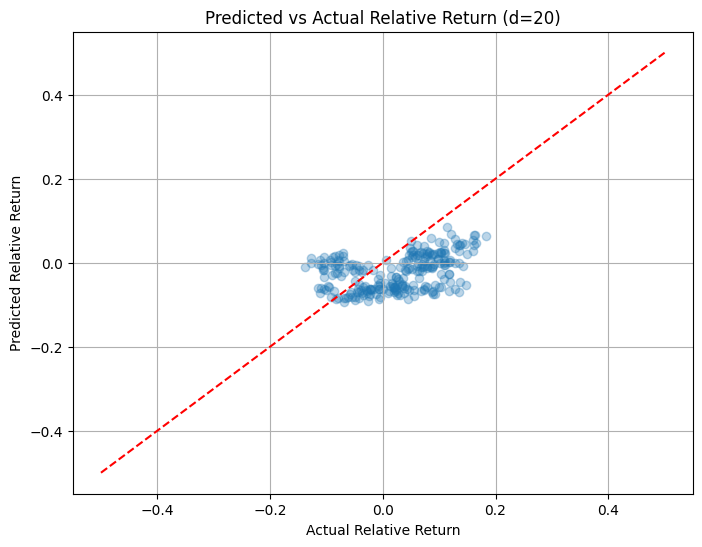

In [ ]:
plt.figure(figsize=(8,6))
plt.scatter(y_test_final, y_test_pred, alpha=0.3)
plt.xlabel("Actual Relative Return")
plt.ylabel("Predicted Relative Return")
plt.title(f"Predicted vs Actual Relative Return (d={d})")
plt.grid(True)
plt.plot([-0.5, 0.5], [-0.5, 0.5], '--', color='red')  # Línea ideal
plt.show()

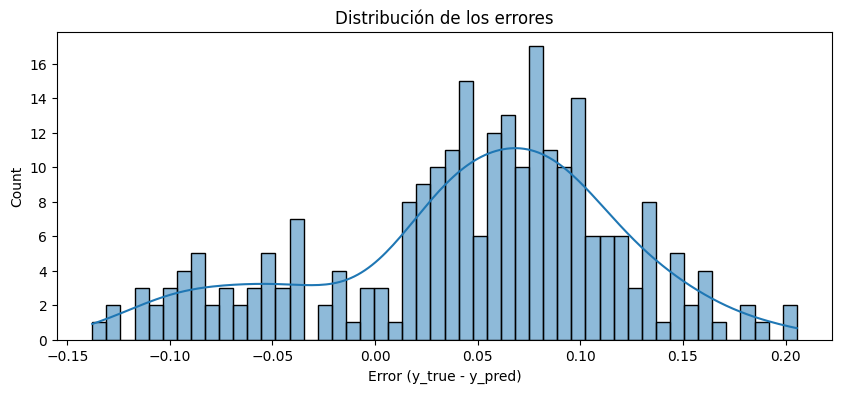

In [ ]:
errors = y_test_final - y_test_pred
plt.figure(figsize=(10, 4))
sns.histplot(errors, bins=50, kde=True)
plt.title("Distribución de los errores")
plt.xlabel("Error (y_true - y_pred)")
plt.show()

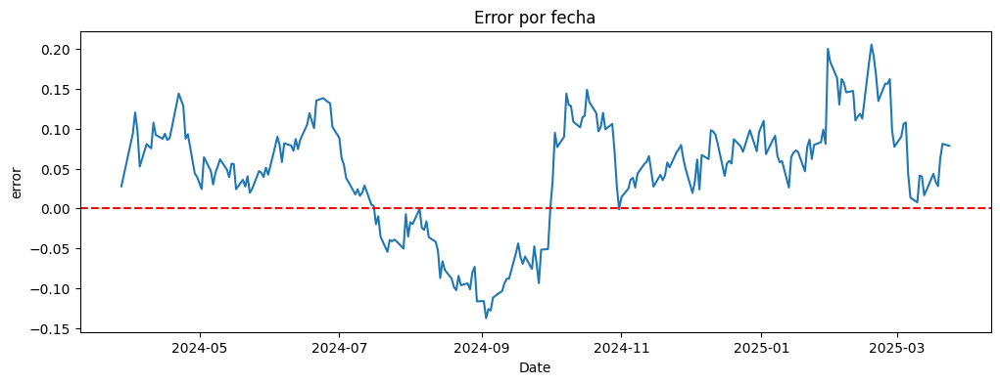

In [ ]:
df_errores = pd.DataFrame({
    "Date": test_df["Date"],
    "y_true": y_test_final,
    "y_pred": y_test_pred,
    "error": y_test_final - y_test_pred
})

plt.figure(figsize=(12, 4))
sns.lineplot(data=df_errores, x="Date", y="error")
plt.title("Error por fecha")
plt.axhline(0, color="red", linestyle="--")
plt.show()

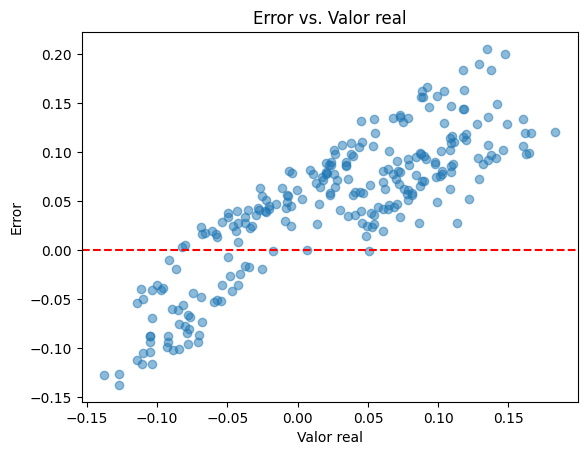

In [ ]:
plt.scatter(y_test_final, errors, alpha=0.5)
plt.axhline(0, color='red', linestyle='--')
plt.xlabel("Valor real")
plt.ylabel("Error")
plt.title("Error vs. Valor real")
plt.show()

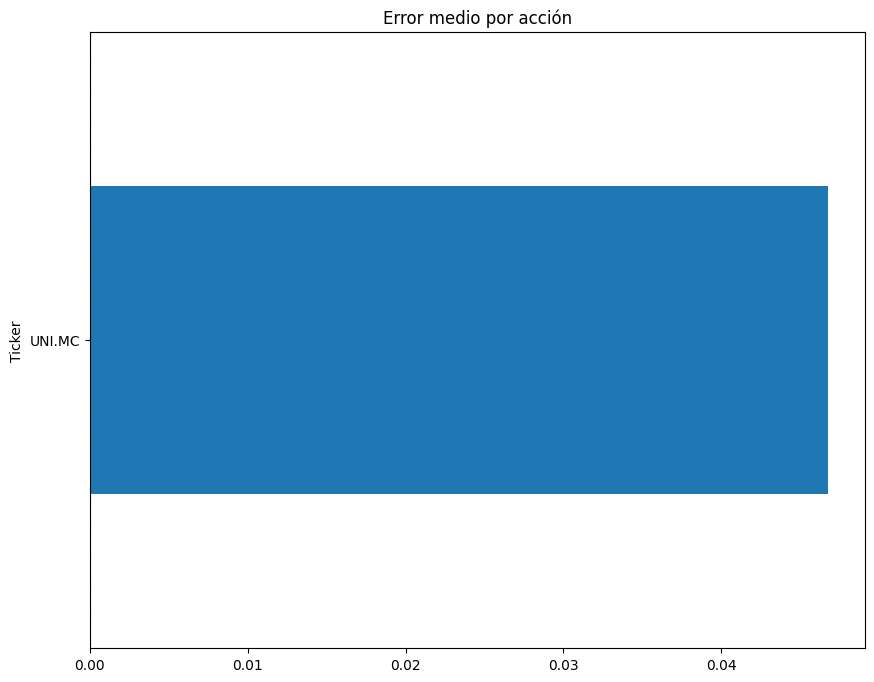

In [ ]:
df_errores['Ticker'] = test_df["Ticker"]

mean_errors_by_ticker = df_errores.groupby('Ticker')['error'].mean().sort_values()

mean_errors_by_ticker.plot(kind='barh', figsize=(10, 8), title="Error medio por acción")
plt.axvline(0, color='red', linestyle='--')
plt.show()

## XGBOOST - TOTAL OHE

In [ ]:
# Eliminar filas con NaNs en features o target
df_regresion_clean = df_regresion.dropna(subset=feature_cols + [target_col])

In [ ]:
# One-Hot Encoding del Ticker
df_regresion_ohe = pd.get_dummies(df_regresion_clean, columns=['Ticker'], prefix='Ticker')

In [ ]:
feature_cols_ohe = []

# Agregar Tickers como dummie en features
ticker_columns = [col for col in df_regresion_ohe.columns if 'Ticker_' in col]
if not any(col in feature_cols_ohe for col in ticker_columns):
  feature_cols_ohe = feature_cols + ticker_columns

In [ ]:
# Definir fecha de corte para train y test
train_cutoff = df_regresion_ohe['Date'].quantile((quantile)/100)

# División basada en fecha
train_df = df_regresion_ohe[df_regresion_ohe['Date'] <= train_cutoff].copy()
test_df = df_regresion_ohe[df_regresion_ohe['Date'] > train_cutoff].copy()

# Verificar las dimensiones de los conjuntos
print(f"Train dataset size: {train_df.shape}")
print(f"Test dataset size: {test_df.shape}")

Train dataset size: (119591, 91)
Test dataset size: (29868, 91)


In [ ]:
# Definir train y test
X_train_final = train_df[feature_cols_ohe]
y_train_final = train_df[target_col]
X_test_final = test_df[feature_cols_ohe]
y_test_final = test_df[target_col]

In [ ]:
dummy = DummyRegressor(strategy="mean")
dummy.fit(X_train_final, y_train_final)
y_dummy = dummy.predict(X_test_final)

print("R2 Dummy:", r2_score(y_test_final, y_dummy))

R2 Dummy: -0.008189981388234013


In [ ]:
# Modelo
XGBmodel_reg = XGBRegressor(**params_reg)
XGBmodel_reg.fit(X_train_final, y_train_final)

# Predicciones
y_test_pred = XGBmodel_reg.predict(X_test_final)

In [ ]:
# Métricas
mse = mean_squared_error(y_test_final, y_test_pred)
mae = mean_absolute_error(y_test_final, y_test_pred)
r2 = r2_score(y_test_final, y_test_pred)

print("\n📈 Resultados en Test (Regresión):")
print(f"RMSE: {np.sqrt(mse):.4f}")
print(f"MAE: {mae:.4f}")
print(f"R2 Score: {r2:.4f}")


📈 Resultados en Test (Regresión):
RMSE: 0.0744
MAE: 0.0545
R2 Score: -0.1039


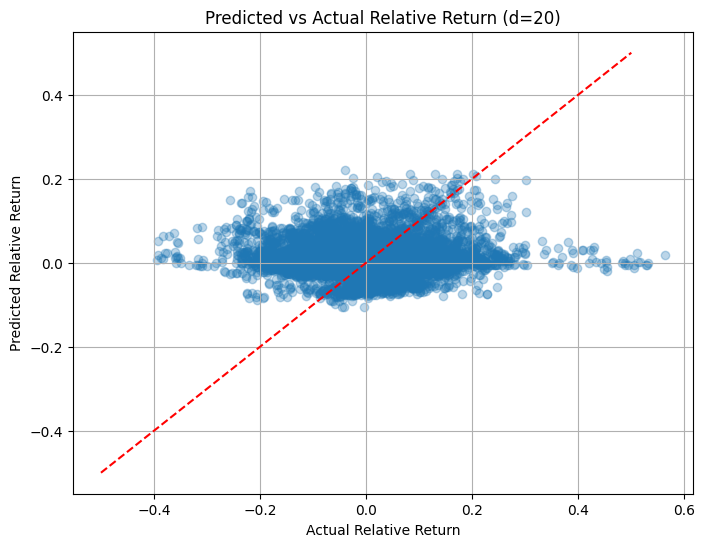

In [ ]:
plt.figure(figsize=(8,6))
plt.scatter(y_test_final, y_test_pred, alpha=0.3)
plt.xlabel("Actual Relative Return")
plt.ylabel("Predicted Relative Return")
plt.title(f"Predicted vs Actual Relative Return (d={d})")
plt.grid(True)
plt.plot([-0.5, 0.5], [-0.5, 0.5], '--', color='red')  # Línea ideal
plt.show()

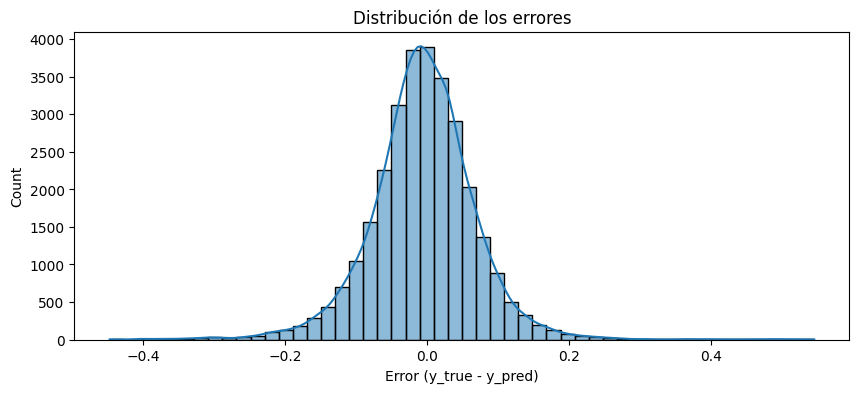

In [ ]:
errors = y_test_final - y_test_pred
plt.figure(figsize=(10, 4))
sns.histplot(errors, bins=50, kde=True)
plt.title("Distribución de los errores")
plt.xlabel("Error (y_true - y_pred)")
plt.show()

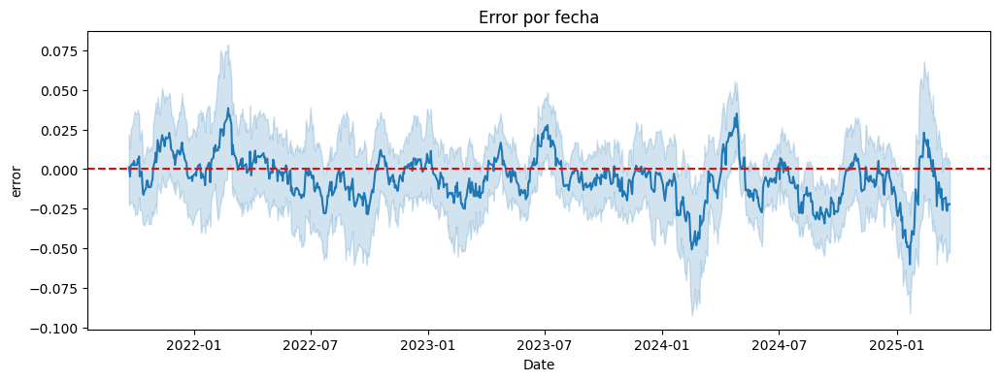

In [ ]:
df_errores = pd.DataFrame({
    "Date": test_df["Date"],
    "y_true": y_test_final,
    "y_pred": y_test_pred,
    "error": y_test_final - y_test_pred
})

plt.figure(figsize=(12, 4))
sns.lineplot(data=df_errores, x="Date", y="error")
plt.title("Error por fecha")
plt.axhline(0, color="red", linestyle="--")
plt.show()

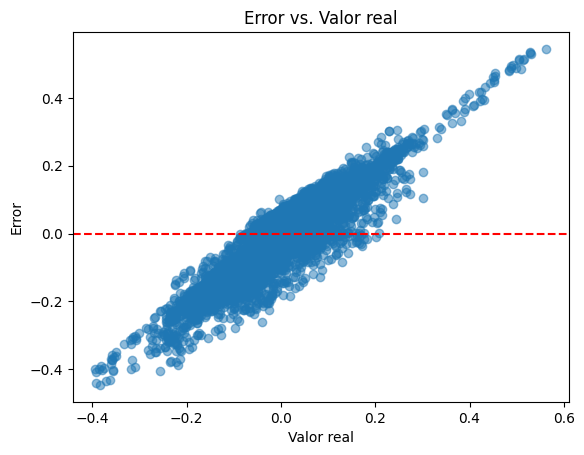

In [ ]:
plt.scatter(y_test_final, errors, alpha=0.5)
plt.axhline(0, color='red', linestyle='--')
plt.xlabel("Valor real")
plt.ylabel("Error")
plt.title("Error vs. Valor real")
plt.show()

## XGBOOST - TIMESERIESSPLIT + OHE

In [ ]:
# Eliminar filas con NaNs en features o target
df_regresion_clean = df_regresion.dropna(subset=feature_cols + [target_col])

In [ ]:
# One-Hot Encoding del Ticker
df_regresion_ohe = pd.get_dummies(df_regresion_clean, columns=['Ticker'], prefix='Ticker')

In [ ]:
feature_cols_ohe = []

# Agregar Tickers como dummie en features
ticker_columns = [col for col in df_regresion_ohe.columns if 'Ticker_' in col]
if not any(col in feature_cols_ohe for col in ticker_columns):
  feature_cols_ohe = feature_cols + ticker_columns

In [ ]:
# Definir fecha de corte para train y test
train_cutoff = df_regresion_ohe['Date'].quantile((quantile)/100)

# División basada en fecha
train_df = df_regresion_ohe[df_regresion_ohe['Date'] <= train_cutoff].copy()
test_df = df_regresion_ohe[df_regresion_ohe['Date'] > train_cutoff].copy()

# Verificar las dimensiones de los conjuntos
print(f"Train dataset size: {train_df.shape}")
print(f"Test dataset size: {test_df.shape}")

Train dataset size: (119591, 91)
Test dataset size: (29868, 91)


In [ ]:
# Definir train y test
X_train_final = train_df[feature_cols_ohe]
y_train_final = train_df[target_col]
X_test = test_df[feature_cols_ohe]
y_test = test_df[target_col]

In [ ]:
#Time series split
tscv = TimeSeriesSplit(n_splits=n_splits)

In [ ]:
# Convertir a arrays
X = X_train_final.values
y = y_train_final.values

dates = df_regresion_clean["Date"].values  # Fechas alineadas

In [ ]:
#Inicializar
best_r2 = -np.inf
results = []
val_preds_all = []
val_true_all = []

# Loop de validación cruzada
for fold, (train_idx, test_idx) in enumerate(tscv.split(X)):
    print(f"\n ======== Fold {fold+1}/{n_splits}")

    X_train, X_test = X[train_idx], X[test_idx]
    y_train, y_test = y[train_idx], y[test_idx]
    dates_train, dates_test = dates[train_idx], dates[test_idx]

    # Dummy regressor
    dummy = DummyRegressor(strategy="mean")
    dummy.fit(X_train, y_train)
    y_dummy = dummy.predict(X_test)
    print("R2 Dummy:", r2_score(y_test, y_dummy))

    model = XGBRegressor(**params_reg)
    model.fit(X_train, y_train)

    y_pred = model.predict(X_test)

    # Métricas
    mse = mean_squared_error(y_test, y_pred)
    mae = mean_absolute_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    print(" === Resultados XGBoost:")
    print(f"RMSE: {np.sqrt(mse):.4f}")
    print(f"MAE: {mae:.4f}")
    print(f"R2 Score: {r2:.4f}")

    # Guardar resultados del fold
    results.append({
        'Fold': fold + 1,
        'Train Start': pd.to_datetime(dates_train.min()),
        'Train End': pd.to_datetime(dates_train.max()),
        'Test Start': pd.to_datetime(dates_test.min()),
        'Test End': pd.to_datetime(dates_test.max()),
        'RMSE': np.sqrt(mse),
        'MAE': mae,
        'R2': r2
    })

    val_preds_all.extend(y_pred)
    val_true_all.extend(y_test)

    # Guardar mejor modelo
    if r2 > best_r2:
        best_r2 = r2
        XGBoost_reg_best = deepcopy(model)

# Convertir resultados a DataFrame
results_df = pd.DataFrame(results)


 ======== Fold 1/10
R2 Dummy: -0.00014054643043626136
 === Resultados XGBoost:
RMSE: 0.0666
MAE: 0.0496
R2 Score: -0.2140

 ======== Fold 2/10
R2 Dummy: -0.0009009776136750247
 === Resultados XGBoost:
RMSE: 0.3058
MAE: 0.0901
R2 Score: -0.0280

 ======== Fold 3/10
R2 Dummy: -7.824874868833653e-05
 === Resultados XGBoost:
RMSE: 0.0694
MAE: 0.0502
R2 Score: -0.4999

 ======== Fold 4/10
R2 Dummy: -0.0008768230395046483
 === Resultados XGBoost:
RMSE: 0.0831
MAE: 0.0581
R2 Score: -0.0972

 ======== Fold 5/10
R2 Dummy: -0.0059182518568086095
 === Resultados XGBoost:
RMSE: 0.0808
MAE: 0.0498
R2 Score: -0.4253

 ======== Fold 6/10
R2 Dummy: -0.0011536195505694735
 === Resultados XGBoost:
RMSE: 0.0651
MAE: 0.0438
R2 Score: -0.0911

 ======== Fold 7/10
R2 Dummy: -0.002490307302862149
 === Resultados XGBoost:
RMSE: 0.0773
MAE: 0.0527
R2 Score: -0.1025

 ======== Fold 8/10
R2 Dummy: -2.864847341643717e-05
 === Resultados XGBoost:
RMSE: 0.0565
MAE: 0.0426
R2 Score: 0.0609

 ======== Fold 9/10
R2 D

In [ ]:
# Mostrar resumen
print("\n === Resumen de validación:")
print(results_df)

# Mostrar promedio de métricas
print("\n Promedio de métricas:")

print(results_df[['RMSE', 'MAE', 'R2']].mean())


 === Resumen de validación:
   Fold Train Start  Train End Test Start   Test End      RMSE       MAE  \
0     1  2002-10-08 2025-03-24 2002-10-08 2025-03-24  0.066639  0.049619   
1     2  2002-10-08 2025-03-24 2002-10-08 2025-03-24  0.305817  0.090136   
2     3  2002-10-08 2025-03-24 2005-02-17 2025-03-24  0.069369  0.050204   
3     4  2002-10-08 2025-03-24 2002-10-08 2025-03-24  0.083058  0.058134   
4     5  2002-10-08 2025-03-24 2002-10-08 2025-03-24  0.080769  0.049757   
5     6  2002-10-08 2025-03-24 2002-10-08 2025-03-24  0.065087  0.043807   
6     7  2002-10-08 2025-03-24 2003-07-09 2025-03-24  0.077310  0.052727   
7     8  2002-10-08 2025-03-24 2004-06-22 2025-03-24  0.056515  0.042554   
8     9  2002-10-08 2025-03-24 2002-10-08 2025-03-24  0.075175  0.052161   
9    10  2002-10-08 2025-03-24 2002-10-08 2025-03-24  0.112162  0.071062   

         R2  
0 -0.214014  
1 -0.027976  
2 -0.499887  
3 -0.097240  
4 -0.425345  
5 -0.091116  
6 -0.102511  
7  0.060878  
8 -0.026

In [ ]:
# Modelo
XGBoost_reg_best.fit(X_train_final, y_train_final)

# Predicciones
y_test_pred = XGBoost_reg_best.predict(X_test_final)

In [ ]:
# Métricas
mse = mean_squared_error(y_test_final, y_test_pred)
mae = mean_absolute_error(y_test_final, y_test_pred)
r2 = r2_score(y_test_final, y_test_pred)

print("\n Resultados en Test (Regresión):")
print(f"RMSE: {np.sqrt(mse):.4f}")
print(f"MAE: {mae:.4f}")
print(f"R2 Score: {r2:.4f}")


 Resultados en Test (Regresión):
RMSE: 0.0744
MAE: 0.0545
R2 Score: -0.1039


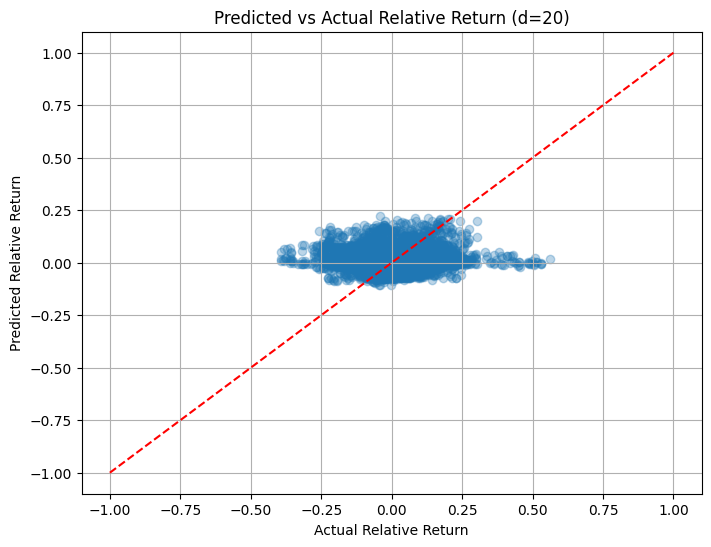

In [ ]:
plt.figure(figsize=(8,6))
plt.scatter(y_test_final, y_test_pred, alpha=0.3)
plt.xlabel("Actual Relative Return")
plt.ylabel("Predicted Relative Return")
plt.title(f"Predicted vs Actual Relative Return (d={d})")
plt.grid(True)
plt.plot([-1.0, 1.0], [-1.0, 1.0], '--', color='red')  # Línea ideal
plt.show()

<Axes: title={'center': 'Feature importance'}, xlabel='F score', ylabel='Features'>

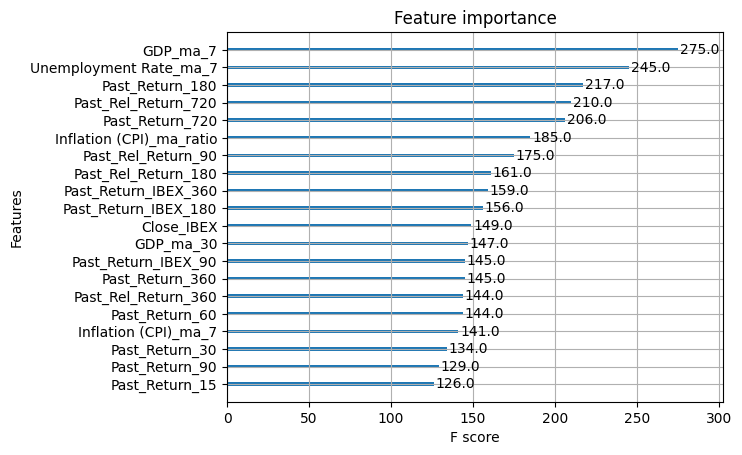

In [ ]:
plot_importance(XGBoost_reg_best, max_num_features=20)


## XGBOOST - TSE + SEARCH

In [ ]:
# Definir fecha de corte para train y test
train_cutoff = df_regresion['Date'].quantile((quantile)/100)

# División basada en fecha
train_df = df_regresion[df_regresion['Date'] <= train_cutoff].copy()
test_df = df_regresion[df_regresion['Date'] > train_cutoff].copy()

# Verificar las dimensiones de los conjuntos
print(f"Train dataset size: {train_df.shape}")
print(f"Test dataset size: {test_df.shape}")

Train dataset size: (140872, 40)
Test dataset size: (35209, 40)


In [ ]:
# Definir train y test
X_train_final = train_df[feature_cols]
y_train_final = train_df[target_col]
X_test = test_df[feature_cols]
y_test = test_df[target_col]

In [ ]:
# Eliminar NaNs
valid_idx_train = y_train_final.notna()
valid_idx_test = y_test.notna()

X_train_final = X_train_final[valid_idx_train]
y_train_final = y_train_final[valid_idx_train]
X_test = X_test[valid_idx_test]
y_test = y_test[valid_idx_test]

In [ ]:
# Convertir a arrays
X = X_train_final.values
y = y_train_final.values

dates = train_df.loc[valid_idx_train, 'Date'].values

In [ ]:
param_dist = {
    'max_depth': randint(3, 10),
    'learning_rate': uniform(0.01, 0.2),
    'subsample': uniform(0.6, 0.4),
    'colsample_bytree': uniform(0.6, 0.4),
    'n_estimators': randint(100, 500)#,
    #'gamma': Real(0, 0.3),
    #'reg_alpha': Real(0, 0.5),
    #'reg_lambda': Real(0.8, 1.2)
}

In [ ]:
tscv = TimeSeriesSplit(n_splits=n_splits)
xgb = XGBRegressor(objective='reg:squarederror', random_state=seed)

random_search = RandomizedSearchCV(
    estimator=xgb,
    param_distributions=param_dist,
    n_iter=5,
    scoring="r2",
    cv=tscv,
    verbose=1,
    n_jobs=-1,
    random_state=seed
)

# Entrenar modelo
random_search.fit(X, y)
print("🔍 Mejor combinación (Random):", random_search.best_params_)
print("📈 Mejor R2:", random_search.best_score_)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
🔍 Mejor combinación (Random): {'colsample_bytree': np.float64(0.9477474983796137), 'learning_rate': np.float64(0.13180714068954397), 'max_depth': 6, 'n_estimators': 377, 'subsample': np.float64(0.9740560688724617)}
📈 Mejor R2: -0.6010906788114048


In [ ]:
best_params_rsearch = random_search.best_params_

# Espacio de búsqueda afinado para BayesSearchCV
search_spaces = {
    'n_estimators': Integer(max(100, best_params_rsearch['n_estimators'] - 100), best_params_rsearch['n_estimators'] + 100),
    'max_depth': Integer(max(3, best_params_rsearch['max_depth'] - 2), best_params_rsearch['max_depth'] + 2),
    'learning_rate': Real(max(0.01, best_params_rsearch['learning_rate'] / 2), best_params_rsearch['learning_rate'] * 2, prior='log-uniform'),
    'subsample': Real(max(0.6, best_params_rsearch['subsample'] - 0.2), min(1.0, best_params_rsearch['subsample'] + 0.2)),
    'colsample_bytree': Real(max(0.6, best_params_rsearch['colsample_bytree'] - 0.2), min(1.0, best_params_rsearch['colsample_bytree'] + 0.2))#,
    #'gamma': Real(0, best_params_rsearch['gamma'] + 0.3),
    #'reg_alpha': Real(0, best_params_rsearch['reg_alpha'] + 0.3),
    #'reg_lambda': Real(max(0.5, best_params_rsearch['reg_lambda'] - 0.3), best_params_rsearch['reg_lambda'] + 0.3)
}

In [ ]:
bayes_search = BayesSearchCV(
    estimator=xgb,
    search_spaces=search_spaces,
    n_iter=5,
    scoring='r2',
    cv=tscv,
    n_jobs=-1,
    verbose=2,
    random_state=seed
)

# Entrenar modelo
bayes_search.fit(X, y)
best_params_bayes = bayes_search.best_params_
print("🔍 Mejor combinación (Random):", bayes_search.best_params_)
print("📈 Mejor R2:", bayes_search.best_score_)


Fitting 10 folds for each of 1 candidates, totalling 10 fits
Fitting 10 folds for each of 1 candidates, totalling 10 fits
Fitting 10 folds for each of 1 candidates, totalling 10 fits
Fitting 10 folds for each of 1 candidates, totalling 10 fits
Fitting 10 folds for each of 1 candidates, totalling 10 fits
🔍 Mejor combinación (Random): OrderedDict([('colsample_bytree', 0.9071924317131166), ('learning_rate', 0.11086769068810853), ('max_depth', 4), ('n_estimators', 300), ('subsample', 0.9731874454760687)])
📈 Mejor R2: -0.3802436182641119


In [ ]:
#Inicializar
best_r2 = -np.inf
results = []
val_preds_all = []
val_true_all = []

# Loop de validación cruzada
for fold, (train_idx, test_idx) in enumerate(tscv.split(X)):
    print(f"\n ======== Fold {fold+1}/{n_splits}")

    X_train, X_test = X[train_idx], X[test_idx]
    y_train, y_test = y[train_idx], y[test_idx]
    dates_train, dates_test = dates[train_idx], dates[test_idx]

    # Dummy regressor
    dummy = DummyRegressor(strategy="mean")
    dummy.fit(X_train, y_train)
    y_dummy = dummy.predict(X_test)
    print("R2 Dummy:", r2_score(y_test, y_dummy))

    model = XGBRegressor(**best_params_bayes)
    model.fit(X_train, y_train)

    y_pred = model.predict(X_test)

    # Métricas
    mse = mean_squared_error(y_test, y_pred)
    mae = mean_absolute_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    print(" === Resultados XGBoost:")
    print(f"RMSE: {np.sqrt(mse):.4f}")
    print(f"MAE: {mae:.4f}")
    print(f"R2 Score: {r2:.4f}")

    # Guardar resultados del fold
    results.append({
        'Fold': fold + 1,
        'Train Start': pd.to_datetime(dates_train.min()),
        'Train End': pd.to_datetime(dates_train.max()),
        'Test Start': pd.to_datetime(dates_test.min()),
        'Test End': pd.to_datetime(dates_test.max()),
        'RMSE': np.sqrt(mse),
        'MAE': mae,
        'R2': r2
    })

    val_preds_all.extend(y_pred)
    val_true_all.extend(y_test)

    # Guardar mejor modelo
    if r2 > best_r2:
        best_r2 = r2
        XGBoost_reg_best = deepcopy(model)

# Convertir resultados a DataFrame
results_df = pd.DataFrame(results)

In [ ]:
# Mostrar resumen
print("\n === Resumen de validación:")
print(results_df)

# Mostrar promedio de métricas
print("\n Promedio de métricas:")

print(results_df[['RMSE', 'MAE', 'R2']].mean())

In [ ]:
# Modelo
XGBoost_reg_best.fit(X_train_final, y_train_final)

# Predicciones
y_test_pred = XGBoost_reg_best.predict(X_test)

In [ ]:
# Métricas
mse = mean_squared_error(y_test, y_test_pred)
mae = mean_absolute_error(y_test, y_test_pred)
r2 = r2_score(y_test, y_test_pred)

print("\n Resultados en Test (Regresión):")
print(f"RMSE: {np.sqrt(mse):.4f}")
print(f"MAE: {mae:.4f}")
print(f"R2 Score: {r2:.4f}")

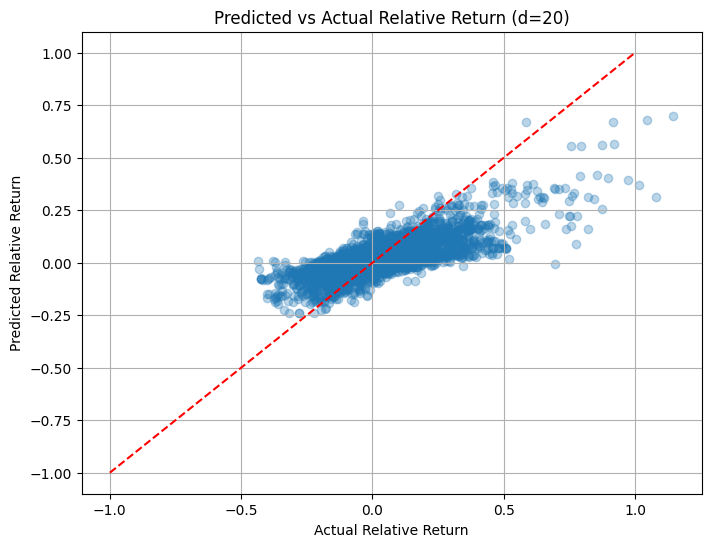

In [ ]:
plt.figure(figsize=(8,6))
plt.scatter(y_test, y_test_pred, alpha=0.3)
plt.xlabel("Actual Relative Return")
plt.ylabel("Predicted Relative Return")
plt.title(f"Predicted vs Actual Relative Return (d={d})")
plt.grid(True)
plt.plot([-1.0, 1.0], [-1.0, 1.0], '--', color='red')  # Línea ideal
plt.show()